<a href="https://colab.research.google.com/github/SeyfGoumeida/Projet_Mixt_Coclus_Partie1/blob/main/Rendu_de_la_Partie1_Partie2_du_projet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Prerequirement : 

###Mira's code :

In [2]:
import os
import math
import numpy as np
import tensorflow.compat.v1 as tf
from sklearn.cluster import KMeans
from tqdm import tqdm

"""
  Credits:
    This code is based on the implementation provided by Maziar Moradi Fard and Thibaut Thonet
    Available in: https://github.com/MaziarMF/deep-k-means
"""

TF_FLOAT_TYPE = tf.float32

tf.disable_eager_execution()

def fc_layers(input, specs):
    [dimensions, activations, names] = specs
    for dimension, activation, name in zip(dimensions, activations, names):
        input = tf.layers.dense(inputs=input, units=dimension, activation=activation, name=name, reuse=tf.AUTO_REUSE)
    return input

def autoencoder(input, specs):
    [dimensions, activations, names] = specs
    mid_ind = int(len(dimensions)/2)

    # Encoder
    embedding = fc_layers(input, [dimensions[:mid_ind], activations[:mid_ind], names[:mid_ind]])
    # Decoder
    output = fc_layers(embedding, [dimensions[mid_ind:], activations[mid_ind:], names[mid_ind:]])

    return embedding, output

def f_func(x, y):
    return tf.reduce_sum(tf.square(x - y), axis=1)

def g_func(x, y):
    return tf.reduce_sum(tf.square(x - y), axis=1)

def next_batch(num, data):
    """
    Return a total of `num` random samples.
    """
    indices = np.arange(0, data.shape[0])
    np.random.shuffle(indices)
    indices = indices[:num]
    batch_data = np.asarray([data[i, :] for i in indices])

    return indices, batch_data


#######################################################
############### Deep Clustering Network ###############
#######################################################

class DcnCompGraph(object):
    """Computation graph for the Deep Clustering Network model proposed in:
        Yang, B., Fu, X., Sidiropoulos, N. D., & Hong, M. (2017). Towards K-means-friendly Spaces: Simultaneous Deep
        Learning and Clustering. In ICML '17 (pp. 3861–3870).
    This implementation is inspired by https://github.com/boyangumn/DCN
    """

    def __init__(self, ae_specs, n_clusters, batch_size, n_samples, val_lambda):
        input_size = ae_specs[0][-1]
        embedding_size = ae_specs[0][int((len(ae_specs[0]) - 1) / 2)]

        # Placeholder tensor for input data
        self.input = tf.placeholder(dtype=TF_FLOAT_TYPE, shape=(batch_size, input_size))

        # Auto-encoder loss computations
        self.embedding, self.output = autoencoder(self.input, ae_specs)  # Get the auto-encoder's embedding and output
        rec_error = g_func(self.input, self.output)  # Reconstruction error based on distance g
        self.ae_loss = tf.reduce_mean(rec_error)

        # Clustering loss computations
        ## Tensor for cluster representatives
        minval_rep, maxval_rep = -1, 1
        self.cluster_rep = tf.Variable(tf.random_uniform([n_clusters, embedding_size],
                                                    minval=minval_rep, maxval=maxval_rep,
                                                    dtype=TF_FLOAT_TYPE), name='cluster_rep', dtype=TF_FLOAT_TYPE)

        ## Clustering assignments for all samples in the dataset
        initial_clustering_assign = tf.random_uniform(minval=0, maxval=n_clusters, dtype=tf.int32, shape=[n_samples])
        self.cluster_assign = tf.Variable(initial_clustering_assign, name='cluster_assign', dtype=tf.int32, trainable=False)

        ## Get the cluster representative corresponding to the cluster of each batch sample
        self.indices = tf.placeholder(dtype=tf.int32, shape=batch_size)  # Placeholder for sample indices in current batch
        batch_clust_rep = []
        for j in range(batch_size):
            k = self.cluster_assign[self.indices[j]]  # Clustering assignment for sample j in batch
            batch_clust_rep.append(self.cluster_rep[k, :])
        stack_batch_clust_rep = tf.stack(batch_clust_rep)

        ## Compute the k-means term
        clustering_error = f_func(self.embedding, stack_batch_clust_rep)

        # Compute the full loss combining the reconstruction error and k-means term
        self.ae_loss = tf.reduce_mean(rec_error)
        self.kmeans_loss = tf.reduce_mean(clustering_error)
        self.loss = self.ae_loss + val_lambda * self.kmeans_loss

        # The optimizer is defined to minimize this loss
        optimizer = tf.train.AdamOptimizer()
        self.pretrain_op = optimizer.minimize(self.ae_loss) # Pretrain the autoencoder before starting DCN
        self.train_op = optimizer.minimize(self.loss)

        # As it has been pointed out in the DCN paper, first the weights of the autoencoder shall be trained then the
        # assignments and cluster representatives. So far in the computation graph we have optimized the weights of the
        # autoencoder, now it's the time for the assignments and representatives.

        # Update the clustering assignments
        for j in range(batch_size):
            # Find which cluster representative is the closest to the current batch sample
            new_assign = tf.argmin(f_func(tf.reshape(self.embedding[j, :], (1, embedding_size)), self.cluster_rep),
                                   output_type=tf.int32)
            # Update the clustering assignment
            self.cluster_assign_update = tf.assign(self.cluster_assign[self.indices[j]], new_assign)

        # Update the cluster representatives
        ## Initialize the value of count
        initial_count = tf.constant(100.0, shape=[n_clusters])
        count = tf.Variable(initial_count, name='count', dtype=TF_FLOAT_TYPE, trainable=False)
        ## Update the cluster representatives according to Equation (8) in the DCN paper
        for j in range(batch_size):
            k = self.cluster_assign[self.indices[j]]  # Clustering assignment for sample j in batch
            self.count_update = tf.assign(count[k], count[k] + 1)  # Updated count for cluster assignments
            new_rep = self.cluster_rep[k] - (1 / count[k]) * (self.cluster_rep[k] - self.embedding[j])
            self.cluster_rep_update = tf.assign(self.cluster_rep[k], new_rep)

def DCN(data, n_clusters, n_components, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False):
    # Auto-encoder architecture
    input_size = data.shape[1]
    hidden_1_size = 500
    hidden_2_size = 500
    hidden_3_size = 2000
    embedding_size = n_components
    dimensions = [hidden_1_size, hidden_2_size, hidden_3_size, embedding_size, # Encoder layer dimensions
                  hidden_3_size, hidden_2_size, hidden_1_size, input_size] # Decoder layer dimensions
    activations = [tf.nn.relu, tf.nn.relu, tf.nn.relu, None, # Encoder layer activations
                  tf.nn.relu, tf.nn.relu, tf.nn.relu, None] # Decoder layer activations
    names = ['enc_hidden_1', 'enc_hidden_2', 'enc_hidden_3', 'embedding', # Encoder layer names
            'dec_hidden_1', 'dec_hidden_2', 'dec_hidden_3', 'output'] # Decoder layer names

    n_samples = data.shape[0]
    n_batches = int(math.ceil(n_samples / batch_size)) # Number of mini-batches
    pretrain = True # Specify if DKM's autoencoder should be pretrained

    # Hardware specifications
    if cpu:
        os.environ['CUDA_VISIBLE_DEVICES'] = '-1' # Run on CPU instead of GPU if batch_size is small
    gpu_options = tf.GPUOptions(per_process_gpu_memory_fraction=0.05)

    if seed is not None:
      tf.reset_default_graph()
      tf.set_random_seed(seed)
      np.random.seed(seed)

    cg = DcnCompGraph([dimensions, activations, names], n_clusters, batch_size, n_samples,
                      lambda_)

    # Run the computation graph
    with tf.Session(config=tf.ConfigProto(gpu_options=gpu_options)) as sess:
        # Initialization
        init = tf.global_variables_initializer()
        sess.run(init)

        # Pretrain if specified
        if pretrain:
            print("Starting autoencoder pretraining...")

            # Variables to save pretraining tensor content
            embeddings = np.zeros((n_samples, embedding_size), dtype=float)

            # First, pretrain the autoencoder
            ## Loop over epochs
            for _ in tqdm(range(n_pretrain_epochs)):

                # Loop over the samples
                for _ in range(n_batches):
                    # Fetch a random data batch of the specified size
                    indices_, data_batch = next_batch(batch_size, data)

                    # Run the computation graph until pretrain_op (only on autoencoder) on the data batch
                    _, embedding_, ae_loss_ = sess.run((cg.pretrain_op, cg.embedding, cg.ae_loss),
                                                       feed_dict={cg.input: data_batch})

                    # Save the embeddings for batch samples
                    for j in range(len(indices_)):
                        embeddings[indices_[j], :] = embedding_[j, :]

            # Second, run k-means++ on the pretrained embeddings
            print("Running k-means on the learned embeddings...")
            kmeans_model = KMeans(n_clusters=n_clusters, init="k-means++").fit(embeddings)

            # The cluster centers are used to initialize the cluster representatives in DCN
            sess.run(tf.assign(cg.cluster_rep, kmeans_model.cluster_centers_))

            # The clustering assignments are used to initialize the clustering assignments in DCN
            sess.run(tf.assign(cg.cluster_assign, kmeans_model.labels_))

        # Train the full DCN model
        print("Starting DCN training...")
        ## Loop over epochs
        for epoch in tqdm(range(n_finetuning_epochs)):
            # print("Training step: epoch {}".format(epoch))

            # Loop over the samples
            for _ in range(n_batches):
                # Fetch a random data batch of the specified size
                indices_, data_batch = next_batch(batch_size, data)

                # Run the computation graph on the data batch
                _, _, _, _, loss_, cluster_assign_, ae_loss_, kmeans_loss_ =\
                    sess.run((cg.train_op, cg.cluster_assign_update, cg.count_update, cg.cluster_rep_update, cg.loss,
                              cg.cluster_assign, cg.ae_loss, cg.kmeans_loss),
                             feed_dict={cg.input: data_batch, cg.indices: indices_})
        
        embeddings = np.zeros((n_samples, embedding_size), dtype=float)
        for _ in range(n_batches):
            # Fetch a random data batch of the specified size
            indices_, data_batch = next_batch(batch_size, data)

            # Run the computation graph on the data batch
            _, _, embeddings_, _, _, loss_, cluster_assign_, ae_loss_, kmeans_loss_ =\
                sess.run((cg.train_op, cg.cluster_assign_update, cg.embedding, cg.count_update, cg.cluster_rep_update, cg.loss,
                          cg.cluster_assign, cg.ae_loss, cg.kmeans_loss),
                          feed_dict={cg.input: data_batch, cg.indices: indices_})

            for j in range(len(indices_)):
                embeddings[indices_[j], :] = embeddings_[j, :]
                
    return embeddings, cluster_assign_


#######################################################
##################### Deep K-means ####################
#######################################################

class DkmCompGraph(object):
    """Computation graph for Deep K-Means
    """

    def __init__(self, ae_specs, n_clusters, val_lambda):
        input_size = ae_specs[0][-1]
        embedding_size = ae_specs[0][int((len(ae_specs[0])-1)/2)]

        # Placeholder tensor for input data
        self.input = tf.placeholder(dtype=TF_FLOAT_TYPE, shape=(None, input_size))

        # Auto-encoder loss computations
        self.embedding, self.output = autoencoder(self.input, ae_specs)  # Get the auto-encoder's embedding and output
        rec_error = g_func(self.input, self.output)  # Reconstruction error based on distance g

        # k-Means loss computations
        ## Tensor for cluster representatives
        minval_rep, maxval_rep = -1, 1
        self.cluster_rep = tf.Variable(tf.random_uniform([n_clusters, embedding_size],
                                                    minval=minval_rep, maxval=maxval_rep,
                                                    dtype=TF_FLOAT_TYPE), name='cluster_rep', dtype=TF_FLOAT_TYPE)

        ## First, compute the distance f between the embedding and each cluster representative
        list_dist = []
        for i in range(0, n_clusters):
            dist = f_func(self.embedding, tf.reshape(self.cluster_rep[i, :], (1, embedding_size)))
            list_dist.append(dist)
        self.stack_dist = tf.stack(list_dist)

        ## Second, find the minimum squared distance for softmax normalization
        min_dist = tf.reduce_min(list_dist, axis=0)

        ## Third, compute exponentials shifted with min_dist to avoid underflow (0/0) issues in softmaxes
        self.alpha = tf.placeholder(dtype=TF_FLOAT_TYPE, shape=())  # Placeholder tensor for alpha
        list_exp = []
        for i in range(n_clusters):
            exp = tf.exp(-self.alpha * (self.stack_dist[i] - min_dist))
            list_exp.append(exp)
        stack_exp = tf.stack(list_exp)
        sum_exponentials = tf.reduce_sum(stack_exp, axis=0)

        ## Fourth, compute softmaxes and the embedding/representative distances weighted by softmax
        list_softmax = []
        list_weighted_dist = []
        for j in range(n_clusters):
            softmax = stack_exp[j] / sum_exponentials
            weighted_dist = self.stack_dist[j] * softmax
            list_softmax.append(softmax)
            list_weighted_dist.append(weighted_dist)
        stack_weighted_dist = tf.stack(list_weighted_dist)

        # Compute the full loss combining the reconstruction error and k-means term
        self.ae_loss = tf.reduce_mean(rec_error)
        self.kmeans_loss = tf.reduce_mean(tf.reduce_sum(stack_weighted_dist, axis=0))
        self.loss = self.ae_loss + val_lambda * self.kmeans_loss

        # The optimizer is defined to minimize this loss
        optimizer = tf.train.AdamOptimizer()
        self.pretrain_op = optimizer.minimize(self.ae_loss) # Pretrain the autoencoder before starting DKM
        self.train_op = optimizer.minimize(self.loss) # Train the whole DKM model

def DKM(data, n_clusters, n_components, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False):
    """
        The final number of finetuning epochs is n_finetuning_epochs * 20 if pretrain and n_finetuning_epochs * 40 if annealing
    """
    # Auto-encoder architecture
    input_size = data.shape[1]
    hidden_1_size = 500
    hidden_2_size = 500
    hidden_3_size = 2000
    embedding_size = n_components
    dimensions = [hidden_1_size, hidden_2_size, hidden_3_size, embedding_size, # Encoder layer dimensions
                  hidden_3_size, hidden_2_size, hidden_1_size, input_size] # Decoder layer dimensions
    activations = [tf.nn.relu, tf.nn.relu, tf.nn.relu, None, # Encoder layer activations
                  tf.nn.relu, tf.nn.relu, tf.nn.relu, None] # Decoder layer activations
    names = ['enc_hidden_1', 'enc_hidden_2', 'enc_hidden_3', 'embedding', # Encoder layer names
            'dec_hidden_1', 'dec_hidden_2', 'dec_hidden_3', 'output'] # Decoder layer names

    n_samples = data.shape[0]
    n_batches = int(math.ceil(n_samples / batch_size)) # Number of mini-batches
    pretrain = True # Specify if DKM's autoencoder should be pretrained
    annealing = False # Specify if annealing should be used

    # Define the alpha scheme depending on if the approach includes annealing/pretraining
    if annealing and not pretrain:
        constant_value = 1  # specs.embedding_size # Used to modify the range of the alpha scheme
        max_n = 40  # Number of alpha values to consider
        alphas = np.zeros(max_n, dtype=float)
        alphas[0] = 0.1
        for i in range(1, max_n):
            alphas[i] = (2 ** (1 / (np.log(i + 1)) ** 2)) * alphas[i - 1]
        alphas = alphas / constant_value
    elif not annealing and pretrain:
        constant_value = 1  # specs.embedding_size # Used to modify the range of the alpha scheme
        max_n = 20  # Number of alpha values to consider (constant values are used here)
        alphas = 1000*np.ones(max_n, dtype=float) # alpha is constant
        alphas = alphas / constant_value
    else:
        raise Exception("Run with either annealing (-a) or pretraining (-p), but not both.")

    # Hardware specifications
    if cpu:
        os.environ['CUDA_VISIBLE_DEVICES'] = '-1' # Run on CPU instead of GPU if batch_size is small

    gpu_options = tf.GPUOptions(per_process_gpu_memory_fraction=0.05)
    config = tf.ConfigProto(gpu_options=gpu_options)

    if seed is not None:
      tf.reset_default_graph()
      tf.set_random_seed(seed)
      np.random.seed(seed)
      
    # Define the computation graph for DKM
    cg = DkmCompGraph([dimensions, activations, names], n_clusters, lambda_)

    # Run the computation graph
    with tf.Session(config=config) as sess:
        # Initialization
        init = tf.global_variables_initializer()
        sess.run(init)

        # Variables to save tensor content
        distances = np.zeros((n_clusters, n_samples))

        # Pretrain if specified
        if pretrain:
            print("Starting autoencoder pretraining...")

            # Variables to save pretraining tensor content
            embeddings = np.zeros((n_samples, embedding_size), dtype=float)

            # First, pretrain the autoencoder
            ## Loop over epochs
            for _ in tqdm(range(n_pretrain_epochs)):
                # Loop over the samples
                for _ in range(n_batches):
                    # Fetch a random data batch of the specified size
                    indices, data_batch = next_batch(batch_size, data)

                    # Run the computation graph until pretrain_op (only on autoencoder) on the data batch
                    _, embedding_, ae_loss_ = sess.run((cg.pretrain_op, cg.embedding, cg.ae_loss),
                                                        feed_dict={cg.input: data_batch})

                    # Save the embeddings for batch samples
                    for j in range(len(indices)):
                        embeddings[indices[j], :] = embedding_[j, :]

            # Second, run k-means++ on the pretrained embeddings
            print("Running k-means on the learned embeddings...")
            kmeans_model = KMeans(n_clusters=n_clusters, init="k-means++").fit(embeddings)

            # The cluster centers are used to initialize the cluster representatives in DKM
            sess.run(tf.assign(cg.cluster_rep, kmeans_model.cluster_centers_))

        # Train the full DKM model
        if (len(alphas) > 0):
            print("Starting DKM training...")
        ## Loop over alpha (inverse temperature), from small to large values
        for k in tqdm(range(len(alphas))):
            # Loop over epochs per alpha
            for _ in range(n_finetuning_epochs):
                # Loop over the samples
                for _ in range(n_batches):
                    # Fetch a random data batch of the specified size
                    indices, data_batch = next_batch(batch_size, data)

                    # Run the computation graph on the data batch
                    _, loss_, stack_dist_, cluster_rep_, ae_loss_, kmeans_loss_ =\
                        sess.run((cg.train_op, cg.loss, cg.stack_dist, cg.cluster_rep, cg.ae_loss, cg.kmeans_loss),
                                  feed_dict={cg.input: data_batch, cg.alpha: alphas[k]})

                    # Save the distances for batch samples
                    for j in range(len(indices)):
                        distances[:, indices[j]] = stack_dist_[:, j]

        _, loss_, X_reduced, stack_dist_, cluster_rep_, ae_loss_, kmeans_loss_ =\
        sess.run((cg.train_op, cg.loss, cg.embedding, cg.stack_dist, cg.cluster_rep, cg.ae_loss, cg.kmeans_loss),
                  feed_dict={cg.input: data, cg.alpha: alphas[k]})

        distances = stack_dist_

        # Infer cluster assignments for all samples
        cluster_assign = np.zeros((n_samples), dtype=float)
        for i in range(n_samples):
            index_closest_cluster = np.argmin(distances[:, i])
            cluster_assign[i] = index_closest_cluster
        cluster_assign = cluster_assign.astype(np.int64)

    return X_reduced, cluster_assign

###Intall & import :

In [3]:
#!pip install nltk
#!pip install gensim

In [4]:
import pandas as pd
import string
import re
import operator
import nltk
nltk.download('wordnet')
from nltk.stem import WordNetLemmatizer
from spacy.lang.en.stop_words import STOP_WORDS
#------------------------------------------------ 
import os
from tensorflow.keras import layers, optimizers, losses, metrics, Model
from sklearn import preprocessing, model_selection
from IPython.display import display, HTML
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
from wordcloud import WordCloud
from spacy.lang.en.stop_words import STOP_WORDS
import string
import re
import operator
from functools import reduce
import nltk
nltk.download('wordnet')
from nltk.stem import WordNetLemmatizer
from collections import Counter
from gensim.utils import tokenize
from gensim.models import Word2Vec
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import accuracy_score
from sklearn.manifold import TSNE
from sklearn.metrics.cluster import normalized_mutual_info_score
from sklearn.metrics.cluster import adjusted_mutual_info_score
from sklearn.metrics.cluster import adjusted_rand_score
from sklearn.cluster import SpectralClustering
from sklearn.cluster import AgglomerativeClustering
#from sentence_transformers import SentenceTransformer

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


#Dataset Classic4 : 

##Load Data : 

In [ ]:
df = pd.read_csv('/content/classic4.csv',header=0,index_col=0)
df

,text,label
0,Computer-Aided Analysis and Design of Informat...,cacm
1,Milestones in Cataloging In the case of the pr...,cisi
2,childhood psychosis. a description is given of...,med
3,neonatal hepatitis or familial neonatal obstru...,med
4,Handbook of Comparative Librarianship The firs...,cisi
...,...,...
7090,throat and nose surgery in patients with const...,med
7091,Computers and Society: A Proposed Course for C...,cacm
7092,Romberg Integration (Algorithm 60),cacm
7093,Semantic Evaluation from Left to Right This pa...,cacm


In [ ]:
df["label"].value_counts().to_frame()

,label
cacm,3204
cisi,1460
cran,1398
med,1033


In [ ]:
#punctuations
punctuations = string.punctuation
#stopwords
stop_words = list(STOP_WORDS)
def clean_text(
  string : str,
  ponctuation = '!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~',
  stop_words = stop_words)->str : 

  #URLs
  string = re.sub(r"https?://\S+|www\.\S+",'',string)
  #html 
  string = re.sub(r'<.*?>','',string)
  #Numbers
  string = re.sub(r'[0-9]+','',string) 

  #Remove punctuations
  for x in string.lower():
    if x in punctuations:
      string = string.replace(x,"")
  #To lower
  string = string.lower()
  #Remove stop words
  lemmatizer = WordNetLemmatizer()
  string = ' '.join([lemmatizer.lemmatize(word) for word in string.split() if word not in stop_words])
  #Cleaning the whitespaces
  string = re.sub(r'\s', ' ', string).strip()

  return string

In [ ]:
abstract = df['text'].to_list()
abstracts_cleaned = [clean_text(x) for x in abstract]

In [ ]:
len(abstracts_cleaned)

7095

## **Word2Vec :**

### **Document embedding :**

In [ ]:
true_labels, u  = pd.factorize(df['label'])
sentances = [list(tokenize(s, deacc=True, lower=True)) for s in abstracts_cleaned]
len(sentances)

7095

In [ ]:
!wget -c "https://s3.amazonaws.com/dl4j-distribution/GoogleNews-vectors-negative300.bin.gz"
!gzip -d GoogleNews-vectors-negative300.bin.gz

--2021-12-05 10:17:17--  https://s3.amazonaws.com/dl4j-distribution/GoogleNews-vectors-negative300.bin.gz
Resolving s3.amazonaws.com (s3.amazonaws.com)... 54.231.132.232
Connecting to s3.amazonaws.com (s3.amazonaws.com)|54.231.132.232|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1647046227 (1.5G) [application/x-gzip]
Saving to: ‘GoogleNews-vectors-negative300.bin.gz’

GoogleNews-vectors- 100%[===================>]   1.53G  95.8MB/s    in 17s     

2021-12-05 10:17:34 (92.7 MB/s) - ‘GoogleNews-vectors-negative300.bin.gz’ saved [1647046227/1647046227]



In [ ]:
# Load Google's pre-trained Word2Vec model.
import gensim
model = gensim.models.KeyedVectors.load_word2vec_format('./GoogleNews-vectors-negative300.bin', binary=True)

In [ ]:
def vectorize(list_of_docs, model):
    """Generate vectors for list of documents using a Word Embedding

    Args:
        list_of_docs: List of documents
        model: Gensim's Word Embedding

    Returns:
        List of document vectors
    """
    features = []

    for tokens in list_of_docs:
        zero_vector = np.zeros(model.vector_size)
        vectors = []
        for token in tokens:
            if token in model.wv:
                try:
                    vectors.append(model.wv[token])
                except KeyError:
                    continue
        if vectors:
            vectors = np.asarray(vectors)
            avg_vec = vectors.mean(axis=0)
            features.append(avg_vec)
        else:
            features.append(zero_vector)
    return features
    
vectorized_docs = vectorize(sentances, model=model)
len(vectorized_docs), len(vectorized_docs[0])

NameError: ignored

### **Réduction de la dimension :**

In [ ]:
reduced_data = {}
reduced_data['original'] = vectorized_docs

#### **PCA** :

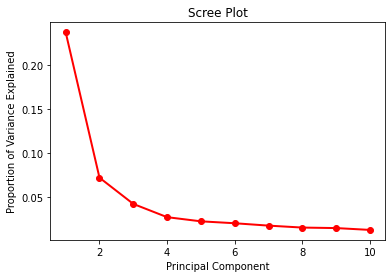

In [ ]:
#NUMBER OF COMPONENTS PCA :
import numpy as np
import matplotlib
import matplotlib.pyplot as plt

pca = PCA(n_components=10)
pca_component = pca.fit_transform(vectorized_docs)

PC_values = np.arange(pca.n_components_) + 1
plt.plot(PC_values, pca.explained_variance_ratio_, 'ro-', linewidth=2)
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Proportion of Variance Explained')
plt.show()

On peut prendre le nombre de composantes principal entre 2 & 4 

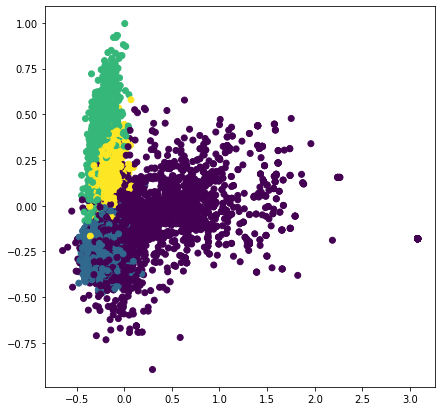

In [ ]:
pca = PCA(n_components=3)
pca_components = pca.fit_transform(vectorized_docs)
reduced_data["PCA"] = pca_components

#---------------plot----------------------------------

f = plt.figure(figsize=(7,7))
PCA_components = pd.DataFrame(pca_components)
plt.scatter(PCA_components[0], PCA_components[1],c=true_labels)
plt.show()

pca with kernel =  linear


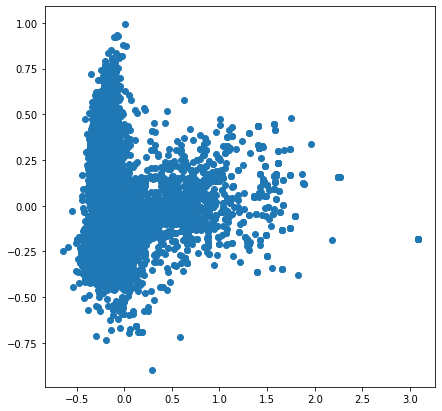

________________________________________________________________________
pca with kernel =  poly


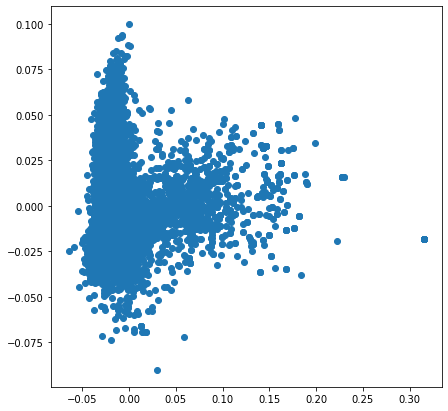

________________________________________________________________________
pca with kernel =  rbf


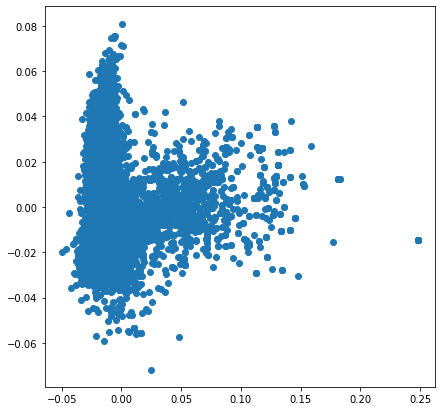

________________________________________________________________________
pca with kernel =  sigmoid


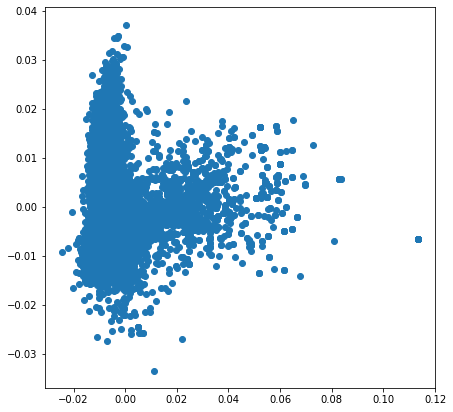

________________________________________________________________________
pca with kernel =  cosine


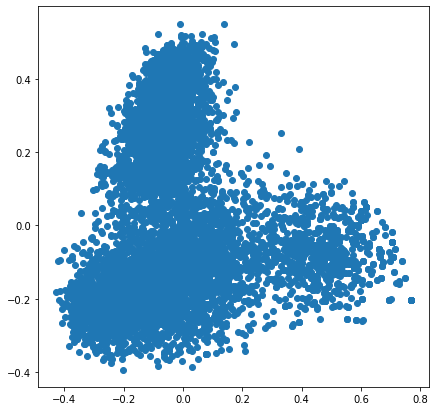

________________________________________________________________________


In [ ]:
#PCA WITH DIFFERENT KERNELS :
from sklearn.decomposition import KernelPCA

list_kernel = ["linear", "poly", "rbf", "sigmoid","cosine"]
for i in list_kernel:
  transformer = KernelPCA(n_components=4, kernel=i)
  X_transformed = transformer.fit_transform(vectorized_docs)
  if i == "cosine":
    reduced_data["cosine"] = X_transformed 
  f = plt.figure(figsize=(7,7))
  PCA_componentss = pd.DataFrame(X_transformed)
  plt.scatter(PCA_componentss[0], PCA_componentss[1])
  print("pca with kernel = ",i)
  plt.show()
  print("________________________________________________________________________")

#### **T-SNE :**

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,


tsne init = 'pca'


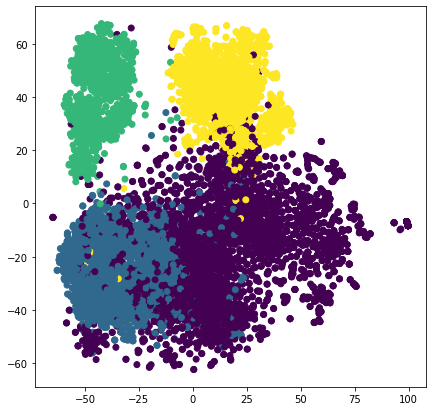

In [ ]:
tsne_components = TSNE(n_components=2,init='pca').fit_transform(vectorized_docs)
reduced_data["TSNE"] = tsne_components

#------------------plot-----------------

f = plt.figure(figsize=(7,7))
print("tsne init = 'pca'")
TSNE_components = pd.DataFrame(tsne_components) #tsne with inti ='pca'
plt.scatter(TSNE_components[0], TSNE_components[1],c=true_labels)
plt.show()

#### **UMAP :**

In [ ]:
!pip install umap-learn
import umap

/usr/local/lib/python3.7/dist-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.
  warnings.warn(problem)


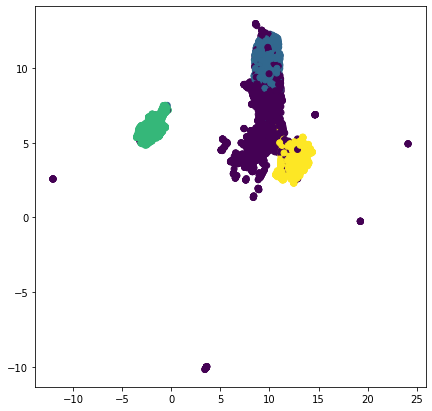

In [ ]:
reducer = umap.UMAP()
umap_components = reducer.fit_transform(vectorized_docs)
reduced_data["UMAP"] = umap_components
umap_components.shape

#----------------plot---------------------
f = plt.figure(figsize=(7,7))
UMAP_components = pd.DataFrame(umap_components) 
plt.scatter(UMAP_components[0], UMAP_components[1],c=true_labels)
plt.show()

#### **Commentaire reduction de la dimension :**
En regardant le plot de chacune des méthodes et en ignorant les couleurs (true labels) on constate que :

- PCA : 
    - on peut voir une à deux classes (au lieu de 4 classes) 
    - PCA avec kernel différent a donné presque le même résultat avec le kernel linéaire sauf pour 'cosine' qui a mieux séparé les choses 

- TSNE & UMAP : 
    - Dans chacun des deux plot on peut voir au max trois classes

    - Résultats des deux méthodes sont trés similaires vu que les deux méthodes se basent sur local clustering par contre UMAP a fait le travail legèrment mieu que T-SNE vu qu'elle est plus fidèle à la structure global de données, plus rapide et moins couteuse

### **Clustering :**

#### **K-means :**

original  Data
plot with predicted labels


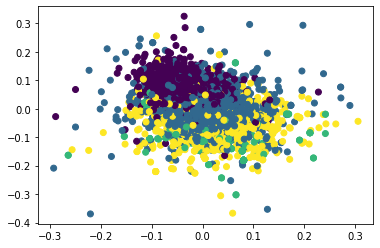

plot with true labels


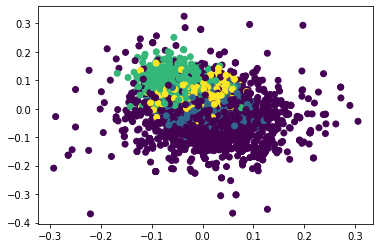

Word2vec : Kmeans clustering on  original  data accuracy :  0.21902748414376322
Word2vec : Kmeans clustering on  original  data NMI :  0.4851712208557278
Word2vec : Kmeans clustering on  original  data ARI :  0.3222797582704375
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


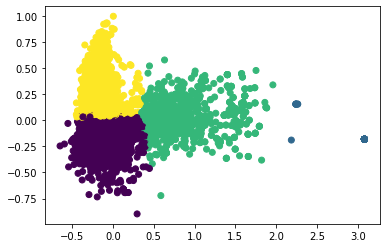

plot with true labels


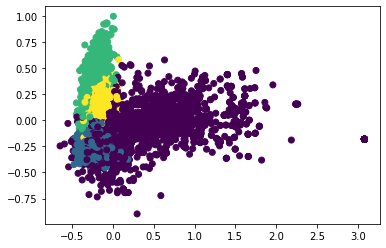

Word2vec : Kmeans clustering on  PCA  data accuracy :  0.47864693446088796
Word2vec : Kmeans clustering on  PCA  data NMI :  0.4646520846836809
Word2vec : Kmeans clustering on  PCA  data ARI :  0.3161765199370398
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


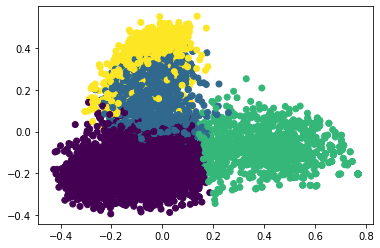

plot with true labels


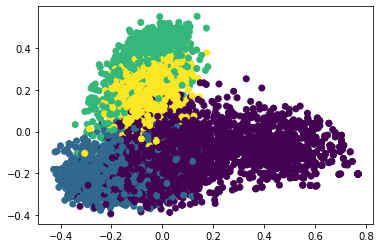

Word2vec : Kmeans clustering on  cosine  data accuracy :  0.253276955602537
Word2vec : Kmeans clustering on  cosine  data NMI :  0.6279469482946326
Word2vec : Kmeans clustering on  cosine  data ARI :  0.43601129515617276
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


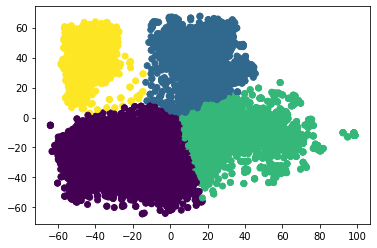

plot with true labels


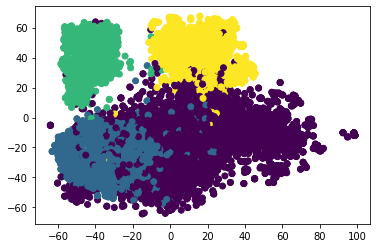

Word2vec : Kmeans clustering on  TSNE  data accuracy :  0.1678646934460888
Word2vec : Kmeans clustering on  TSNE  data NMI :  0.6533677444628663
Word2vec : Kmeans clustering on  TSNE  data ARI :  0.5018710237371768
________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


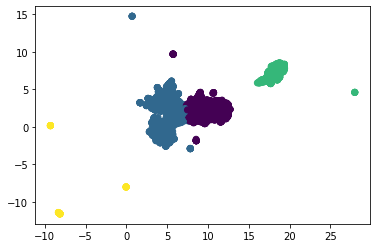

plot with true labels


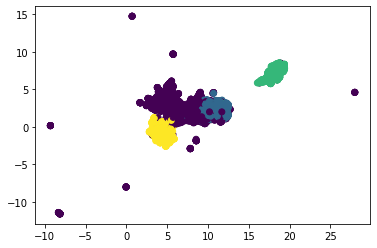

Word2vec : Kmeans clustering on  UMAP  data accuracy :  0.36983791402396055
Word2vec : Kmeans clustering on  UMAP  data NMI :  0.5638447132439975
Word2vec : Kmeans clustering on  UMAP  data ARI :  0.3596361257782599
________________________________________________________________________________________________________


In [ ]:
def kmeans_runner(key,K,true_labels):
  kmeans = KMeans(n_clusters=K, random_state=0,n_init=5).fit(reduced_data[key])
  y_pred = kmeans.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('Word2vec : Kmeans clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('Word2vec : Kmeans clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('Word2vec : Kmeans clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))  

  print("________________________________________________________________________________________________________")


K = 4
for a in reduced_data.keys():
  kmeans_runner(a,K,true_labels)

Commentaire K-means Clustering :

En terme d'accuracy : TSNE a donné le plus mauvais résultat et ca prouve que c'est déconseillé de faire suivre TSNE par une K-means 
  - Le problème avec t-SNE est qu'elle ne préserve pas les distances ni la densité. elle ne préserve que dans une certaine mesure les voisins les plus proches. La différence est subtile, mais affecte tout algorithme basé sur la densité ou la distance ce qui est le cas pour K-means

PCA ( linear kernel) a donné le meilleur résulat (47%) par rapport aux autres résultats




#### **Spectral clustering :**

original  Data
plot with predicted labels


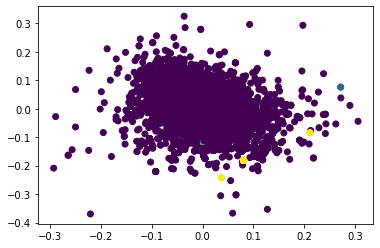

plot with true labels


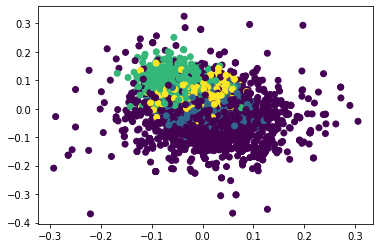

Word2vec : spectral clustering on  original  data accuracy :  0.44200140944326993
Word2vec : spectral clustering on  original  data NMI :  0.011432439464275107
Word2vec : spectral clustering on  original  data ARI :  -0.007784530943189727
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


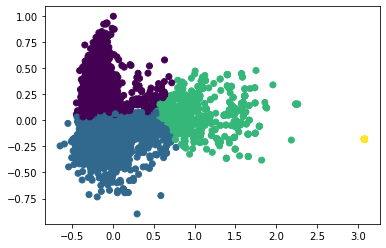

plot with true labels


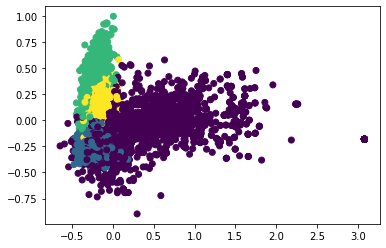

Word2vec : spectral clustering on  PCA  data accuracy :  0.23255813953488372
Word2vec : spectral clustering on  PCA  data NMI :  0.44871444007371325
Word2vec : spectral clustering on  PCA  data ARI :  0.3210521050916887
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


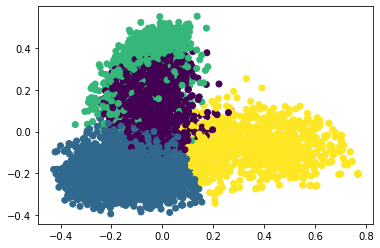

plot with true labels


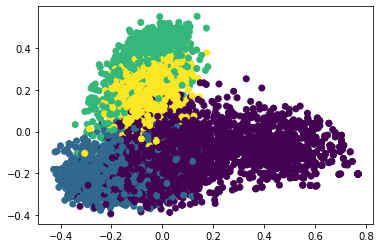

Word2vec : spectral clustering on  cosine  data accuracy :  0.3916842847075405
Word2vec : spectral clustering on  cosine  data NMI :  0.6036230644293806
Word2vec : spectral clustering on  cosine  data ARI :  0.43125705240878764
________________________________________________________________________________________________________


KeyboardInterrupt: ignored

In [ ]:
def spec_clust_runner(key,K,true_labels):

  spectral_clust = SpectralClustering(n_clusters=K,assign_labels='discretize',random_state=0).fit(reduced_data[key])
  y_pred = spectral_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('Word2vec : spectral clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('Word2vec : spectral clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('Word2vec : spectral clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 4
for a in reduced_data.keys():
  spec_clust_runner(a,K,true_labels)

En comparant le Spectral clustering & k-means :

L'accuracy a augmenté pour Spectral clustering par rapport au k-means dans le cas de données originaux + pca non linéaire (cosine kernel)

En revanche on a remaqué une baisse d'accuracy dans le cas du pca linéaire ( linear kernel)

Meme en terme de visualisation : non linear pca ("cosine") a donné un affichage qui ressemble à l'affichage en utilisant les vrai labels

Sinon en terme de temps d'éxecution malgré que le spectral clustering se base sur la méthode k-means mais pas sur les coordonnées originales, mais sur un embedding qui se focalise sur la connectivité, donc au lieu de minimiser les erreurs au carré dans l'input, il minimise les erreurs au carré sur la capacité à reconstruire les voisins et c'est souvent mieux.

#### **HDBSCAN :**

In [ ]:
#!pip install hdbscan
import hdbscan

original  Data
plot with predicted labels


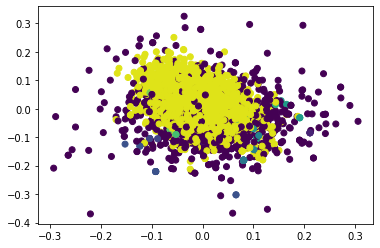

plot with true labels


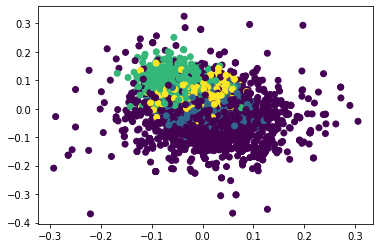

Word2vec : hdbscan clustering on  original  data accuracy :  0.0007047216349541931
Word2vec : hdbscan clustering on  original  data NMI :  0.14702649639336854
Word2vec : hdbscan clustering on  original  data ARI :  -0.056126635689044
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


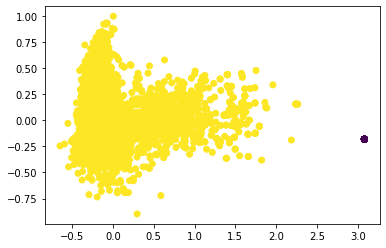

plot with true labels


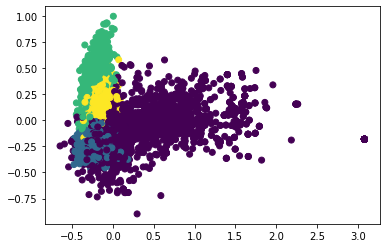

Word2vec : hdbscan clustering on  PCA  data accuracy :  0.21324876673713883
Word2vec : hdbscan clustering on  PCA  data NMI :  0.008988591125835523
Word2vec : hdbscan clustering on  PCA  data ARI :  -0.006089501721145965
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


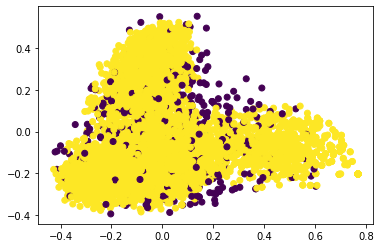

plot with true labels


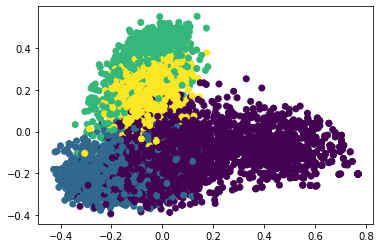

Word2vec : hdbscan clustering on  cosine  data accuracy :  0.2018322762508809
Word2vec : hdbscan clustering on  cosine  data NMI :  0.011968990814850262
Word2vec : hdbscan clustering on  cosine  data ARI :  -0.00975957304640384
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


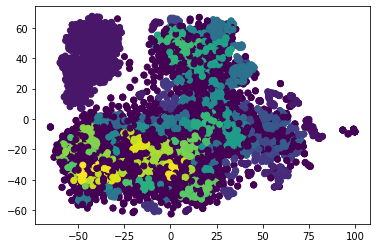

plot with true labels


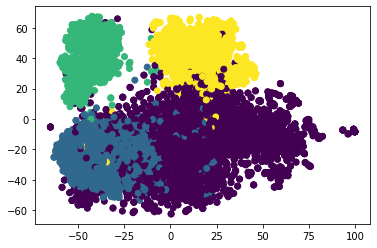

Word2vec : hdbscan clustering on  TSNE  data accuracy :  0.0007047216349541931
Word2vec : hdbscan clustering on  TSNE  data NMI :  0.35045024738345987
Word2vec : hdbscan clustering on  TSNE  data ARI :  0.14720109720523894
________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


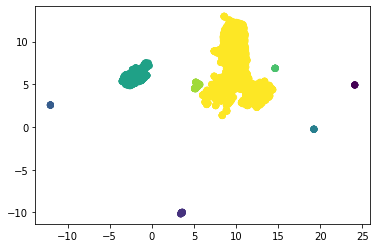

plot with true labels


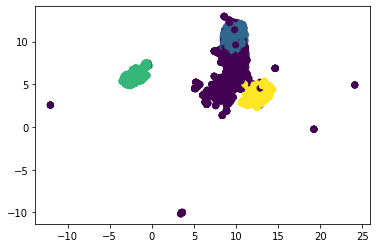

Word2vec : hdbscan clustering on  UMAP  data accuracy :  0.008315715292459478
Word2vec : hdbscan clustering on  UMAP  data NMI :  0.4437259658396501
Word2vec : hdbscan clustering on  UMAP  data ARI :  0.2272635164866172
________________________________________________________________________________________________________


In [ ]:
def hdbscan_runner(key,true_labels):
  hdbscan_clust = hdbscan.HDBSCAN(algorithm='best', alpha=1.0, metric='euclidean',cluster_selection_epsilon=1.0).fit(reduced_data[key])
  y_pred = hdbscan_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('Word2vec : hdbscan clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('Word2vec : hdbscan clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('Word2vec : hdbscan clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 4
for a in reduced_data.keys():
  hdbscan_runner(a,true_labels)

En terme d'accuracy : aucun algorithme a donné des bons résultats 

Pour original data : l'algorithme n'a pas donné de bons résultat vu qu'il est pas trés bon en high dimensional clustering 

linear & non linear pca sont les algorithmes qui ont donné les meilleurs résultats par rapport aux autres algorithmes (avec un accuracy ~ 20%)

#### **CAH :**

original  Data
plot with predicted labels


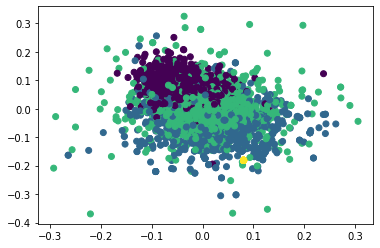

plot with true labels


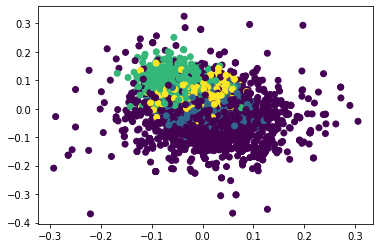

Word2vec : cah clustering on  original  data accuracy :  0.0204369274136716
Word2vec : cah clustering on  original  data NMI :  0.5236524088999778
Word2vec : cah clustering on  original  data ARI :  0.3531278774686336
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


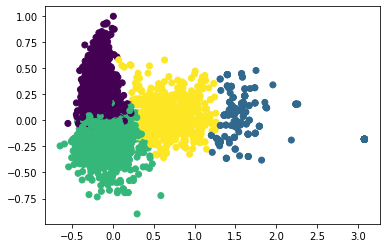

plot with true labels


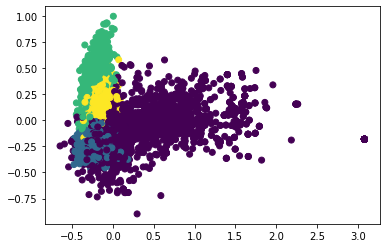

Word2vec : cah clustering on  PCA  data accuracy :  0.025933756166314305
Word2vec : cah clustering on  PCA  data NMI :  0.4580408758233036
Word2vec : cah clustering on  PCA  data ARI :  0.30437935905103186
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


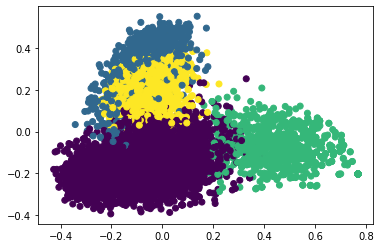

plot with true labels


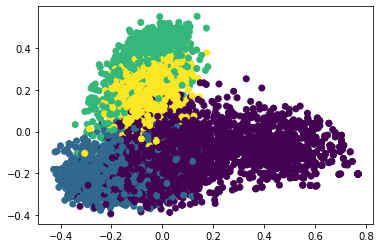

Word2vec : cah clustering on  cosine  data accuracy :  0.49076814658210005
Word2vec : cah clustering on  cosine  data NMI :  0.6600226478683561
Word2vec : cah clustering on  cosine  data ARI :  0.4592326464497625
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


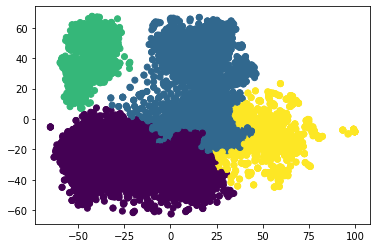

plot with true labels


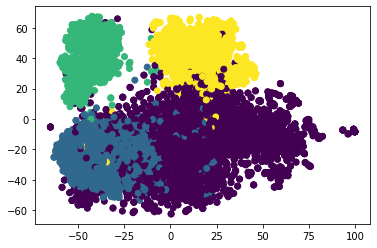

Word2vec : cah clustering on  TSNE  data accuracy :  0.3337561663143058
Word2vec : cah clustering on  TSNE  data NMI :  0.5853118286678372
Word2vec : cah clustering on  TSNE  data ARI :  0.367822422354171
________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


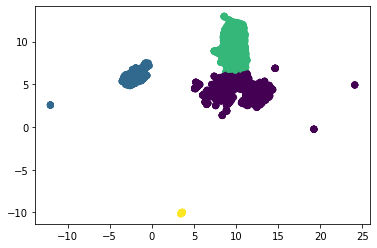

plot with true labels


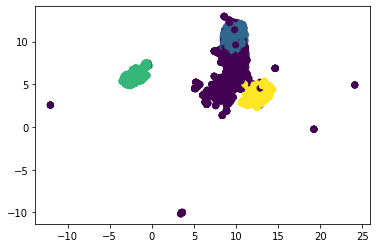

Word2vec : cah clustering on  UMAP  data accuracy :  0.19323467230443975
Word2vec : cah clustering on  UMAP  data NMI :  0.5650478341799581
Word2vec : cah clustering on  UMAP  data ARI :  0.3648741802761773
________________________________________________________________________________________________________


In [ ]:
def cah_runner(key,K,true_labels):
  y_pred = AgglomerativeClustering(n_clusters = K).fit_predict(reduced_data[key])
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('Word2vec : cah clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('Word2vec : cah clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('Word2vec : cah clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 4
for a in reduced_data.keys():
  cah_runner(a,K,true_labels)

PCA("cosine kernel") a donné le meilleur résultas en terme d'accuracy (50%)et visualisation (affichages avec predicted & true labels trés similaires) 

linear PCA + original data : ont donné une accuracy trés basse

NMI & ARI : résultat similaires pour tout les algorithmes

LA cah reste toujours non adapté aux grands volumes de données à cause du temps de calcul qui explose et cela s’explique complètement par les méthodes de calcul de l’algorithme.


##Partie 2 Word2Vec :

###DCN for Classic4 :

In [ ]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
embeddings_DCN_Classic4, cluster_assign_DCN_Classic4 = DCN(vectorized_docs_array, 4, 2, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data = {}
reduced_data['DCN']=embeddings_DCN_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:12<00:00,  4.11it/s]


Running k-means on the learned embeddings...
Starting DCN training...


100%|██████████| 50/50 [00:46<00:00,  1.07it/s]


###DKM for classic4 :

In [ ]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
X_reduced_DKM_Classic4, cluster_assign_DKM_Classic4 = DKM(vectorized_docs_array, 4, 2, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data['DKM']=X_reduced_DKM_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:11<00:00,  4.44it/s]


Running k-means on the learned embeddings...
Starting DKM training...


100%|██████████| 20/20 [00:34<00:00,  1.71s/it]


###Plot Function Classic4:

DCN  Data
plot with predicted labels


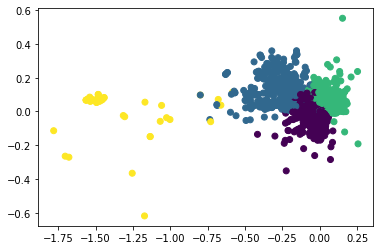

plot with true labels


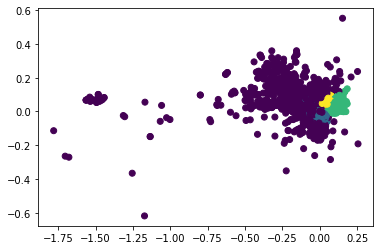

Word2vec : clustering with  DCN  data accuracy :  0.4307258632840028
Word2vec : clustering with  DCN  data NMI :  0.45331751061653136
Word2vec : clustering with  DCN  data ARI :  0.29990841745006624
________________________________________________________________________________________________________
DKM  Data
plot with predicted labels


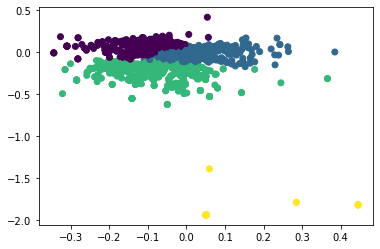

plot with true labels


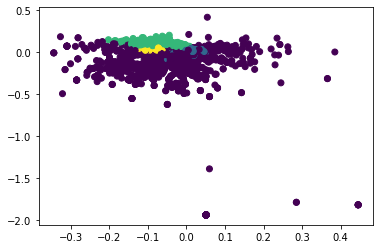

Word2vec : clustering with  DKM  data accuracy :  0.2553911205073996
Word2vec : clustering with  DKM  data NMI :  0.45532830430598387
Word2vec : clustering with  DKM  data ARI :  0.29899068299980774
________________________________________________________________________________________________________


In [ ]:
def plot_result(key,true_labels,predicted_labels):
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=predicted_labels)
  plt.show()

  #-------
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('Word2vec : clustering with ',key,' data accuracy : ',accuracy_score(true_labels,predicted_labels))
  print('Word2vec : clustering with ',key,' data NMI : ',normalized_mutual_info_score(true_labels,predicted_labels))
  print('Word2vec : clustering with ',key,' data ARI : ',adjusted_rand_score(true_labels,predicted_labels))
  print("________________________________________________________________________________________________________")


K = 4
plot_result("DCN",true_labels,cluster_assign_DCN_Classic4)
plot_result("DKM",true_labels,cluster_assign_DKM_Classic4)



DCN  a gangé en terme d'accuracy 45% vs 25% pour DKM

Par les deux méthodes ont eu les memes score NMI & ARI

## **Glove :**

In [ ]:
!wget -c "https://nlp.stanford.edu/data/glove.840B.300d.zip"
!unzip glove*.zip

--2021-12-05 15:36:13--  https://nlp.stanford.edu/data/glove.840B.300d.zip
Resolving nlp.stanford.edu (nlp.stanford.edu)... 171.64.67.140
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: http://downloads.cs.stanford.edu/nlp/data/glove.840B.300d.zip [following]
--2021-12-05 15:36:14--  http://downloads.cs.stanford.edu/nlp/data/glove.840B.300d.zip
Resolving downloads.cs.stanford.edu (downloads.cs.stanford.edu)... 171.64.64.22
Connecting to downloads.cs.stanford.edu (downloads.cs.stanford.edu)|171.64.64.22|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2176768927 (2.0G) [application/zip]
Saving to: ‘glove.840B.300d.zip’

glove.840B.300d.zip 100%[===================>]   2.03G  5.31MB/s    in 6m 52s  

2021-12-05 15:43:06 (5.04 MB/s) - ‘glove.840B.300d.zip’ saved [2176768927/2176768927]

Archive:  glove.840B.300d.zip
  inflating: glove.840B.300d.txt     


In [ ]:
from gensim.test.utils import datapath, get_tmpfile
from gensim.models import KeyedVectors
from gensim.scripts.glove2word2vec import glove2word2vec

glove_file = datapath("/content/glove.840B.300d.txt")
tmp_file = get_tmpfile("test_word2vec.txt")
_ = glove2word2vec(glove_file, tmp_file)
model = KeyedVectors.load_word2vec_format(tmp_file)

In [ ]:
vectorized_docs = vectorize(sentances, model=model)
len(vectorized_docs), len(vectorized_docs[0])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:17: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).


(7095, 300)

### **Réduction de la dimension :**

In [ ]:
reduced_data = {}
reduced_data['original'] = vectorized_docs

#### **PCA** :

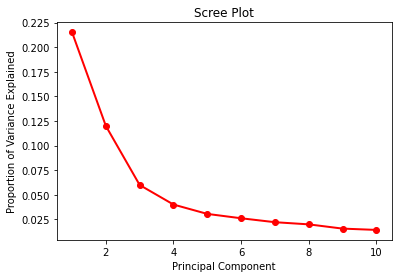

In [ ]:
#NUMBER OF COMPONENTS PCA :

pca = PCA(n_components=10)
pca_component = pca.fit_transform(vectorized_docs)

PC_values = np.arange(pca.n_components_) + 1
plt.plot(PC_values, pca.explained_variance_ratio_, 'ro-', linewidth=2)
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Proportion of Variance Explained')
plt.show()

On peut prendre le nombre de composantes principal entre 3 & 4 

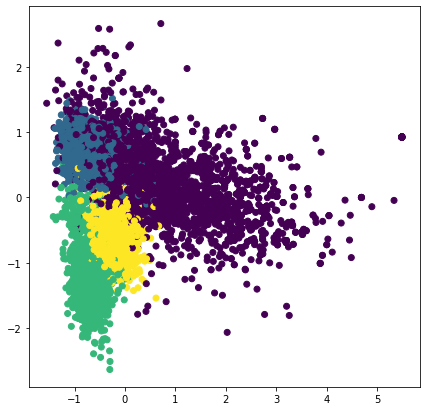

In [ ]:
pca = PCA(n_components=3)
pca_components = pca.fit_transform(vectorized_docs)
reduced_data["PCA"] = pca_components

#---------------plot----------------------------------

f = plt.figure(figsize=(7,7))
PCA_components = pd.DataFrame(pca_components)
plt.scatter(PCA_components[0], PCA_components[1],c=true_labels)
plt.show()

pca with kernel =  linear


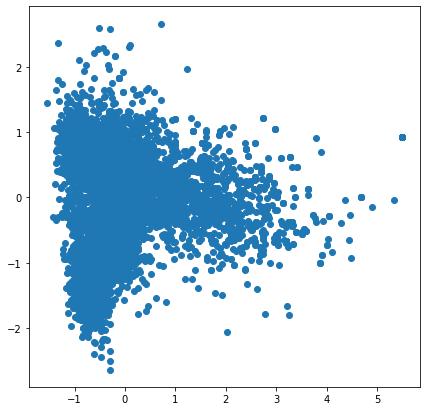

________________________________________________________________________
pca with kernel =  poly


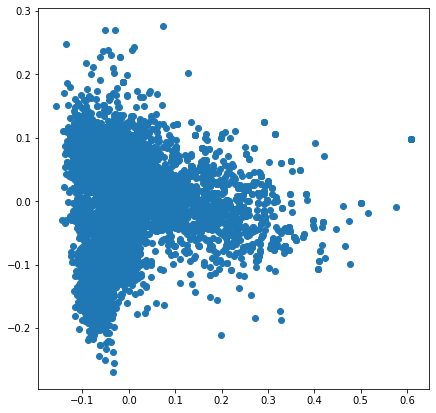

________________________________________________________________________
pca with kernel =  rbf


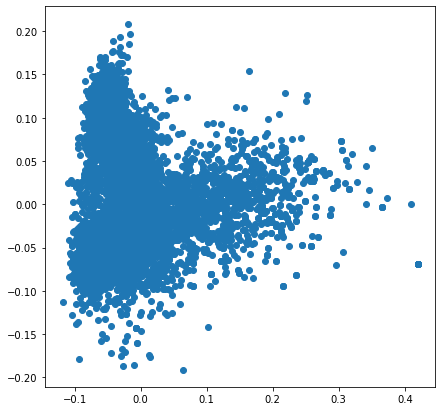

________________________________________________________________________
pca with kernel =  sigmoid


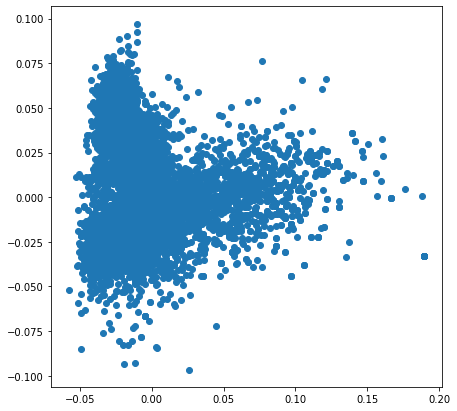

________________________________________________________________________
pca with kernel =  cosine


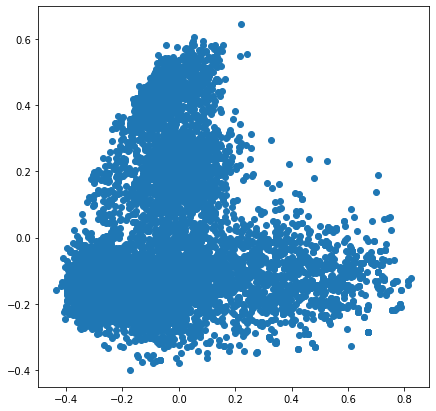

________________________________________________________________________


In [ ]:
#PCA WITH DIFFERENT KERNELS :
from sklearn.decomposition import KernelPCA

list_kernel = ["linear", "poly", "rbf", "sigmoid","cosine"]
for i in list_kernel:
  transformer = KernelPCA(n_components=4, kernel=i)
  X_transformed = transformer.fit_transform(vectorized_docs)
  if i == "cosine":
    reduced_data["cosine"] = X_transformed 
  f = plt.figure(figsize=(7,7))
  PCA_componentss = pd.DataFrame(X_transformed)
  plt.scatter(PCA_componentss[0], PCA_componentss[1])
  print("pca with kernel = ",i)
  plt.show()
  print("________________________________________________________________________")

#### **T-SNE :**

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,


tsne init = 'pca'


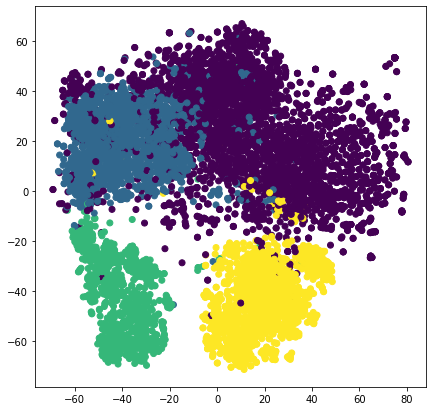

In [ ]:
tsne_components = TSNE(n_components=2,init='pca').fit_transform(vectorized_docs)
reduced_data["TSNE"] = tsne_components

#------------------plot-----------------

f = plt.figure(figsize=(7,7))
print("tsne init = 'pca'")
TSNE_components = pd.DataFrame(tsne_components) #tsne with inti ='pca'
plt.scatter(TSNE_components[0], TSNE_components[1],c=true_labels)
plt.show()

#### **UMAP :**

In [ ]:
!pip install umap-learn
import umap

     |████████████████████████████████| 86 kB 3.3 MB/s 
     |████████████████████████████████| 1.1 MB 39.1 MB/s 
  Created wheel for umap-learn: filename=umap_learn-0.5.2-py3-none-any.whl size=82709 sha256=fe96634fa02cf4f4f02c5e49458773e316a4e678bf5784e34094f60aff71a3f9
  Stored in directory: /root/.cache/pip/wheels/84/1b/c6/aaf68a748122632967cef4dffef68224eb16798b6793257d82
  Created wheel for pynndescent: filename=pynndescent-0.5.5-py3-none-any.whl size=52603 sha256=6936f58743a5acca485ed3fe782d40cc883ad7c41d969dfba59c81a32f9ef2dd
  Stored in directory: /root/.cache/pip/wheels/af/e9/33/04db1436df0757c42fda8ea6796d7a8586e23c85fac355f476
Successfully built umap-learn pynndescent


/usr/local/lib/python3.7/dist-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.
  warnings.warn(problem)


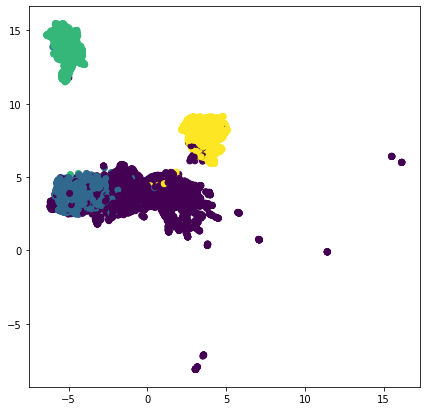

In [ ]:
reducer = umap.UMAP()
umap_components = reducer.fit_transform(vectorized_docs)
reduced_data["UMAP"] = umap_components
umap_components.shape

#----------------plot---------------------
f = plt.figure(figsize=(7,7))
UMAP_components = pd.DataFrame(umap_components) 
plt.scatter(UMAP_components[0], UMAP_components[1],c=true_labels)
plt.show()

#### En comparant les différentes résultats de la réduction de dimension :

on remarque pas une grosse différence entre word2vec et glove 

PCA en (ignorant les couleurs des true labels) on peut voir au max 2 classes

UMAP & TSNE : on peut voir 3 classe au max (la meme chose avec word2vec)


Par contre la visualisation des deux premières composantes du TSNE sur les données w2v et glove est exactement la mêmes (mais inversée en terme d'affichage)

### **Clustering :**

#### **K-means :**

original  Data
plot with predicted labels


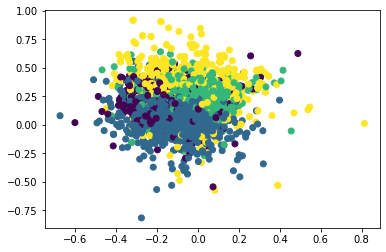

plot with true labels


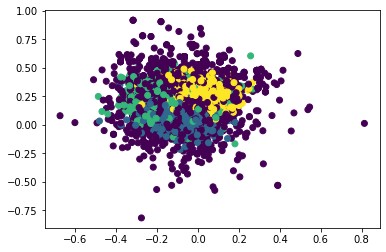

Glove : Kmeans clustering on  original  data accuracy :  0.20972515856236787
Glove : Kmeans clustering on  original  data NMI :  0.6025921010215153
Glove : Kmeans clustering on  original  data ARI :  0.41497694748423813
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


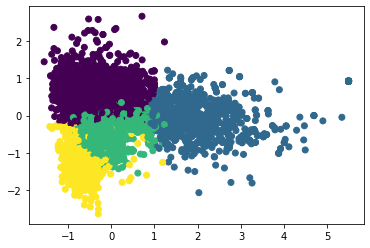

plot with true labels


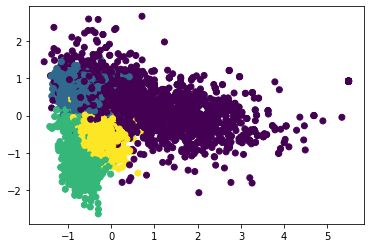

Glove : Kmeans clustering on  PCA  data accuracy :  0.2613107822410148
Glove : Kmeans clustering on  PCA  data NMI :  0.5698095859436703
Glove : Kmeans clustering on  PCA  data ARI :  0.3921485370495791
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


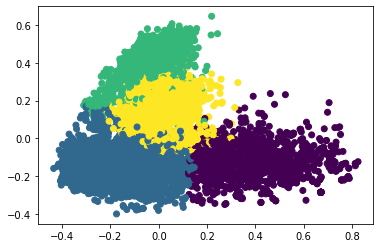

plot with true labels


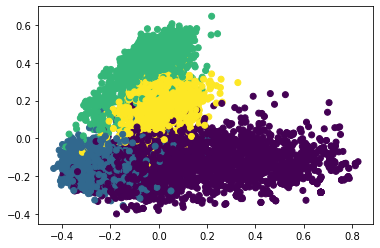

Glove : Kmeans clustering on  cosine  data accuracy :  0.713460183227625
Glove : Kmeans clustering on  cosine  data NMI :  0.623589241820993
Glove : Kmeans clustering on  cosine  data ARI :  0.43823111220058525
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


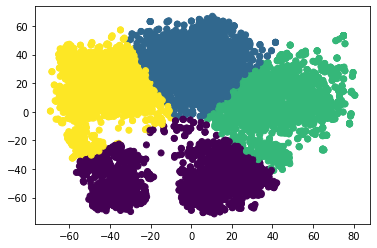

plot with true labels


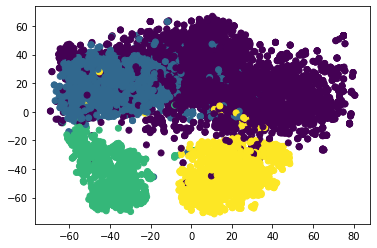

Glove : Kmeans clustering on  TSNE  data accuracy :  0.03791402396053559
Glove : Kmeans clustering on  TSNE  data NMI :  0.500357425034489
Glove : Kmeans clustering on  TSNE  data ARI :  0.3986216600777316
________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


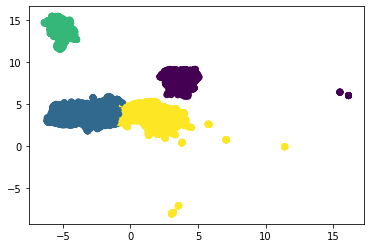

plot with true labels


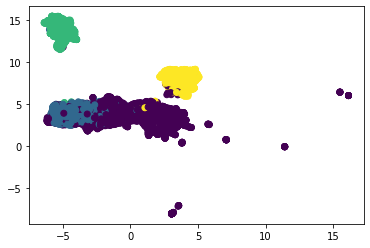

Glove : Kmeans clustering on  UMAP  data accuracy :  0.3575757575757576
Glove : Kmeans clustering on  UMAP  data NMI :  0.6983360108170219
Glove : Kmeans clustering on  UMAP  data ARI :  0.5209853490450926
________________________________________________________________________________________________________


In [ ]:
def kmeans_runner(key,K,true_labels):
  kmeans = KMeans(n_clusters=K, random_state=0,n_init=5).fit(reduced_data[key])
  y_pred = kmeans.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('Glove : Kmeans clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('Glove : Kmeans clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('Glove : Kmeans clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")


K = 4
for a in reduced_data.keys():
  kmeans_runner(a,K,true_labels)

PCA (cosine kernel) a donné le meilleur résultat ~70 % (ce qui justifie la non linéarité de non données en comparant avec les résultats du pca linéaire)

TSNE a donné 50 % d'accuracy 


NMI & ARI  moyenne pour la majorité des algorithmes 
On constate des valeurs de NMI & ARI hausses pour les différents algorithmes



#### **Spectral clustering :**

In [ ]:
def spec_clust_runner(key,K,true_labels):

  spectral_clust = SpectralClustering(n_clusters=K,assign_labels='discretize',random_state=0).fit(reduced_data[key])
  y_pred = spectral_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('Glove : spectral clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('Glove : spectral clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('Glove : spectral clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 4
for a in reduced_data.keys():
  spec_clust_runner(a,K,true_labels)

#### **HDBSCAN :**

In [ ]:
!pip install hdbscan
import hdbscan

     |████████████████████████████████| 6.4 MB 8.7 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for hdbscan: filename=hdbscan-0.8.27-cp37-cp37m-linux_x86_64.whl size=2311907 sha256=b018aa4d598ca983497ff77598fc775578c655a25439a41ee5f406ebff60c046
  Stored in directory: /root/.cache/pip/wheels/73/5f/2f/9a259b84003b84847c259779206acecabb25ab56f1506ee72b
Successfully built hdbscan


original  Data
plot with predicted labels


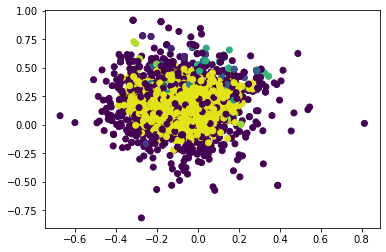

plot with true labels


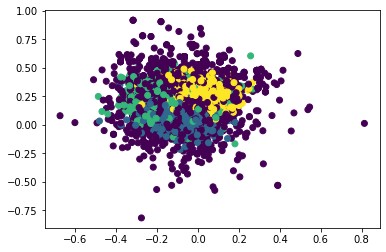

Glove : hdbscan clustering on  original  data accuracy :  0.0007047216349541931
Glove : hdbscan clustering on  original  data NMI :  0.16398652529986674
Glove : hdbscan clustering on  original  data ARI :  -0.00944271344518929
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


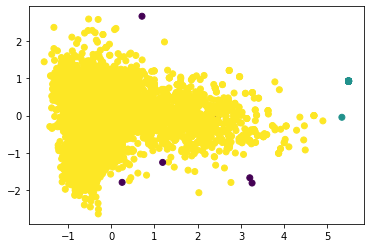

plot with true labels


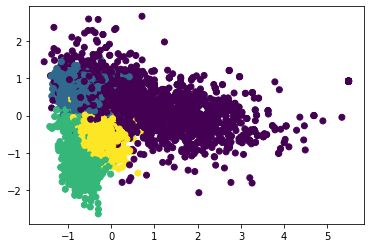

Glove : hdbscan clustering on  PCA  data accuracy :  0.21198026779422127
Glove : hdbscan clustering on  PCA  data NMI :  0.00847380984553289
Glove : hdbscan clustering on  PCA  data ARI :  -0.005775311790969087
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


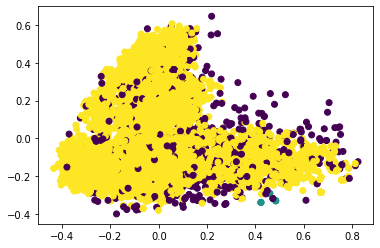

plot with true labels


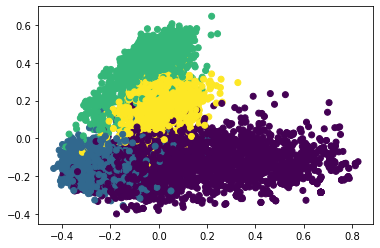

Glove : hdbscan clustering on  cosine  data accuracy :  0.20380549682875265
Glove : hdbscan clustering on  cosine  data NMI :  0.03053965083369513
Glove : hdbscan clustering on  cosine  data ARI :  -0.027396063276863843
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


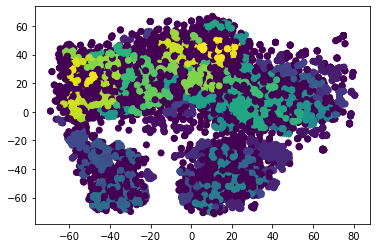

plot with true labels


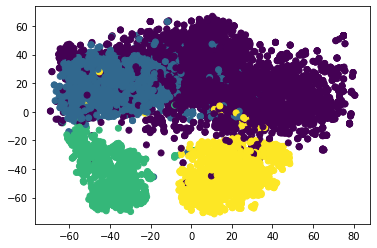

Glove : hdbscan clustering on  TSNE  data accuracy :  0.0012684989429175475
Glove : hdbscan clustering on  TSNE  data NMI :  0.28262648225834625
Glove : hdbscan clustering on  TSNE  data ARI :  0.020537709410245374
________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


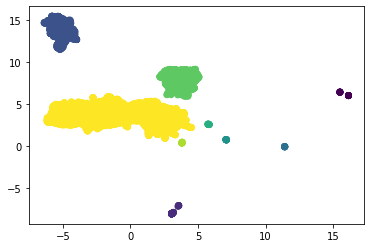

plot with true labels


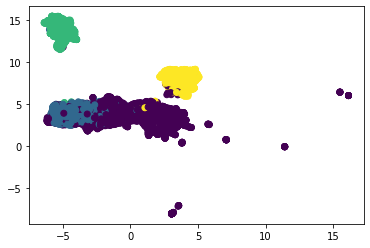

Glove : hdbscan clustering on  UMAP  data accuracy :  0.14573643410852713
Glove : hdbscan clustering on  UMAP  data NMI :  0.713691667490174
Glove : hdbscan clustering on  UMAP  data ARI :  0.5704462964243697
________________________________________________________________________________________________________


In [ ]:
def hdbscan_runner(key,true_labels):
  hdbscan_clust = hdbscan.HDBSCAN(algorithm='best', alpha=1.0, metric='euclidean',cluster_selection_epsilon=1.0).fit(reduced_data[key])
  y_pred = hdbscan_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('Glove : hdbscan clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('Glove : hdbscan clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('Glove : hdbscan clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 4
for a in reduced_data.keys():
  hdbscan_runner(a,true_labels)

#### Commentaire 🇰

Accuracy trés basses pour la majorité des algorithmes, meilleurs résultats pca ~20%

NMI & ARI trés basses pour tous les algorithmes sauf UMAP  qui a obtenue des scores trés considérable (surtout en terme de NMI ~71%)

donc UMAP : meilleur performance avec hdbscan (vu que UMAP se focalise sur le clustering local mais il est toujours fidèle à la structure globale)

#### **CAH :**

original  Data
plot with predicted labels


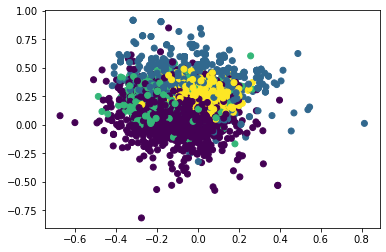

plot with true labels


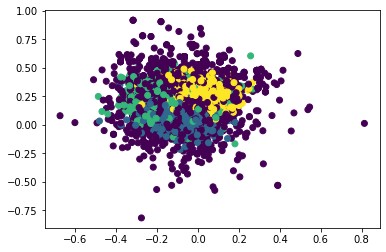

Glove : cah clustering on  original  data accuracy :  0.6346723044397463
Glove : cah clustering on  original  data NMI :  0.6561369557285788
Glove : cah clustering on  original  data ARI :  0.4463732019417088
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


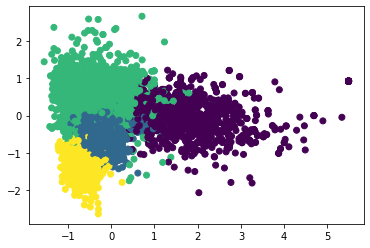

plot with true labels


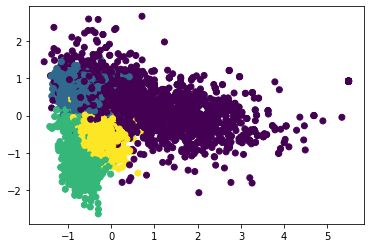

Glove : cah clustering on  PCA  data accuracy :  0.18449612403100776
Glove : cah clustering on  PCA  data NMI :  0.5927442265353383
Glove : cah clustering on  PCA  data ARI :  0.40823616477619545
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


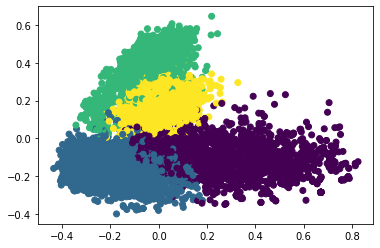

plot with true labels


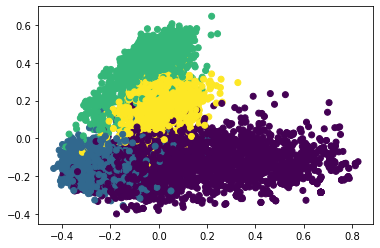

Glove : cah clustering on  cosine  data accuracy :  0.7787174066243834
Glove : cah clustering on  cosine  data NMI :  0.6787128805014035
Glove : cah clustering on  cosine  data ARI :  0.5190768906310643
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


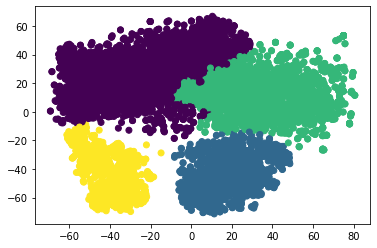

plot with true labels


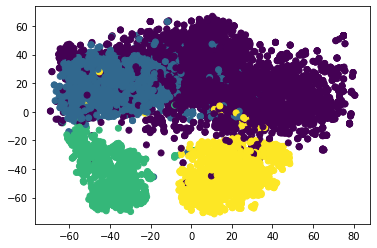

Glove : cah clustering on  TSNE  data accuracy :  0.18604651162790697
Glove : cah clustering on  TSNE  data NMI :  0.7055771145887959
Glove : cah clustering on  TSNE  data ARI :  0.5426978282716444
________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


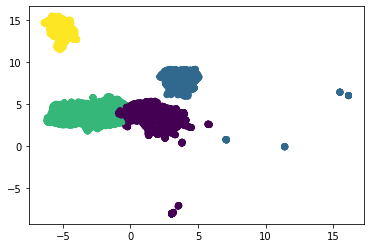

plot with true labels


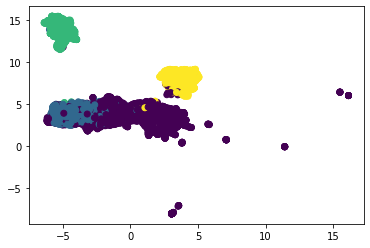

Glove : cah clustering on  UMAP  data accuracy :  0.2394644115574348
Glove : cah clustering on  UMAP  data NMI :  0.688845685611153
Glove : cah clustering on  UMAP  data ARI :  0.5159301606854643
________________________________________________________________________________________________________


In [ ]:
def cah_runner(key,K,true_labels):
  y_pred = AgglomerativeClustering(n_clusters = K).fit_predict(reduced_data[key])
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('Glove : cah clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('Glove : cah clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('Glove : cah clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 4
for a in reduced_data.keys():
  cah_runner(a,K,true_labels)

#### Commentaire 🇰

Cah sur original data (glove) a donné des meilleurs résultats en comparant avec ce qui a été obtenue avec les embedding de W2V 


PCA (cosine kernel) meilleur accuracy (77%) vs 18% du PCA linéaire

nmi elevé pour la majorité des algorithmes 

##Partie 2  Glove:

###DCN for Classic4 :

In [ ]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
embeddings_DCN_Classic4, cluster_assign_DCN_Classic4 = DCN(vectorized_docs_array, 4, 2, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data = {}
reduced_data['DCN']=embeddings_DCN_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:13<00:00,  3.59it/s]


Running k-means on the learned embeddings...
Starting DCN training...


100%|██████████| 50/50 [00:46<00:00,  1.07it/s]


###DKM for classic4 :

In [ ]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
X_reduced_DKM_Classic4, cluster_assign_DKM_Classic4 = DKM(vectorized_docs_array, 4, 2, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data['DKM']=X_reduced_DKM_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:14<00:00,  3.54it/s]


Running k-means on the learned embeddings...
Starting DKM training...


100%|██████████| 20/20 [00:37<00:00,  1.86s/it]


###Plot Function Classic4:

DCN  Data
plot with predicted labels


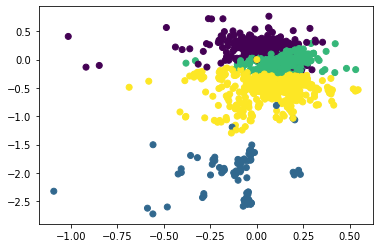

plot with true labels


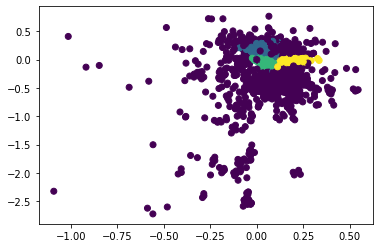

Word2vec : Kmeans clustering on  DCN  data accuracy :  0.31360112755461594
Word2vec : Kmeans clustering on  DCN  data NMI :  0.3847640227277448
Word2vec : Kmeans clustering on  DCN  data ARI :  0.18623718759639546
________________________________________________________________________________________________________
DKM  Data
plot with predicted labels


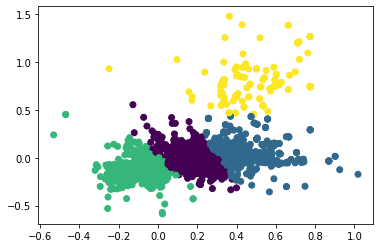

plot with true labels


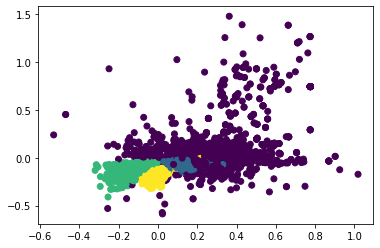

Word2vec : Kmeans clustering on  DKM  data accuracy :  0.4749823819591261
Word2vec : Kmeans clustering on  DKM  data NMI :  0.4996156720838506
Word2vec : Kmeans clustering on  DKM  data ARI :  0.35847964839308083
________________________________________________________________________________________________________


In [ ]:
def plot_result(key,true_labels,predicted_labels):
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=predicted_labels)
  plt.show()

  #-------
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('Word2vec : clustering on ',key,' data accuracy : ',accuracy_score(true_labels,predicted_labels))
  print('Word2vec : clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,predicted_labels))
  print('Word2vec : clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,predicted_labels))
  print("________________________________________________________________________________________________________")


K = 4
plot_result("DCN",true_labels,cluster_assign_DCN_Classic4)
plot_result("DKM",true_labels,cluster_assign_DKM_Classic4)



En prenant les résultats des 3 algorithmes :

DKM a obtenu des meilleurs résultats (mais loin d'être bon toujours en dessous de 50% )

#### Commentaire général : 

en terme général : nos différents algorithms ont donné des meilleurs performance (parfois différence légère) sur les embedding du Glove par rapport au embedding de W2V en terme de visualisation & evaluations

#### Comparaison w2v glove : 

Word2Vec permet de prédire les mots en fonction de leur

contexte en utilisant l'un des deux modèles : CBOW et Skip-Gram

GLOVE est basé sur les occurrences de mots dans un corpus textuel. En fait, il est basé sur deux étapes principales.

- La première est la construction d'une matrice de cooccurrence X à partir d'un corpus d'entraînement
- La deuxième étape est la factorisation de X afin d'obtenir des vecteurs

## **BERT :**

### **Document embedding :**

In [ ]:
true_labels, u  = pd.factorize(df['label'])

In [ ]:
!pip install -U sentence-transformers
from sentence_transformers import SentenceTransformer
model = SentenceTransformer('bert-base-nli-mean-tokens')

In [ ]:
vectorized_docs = model.encode(abstract)

### **Réduction de la dimension :**

In [ ]:
reduced_data = {}
reduced_data['original'] = vectorized_docs

#### **PCA** :

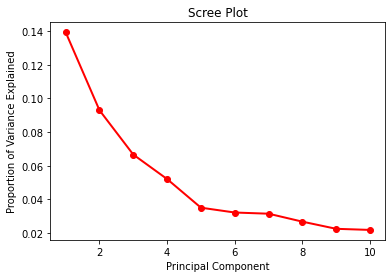

In [ ]:
#NUMBER OF COMPONENTS PCA :
pca = PCA(n_components=10)
pca_component = pca.fit_transform(vectorized_docs)

PC_values = np.arange(pca.n_components_) + 1
plt.plot(PC_values, pca.explained_variance_ratio_, 'ro-', linewidth=2)
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Proportion of Variance Explained')
plt.show()

On peut prendre le nombre de composantes principal = 5

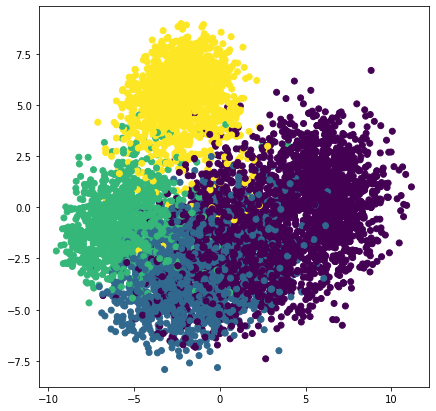

In [ ]:
pca = PCA(n_components=5)
pca_components = pca.fit_transform(vectorized_docs)
reduced_data["PCA"] = pca_components

#---------------plot----------------------------------

f = plt.figure(figsize=(7,7))
PCA_components = pd.DataFrame(pca_components)
plt.scatter(PCA_components[0], PCA_components[1],c=true_labels)
plt.show()

pca with kernel =  linear


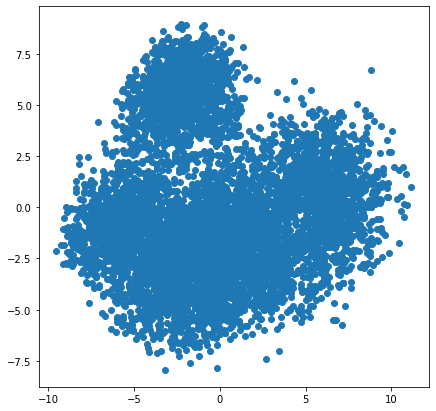

________________________________________________________________________
pca with kernel =  poly


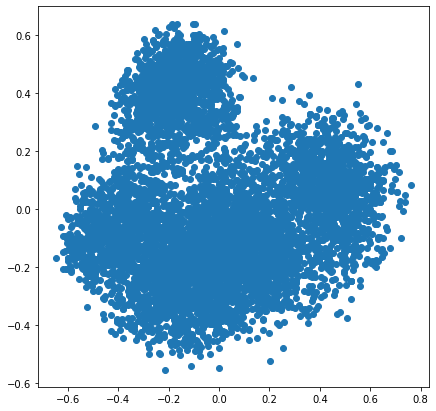

________________________________________________________________________
pca with kernel =  rbf


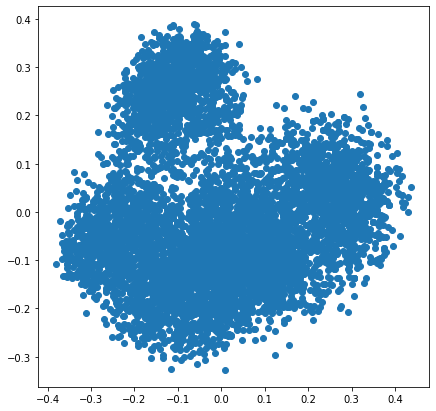

________________________________________________________________________
pca with kernel =  sigmoid


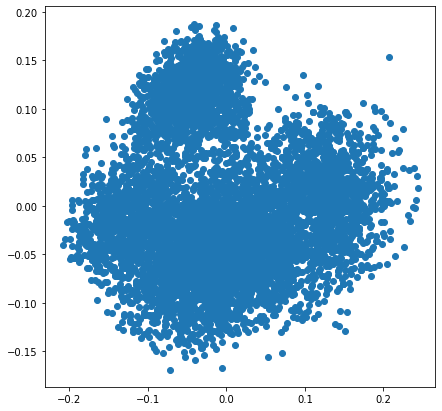

________________________________________________________________________
pca with kernel =  cosine


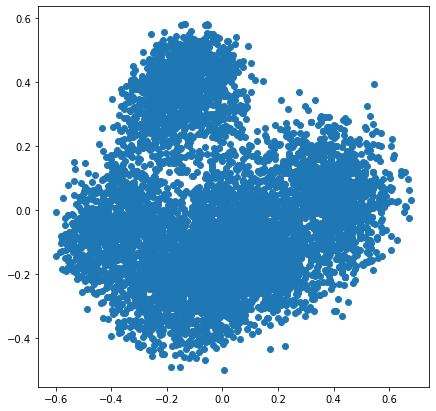

________________________________________________________________________


In [ ]:
#PCA WITH DIFFERENT KERNELS :
from sklearn.decomposition import KernelPCA

list_kernel = ["linear", "poly", "rbf", "sigmoid","cosine"]
for i in list_kernel:
  transformer = KernelPCA(n_components=4, kernel=i)
  X_transformed = transformer.fit_transform(vectorized_docs)
  if i == "cosine":
    reduced_data["cosine"] = X_transformed 
  f = plt.figure(figsize=(7,7))
  PCA_componentss = pd.DataFrame(X_transformed)
  plt.scatter(PCA_componentss[0], PCA_componentss[1])
  print("pca with kernel = ",i)
  plt.show()
  print("________________________________________________________________________")

#### **T-SNE :**

tsne init = 'pca'


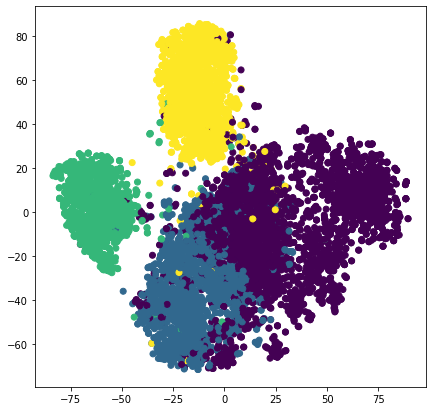

In [ ]:
tsne_components = TSNE(n_components=2,init='pca').fit_transform(vectorized_docs)
reduced_data["TSNE"] = tsne_components

#------------------plot-----------------

f = plt.figure(figsize=(7,7))
print("tsne init = 'pca'")
TSNE_components = pd.DataFrame(tsne_components) #tsne with inti ='pca'
plt.scatter(TSNE_components[0], TSNE_components[1],c=true_labels)
plt.show()

#### **UMAP :**

In [ ]:
!pip install umap-learn
import umap

     |████████████████████████████████| 86 kB 3.1 MB/s 
     |████████████████████████████████| 1.1 MB 31.7 MB/s 
  Created wheel for umap-learn: filename=umap_learn-0.5.2-py3-none-any.whl size=82709 sha256=2d6885a1a45adc3cea1327f91125f142705007390b04573b08ea174786f3b7b2
  Stored in directory: /root/.cache/pip/wheels/84/1b/c6/aaf68a748122632967cef4dffef68224eb16798b6793257d82
  Created wheel for pynndescent: filename=pynndescent-0.5.5-py3-none-any.whl size=52603 sha256=cc87db5cf00a97f42afd214dfab45f08deb73ac804e66262074bcdf7ab256685
  Stored in directory: /root/.cache/pip/wheels/af/e9/33/04db1436df0757c42fda8ea6796d7a8586e23c85fac355f476
Successfully built umap-learn pynndescent


/usr/local/lib/python3.7/dist-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.
  warnings.warn(problem)


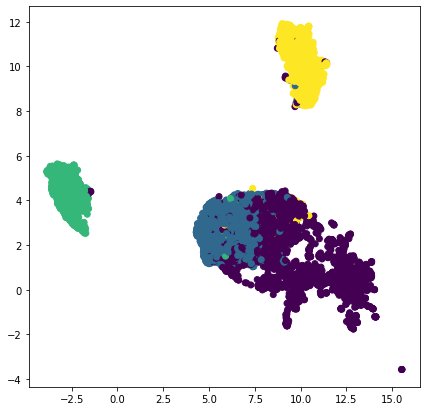

In [ ]:
reducer = umap.UMAP()
umap_components = reducer.fit_transform(vectorized_docs)
reduced_data["UMAP"] = umap_components
umap_components.shape

#----------------plot---------------------
f = plt.figure(figsize=(7,7))
UMAP_components = pd.DataFrame(umap_components) 
plt.scatter(UMAP_components[0], UMAP_components[1],c=true_labels)
plt.show()

#### **Commentaire reduction de la dimension :**
En regardant le plot de chacune des méthodes et en ignorant les couleurs (true labels) on constate que :

- PCA : 
    - on peut voir une à deux classes (au lieu de 4 classes) 
    - PCA avec kernel différent a donné presque le même résultat avec le kernel linéaire sauf pour 'cosine' qui a mieux séparé les choses 

- TSNE & UMAP : 
    - Dans chacun des deux plot on peut voir au max trois classes

    - Résultats des deux méthodes sont trés similaires vu que les deux méthodes se basent sur local clustering par contre UMAP a fait le travail legèrment mieu que T-SNE vu qu'elle est plus fidèle à la structure global de données, plus rapide et moins couteuse

### **Clustering :**

#### **K-means :**

original  Data
plot with predicted labels


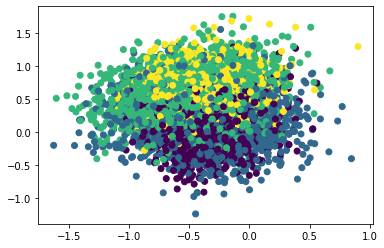

plot with true labels


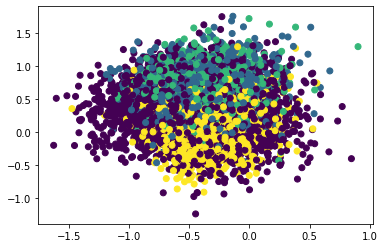

Word2vec : Kmeans clustering on  original  data accuracy :  0.012544045102184638
Word2vec : Kmeans clustering on  original  data NMI :  0.6136521476420331
Word2vec : Kmeans clustering on  original  data ARI :  0.46954166290759425
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


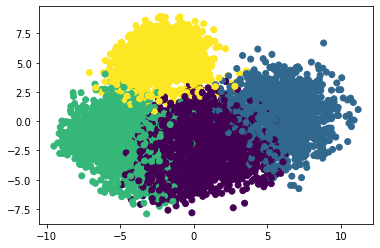

plot with true labels


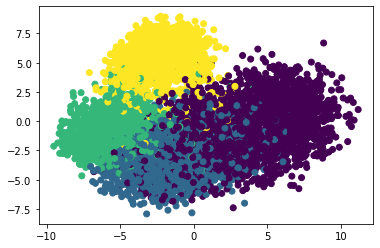

Word2vec : Kmeans clustering on  PCA  data accuracy :  0.5385482734319944
Word2vec : Kmeans clustering on  PCA  data NMI :  0.5755913497557628
Word2vec : Kmeans clustering on  PCA  data ARI :  0.44665343491329745
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


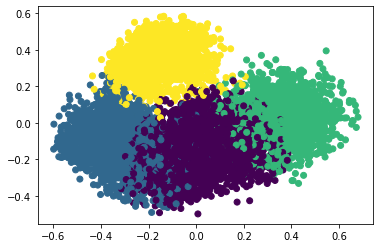

plot with true labels


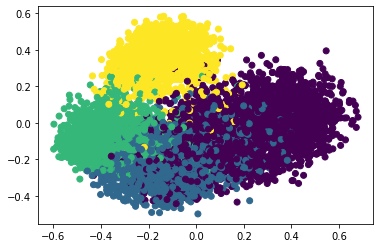

Word2vec : Kmeans clustering on  cosine  data accuracy :  0.4463706835799859
Word2vec : Kmeans clustering on  cosine  data NMI :  0.5709887579330799
Word2vec : Kmeans clustering on  cosine  data ARI :  0.4462277708121335
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


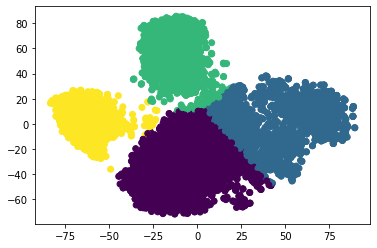

plot with true labels


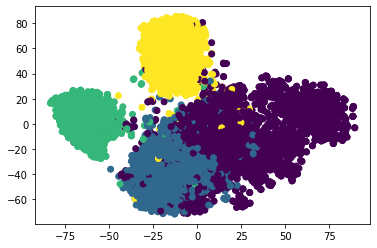

Word2vec : Kmeans clustering on  TSNE  data accuracy :  0.16279069767441862
Word2vec : Kmeans clustering on  TSNE  data NMI :  0.6702938276209497
Word2vec : Kmeans clustering on  TSNE  data ARI :  0.5516108570259157
________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


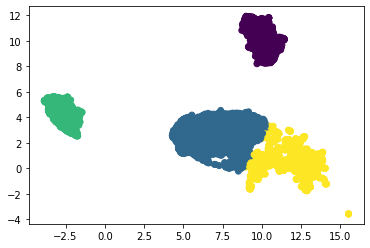

plot with true labels


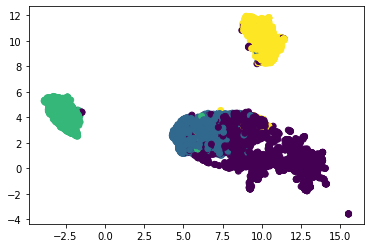

Word2vec : Kmeans clustering on  UMAP  data accuracy :  0.35081042988019734
Word2vec : Kmeans clustering on  UMAP  data NMI :  0.6919532154781203
Word2vec : Kmeans clustering on  UMAP  data ARI :  0.4912864964297179
________________________________________________________________________________________________________


In [ ]:
def kmeans_runner(key,K,true_labels):
  kmeans = KMeans(n_clusters=K, random_state=0,n_init=5).fit(reduced_data[key])
  y_pred = kmeans.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('BERT : Kmeans clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('BERT : Kmeans clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('BERT : Kmeans clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))  

  print("________________________________________________________________________________________________________")


K = 4
for a in reduced_data.keys():
  kmeans_runner(a,K,true_labels)

Commentaire K-means Clustering :

En terme d'accuracy : TSNE a donné le plus mauvais résultat et ca prouve que c'est déconseillé de faire suivre TSNE par une K-means 
  - Le problème avec t-SNE est qu'elle ne préserve pas les distances ni la densité. elle ne préserve que dans une certaine mesure les voisins les plus proches. La différence est subtile, mais affecte tout algorithme basé sur la densité ou la distance ce qui est le cas pour K-means

PCA ( linear kernel) a donné le meilleur résulat (47%) par rapport aux autres résultats




#### **Spectral clustering :**

original  Data
plot with predicted labels


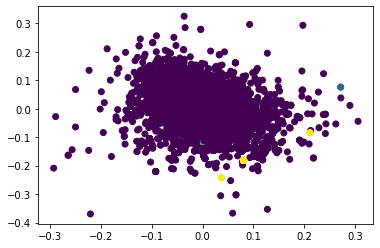

plot with true labels


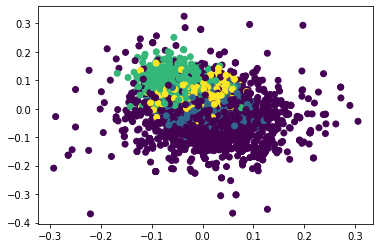

Word2vec : spectral clustering on  original  data accuracy :  0.44200140944326993
Word2vec : spectral clustering on  original  data NMI :  0.011432439464275107
Word2vec : spectral clustering on  original  data ARI :  -0.007784530943189727
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


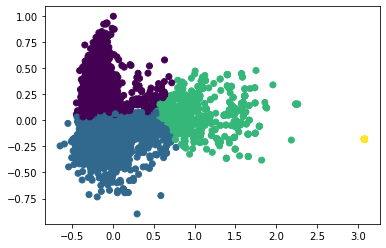

plot with true labels


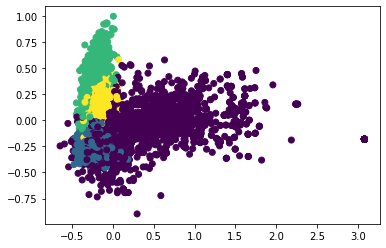

Word2vec : spectral clustering on  PCA  data accuracy :  0.23255813953488372
Word2vec : spectral clustering on  PCA  data NMI :  0.44871444007371325
Word2vec : spectral clustering on  PCA  data ARI :  0.3210521050916887
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


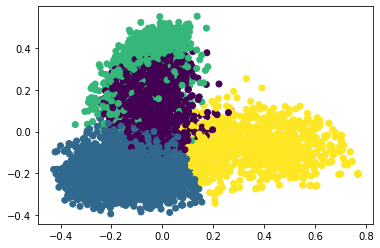

plot with true labels


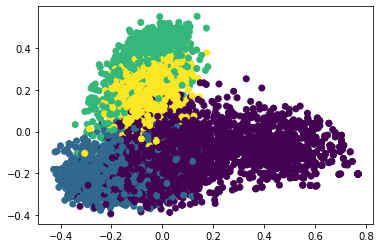

Word2vec : spectral clustering on  cosine  data accuracy :  0.3916842847075405
Word2vec : spectral clustering on  cosine  data NMI :  0.6036230644293806
Word2vec : spectral clustering on  cosine  data ARI :  0.43125705240878764
________________________________________________________________________________________________________


KeyboardInterrupt: ignored

In [ ]:
def spec_clust_runner(key,K,true_labels):

  spectral_clust = SpectralClustering(n_clusters=K,assign_labels='discretize',random_state=0).fit(reduced_data[key])
  y_pred = spectral_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('BERT : spectral clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('BERT : spectral clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('BERT : spectral clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 4
for a in reduced_data.keys():
  spec_clust_runner(a,K,true_labels)

En comparant le Spectral clustering & k-means :

L'accuracy a augmenté pour Spectral clustering par rapport au k-means dans le cas de données originaux + pca non linéaire (cosine kernel)

En revanche on a remaqué une baisse d'accuracy dans le cas du pca linéaire ( linear kernel)

Meme en terme de visualisation : non linear pca ("cosine") a donné un affichage qui ressemble à l'affichage en utilisant les vrai labels

Sinon en terme de temps d'éxecution malgré que le spectral clustering se base sur la méthode k-means mais pas sur les coordonnées originales, mais sur un embedding qui se focalise sur la connectivité, donc au lieu de minimiser les erreurs au carré dans l'input, il minimise les erreurs au carré sur la capacité à reconstruire les voisins et c'est souvent mieux.

#### **HDBSCAN :**

In [ ]:
#!pip install hdbscan
import hdbscan

original  Data
plot with predicted labels


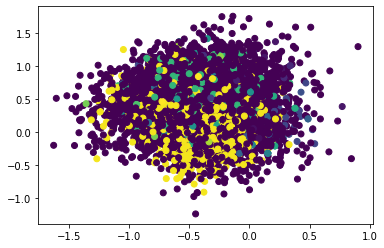

plot with true labels


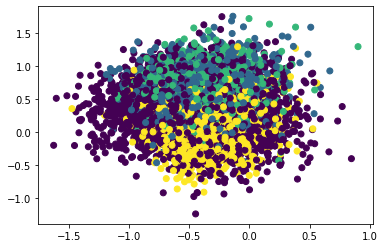

Word2vec : hdbscan clustering on  original  data accuracy :  0.0007047216349541931
Word2vec : hdbscan clustering on  original  data NMI :  0.2284779839405047
Word2vec : hdbscan clustering on  original  data ARI :  0.08634001869792
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


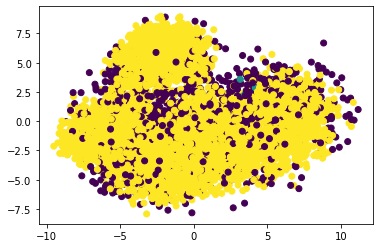

plot with true labels


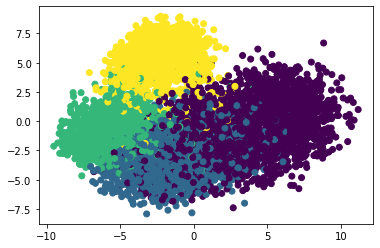

Word2vec : hdbscan clustering on  PCA  data accuracy :  0.17646229739252994
Word2vec : hdbscan clustering on  PCA  data NMI :  0.005296544486033549
Word2vec : hdbscan clustering on  PCA  data ARI :  -0.013213845405276373
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


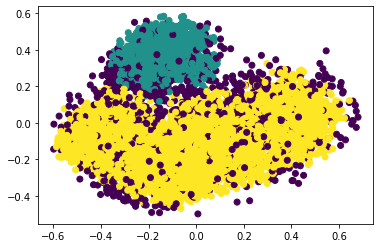

plot with true labels


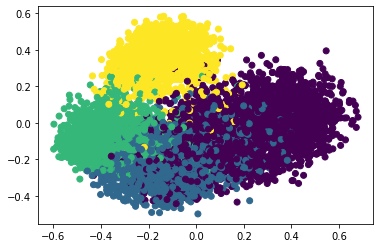

Word2vec : hdbscan clustering on  cosine  data accuracy :  0.17646229739252994
Word2vec : hdbscan clustering on  cosine  data NMI :  0.35573168413136863
Word2vec : hdbscan clustering on  cosine  data ARI :  0.2606551625433668
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


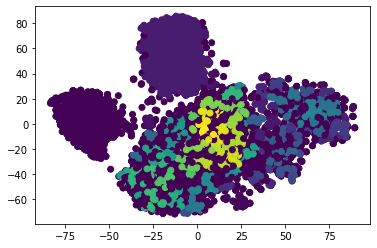

plot with true labels


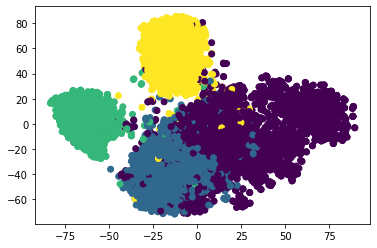

Word2vec : hdbscan clustering on  TSNE  data accuracy :  0.002255109231853418
Word2vec : hdbscan clustering on  TSNE  data NMI :  0.4280334405376927
Word2vec : hdbscan clustering on  TSNE  data ARI :  0.29980352719535885
________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


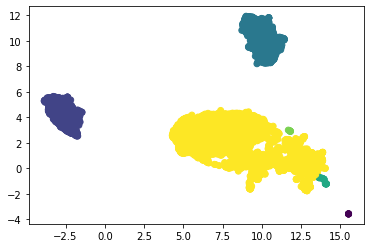

plot with true labels


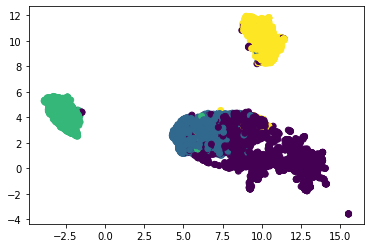

Word2vec : hdbscan clustering on  UMAP  data accuracy :  0.0016913319238900633
Word2vec : hdbscan clustering on  UMAP  data NMI :  0.7221728125853732
Word2vec : hdbscan clustering on  UMAP  data ARI :  0.5836755358169284
________________________________________________________________________________________________________


In [ ]:
def hdbscan_runner(key,true_labels):
  hdbscan_clust = hdbscan.HDBSCAN(algorithm='best', alpha=1.0, metric='euclidean',cluster_selection_epsilon=0.5).fit(reduced_data[key])
  y_pred = hdbscan_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('BERT : hdbscan clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('BERT : hdbscan clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('BERT : hdbscan clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 4
for a in reduced_data.keys():
  hdbscan_runner(a,true_labels)

En terme d'accuracy : aucun algorithme a donné des bons résultats 

Pour original data : l'algorithme n'a pas donné de bons résultat vu qu'il est pas trés bon en high dimensional clustering 

linear & non linear pca sont les algorithmes qui ont donné les meilleurs résultats par rapport aux autres algorithmes (avec un accuracy ~ 20%)

#### **CAH :**

original  Data
plot with predicted labels


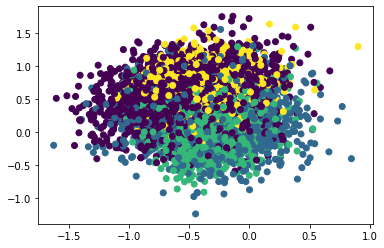

plot with true labels


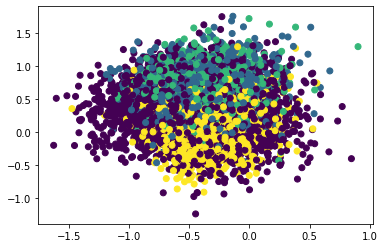

Word2vec : cah clustering on  original  data accuracy :  0.24820295983086682
Word2vec : cah clustering on  original  data NMI :  0.6808553669726354
Word2vec : cah clustering on  original  data ARI :  0.4748808422888332
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


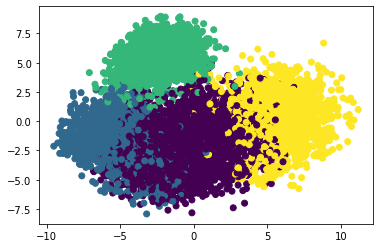

plot with true labels


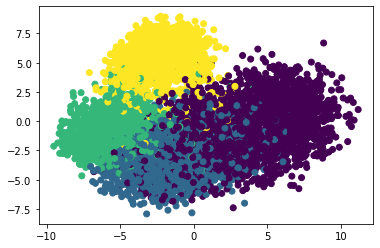

Word2vec : cah clustering on  PCA  data accuracy :  0.2505990133897111
Word2vec : cah clustering on  PCA  data NMI :  0.5367318211935976
Word2vec : cah clustering on  PCA  data ARI :  0.4139385082960581
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


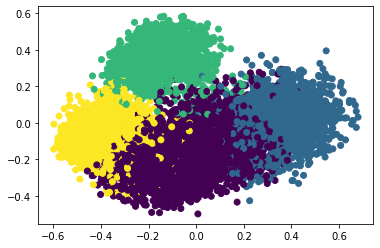

plot with true labels


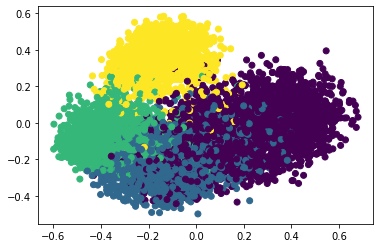

Word2vec : cah clustering on  cosine  data accuracy :  0.2219873150105708
Word2vec : cah clustering on  cosine  data NMI :  0.5967138189545613
Word2vec : cah clustering on  cosine  data ARI :  0.458811229197269
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


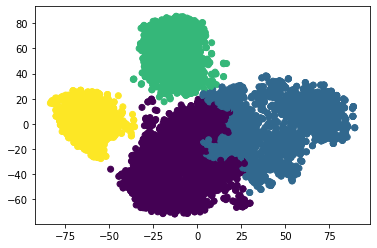

plot with true labels


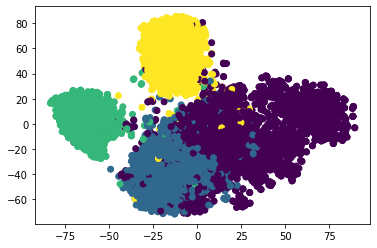

Word2vec : cah clustering on  TSNE  data accuracy :  0.14545454545454545
Word2vec : cah clustering on  TSNE  data NMI :  0.7140848018748651
Word2vec : cah clustering on  TSNE  data ARI :  0.6047047057642096
________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


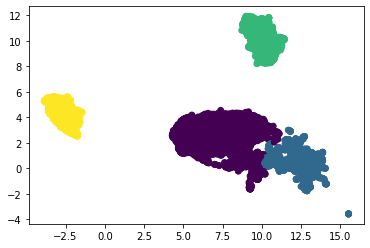

plot with true labels


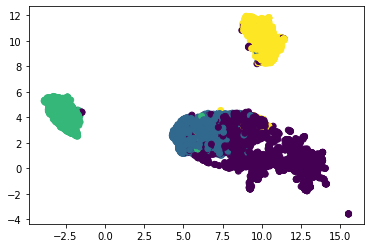

Word2vec : cah clustering on  UMAP  data accuracy :  0.28442565186751234
Word2vec : cah clustering on  UMAP  data NMI :  0.6849570678133232
Word2vec : cah clustering on  UMAP  data ARI :  0.4783238024968493
________________________________________________________________________________________________________


In [ ]:
def cah_runner(key,K,true_labels):
  y_pred = AgglomerativeClustering(n_clusters = K).fit_predict(reduced_data[key])
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('BERT : cah clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('BERT : cah clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('BERT : cah clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 4
for a in reduced_data.keys():
  cah_runner(a,K,true_labels)

PCA("cosine kernel") a donné le meilleur résultas en terme d'accuracy (50%)et visualisation (affichages avec predicted & true labels trés similaires) 

linear PCA + original data : ont donné une accuracy trés basse

NMI & ARI : résultat similaires pour tout les algorithmes

LA cah reste toujours non adapté aux grands volumes de données à cause du temps de calcul qui explose et cela s’explique complètement par les méthodes de calcul de l’algorithme.


##Partie 2 BERT :

###DCN for Classic4 :

In [ ]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
embeddings_DCN_Classic4, cluster_assign_DCN_Classic4 = DCN(vectorized_docs_array, 4, 2, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data = {}
reduced_data['DCN']=embeddings_DCN_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:12<00:00,  3.86it/s]


Running k-means on the learned embeddings...
Starting DCN training...


100%|██████████| 50/50 [00:46<00:00,  1.07it/s]


###DKM for classic4 :

In [ ]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
X_reduced_DKM_Classic4, cluster_assign_DKM_Classic4 = DKM(vectorized_docs_array, 4, 2, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data['DKM']=X_reduced_DKM_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:11<00:00,  4.29it/s]


Running k-means on the learned embeddings...
Starting DKM training...


100%|██████████| 20/20 [00:32<00:00,  1.62s/it]


###Plot Function Classic4:

DCN  Data
plot with predicted labels


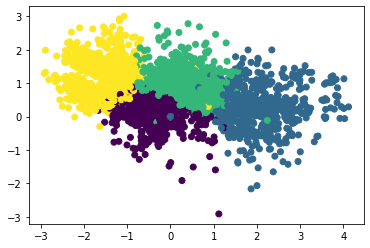

plot with true labels


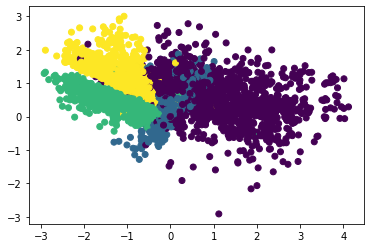

BERT : clustering with  DCN  data accuracy :  0.20507399577167018
BERT : clustering with  DCN  data NMI :  0.4144704102233456
BERT : clustering with  DCN  data ARI :  0.3118799337180251
________________________________________________________________________________________________________
DKM  Data
plot with predicted labels


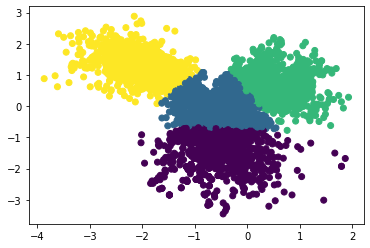

plot with true labels


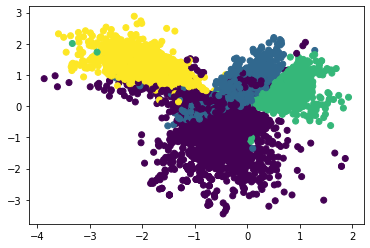

BERT : clustering with  DKM  data accuracy :  0.6105708245243129
BERT : clustering with  DKM  data NMI :  0.5041674137065787
BERT : clustering with  DKM  data ARI :  0.3666500863171562
________________________________________________________________________________________________________


In [ ]:
def plot_result(key,true_labels,predicted_labels):
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=predicted_labels)
  plt.show()

  #-------
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('BERT : clustering with ',key,' data accuracy : ',accuracy_score(true_labels,predicted_labels))
  print('BERT : clustering with ',key,' data NMI : ',normalized_mutual_info_score(true_labels,predicted_labels))
  print('BERT : clustering with ',key,' data ARI : ',adjusted_rand_score(true_labels,predicted_labels))
  print("________________________________________________________________________________________________________")


K = 4
plot_result("DCN",true_labels,cluster_assign_DCN_Classic4)
plot_result("DKM",true_labels,cluster_assign_DKM_Classic4)



DCN  a gangé en terme d'accuracy 45% vs 25% pour DKM

Par les deux méthodes ont eu les memes score NMI & ARI

## **RoBERTa :**

### **Document embedding :**

In [ ]:
true_labels, u  = pd.factorize(df['label'])

In [ ]:
model = SentenceTransformer('sentence-transformers/roberta-base-nli-stsb-mean-tokens')

Downloading:   0%|          | 0.00/748 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/4.00k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/2.00 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/688 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/122 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/456k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/229 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/499M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/52.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/52.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/239 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/334 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/798k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/190 [00:00<?, ?B/s]

In [ ]:
vectorized_docs = model.encode(abstract)

### **Réduction de la dimension :**

In [ ]:
reduced_data = {}
reduced_data['original'] = vectorized_docs

#### **PCA** :

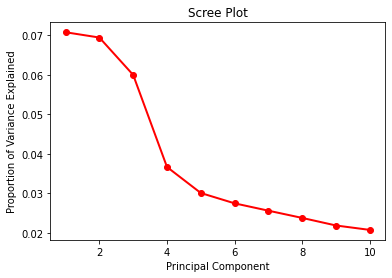

In [ ]:
#NUMBER OF COMPONENTS PCA :
pca = PCA(n_components=10)
pca_component = pca.fit_transform(vectorized_docs)

PC_values = np.arange(pca.n_components_) + 1
plt.plot(PC_values, pca.explained_variance_ratio_, 'ro-', linewidth=2)
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Proportion of Variance Explained')
plt.show()

On peut prendre le nombre de composantes principal = 5

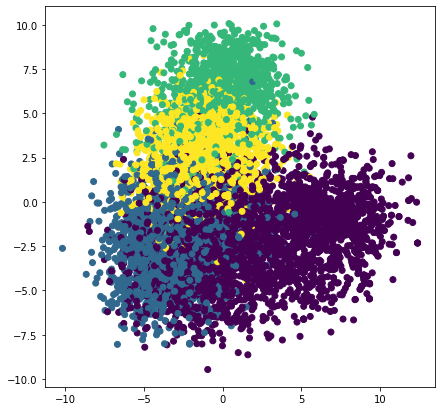

In [ ]:
pca = PCA(n_components=5)
pca_components = pca.fit_transform(vectorized_docs)
reduced_data["PCA"] = pca_components

#---------------plot----------------------------------

f = plt.figure(figsize=(7,7))
PCA_components = pd.DataFrame(pca_components)
plt.scatter(PCA_components[0], PCA_components[1],c=true_labels)
plt.show()

pca with kernel =  linear


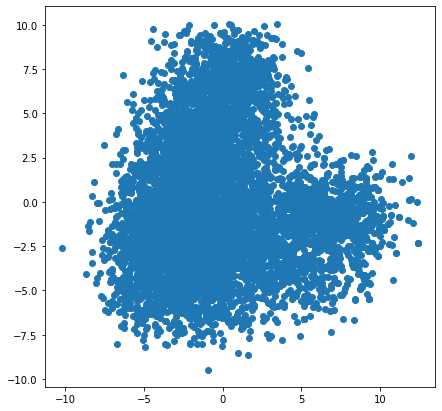

________________________________________________________________________
pca with kernel =  poly


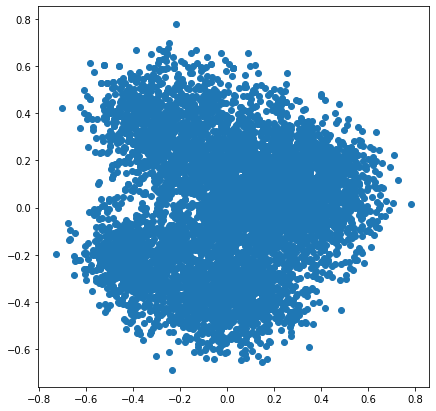

________________________________________________________________________
pca with kernel =  rbf


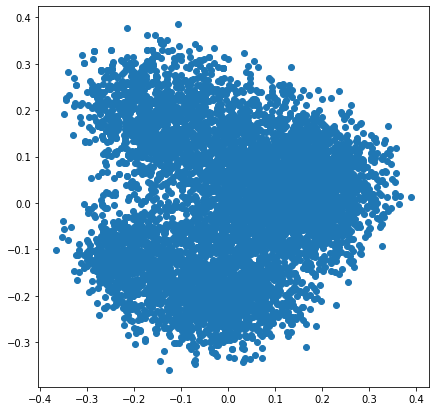

________________________________________________________________________
pca with kernel =  sigmoid


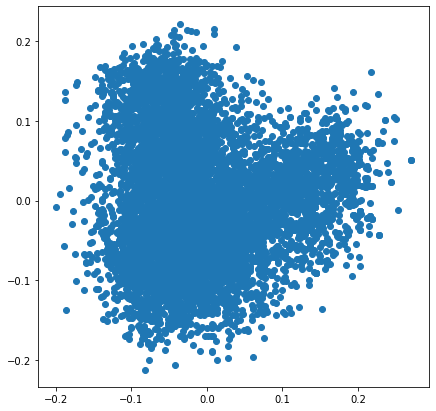

________________________________________________________________________
pca with kernel =  cosine


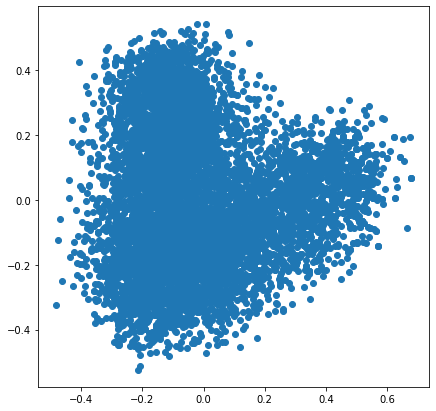

________________________________________________________________________


In [ ]:
#PCA WITH DIFFERENT KERNELS :
from sklearn.decomposition import KernelPCA

list_kernel = ["linear", "poly", "rbf", "sigmoid","cosine"]
for i in list_kernel:
  transformer = KernelPCA(n_components=4, kernel=i)
  X_transformed = transformer.fit_transform(vectorized_docs)
  if i == "rbf":
    reduced_data["cosine"] = X_transformed 
  f = plt.figure(figsize=(7,7))
  PCA_componentss = pd.DataFrame(X_transformed)
  plt.scatter(PCA_componentss[0], PCA_componentss[1])
  print("pca with kernel = ",i)
  plt.show()
  print("________________________________________________________________________")

#### **T-SNE :**

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,


tsne init = 'pca'


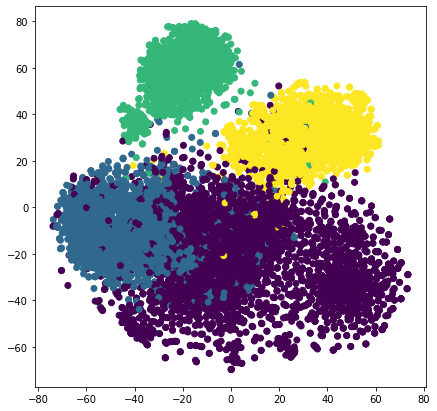

In [ ]:
tsne_components = TSNE(n_components=2,init='pca').fit_transform(vectorized_docs)
reduced_data["TSNE"] = tsne_components

#------------------plot-----------------

f = plt.figure(figsize=(7,7))
print("tsne init = 'pca'")
TSNE_components = pd.DataFrame(tsne_components) #tsne with inti ='pca'
plt.scatter(TSNE_components[0], TSNE_components[1],c=true_labels)
plt.show()

#### **UMAP :**

In [ ]:
!pip install umap-learn
import umap

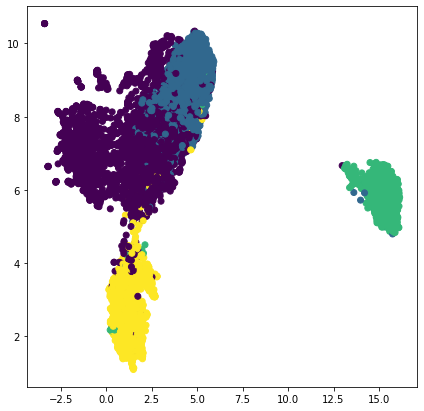

In [ ]:
reducer = umap.UMAP()
umap_components = reducer.fit_transform(vectorized_docs)
reduced_data["UMAP"] = umap_components
umap_components.shape

#----------------plot---------------------
f = plt.figure(figsize=(7,7))
UMAP_components = pd.DataFrame(umap_components) 
plt.scatter(UMAP_components[0], UMAP_components[1],c=true_labels)
plt.show()

#### **Commentaire reduction de la dimension :**
En regardant le plot de chacune des méthodes et en ignorant les couleurs (true labels) on constate que :

- PCA : 
    - on peut voir une à deux classes (au lieu de 4 classes) 
    - PCA avec kernel différent a donné presque le même résultat avec le kernel linéaire sauf pour 'cosine' qui a mieux séparé les choses 

- TSNE & UMAP : 
    - Dans chacun des deux plot on peut voir au max trois classes

    - Résultats des deux méthodes sont trés similaires vu que les deux méthodes se basent sur local clustering par contre UMAP a fait le travail legèrment mieu que T-SNE vu qu'elle est plus fidèle à la structure global de données, plus rapide et moins couteuse

### **Clustering :**

#### **K-means :**

original  Data
plot with predicted labels


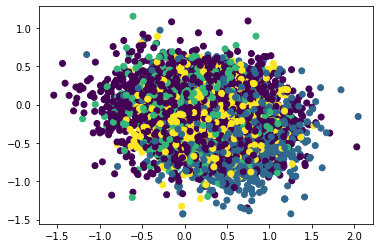

plot with true labels


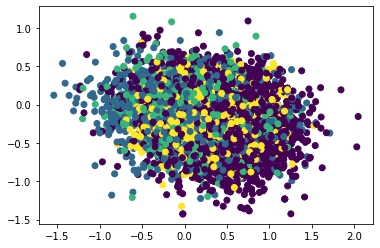

RoBERTa : Kmeans clustering on  original  data accuracy :  0.5434813248766737
RoBERTa : Kmeans clustering on  original  data NMI :  0.6231978554203643
RoBERTa : Kmeans clustering on  original  data ARI :  0.4727451280781946
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


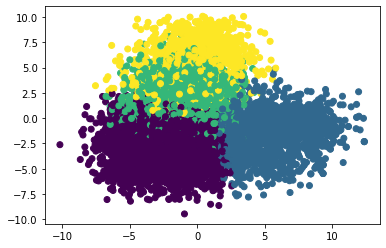

plot with true labels


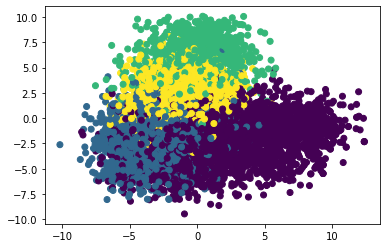

RoBERTa : Kmeans clustering on  PCA  data accuracy :  0.21832276250880903
RoBERTa : Kmeans clustering on  PCA  data NMI :  0.5661081624009794
RoBERTa : Kmeans clustering on  PCA  data ARI :  0.44533821863184486
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


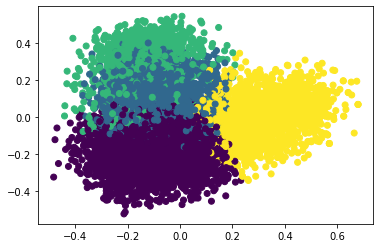

plot with true labels


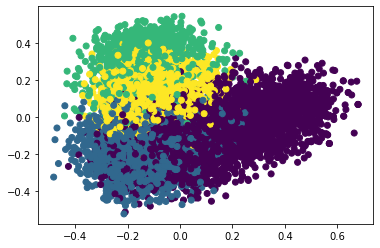

RoBERTa : Kmeans clustering on  cosine  data accuracy :  0.34940098661028895
RoBERTa : Kmeans clustering on  cosine  data NMI :  0.5733259709961267
RoBERTa : Kmeans clustering on  cosine  data ARI :  0.4468000137420661
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


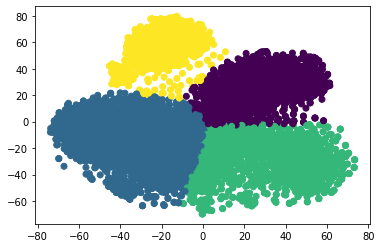

plot with true labels


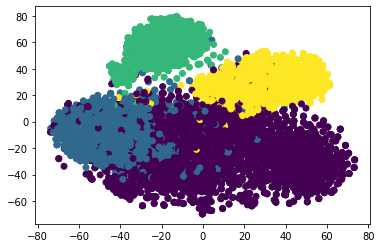

RoBERTa : Kmeans clustering on  TSNE  data accuracy :  0.2324171952078929
RoBERTa : Kmeans clustering on  TSNE  data NMI :  0.6464271070318839
RoBERTa : Kmeans clustering on  TSNE  data ARI :  0.513039260792429
________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


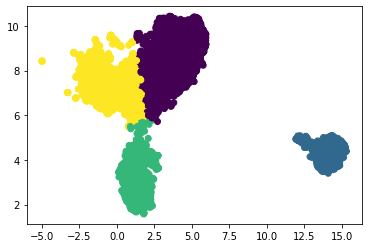

plot with true labels


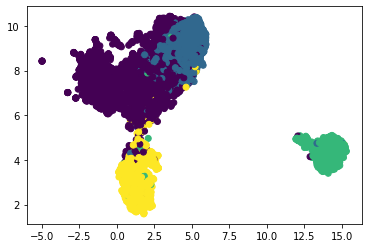

RoBERTa : Kmeans clustering on  UMAP  data accuracy :  0.22720225510923187
RoBERTa : Kmeans clustering on  UMAP  data NMI :  0.6852895928660022
RoBERTa : Kmeans clustering on  UMAP  data ARI :  0.50010751028417
________________________________________________________________________________________________________


In [ ]:
def kmeans_runner(key,K,true_labels):
  kmeans = KMeans(n_clusters=K, random_state=0,n_init=5).fit(reduced_data[key])
  y_pred = kmeans.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('RoBERTa : Kmeans clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('RoBERTa : Kmeans clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('RoBERTa : Kmeans clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))  

  print("________________________________________________________________________________________________________")


K = 4
for a in reduced_data.keys():
  kmeans_runner(a,K,true_labels)

Commentaire K-means Clustering :

En terme d'accuracy : TSNE a donné le plus mauvais résultat et ca prouve que c'est déconseillé de faire suivre TSNE par une K-means 
  - Le problème avec t-SNE est qu'elle ne préserve pas les distances ni la densité. elle ne préserve que dans une certaine mesure les voisins les plus proches. La différence est subtile, mais affecte tout algorithme basé sur la densité ou la distance ce qui est le cas pour K-means

PCA ( linear kernel) a donné le meilleur résulat (47%) par rapport aux autres résultats




#### **Spectral clustering :**

original  Data
plot with predicted labels


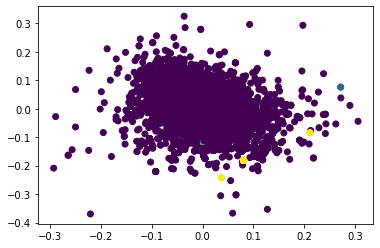

plot with true labels


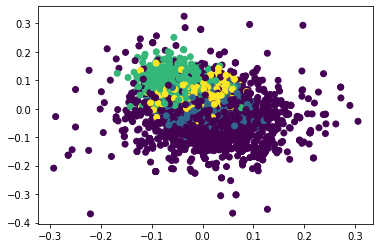

Word2vec : spectral clustering on  original  data accuracy :  0.44200140944326993
Word2vec : spectral clustering on  original  data NMI :  0.011432439464275107
Word2vec : spectral clustering on  original  data ARI :  -0.007784530943189727
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


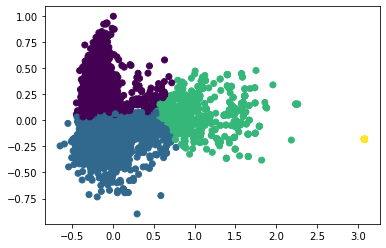

plot with true labels


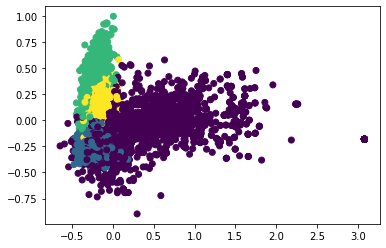

Word2vec : spectral clustering on  PCA  data accuracy :  0.23255813953488372
Word2vec : spectral clustering on  PCA  data NMI :  0.44871444007371325
Word2vec : spectral clustering on  PCA  data ARI :  0.3210521050916887
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


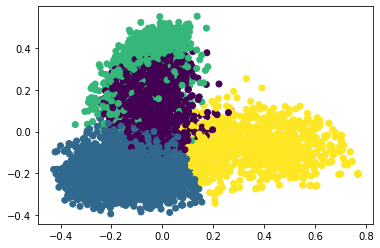

plot with true labels


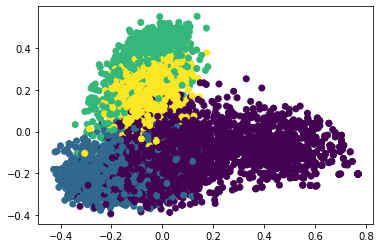

Word2vec : spectral clustering on  cosine  data accuracy :  0.3916842847075405
Word2vec : spectral clustering on  cosine  data NMI :  0.6036230644293806
Word2vec : spectral clustering on  cosine  data ARI :  0.43125705240878764
________________________________________________________________________________________________________


KeyboardInterrupt: ignored

In [ ]:
def spec_clust_runner(key,K,true_labels):

  spectral_clust = SpectralClustering(n_clusters=K,assign_labels='discretize',random_state=0).fit(reduced_data[key])
  y_pred = spectral_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('RoBERTa : spectral clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('RoBERTa : spectral clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('RoBERTa : spectral clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 4
for a in reduced_data.keys():
  spec_clust_runner(a,K,true_labels)

En comparant le Spectral clustering & k-means :

L'accuracy a augmenté pour Spectral clustering par rapport au k-means dans le cas de données originaux + pca non linéaire (cosine kernel)

En revanche on a remaqué une baisse d'accuracy dans le cas du pca linéaire ( linear kernel)

Meme en terme de visualisation : non linear pca ("cosine") a donné un affichage qui ressemble à l'affichage en utilisant les vrai labels

Sinon en terme de temps d'éxecution malgré que le spectral clustering se base sur la méthode k-means mais pas sur les coordonnées originales, mais sur un embedding qui se focalise sur la connectivité, donc au lieu de minimiser les erreurs au carré dans l'input, il minimise les erreurs au carré sur la capacité à reconstruire les voisins et c'est souvent mieux.

#### **HDBSCAN :**

In [ ]:
#!pip install hdbscan
import hdbscan

original  Data
plot with predicted labels


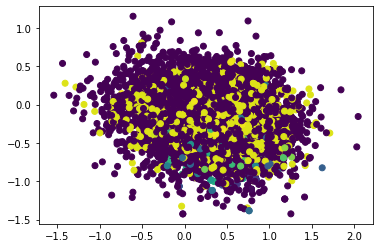

plot with true labels


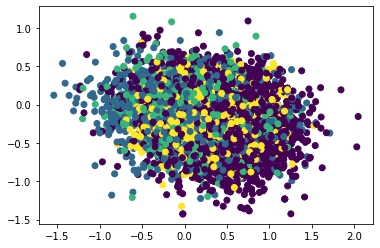

RoBERTa : hdbscan clustering on  original  data accuracy :  0.0007047216349541931
RoBERTa : hdbscan clustering on  original  data NMI :  0.17309454031236307
RoBERTa : hdbscan clustering on  original  data ARI :  0.09399787128717807
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


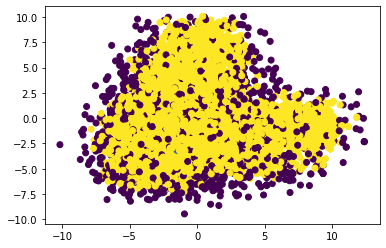

plot with true labels


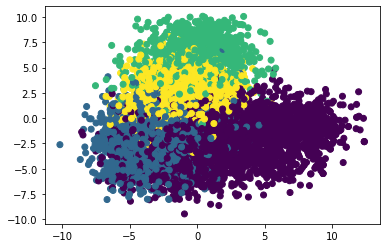

RoBERTa : hdbscan clustering on  PCA  data accuracy :  0.11317829457364341
RoBERTa : hdbscan clustering on  PCA  data NMI :  0.009182621623420003
RoBERTa : hdbscan clustering on  PCA  data ARI :  -0.004667829156051424
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


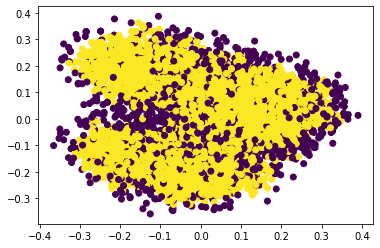

plot with true labels


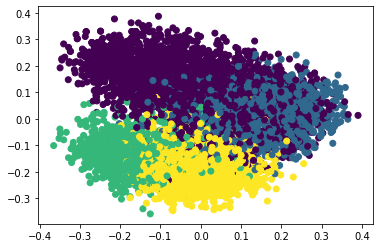

RoBERTa : hdbscan clustering on  cosine  data accuracy :  0.14728682170542637
RoBERTa : hdbscan clustering on  cosine  data NMI :  0.007052113772392599
RoBERTa : hdbscan clustering on  cosine  data ARI :  0.022198737395782927
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


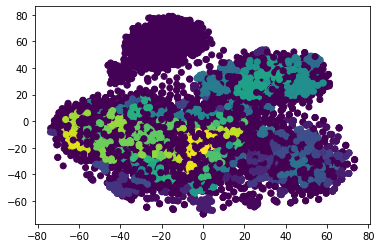

plot with true labels


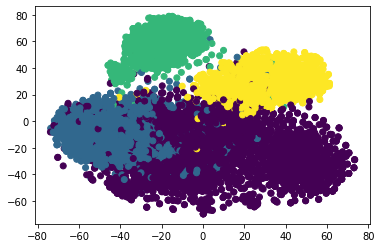

RoBERTa : hdbscan clustering on  TSNE  data accuracy :  0.0007047216349541931
RoBERTa : hdbscan clustering on  TSNE  data NMI :  0.35753740909540516
RoBERTa : hdbscan clustering on  TSNE  data ARI :  0.1695437380921821
________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


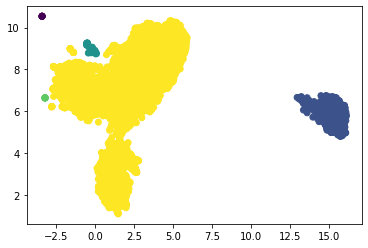

plot with true labels


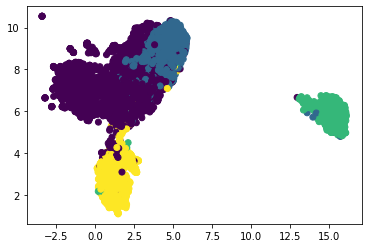

RoBERTa : hdbscan clustering on  UMAP  data accuracy :  0.1974630021141649
RoBERTa : hdbscan clustering on  UMAP  data NMI :  0.44939787051591334
RoBERTa : hdbscan clustering on  UMAP  data ARI :  0.2389222335062621
________________________________________________________________________________________________________


In [ ]:
def hdbscan_runner(key,true_labels):
  hdbscan_clust = hdbscan.HDBSCAN(algorithm='best', alpha=1.0, metric='euclidean',cluster_selection_epsilon=0.5).fit(reduced_data[key])
  y_pred = hdbscan_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('RoBERTa : hdbscan clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('RoBERTa : hdbscan clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('RoBERTa : hdbscan clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 4
for a in reduced_data.keys():
  hdbscan_runner(a,true_labels)

En terme d'accuracy : aucun algorithme a donné des bons résultats 

Pour original data : l'algorithme n'a pas donné de bons résultat vu qu'il est pas trés bon en high dimensional clustering 

linear & non linear pca sont les algorithmes qui ont donné les meilleurs résultats par rapport aux autres algorithmes (avec un accuracy ~ 20%)

#### **CAH :**

original  Data
plot with predicted labels


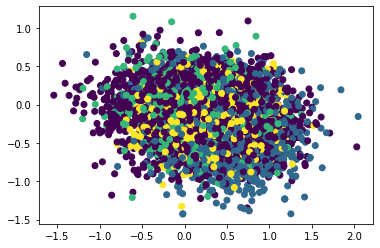

plot with true labels


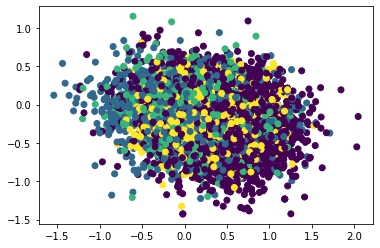

RoBERTa : cah clustering on  original  data accuracy :  0.5471458773784356
RoBERTa : cah clustering on  original  data NMI :  0.6702638943330892
RoBERTa : cah clustering on  original  data ARI :  0.477430716860879
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


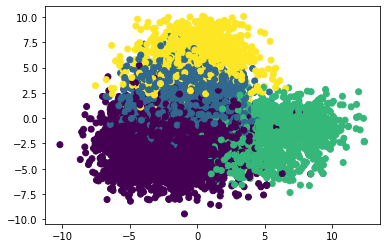

plot with true labels


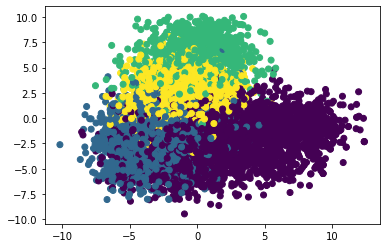

RoBERTa : cah clustering on  PCA  data accuracy :  0.24157857646229738
RoBERTa : cah clustering on  PCA  data NMI :  0.5557389188853742
RoBERTa : cah clustering on  PCA  data ARI :  0.41239649524676003
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


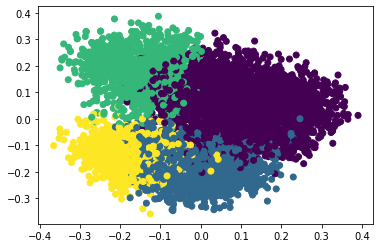

plot with true labels


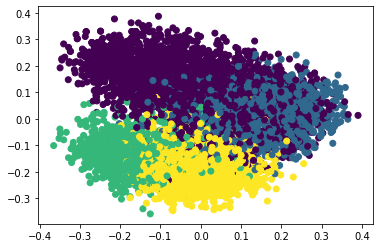

RoBERTa : cah clustering on  cosine  data accuracy :  0.2878083157152925
RoBERTa : cah clustering on  cosine  data NMI :  0.5594589206210081
RoBERTa : cah clustering on  cosine  data ARI :  0.40715443998562173
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


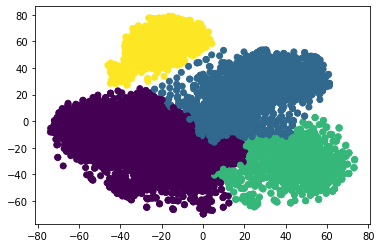

plot with true labels


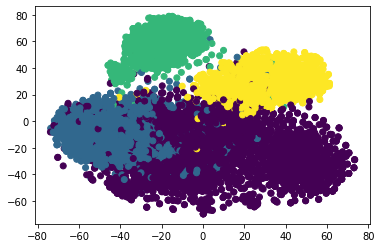

RoBERTa : cah clustering on  TSNE  data accuracy :  0.21945031712473573
RoBERTa : cah clustering on  TSNE  data NMI :  0.5947554268868464
RoBERTa : cah clustering on  TSNE  data ARI :  0.4001564828880443
________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


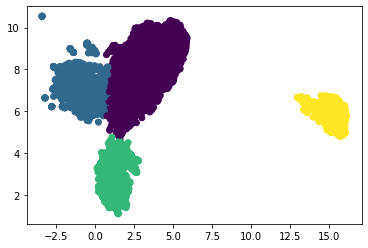

plot with true labels


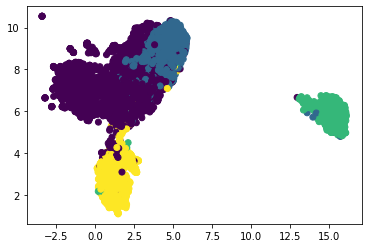

RoBERTa : cah clustering on  UMAP  data accuracy :  0.2787878787878788
RoBERTa : cah clustering on  UMAP  data NMI :  0.6786012068081071
RoBERTa : cah clustering on  UMAP  data ARI :  0.4759863574522978
________________________________________________________________________________________________________


In [ ]:
def cah_runner(key,K,true_labels):
  y_pred = AgglomerativeClustering(n_clusters = K).fit_predict(reduced_data[key])
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('RoBERTa : cah clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('RoBERTa : cah clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('RoBERTa : cah clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 4
for a in reduced_data.keys():
  cah_runner(a,K,true_labels)

PCA("cosine kernel") a donné le meilleur résultas en terme d'accuracy (50%)et visualisation (affichages avec predicted & true labels trés similaires) 

linear PCA + original data : ont donné une accuracy trés basse

NMI & ARI : résultat similaires pour tout les algorithmes

LA cah reste toujours non adapté aux grands volumes de données à cause du temps de calcul qui explose et cela s’explique complètement par les méthodes de calcul de l’algorithme.


##Partie 2 RoBERTa :

###DCN for Classic4 :

In [ ]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
embeddings_DCN_Classic4, cluster_assign_DCN_Classic4 = DCN(vectorized_docs_array, 4, 2, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data = {}
reduced_data['DCN']=embeddings_DCN_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:11<00:00,  4.37it/s]


Running k-means on the learned embeddings...
Starting DCN training...


100%|██████████| 50/50 [00:46<00:00,  1.07it/s]


###DKM for classic4 :

In [ ]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
X_reduced_DKM_Classic4, cluster_assign_DKM_Classic4 = DKM(vectorized_docs_array, 4, 2, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data['DKM']=X_reduced_DKM_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:11<00:00,  4.27it/s]


Running k-means on the learned embeddings...
Starting DKM training...


100%|██████████| 20/20 [00:33<00:00,  1.66s/it]


###Plot Function Classic4:

DCN  Data
plot with predicted labels


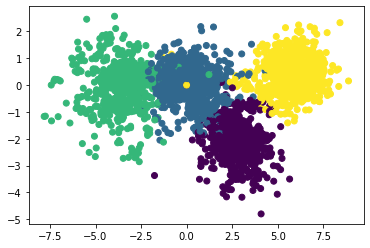

plot with true labels


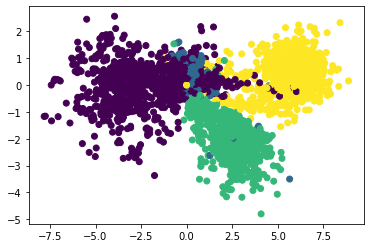

RoBERTa : clustering with  DCN  data accuracy :  0.3775898520084567
RoBERTa : clustering with  DCN  data NMI :  0.5480227591009178
RoBERTa : clustering with  DCN  data ARI :  0.3687468603216093
________________________________________________________________________________________________________
DKM  Data
plot with predicted labels


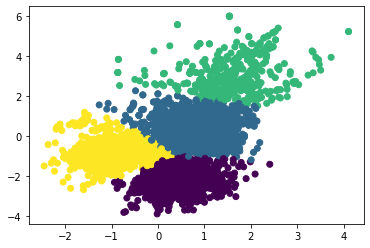

plot with true labels


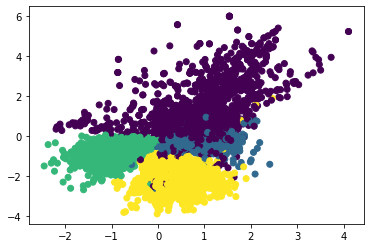

RoBERTa : clustering with  DKM  data accuracy :  0.2197322057787174
RoBERTa : clustering with  DKM  data NMI :  0.596454995827205
RoBERTa : clustering with  DKM  data ARI :  0.4732070320269467
________________________________________________________________________________________________________


In [ ]:
def plot_result(key,true_labels,predicted_labels):
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=predicted_labels)
  plt.show()

  #-------
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('RoBERTa : clustering with ',key,' data accuracy : ',accuracy_score(true_labels,predicted_labels))
  print('RoBERTa : clustering with ',key,' data NMI : ',normalized_mutual_info_score(true_labels,predicted_labels))
  print('RoBERTa : clustering with ',key,' data ARI : ',adjusted_rand_score(true_labels,predicted_labels))
  print("________________________________________________________________________________________________________")


K = 4
plot_result("DCN",true_labels,cluster_assign_DCN_Classic4)
plot_result("DKM",true_labels,cluster_assign_DKM_Classic4)



DCN  a gangé en terme d'accuracy 45% vs 25% pour DKM

Par les deux méthodes ont eu les memes score NMI & ARI

#Dataset BBC

##Load Data

In [ ]:
df_BBC = pd.read_csv('/content/bbc.csv',header=0,index_col=0)
df_BBC

,text,label
0,England coach faces rap after row\n\nEngland c...,sport
1,Moody joins up with England\n\nLewis Moody has...,sport
2,Ferguson fears Milan cutting edge\n\nMancheste...,sport
3,Henry tipped for Fifa award\n\nFifa president ...,sport
4,Arnesen denies rift with Santini\n\nTottenham ...,sport
...,...,...
2220,Commons hunt protest charges\n\nEight proteste...,politics
2221,UK set to cut back on embassies\n\nNine overse...,politics
2222,'Few ready' for information act\n\nThousands o...,politics
2223,Goldsmith: 'I was not leant on'\n\nThe attorne...,politics


In [ ]:
df_BBC["label"].value_counts().to_frame()

,label
sport,511
business,510
politics,417
tech,401
entertainment,386


In [ ]:
#punctuations
punctuations = string.punctuation
#stopwords
stop_words = list(STOP_WORDS)
def clean_text(
  string : str,
  ponctuation = '!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~',
  stop_words = stop_words)->str : 

  #URLs
  string = re.sub(r"https?://\S+|www\.\S+",'',string)
  #html 
  string = re.sub(r'<.*?>','',string)
  #Numbers
  string = re.sub(r'[0-9]+','',string) 

  #Remove punctuations
  for x in string.lower():
    if x in punctuations:
      string = string.replace(x,"")
  #To lower
  string = string.lower()
  #Remove stop words
  lemmatizer = WordNetLemmatizer()
  string = ' '.join([lemmatizer.lemmatize(word) for word in string.split() if word not in stop_words])
  #Cleaning the whitespaces
  string = re.sub(r'\s', ' ', string).strip()

  return string

In [ ]:
abstract_BBC = df_BBC['text'].to_list()
abstracts_cleaned_BBC = [clean_text(x) for x in abstract_BBC]

In [ ]:
len(abstracts_cleaned_BBC)

2225

## **Word2Vec :**

### **Document embedding :**

In [ ]:
true_labels_BBC, u  = pd.factorize(df_BBC['label'])
sentances_BBC = [list(tokenize(s, deacc=True, lower=True)) for s in abstracts_cleaned_BBC]
len(sentances_BBC)

2225

In [ ]:
!wget -c "https://s3.amazonaws.com/dl4j-distribution/GoogleNews-vectors-negative300.bin.gz"
!gzip -d GoogleNews-vectors-negative300.bin.gz

--2021-12-04 18:01:50--  https://s3.amazonaws.com/dl4j-distribution/GoogleNews-vectors-negative300.bin.gz
Resolving s3.amazonaws.com (s3.amazonaws.com)... 54.231.197.88
Connecting to s3.amazonaws.com (s3.amazonaws.com)|54.231.197.88|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1647046227 (1.5G) [application/x-gzip]
Saving to: ‘GoogleNews-vectors-negative300.bin.gz’

leNews-vectors-nega  12%[=>                  ] 194.19M  66.5MB/s               ^C
gzip: GoogleNews-vectors-negative300.bin already exists; do you wish to overwrite (y or n)? ^C


In [ ]:
# Load Google's pre-trained Word2Vec model.
import gensim
model = gensim.models.KeyedVectors.load_word2vec_format('./GoogleNews-vectors-negative300.bin', binary=True)

In [ ]:
#from gensim.models import KeyedVectors

#model_2 = Word2Vec(size=300, min_count=1)
#model_2.build_vocab(sentances)
#total_examples = model_2.corpus_count
#model = KeyedVectors.load_word2vec_format("/content/GoogleNews-vectors-negative300.bin", binary=True)
#model_2.intersect_word2vec_format("/content/GoogleNews-vectors-negative300.bin", binary=True, lockf=1.0)
#model_2.train(sentances, total_examples=total_examples, epochs=model_2.iter)

In [ ]:
def vectorize(list_of_docs, model):
    """Generate vectors for list of documents using a Word Embedding

    Args:
        list_of_docs: List of documents
        model: Gensim's Word Embedding

    Returns:
        List of document vectors
    """
    features = []

    for tokens in list_of_docs:
        zero_vector = np.zeros(model.vector_size)
        vectors = []
        for token in tokens:
            if token in model.wv:
                try:
                    vectors.append(model.wv[token])
                except KeyError:
                    continue
        if vectors:
            vectors = np.asarray(vectors)
            avg_vec = vectors.mean(axis=0)
            features.append(avg_vec)
        else:
            features.append(zero_vector)
    return features
    
vectorized_docs_BBC = vectorize(sentances_BBC, model=model)
len(vectorized_docs_BBC), len(vectorized_docs_BBC[0])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:17: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).


(2225, 300)

### **Réduction de la dimension :**

In [ ]:
reduced_data = {}
reduced_data['original'] = vectorized_docs_BBC

#### **PCA** :

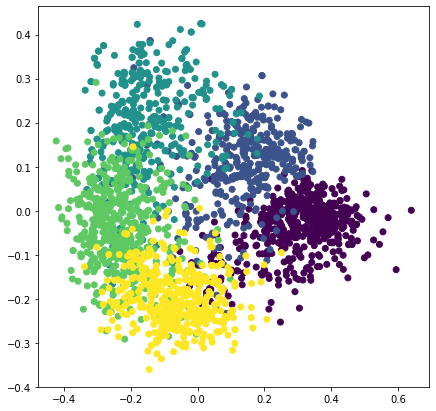

In [ ]:
pca = PCA(n_components=3)
pca_components = pca.fit_transform(vectorized_docs_BBC)
reduced_data["PCA"] = pca_components

#---------------plot----------------------------------

f = plt.figure(figsize=(7,7))
PCA_components = pd.DataFrame(pca_components)
plt.scatter(PCA_components[0], PCA_components[1],c=true_labels_BBC)
plt.show()

#### **T-SNE :**

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,


tsne init = 'pca'


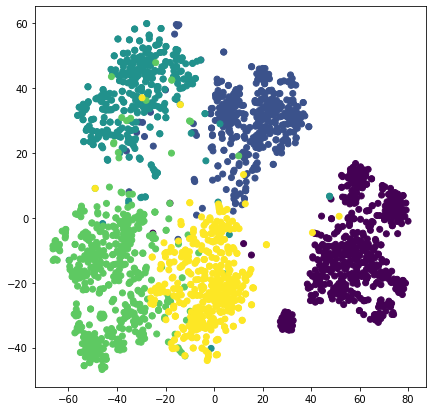

In [ ]:
tsne_components = TSNE(n_components=2,init='pca').fit_transform(vectorized_docs_BBC)
reduced_data["TSNE"] = tsne_components

#------------------plot-----------------

f = plt.figure(figsize=(7,7))
print("tsne init = 'pca'")
TSNE_components = pd.DataFrame(tsne_components) #tsne with inti ='pca'
plt.scatter(TSNE_components[0], TSNE_components[1],c=true_labels_BBC)
plt.show()

#### **UMAP :**

In [ ]:
!pip install umap-learn
import umap

/usr/local/lib/python3.7/dist-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.
  warnings.warn(problem)


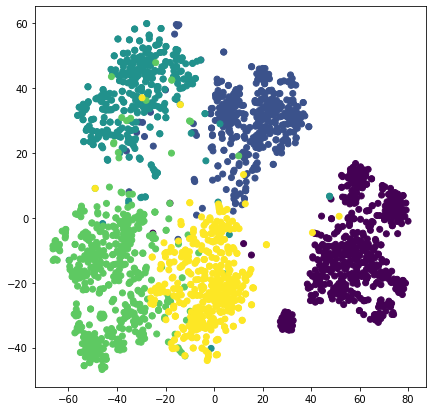

In [ ]:
reducer = umap.UMAP()
umap_components = reducer.fit_transform(vectorized_docs_BBC)
reduced_data["UMAP"] = umap_components
umap_components.shape

#----------------plot---------------------
f = plt.figure(figsize=(7,7))
UMAP_components = pd.DataFrame(umap_components) 
plt.scatter(TSNE_components[0], TSNE_components[1],c=true_labels_BBC)
plt.show()

#### Commentaire reduction de la dimension :
En regardant le plot de chacune des méthodes et sans prendre en consideration la coloration des points on trouve que :

- PCA : 
    - on a un seul bloque des points sous forme d'un cercle qui est difficile a étre séparer visuelement ou sans coloration.
    - les frontières entre les classes aprés la coloration sont attachées et bien collées l'une à l'autre .
- TSNE : 
    - On peut facilement distinguer 4 voir 5 classes visuelement avec un peu de chevauchement entre les classes, et on confirme ça avec les couleurs 
- UMAP : 
    - on trouve 5 classes dispersées et bien séparées avec une distance considérable entre eux, aussi les points de chaque classes sont bien concentrés mais on trouve dans chacune des classes des points d'une autre classes qui trainent au mileu (des intrus).


En comparant les trois méthodes on remarque que l'ACP est la plus rapide en terme d'excecution,on sait déja qu'elle est déterministe et linéaire. Cependant, cette linéarité limite son utilité dans des domaines complexes comme le langage naturel (notre cas) ou les images, où la structure non linéaire est la norme.

dans le cas d'une structure non linéaire technique t-SNE, qui signifie t-distributed Stochastic Neighbor Embedding. permet de capturer la structure non linéaire des données de haute dimension (dans notre cas 300), au moins à un niveau local, ce qui signifie que si deux points sont proches dans l'espace de haute dimension, ils ont une forte probabilité d'être proches dans l'espace d'intégration de basse dimension, cependant elle est moins rapide que PCA.

 UMAP(Uniform Manifold Approximation and Projection), il est très similaire à t-SNE. Si on compare les visualisations créées avec t-SNE et UMAP, on aura peut-être du mal à les distinguer facillement.

Cependant, UMAP semble avoir quelques avantages significatifs sur t-SNE :
- elle est plus rapide que t-SNE.
- elle capture la structure globale mieux que t-SNE.(la dispersion des classes et la concentration des point)

alors que t-SNE n'a pas beaucoup d'utilité en dehors de la visualisation, UMAP est une technique de réduction de la dimensionnalité à usage général qui peut être utilisée comme prétraitement pour l'apprentissage automatique.

Le principal inconvénient de l'UMAP est son manque de maturité(crée en 2018) . Il s'agit d'une technique très récente, de sorte que les bibliothèques et les meilleures pratiques ne sont pas encore solidement établies ou robustes. ce qui justifie les points intrus dans chaque classe

### **Clustering :**

#### **K-means :**

original  Data
plot with predicted labels


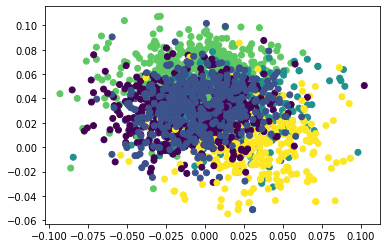

plot with true labels


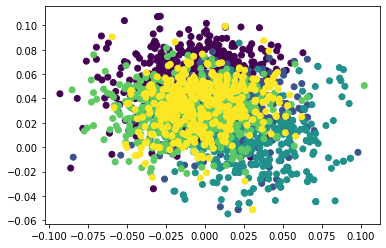

Word2vec : Kmeans clustering on  original  data accuracy :  0.019325842696629212
Word2vec : Kmeans clustering on  original  data NMI :  0.7640699172155597
Word2vec : Kmeans clustering on  original  data ARI :  0.763933174851639
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


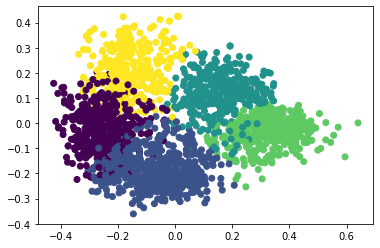

plot with true labels


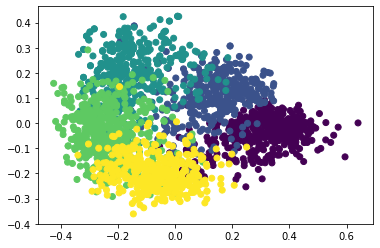

Word2vec : Kmeans clustering on  PCA  data accuracy :  0.0301123595505618
Word2vec : Kmeans clustering on  PCA  data NMI :  0.7188996521823253
Word2vec : Kmeans clustering on  PCA  data ARI :  0.7124450445479599
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


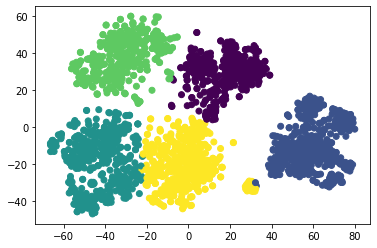

plot with true labels


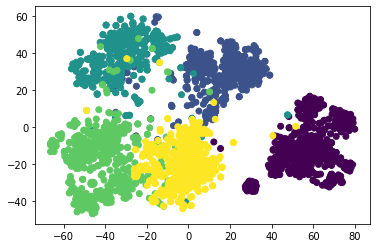

Word2vec : Kmeans clustering on  TSNE  data accuracy :  0.1896629213483146
Word2vec : Kmeans clustering on  TSNE  data NMI :  0.8338920508852311
Word2vec : Kmeans clustering on  TSNE  data ARI :  0.8560142898524284
________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


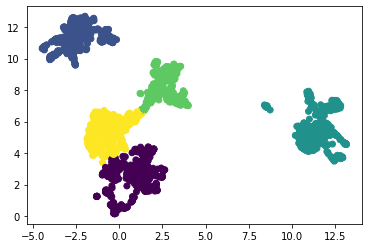

plot with true labels


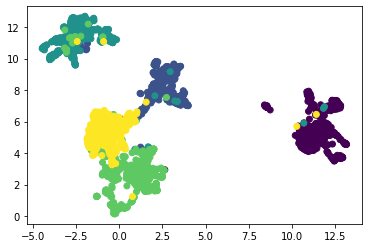

Word2vec : Kmeans clustering on  UMAP  data accuracy :  0.18921348314606742
Word2vec : Kmeans clustering on  UMAP  data NMI :  0.8599219479356879
Word2vec : Kmeans clustering on  UMAP  data ARI :  0.8869257871346138
________________________________________________________________________________________________________


In [ ]:
def kmeans_runner(key,K,true_labels):
  kmeans = KMeans(n_clusters=K, random_state=0,n_init=5).fit(reduced_data[key])
  y_pred = kmeans.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('Word2vec : Kmeans clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('Word2vec : Kmeans clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('Word2vec : Kmeans clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")


K = 5
for a in reduced_data.keys():
  kmeans_runner(a,K,true_labels_BBC)

#### **Spectral clustering :**

original
original  Data
plot with predicted labels


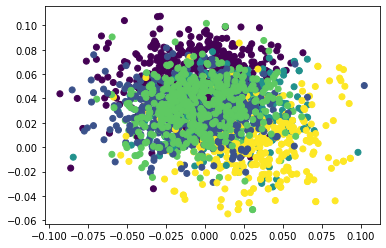

plot with true labels


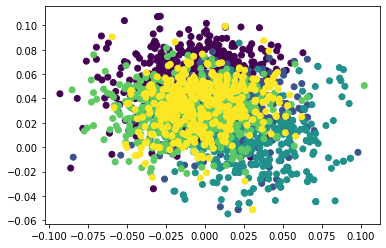

Word2vec : spectral clustering on  original  data accuracy :  0.25303370786516854
Word2vec : spectral clustering on  original  data NMI :  0.7690621907862331
Word2vec : spectral clustering on  original  data ARI :  0.7687600032705114
________________________________________________________________________________________________________
PCA
PCA  Data
plot with predicted labels


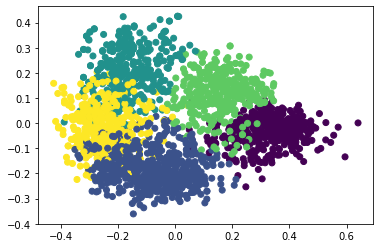

plot with true labels


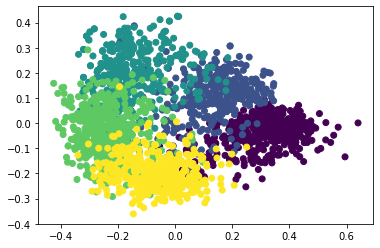

Word2vec : spectral clustering on  PCA  data accuracy :  0.37258426966292135
Word2vec : spectral clustering on  PCA  data NMI :  0.7107058649320812
Word2vec : spectral clustering on  PCA  data ARI :  0.6938303791014954
________________________________________________________________________________________________________
TSNE


KeyboardInterrupt: ignored

In [ ]:
def spec_clust_runner(key,K,true_labels):

  spectral_clust = SpectralClustering(n_clusters=K,assign_labels='discretize',random_state=0).fit(reduced_data[key])
  y_pred = spectral_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('Word2vec : spectral clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('Word2vec : spectral clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('Word2vec : spectral clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 5
for a in reduced_data.keys():
  spec_clust_runner(a,K,true_labels_BBC)

#### **HDBSCAN :**

In [ ]:
!pip install hdbscan
import hdbscan

original  Data
plot with predicted labels


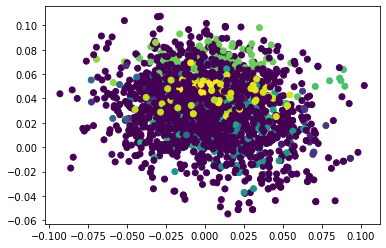

plot with true labels


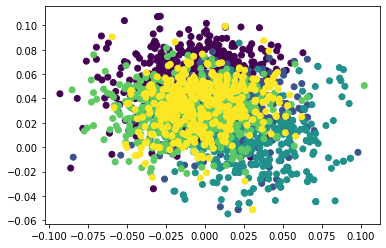

Word2vec : hdbscan clustering on  original  data accuracy :  0.01707865168539326
Word2vec : hdbscan clustering on  original  data NMI :  0.26717399111258155
Word2vec : hdbscan clustering on  original  data ARI :  0.017207953100042254
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


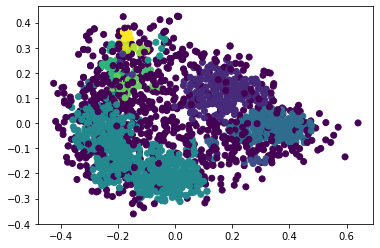

plot with true labels


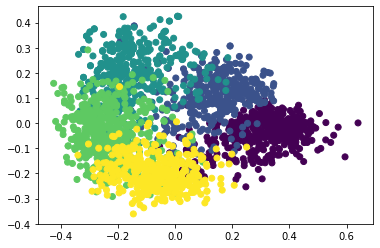

Word2vec : hdbscan clustering on  PCA  data accuracy :  0.11101123595505619
Word2vec : hdbscan clustering on  PCA  data NMI :  0.44504006374951255
Word2vec : hdbscan clustering on  PCA  data ARI :  0.28035411967568025
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


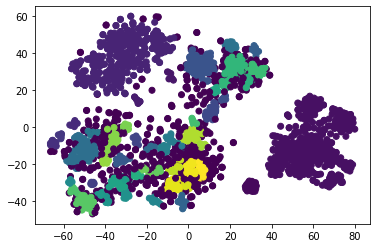

plot with true labels


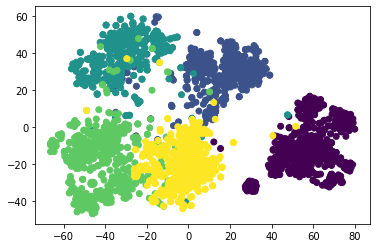

Word2vec : hdbscan clustering on  TSNE  data accuracy :  0.013932584269662922
Word2vec : hdbscan clustering on  TSNE  data NMI :  0.5762582195067681
Word2vec : hdbscan clustering on  TSNE  data ARI :  0.47548191901658166
________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


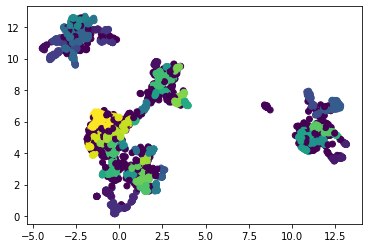

plot with true labels


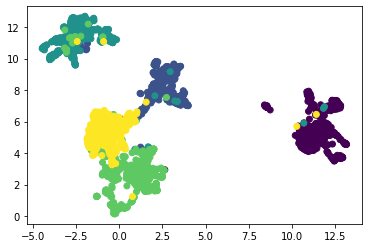

Word2vec : hdbscan clustering on  UMAP  data accuracy :  0.020224719101123594
Word2vec : hdbscan clustering on  UMAP  data NMI :  0.434794814779888
Word2vec : hdbscan clustering on  UMAP  data ARI :  0.07822294342703984
________________________________________________________________________________________________________


In [ ]:
def hdbscan_runner(key,true_labels):
  hdbscan_clust = hdbscan.HDBSCAN().fit(reduced_data[key])
  y_pred = hdbscan_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('Word2vec : hdbscan clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('Word2vec : hdbscan clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('Word2vec : hdbscan clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 5
for a in reduced_data.keys():
  hdbscan_runner(a,true_labels_BBC)

#### **CAH :**

original  Data
plot with predicted labels


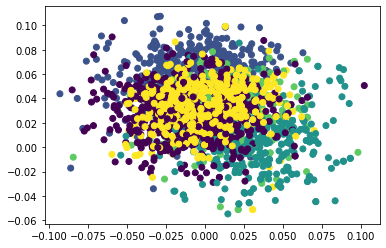

plot with true labels


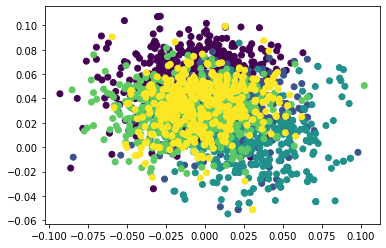

Word2vec : cah clustering on  original  data accuracy :  0.3096629213483146
Word2vec : cah clustering on  original  data NMI :  0.7447525330268314
Word2vec : cah clustering on  original  data ARI :  0.7364418657797974
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


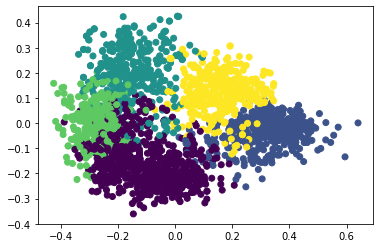

plot with true labels


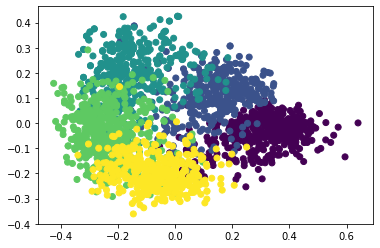

Word2vec : cah clustering on  PCA  data accuracy :  0.28719101123595503
Word2vec : cah clustering on  PCA  data NMI :  0.6907153489086992
Word2vec : cah clustering on  PCA  data ARI :  0.6300548875726691
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


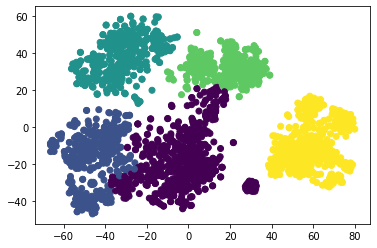

plot with true labels


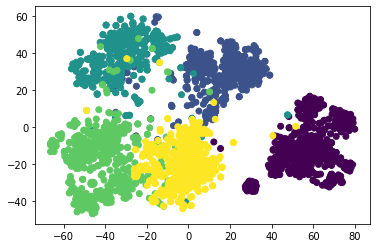

Word2vec : cah clustering on  TSNE  data accuracy :  0.18786516853932583
Word2vec : cah clustering on  TSNE  data NMI :  0.7693000751819028
Word2vec : cah clustering on  TSNE  data ARI :  0.7489348807758434
________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


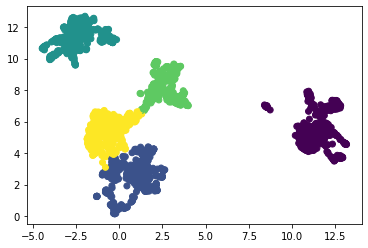

plot with true labels


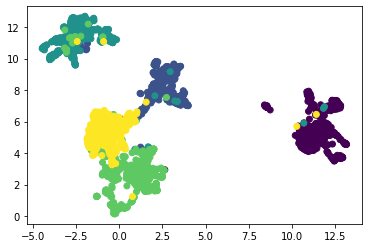

Word2vec : cah clustering on  UMAP  data accuracy :  0.5802247191011236
Word2vec : cah clustering on  UMAP  data NMI :  0.8591539921726105
Word2vec : cah clustering on  UMAP  data ARI :  0.8858844519248448
________________________________________________________________________________________________________


In [ ]:
def cah_runner(key,K,true_labels):
  y_pred = AgglomerativeClustering(n_clusters = K).fit_predict(reduced_data[key])
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('Word2vec : cah clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('Word2vec : cah clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('Word2vec : cah clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 5
for a in reduced_data.keys():
  cah_runner(a,K,true_labels_BBC)

In [ ]:
del()

##Partie2 Word2Vec:

###DCN for BBC:

In [ ]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs_BBC)
embeddings_DCN_BBC, cluster_assign_DCN_BBC = DCN(vectorized_docs_array, 5, 2, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data = {}
reduced_data['DCN']=embeddings_DCN_BBC

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:05<00:00,  8.54it/s]


Running k-means on the learned embeddings...
Starting DCN training...


100%|██████████| 50/50 [00:15<00:00,  3.17it/s]


###DKM for BBC : 

In [ ]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs_BBC)
X_reduced_DKM_BBC, cluster_assign_DKM_BBC = DKM(vectorized_docs_array, 5, 2, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data['DKM']=X_reduced_DKM_BBC

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:04<00:00, 10.96it/s]


Running k-means on the learned embeddings...
Starting DKM training...


100%|██████████| 20/20 [00:12<00:00,  1.61it/s]


###Plot Function BBC:

DCN  Data
plot with predicted labels


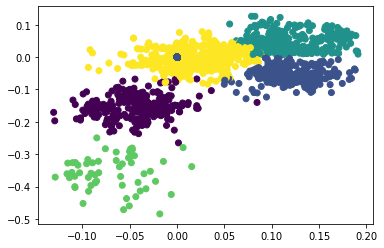

plot with true labels


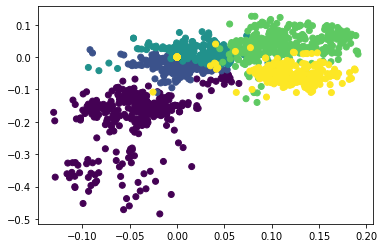

Word2vec : Kmeans clustering on  DCN  data accuracy :  0.18606741573033708
Word2vec : Kmeans clustering on  DCN  data NMI :  0.6708476695035651
Word2vec : Kmeans clustering on  DCN  data ARI :  0.5688692459152547
________________________________________________________________________________________________________
DKM  Data
plot with predicted labels


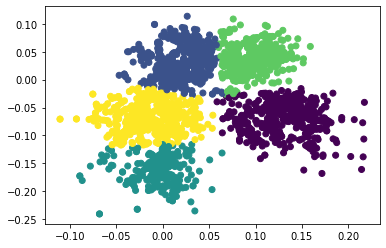

plot with true labels


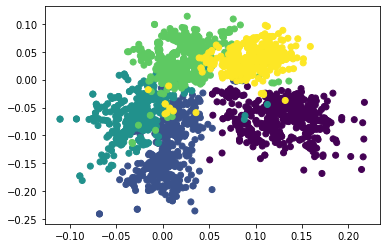

Word2vec : Kmeans clustering on  DKM  data accuracy :  0.2539325842696629
Word2vec : Kmeans clustering on  DKM  data NMI :  0.7120821931744616
Word2vec : Kmeans clustering on  DKM  data ARI :  0.7083650439882654
________________________________________________________________________________________________________


In [ ]:
def plot_result(key,true_labels,predicted_labels):
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=predicted_labels)
  plt.show()

  #-------
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('Word2vec : Kmeans clustering on ',key,' data accuracy : ',accuracy_score(true_labels,predicted_labels))
  print('Word2vec : Kmeans clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,predicted_labels))
  print('Word2vec : Kmeans clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,predicted_labels))
  print("________________________________________________________________________________________________________")


K = 5
plot_result("DCN",true_labels_BBC,cluster_assign_DCN_BBC)
plot_result("DKM",true_labels_BBC,cluster_assign_DKM_BBC)



## **Glove :**

In [ ]:
!wget -c "https://nlp.stanford.edu/data/glove.840B.300d.zip"
!unzip glove*.zip

--2021-12-04 18:21:28--  https://nlp.stanford.edu/data/glove.840B.300d.zip
Resolving nlp.stanford.edu (nlp.stanford.edu)... 171.64.67.140
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: http://downloads.cs.stanford.edu/nlp/data/glove.840B.300d.zip [following]
--2021-12-04 18:21:28--  http://downloads.cs.stanford.edu/nlp/data/glove.840B.300d.zip
Resolving downloads.cs.stanford.edu (downloads.cs.stanford.edu)... 171.64.64.22
Connecting to downloads.cs.stanford.edu (downloads.cs.stanford.edu)|171.64.64.22|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2176768927 (2.0G) [application/zip]
Saving to: ‘glove.840B.300d.zip’

glove.840B.300d.zip 100%[===================>]   2.03G  5.19MB/s    in 6m 50s  

2021-12-04 18:28:18 (5.06 MB/s) - ‘glove.840B.300d.zip’ saved [2176768927/2176768927]

Archive:  glove.840B.300d.zip
  inflating: glove.840B.300d.txt     



In [ ]:
from gensim.test.utils import datapath, get_tmpfile
from gensim.models import KeyedVectors
from gensim.scripts.glove2word2vec import glove2word2vec

glove_file = datapath("/content/glove.840B.300d.txt")
tmp_file = get_tmpfile("test_word2vec.txt")
_ = glove2word2vec(glove_file, tmp_file)
model = KeyedVectors.load_word2vec_format(tmp_file)

In [ ]:
vectorized_docs_BBC = vectorize(sentances_BBC, model=model)
len(vectorized_docs_BBC), len(vectorized_docs_BBC[0])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:17: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).


(2225, 300)

In [ ]:
import sys
def sizeof_fmt(num, suffix='B'):
    ''' by Fred Cirera,  https://stackoverflow.com/a/1094933/1870254, modified'''
    for unit in ['','Ki','Mi','Gi','Ti','Pi','Ei','Zi']:
        if abs(num) < 1024.0:
            return "%3.1f %s%s" % (num, unit, suffix)
        num /= 1024.0
    return "%.1f %s%s" % (num, 'Yi', suffix)

for name, size in sorted(((name, sys.getsizeof(value)) for name, value in locals().items()),
                         key= lambda x: -x[1])[:10]:
    print("{:>30}: {:>8}".format(name, sizeof_fmt(size)))

                        df_BBC:  6.5 MiB
                           _11:  6.5 MiB
                           _i7: 40.1 KiB
                    STOP_WORDS: 32.2 KiB
         abstracts_cleaned_BBC: 18.2 KiB
                 sentances_BBC: 18.2 KiB
               vectorized_docs: 18.2 KiB
                  abstract_BBC: 17.5 KiB
                    stop_words:  3.0 KiB
                           _i9:  1.3 KiB


### **Réduction de la dimension :**

In [ ]:
reduced_data = {}
reduced_data['original'] = vectorized_docs_BBC

#### **PCA** :

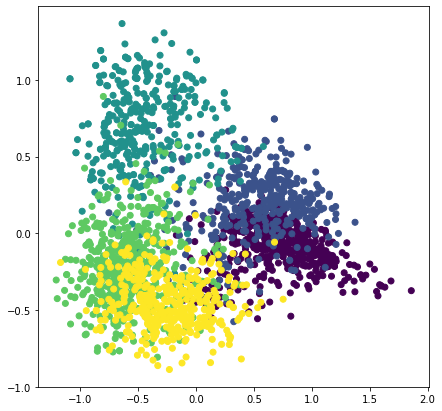

In [ ]:
pca = PCA(n_components=3)
pca_components = pca.fit_transform(vectorized_docs_BBC)
reduced_data["PCA"] = pca_components

#---------------plot----------------------------------

f = plt.figure(figsize=(7,7))
PCA_components = pd.DataFrame(pca_components)
plt.scatter(PCA_components[0], PCA_components[1],c=true_labels_BBC)
plt.show()

#### **T-SNE :**

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,


tsne init = 'pca'


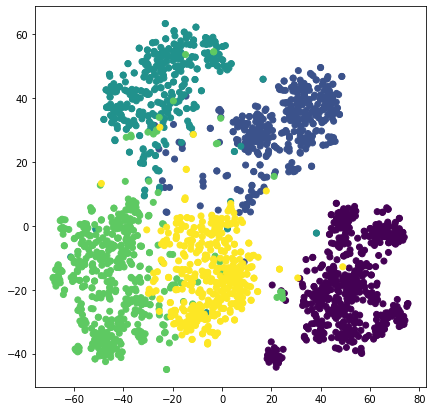

In [ ]:
tsne_components = TSNE(n_components=2,init='pca').fit_transform(vectorized_docs_BBC)
reduced_data["TSNE"] = tsne_components

#------------------plot-----------------

f = plt.figure(figsize=(7,7))
print("tsne init = 'pca'")
TSNE_components = pd.DataFrame(tsne_components) #tsne with inti ='pca'
plt.scatter(TSNE_components[0], TSNE_components[1],c=true_labels_BBC)
plt.show()

#### **UMAP :**

In [ ]:
!pip install umap-learn
import umap

     |████████████████████████████████| 86 kB 4.3 MB/s 
     |████████████████████████████████| 1.1 MB 19.2 MB/s 
  Created wheel for umap-learn: filename=umap_learn-0.5.2-py3-none-any.whl size=82709 sha256=82f4fa447c18185f57acd41fe6bdbb09901fd749da17bc8c1bdae91c83afc669
  Stored in directory: /root/.cache/pip/wheels/84/1b/c6/aaf68a748122632967cef4dffef68224eb16798b6793257d82
  Created wheel for pynndescent: filename=pynndescent-0.5.5-py3-none-any.whl size=52603 sha256=59b485d3038301d4efeda88740b60aaf03fc492f905c1743c8e80b0aaede7df4
  Stored in directory: /root/.cache/pip/wheels/af/e9/33/04db1436df0757c42fda8ea6796d7a8586e23c85fac355f476
Successfully built umap-learn pynndescent


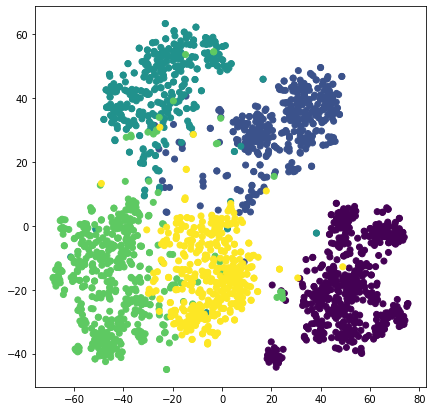

In [ ]:
reducer = umap.UMAP()
umap_components = reducer.fit_transform(vectorized_docs_BBC)
reduced_data["UMAP"] = umap_components
umap_components.shape

#----------------plot---------------------
f = plt.figure(figsize=(7,7))
UMAP_components = pd.DataFrame(umap_components) 
plt.scatter(TSNE_components[0], TSNE_components[1],c=true_labels_BBC)
plt.show()

#### **Autoencoders :**

In [ ]:
#Pas encore

### **Clustering :**

#### **K-means :**

original  Data
plot with predicted labels


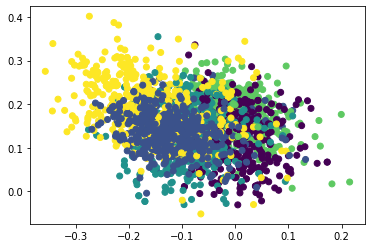

plot with true labels


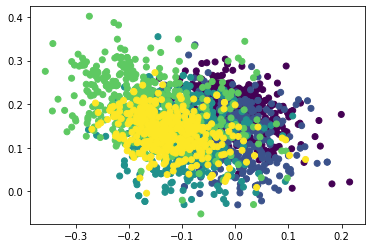

Glove : Kmeans clustering on  original  data accuracy :  0.1793258426966292
Glove : Kmeans clustering on  original  data NMI :  0.750542673151873
Glove : Kmeans clustering on  original  data ARI :  0.7607962444145803
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


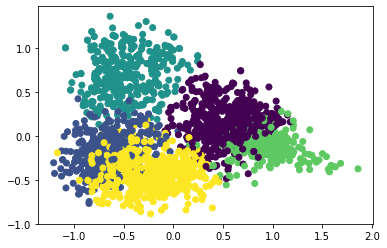

plot with true labels


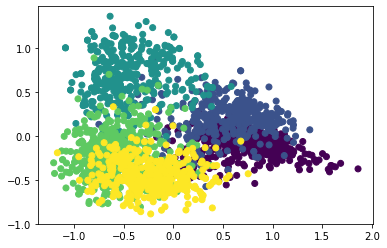

Glove : Kmeans clustering on  PCA  data accuracy :  0.3955056179775281
Glove : Kmeans clustering on  PCA  data NMI :  0.6231681809146041
Glove : Kmeans clustering on  PCA  data ARI :  0.6006845877239225
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


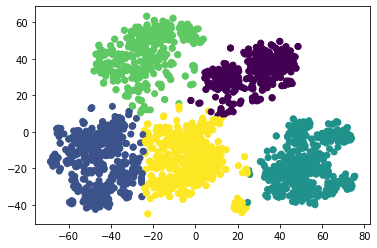

plot with true labels


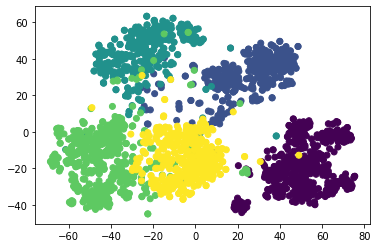

Glove : Kmeans clustering on  TSNE  data accuracy :  0.1842696629213483
Glove : Kmeans clustering on  TSNE  data NMI :  0.8080107336271621
Glove : Kmeans clustering on  TSNE  data ARI :  0.8256483344152153
________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


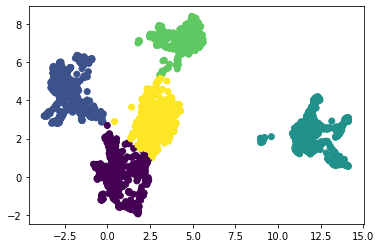

plot with true labels


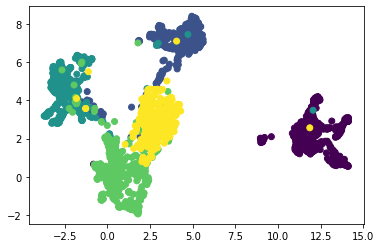

Glove : Kmeans clustering on  UMAP  data accuracy :  0.18831460674157302
Glove : Kmeans clustering on  UMAP  data NMI :  0.8565595936896936
Glove : Kmeans clustering on  UMAP  data ARI :  0.8821570202924984
________________________________________________________________________________________________________


In [ ]:
def kmeans_runner(key,K,true_labels):
  kmeans = KMeans(n_clusters=K, random_state=0,n_init=5).fit(reduced_data[key])
  y_pred = kmeans.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('Glove : Kmeans clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('Glove : Kmeans clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('Glove : Kmeans clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")


K = 5
for a in reduced_data.keys():
  kmeans_runner(a,K,true_labels_BBC)

#### **Spectral clustering :**

In [ ]:
def spec_clust_runner(key,K,true_labels):

  spectral_clust = SpectralClustering(n_clusters=K,assign_labels='discretize',random_state=0).fit(reduced_data[key])
  y_pred = spectral_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('Glove : spectral clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('Glove : spectral clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('Glove : spectral clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 5
for a in reduced_data.keys():
  spec_clust_runner(a,K,true_labels)

#### **HDBSCAN :**

In [ ]:
!pip install hdbscan
import hdbscan

     |████████████████████████████████| 6.4 MB 5.9 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for hdbscan: filename=hdbscan-0.8.27-cp37-cp37m-linux_x86_64.whl size=2311938 sha256=3f2d5a3cf124eb6cee4b608f2d62d3174e3fd6d14de5ed1f352e73922c39a52b
  Stored in directory: /root/.cache/pip/wheels/73/5f/2f/9a259b84003b84847c259779206acecabb25ab56f1506ee72b
Successfully built hdbscan


original  Data
plot with predicted labels


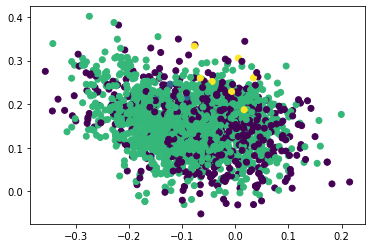

plot with true labels


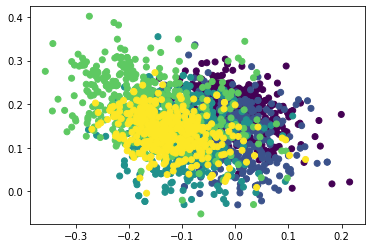

Glove : hdbscan clustering on  original  data accuracy :  0.09752808988764045
Glove : hdbscan clustering on  original  data NMI :  0.03468500049940074
Glove : hdbscan clustering on  original  data ARI :  0.01864276480790489
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


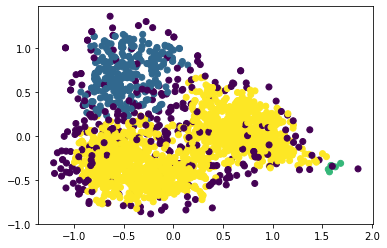

plot with true labels


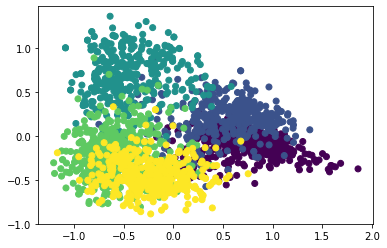

Glove : hdbscan clustering on  PCA  data accuracy :  0.014831460674157304
Glove : hdbscan clustering on  PCA  data NMI :  0.2627672692018345
Glove : hdbscan clustering on  PCA  data ARI :  0.13448950954125286
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


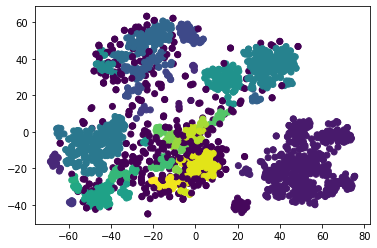

plot with true labels


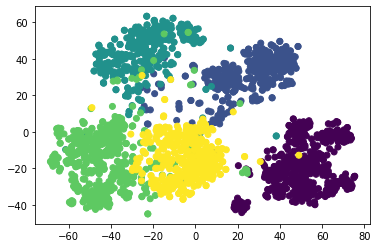

Glove : hdbscan clustering on  TSNE  data accuracy :  0.019325842696629212
Glove : hdbscan clustering on  TSNE  data NMI :  0.589840913892754
Glove : hdbscan clustering on  TSNE  data ARI :  0.44494091251548373
________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


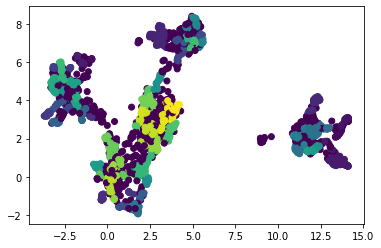

plot with true labels


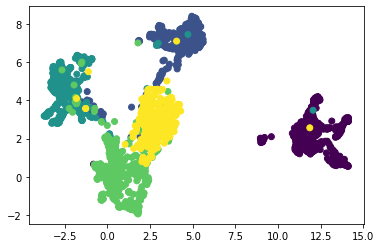

Glove : hdbscan clustering on  UMAP  data accuracy :  0.015730337078651686
Glove : hdbscan clustering on  UMAP  data NMI :  0.4131928058150543
Glove : hdbscan clustering on  UMAP  data ARI :  0.05317289620391166
________________________________________________________________________________________________________


In [ ]:
def hdbscan_runner(key,true_labels):
  hdbscan_clust = hdbscan.HDBSCAN().fit(reduced_data[key])
  y_pred = hdbscan_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('Glove : hdbscan clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('Glove : hdbscan clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('Glove : hdbscan clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 5
for a in reduced_data.keys():
  hdbscan_runner(a,true_labels_BBC)

#### **CAH :**

original  Data
plot with predicted labels


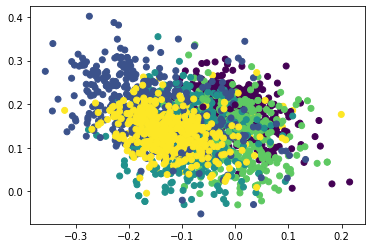

plot with true labels


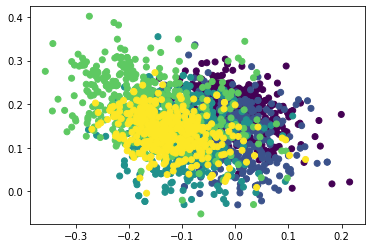

Glove : cah clustering on  original  data accuracy :  0.5582022471910112
Glove : cah clustering on  original  data NMI :  0.8034321692399434
Glove : cah clustering on  original  data ARI :  0.8279186903841348
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


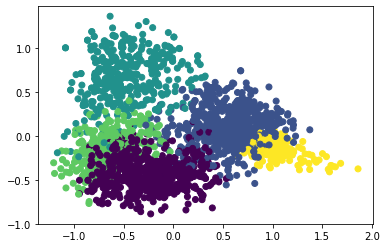

plot with true labels


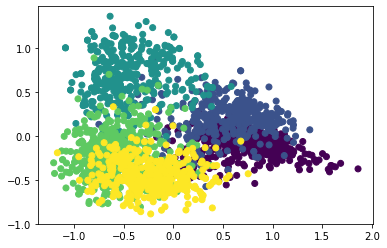

Glove : cah clustering on  PCA  data accuracy :  0.4853932584269663
Glove : cah clustering on  PCA  data NMI :  0.6010836333491343
Glove : cah clustering on  PCA  data ARI :  0.5088796652498538
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


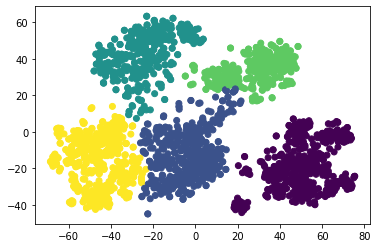

plot with true labels


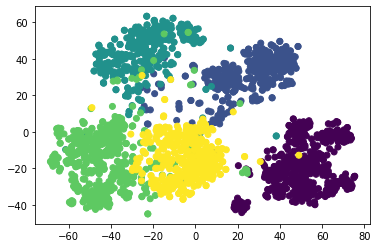

Glove : cah clustering on  TSNE  data accuracy :  0.43640449438202245
Glove : cah clustering on  TSNE  data NMI :  0.8224293907824445
Glove : cah clustering on  TSNE  data ARI :  0.8401417178215035
________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


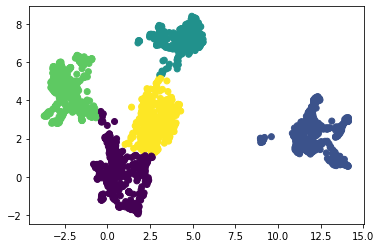

plot with true labels


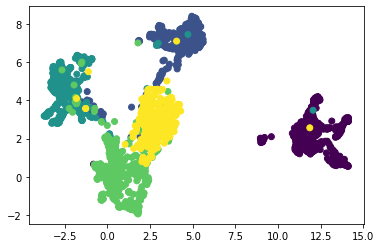

Glove : cah clustering on  UMAP  data accuracy :  0.18876404494382024
Glove : cah clustering on  UMAP  data NMI :  0.8537145967138238
Glove : cah clustering on  UMAP  data ARI :  0.8817343595288742
________________________________________________________________________________________________________


In [ ]:
def cah_runner(key,K,true_labels):
  y_pred = AgglomerativeClustering(n_clusters = K).fit_predict(reduced_data[key])
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('Glove : cah clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('Glove : cah clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('Glove : cah clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 5
for a in reduced_data.keys():
  cah_runner(a,K,true_labels_BBC)

##Partie2 Glove:

###DCN for BBC:

In [ ]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs_BBC)
embeddings_DCN_BBC, cluster_assign_DCN_BBC = DCN(vectorized_docs_array, 5, 2, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data = {}
reduced_data['DCN']=embeddings_DCN_BBC

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:38<00:00,  1.31it/s]


Running k-means on the learned embeddings...
Starting DCN training...


100%|██████████| 50/50 [00:42<00:00,  1.18it/s]


###DKM for BBC : 

In [ ]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs_BBC)
X_reduced_DKM_BBC, cluster_assign_DKM_BBC = DKM(vectorized_docs_array, 5, 2, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data['DKM']=X_reduced_DKM_BBC

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:38<00:00,  1.31it/s]


Running k-means on the learned embeddings...
Starting DKM training...


 80%|████████  | 16/20 [01:00<00:15,  3.77s/it]

###Plot Function BBC:

DCN  Data
plot with predicted labels


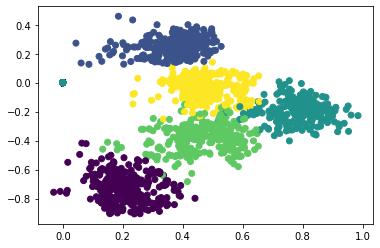

plot with true labels


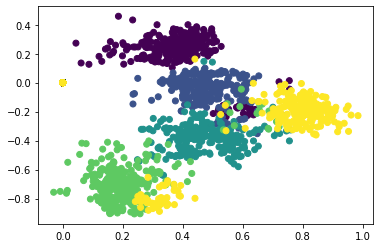

Word2vec : Kmeans clustering on  DCN  data accuracy :  0.02247191011235955
Word2vec : Kmeans clustering on  DCN  data NMI :  0.7295091539351722
Word2vec : Kmeans clustering on  DCN  data ARI :  0.7523278905912126
________________________________________________________________________________________________________
DKM  Data
plot with predicted labels


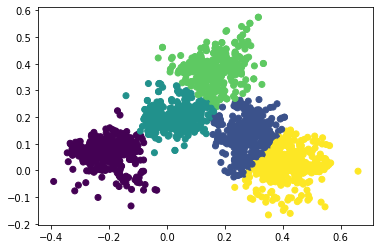

plot with true labels


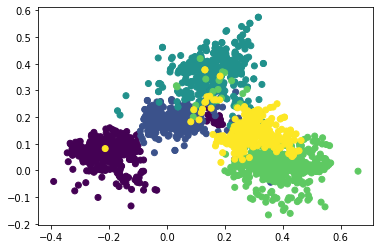

Word2vec : Kmeans clustering on  DKM  data accuracy :  0.25348314606741573
Word2vec : Kmeans clustering on  DKM  data NMI :  0.6999744625183143
Word2vec : Kmeans clustering on  DKM  data ARI :  0.7071131501004538
________________________________________________________________________________________________________


In [ ]:
def plot_result(key,true_labels,predicted_labels):
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=predicted_labels)
  plt.show()

  #-------
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('Word2vec : Kmeans clustering on ',key,' data accuracy : ',accuracy_score(true_labels,predicted_labels))
  print('Word2vec : Kmeans clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,predicted_labels))
  print('Word2vec : Kmeans clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,predicted_labels))
  print("________________________________________________________________________________________________________")


K = 5
plot_result("DCN",true_labels_BBC,cluster_assign_DCN_BBC)
plot_result("DKM",true_labels_BBC,cluster_assign_DKM_BBC)



## Conclusion 

nous avons étudié l'analyse du texte en utilisant word embedding comme base de représentation. 

Pour cette raison, nous avons utilisé les méthodes bien connues : Wor2Vec et GloVe. 

Le but de cette étude est d'identifier quelle méthode est la différence entre ces deux avec les différentes méthodes et plus efficace pour apprendre les représentations vectorielles des mots qui fournissent la signification sémantique des mots .

Comme résultat, nous avons montré que, le choix des modèles d'apprentissage est plus délicat car il dépend de la nature des données d'apprentissage. 

## **BERT :**

### **Document embedding :**

In [ ]:
true_labels, u  = pd.factorize(df_BBC['label'])

In [ ]:
vectorized_docs = model.encode(abstract_BBC)

### **Réduction de la dimension :**

In [ ]:
reduced_data = {}
reduced_data['original'] = vectorized_docs

#### **PCA** :

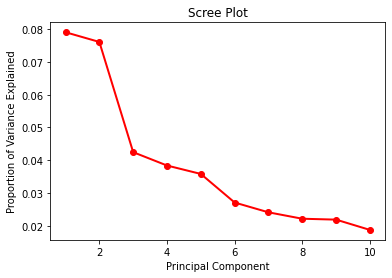

In [ ]:
#NUMBER OF COMPONENTS PCA :
pca = PCA(n_components=10)
pca_component = pca.fit_transform(vectorized_docs)

PC_values = np.arange(pca.n_components_) + 1
plt.plot(PC_values, pca.explained_variance_ratio_, 'ro-', linewidth=2)
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Proportion of Variance Explained')
plt.show()

On peut prendre le nombre de composantes principal = 3

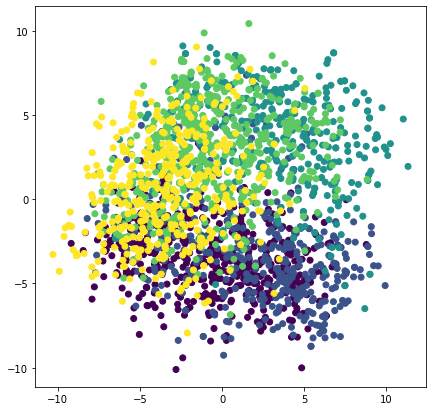

In [ ]:
pca = PCA(n_components=3)
pca_components = pca.fit_transform(vectorized_docs)
reduced_data["PCA"] = pca_components

#---------------plot----------------------------------

f = plt.figure(figsize=(7,7))
PCA_components = pd.DataFrame(pca_components)
plt.scatter(PCA_components[0], PCA_components[1],c=true_labels)
plt.show()

pca with kernel =  linear


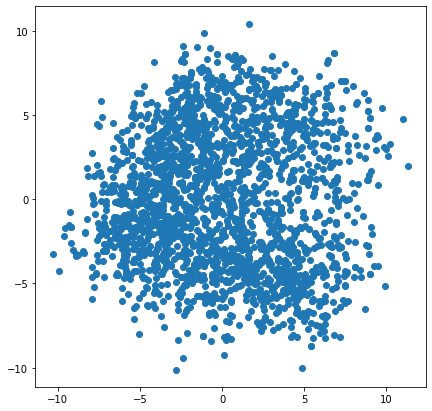

________________________________________________________________________
pca with kernel =  poly


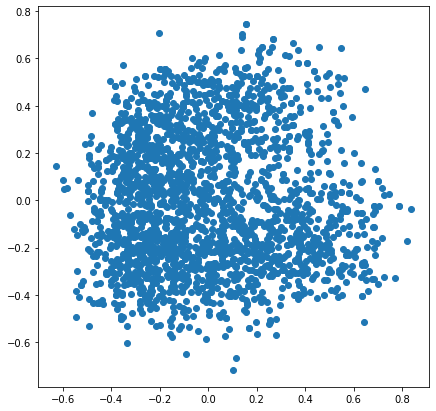

________________________________________________________________________
pca with kernel =  rbf


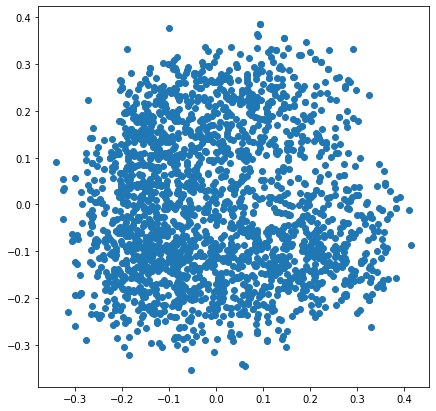

________________________________________________________________________
pca with kernel =  sigmoid


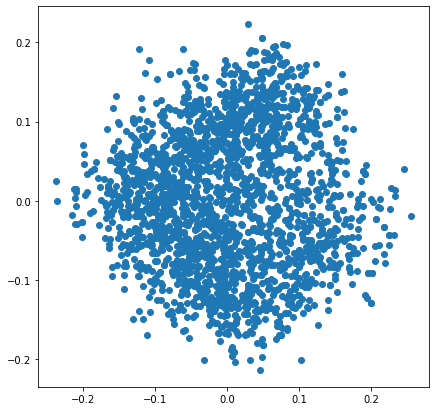

________________________________________________________________________
pca with kernel =  cosine


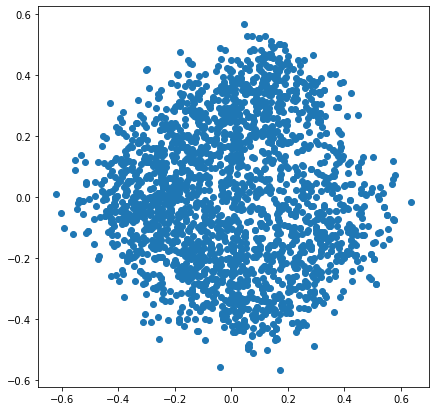

________________________________________________________________________


In [ ]:
#PCA WITH DIFFERENT KERNELS :
from sklearn.decomposition import KernelPCA

list_kernel = ["linear", "poly", "rbf", "sigmoid","cosine"]
for i in list_kernel:
  transformer = KernelPCA(n_components=4, kernel=i)
  X_transformed = transformer.fit_transform(vectorized_docs)
  if i == "cosine":
    reduced_data["cosine"] = X_transformed 
  f = plt.figure(figsize=(7,7))
  PCA_componentss = pd.DataFrame(X_transformed)
  plt.scatter(PCA_componentss[0], PCA_componentss[1])
  print("pca with kernel = ",i)
  plt.show()
  print("________________________________________________________________________")

#### **T-SNE :**

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,


tsne init = 'pca'


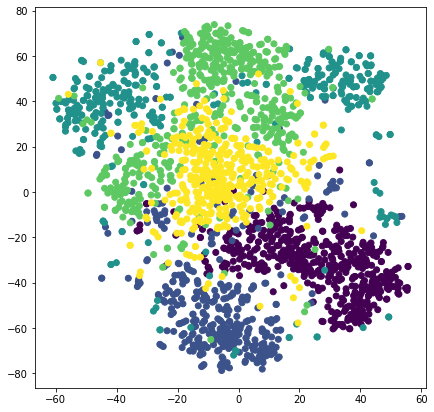

In [ ]:
tsne_components = TSNE(n_components=2,init='pca').fit_transform(vectorized_docs)
reduced_data["TSNE"] = tsne_components

#------------------plot-----------------

f = plt.figure(figsize=(7,7))
print("tsne init = 'pca'")
TSNE_components = pd.DataFrame(tsne_components) #tsne with inti ='pca'
plt.scatter(TSNE_components[0], TSNE_components[1],c=true_labels)
plt.show()

#### **UMAP :**

In [ ]:
#!pip install umap-learn
import umap

/usr/local/lib/python3.7/dist-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.
  warnings.warn(problem)


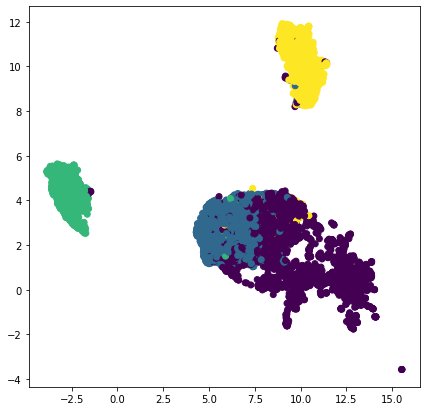

In [ ]:
reducer = umap.UMAP()
umap_components = reducer.fit_transform(vectorized_docs)
reduced_data["UMAP"] = umap_components
umap_components.shape

#----------------plot---------------------
f = plt.figure(figsize=(7,7))
UMAP_components = pd.DataFrame(umap_components) 
plt.scatter(UMAP_components[0], UMAP_components[1],c=true_labels)
plt.show()

#### **Commentaire reduction de la dimension :**


### **Clustering :**

#### **K-means :**

original  Data
plot with predicted labels


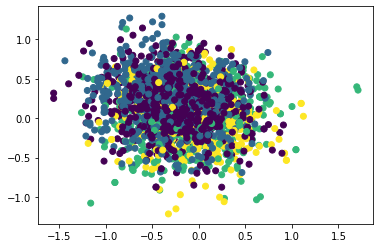

plot with true labels


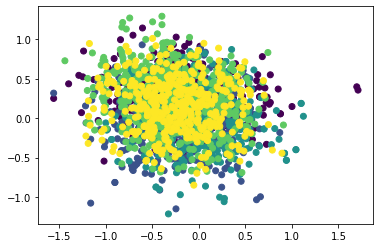

BERT : Kmeans clustering on  original  data accuracy :  0.13617977528089886
BERT : Kmeans clustering on  original  data NMI :  0.38510311612553194
BERT : Kmeans clustering on  original  data ARI :  0.31336308920234807
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


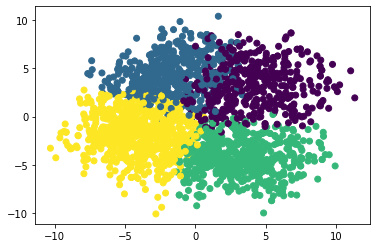

plot with true labels


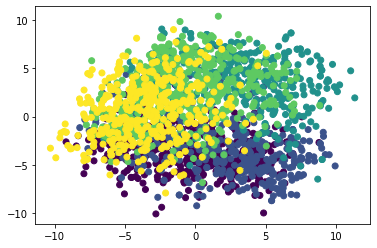

BERT : Kmeans clustering on  PCA  data accuracy :  0.07955056179775281
BERT : Kmeans clustering on  PCA  data NMI :  0.2711347452931584
BERT : Kmeans clustering on  PCA  data ARI :  0.19972063586254704
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


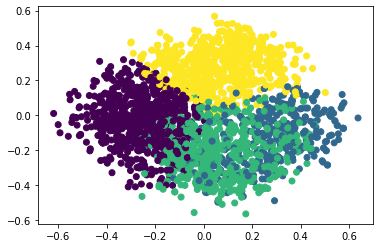

plot with true labels


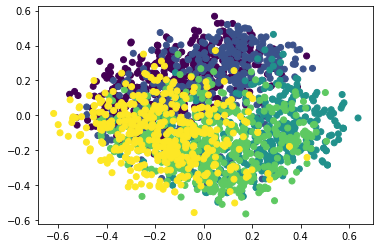

BERT : Kmeans clustering on  cosine  data accuracy :  0.13393258426966292
BERT : Kmeans clustering on  cosine  data NMI :  0.36083739312538043
BERT : Kmeans clustering on  cosine  data ARI :  0.3038416106624409
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


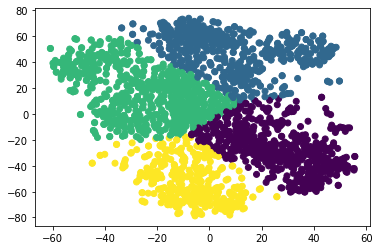

plot with true labels


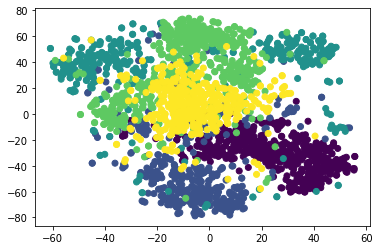

BERT : Kmeans clustering on  TSNE  data accuracy :  0.30651685393258427
BERT : Kmeans clustering on  TSNE  data NMI :  0.41849426728097006
BERT : Kmeans clustering on  TSNE  data ARI :  0.3843568405349975
________________________________________________________________________________________________________


In [ ]:
def kmeans_runner(key,K,true_labels):
  kmeans = KMeans(n_clusters=K, random_state=0,n_init=5).fit(reduced_data[key])
  y_pred = kmeans.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('BERT : Kmeans clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('BERT : Kmeans clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('BERT : Kmeans clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))  

  print("________________________________________________________________________________________________________")


K = 4
for a in reduced_data.keys():
  kmeans_runner(a,K,true_labels)

Commentaire K-means Clustering :

En terme d'accuracy : TSNE a donné le plus mauvais résultat et ca prouve que c'est déconseillé de faire suivre TSNE par une K-means 
  - Le problème avec t-SNE est qu'elle ne préserve pas les distances ni la densité. elle ne préserve que dans une certaine mesure les voisins les plus proches. La différence est subtile, mais affecte tout algorithme basé sur la densité ou la distance ce qui est le cas pour K-means

PCA ( linear kernel) a donné le meilleur résulat (47%) par rapport aux autres résultats




#### **Spectral clustering :**

original  Data
plot with predicted labels


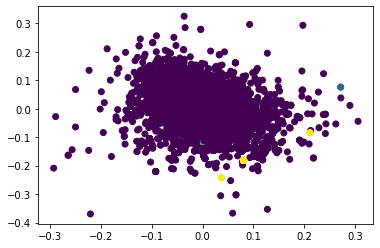

plot with true labels


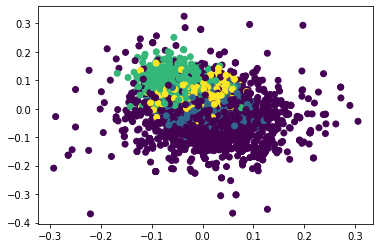

Word2vec : spectral clustering on  original  data accuracy :  0.44200140944326993
Word2vec : spectral clustering on  original  data NMI :  0.011432439464275107
Word2vec : spectral clustering on  original  data ARI :  -0.007784530943189727
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


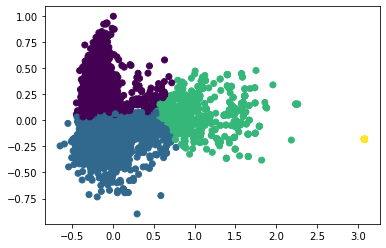

plot with true labels


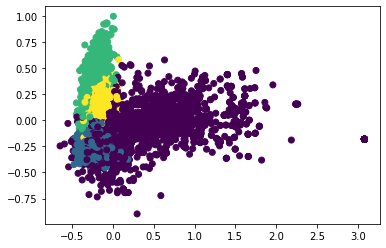

Word2vec : spectral clustering on  PCA  data accuracy :  0.23255813953488372
Word2vec : spectral clustering on  PCA  data NMI :  0.44871444007371325
Word2vec : spectral clustering on  PCA  data ARI :  0.3210521050916887
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


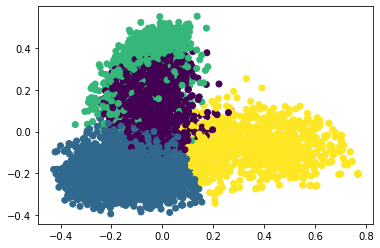

plot with true labels


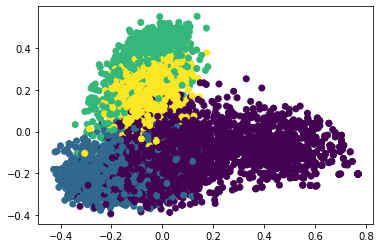

Word2vec : spectral clustering on  cosine  data accuracy :  0.3916842847075405
Word2vec : spectral clustering on  cosine  data NMI :  0.6036230644293806
Word2vec : spectral clustering on  cosine  data ARI :  0.43125705240878764
________________________________________________________________________________________________________


KeyboardInterrupt: ignored

In [ ]:
def spec_clust_runner(key,K,true_labels):

  spectral_clust = SpectralClustering(n_clusters=K,assign_labels='discretize',random_state=0).fit(reduced_data[key])
  y_pred = spectral_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('BERT : spectral clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('BERT : spectral clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('BERT : spectral clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 4
for a in reduced_data.keys():
  spec_clust_runner(a,K,true_labels)

En comparant le Spectral clustering & k-means :

L'accuracy a augmenté pour Spectral clustering par rapport au k-means dans le cas de données originaux + pca non linéaire (cosine kernel)

En revanche on a remaqué une baisse d'accuracy dans le cas du pca linéaire ( linear kernel)

Meme en terme de visualisation : non linear pca ("cosine") a donné un affichage qui ressemble à l'affichage en utilisant les vrai labels

Sinon en terme de temps d'éxecution malgré que le spectral clustering se base sur la méthode k-means mais pas sur les coordonnées originales, mais sur un embedding qui se focalise sur la connectivité, donc au lieu de minimiser les erreurs au carré dans l'input, il minimise les erreurs au carré sur la capacité à reconstruire les voisins et c'est souvent mieux.

#### **HDBSCAN :**

In [ ]:
#!pip install hdbscan
import hdbscan

original  Data
plot with predicted labels


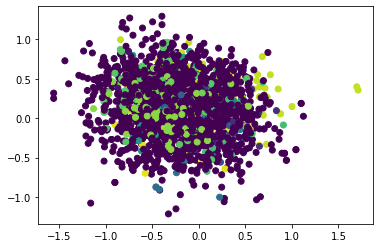

plot with true labels


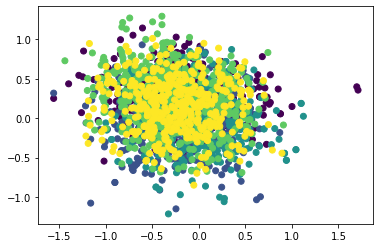

BERT : hdbscan clustering on  original  data accuracy :  0.004943820224719101
BERT : hdbscan clustering on  original  data NMI :  0.2909452285808928
BERT : hdbscan clustering on  original  data ARI :  0.03616808801111215
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


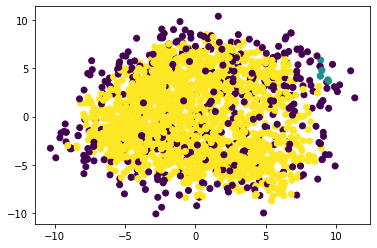

plot with true labels


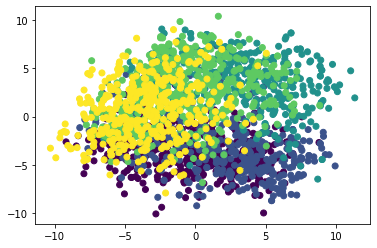

BERT : hdbscan clustering on  PCA  data accuracy :  0.14202247191011236
BERT : hdbscan clustering on  PCA  data NMI :  0.014879387077719958
BERT : hdbscan clustering on  PCA  data ARI :  0.008603620267260107
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


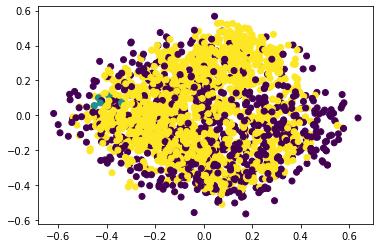

plot with true labels


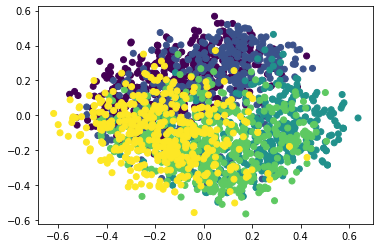

BERT : hdbscan clustering on  cosine  data accuracy :  0.13887640449438202
BERT : hdbscan clustering on  cosine  data NMI :  0.02383816664159193
BERT : hdbscan clustering on  cosine  data ARI :  0.014792139088643293
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


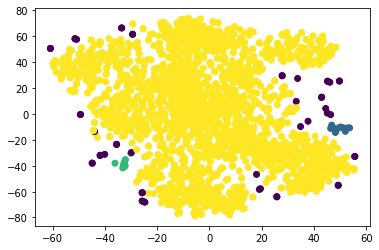

plot with true labels


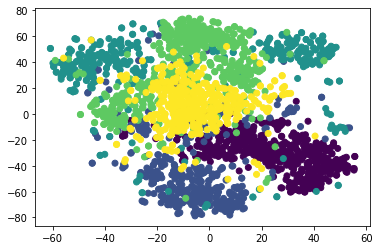

BERT : hdbscan clustering on  TSNE  data accuracy :  0.1662921348314607
BERT : hdbscan clustering on  TSNE  data NMI :  0.026783739655790867
BERT : hdbscan clustering on  TSNE  data ARI :  0.004088126007558102
________________________________________________________________________________________________________


In [ ]:
def hdbscan_runner(key,true_labels):
  hdbscan_clust = hdbscan.HDBSCAN(algorithm='best', alpha=1.0, metric='euclidean',cluster_selection_epsilon=0.5).fit(reduced_data[key])
  y_pred = hdbscan_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('BERT : hdbscan clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('BERT : hdbscan clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('BERT : hdbscan clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 4
for a in reduced_data.keys():
  hdbscan_runner(a,true_labels)

En terme d'accuracy : aucun algorithme a donné des bons résultats 

Pour original data : l'algorithme n'a pas donné de bons résultat vu qu'il est pas trés bon en high dimensional clustering 

linear & non linear pca sont les algorithmes qui ont donné les meilleurs résultats par rapport aux autres algorithmes (avec un accuracy ~ 20%)

#### **CAH :**

original  Data
plot with predicted labels


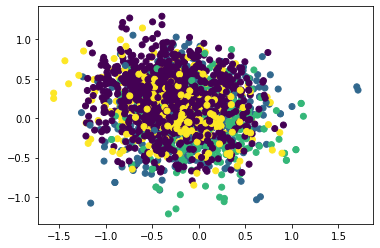

plot with true labels


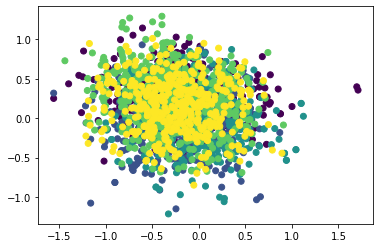

BERT : cah clustering on  original  data accuracy :  0.26157303370786517
BERT : cah clustering on  original  data NMI :  0.429329875838555
BERT : cah clustering on  original  data ARI :  0.3573148670622253
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


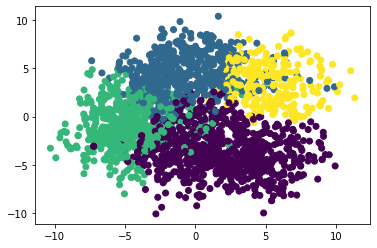

plot with true labels


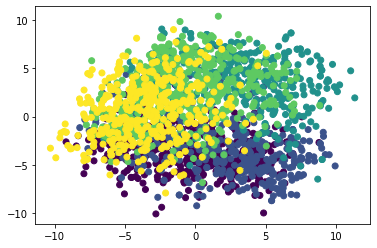

BERT : cah clustering on  PCA  data accuracy :  0.21168539325842697
BERT : cah clustering on  PCA  data NMI :  0.22584742048041748
BERT : cah clustering on  PCA  data ARI :  0.16524098617906524
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


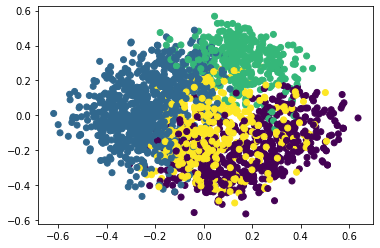

plot with true labels


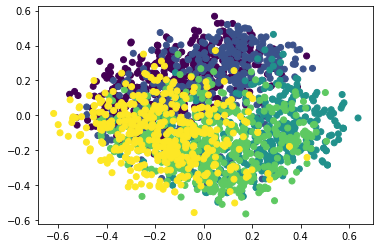

BERT : cah clustering on  cosine  data accuracy :  0.1649438202247191
BERT : cah clustering on  cosine  data NMI :  0.2737694069776796
BERT : cah clustering on  cosine  data ARI :  0.20344877192724858
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


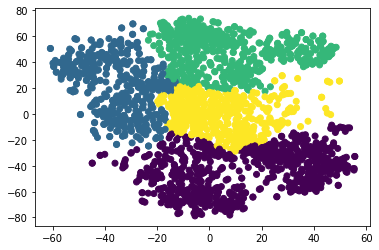

plot with true labels


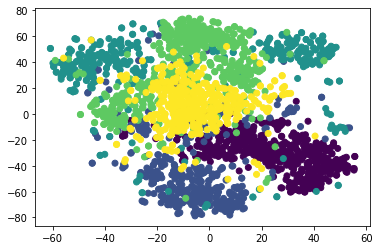

BERT : cah clustering on  TSNE  data accuracy :  0.2638202247191011
BERT : cah clustering on  TSNE  data NMI :  0.365589609863793
BERT : cah clustering on  TSNE  data ARI :  0.3150354371729899
________________________________________________________________________________________________________


In [ ]:
def cah_runner(key,K,true_labels):
  y_pred = AgglomerativeClustering(n_clusters = K).fit_predict(reduced_data[key])
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('BERT : cah clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('BERT : cah clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('BERT : cah clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 4
for a in reduced_data.keys():
  cah_runner(a,K,true_labels)

PCA("cosine kernel") a donné le meilleur résultas en terme d'accuracy (50%)et visualisation (affichages avec predicted & true labels trés similaires) 

linear PCA + original data : ont donné une accuracy trés basse

NMI & ARI : résultat similaires pour tout les algorithmes

LA cah reste toujours non adapté aux grands volumes de données à cause du temps de calcul qui explose et cela s’explique complètement par les méthodes de calcul de l’algorithme.


##Partie 2 BERT :

###DCN for BBC :

In [ ]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
embeddings_DCN_Classic4, cluster_assign_DCN_Classic4 = DCN(vectorized_docs_array, 4, 2, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data = {}
reduced_data['DCN']=embeddings_DCN_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:03<00:00, 12.77it/s]


Running k-means on the learned embeddings...
Starting DCN training...


100%|██████████| 50/50 [00:16<00:00,  3.10it/s]


###DKM for BBC :

In [ ]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
X_reduced_DKM_Classic4, cluster_assign_DKM_Classic4 = DKM(vectorized_docs_array, 4, 2, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data['DKM']=X_reduced_DKM_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:03<00:00, 12.93it/s]


Running k-means on the learned embeddings...
Starting DKM training...


100%|██████████| 20/20 [00:10<00:00,  1.90it/s]


###Plot Function BBC:

DCN  Data
plot with predicted labels


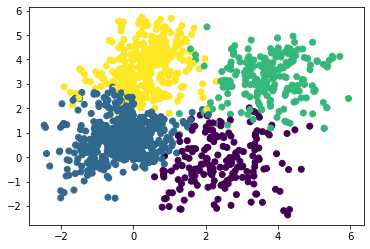

plot with true labels


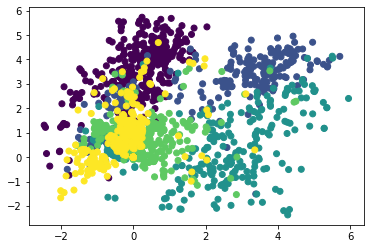

BERT : clustering with  DCN  data accuracy :  0.08359550561797753
BERT : clustering with  DCN  data NMI :  0.4282987013317843
BERT : clustering with  DCN  data ARI :  0.3536353265603052
________________________________________________________________________________________________________
DKM  Data
plot with predicted labels


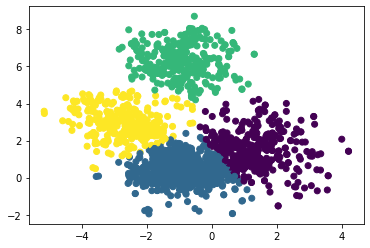

plot with true labels


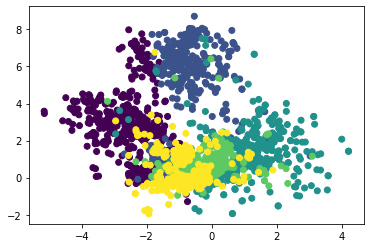

BERT : clustering with  DKM  data accuracy :  0.06112359550561798
BERT : clustering with  DKM  data NMI :  0.3983310759669393
BERT : clustering with  DKM  data ARI :  0.2782173465240109
________________________________________________________________________________________________________


In [ ]:
def plot_result(key,true_labels,predicted_labels):
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=predicted_labels)
  plt.show()

  #-------
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('BERT : clustering with ',key,' data accuracy : ',accuracy_score(true_labels,predicted_labels))
  print('BERT : clustering with ',key,' data NMI : ',normalized_mutual_info_score(true_labels,predicted_labels))
  print('BERT : clustering with ',key,' data ARI : ',adjusted_rand_score(true_labels,predicted_labels))
  print("________________________________________________________________________________________________________")


K = 4
plot_result("DCN",true_labels,cluster_assign_DCN_Classic4)
plot_result("DKM",true_labels,cluster_assign_DKM_Classic4)



DCN  a gangé en terme d'accuracy 45% vs 25% pour DKM

Par les deux méthodes ont eu les memes score NMI & ARI

## **RoBERTa :**

### **Document embedding :**

In [ ]:
true_labels, u  = pd.factorize(df_BBC['label'])

In [ ]:
model = SentenceTransformer('sentence-transformers/roberta-base-nli-stsb-mean-tokens')

In [ ]:
vectorized_docs = model.encode(abstract_BBC)

### **Réduction de la dimension :**

In [ ]:
reduced_data = {}
reduced_data['original'] = vectorized_docs

#### **PCA** :

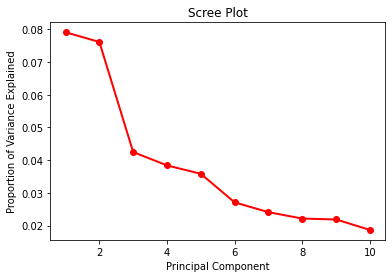

In [ ]:
#NUMBER OF COMPONENTS PCA :
pca = PCA(n_components=10)
pca_component = pca.fit_transform(vectorized_docs)

PC_values = np.arange(pca.n_components_) + 1
plt.plot(PC_values, pca.explained_variance_ratio_, 'ro-', linewidth=2)
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Proportion of Variance Explained')
plt.show()

On peut prendre le nombre de composantes principal = 3

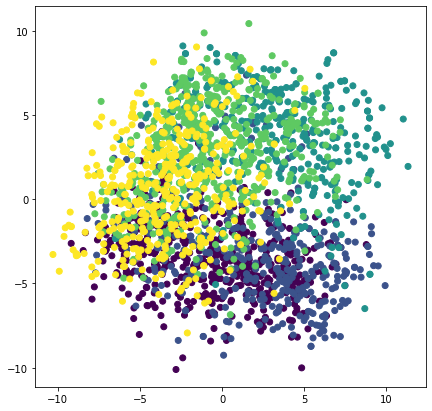

In [ ]:
pca = PCA(n_components=3)
pca_components = pca.fit_transform(vectorized_docs)
reduced_data["PCA"] = pca_components

#---------------plot----------------------------------

f = plt.figure(figsize=(7,7))
PCA_components = pd.DataFrame(pca_components)
plt.scatter(PCA_components[0], PCA_components[1],c=true_labels)
plt.show()

pca with kernel =  linear


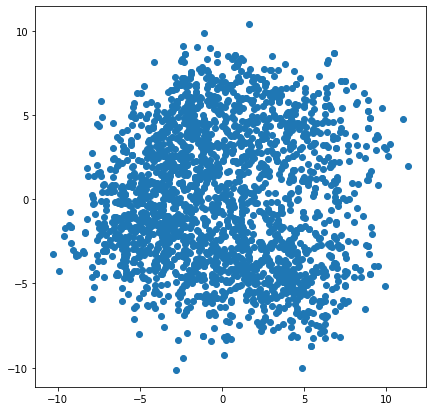

________________________________________________________________________
pca with kernel =  poly


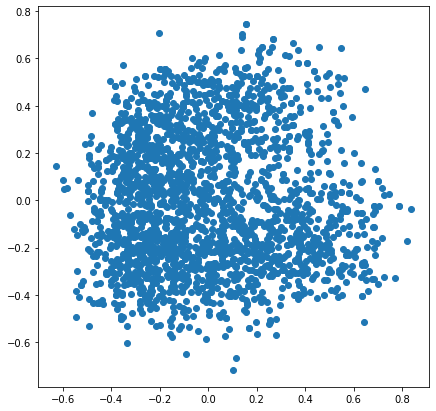

________________________________________________________________________
pca with kernel =  rbf


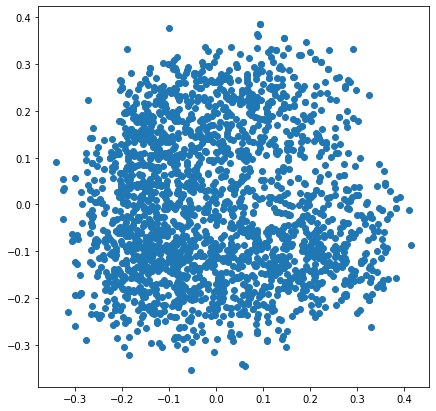

________________________________________________________________________
pca with kernel =  sigmoid


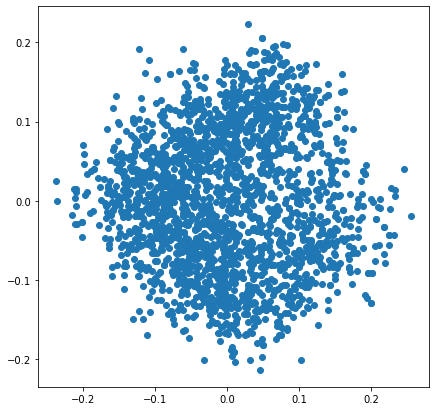

________________________________________________________________________
pca with kernel =  cosine


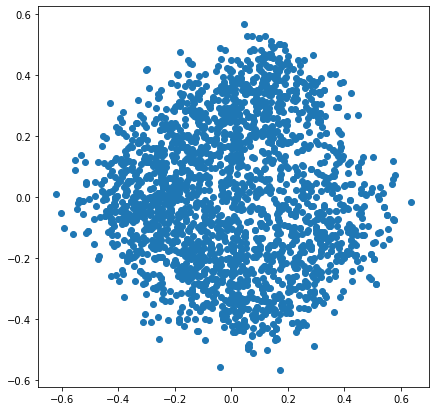

________________________________________________________________________


In [ ]:
#PCA WITH DIFFERENT KERNELS :
from sklearn.decomposition import KernelPCA

list_kernel = ["linear", "poly", "rbf", "sigmoid","cosine"]
for i in list_kernel:
  transformer = KernelPCA(n_components=4, kernel=i)
  X_transformed = transformer.fit_transform(vectorized_docs)
  if i == "rbf":
    reduced_data["cosine"] = X_transformed 
  f = plt.figure(figsize=(7,7))
  PCA_componentss = pd.DataFrame(X_transformed)
  plt.scatter(PCA_componentss[0], PCA_componentss[1])
  print("pca with kernel = ",i)
  plt.show()
  print("________________________________________________________________________")

#### **T-SNE :**

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,


tsne init = 'pca'


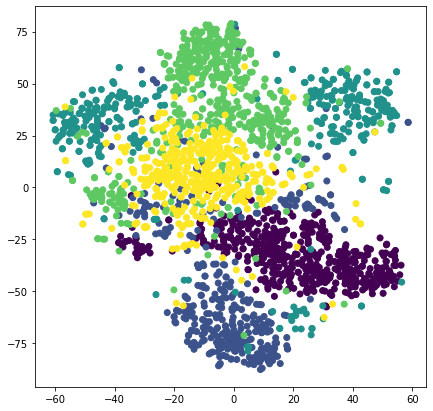

In [ ]:
tsne_components = TSNE(n_components=2,init='pca').fit_transform(vectorized_docs)
reduced_data["TSNE"] = tsne_components

#------------------plot-----------------

f = plt.figure(figsize=(7,7))
print("tsne init = 'pca'")
TSNE_components = pd.DataFrame(tsne_components) #tsne with inti ='pca'
plt.scatter(TSNE_components[0], TSNE_components[1],c=true_labels)
plt.show()

#### **UMAP :**

In [ ]:
#!pip install umap-learn
import umap

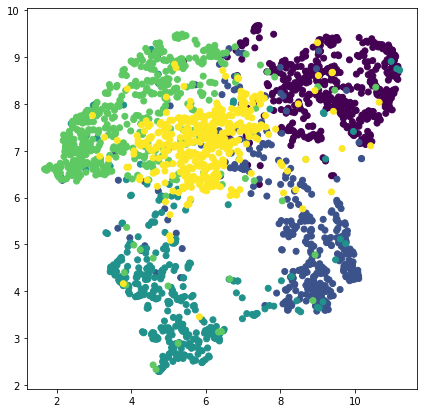

In [ ]:
reducer = umap.UMAP()
umap_components = reducer.fit_transform(vectorized_docs)
reduced_data["UMAP"] = umap_components
umap_components.shape

#----------------plot---------------------
f = plt.figure(figsize=(7,7))
UMAP_components = pd.DataFrame(umap_components) 
plt.scatter(UMAP_components[0], UMAP_components[1],c=true_labels)
plt.show()

#### **Commentaire reduction de la dimension :**


### **Clustering :**

#### **K-means :**

original  Data
plot with predicted labels


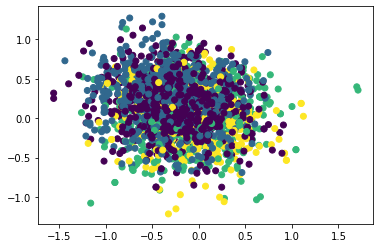

plot with true labels


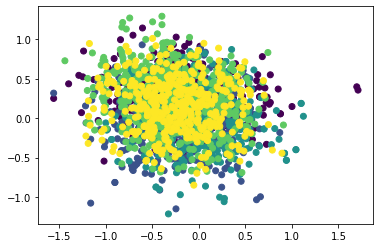

RoBERTa : Kmeans clustering on  original  data accuracy :  0.13617977528089886
RoBERTa : Kmeans clustering on  original  data NMI :  0.38510311612553194
RoBERTa : Kmeans clustering on  original  data ARI :  0.31336308920234807
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


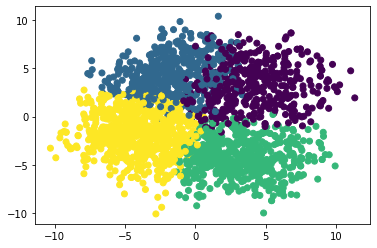

plot with true labels


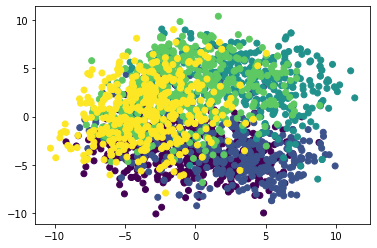

RoBERTa : Kmeans clustering on  PCA  data accuracy :  0.07955056179775281
RoBERTa : Kmeans clustering on  PCA  data NMI :  0.2711347452931584
RoBERTa : Kmeans clustering on  PCA  data ARI :  0.19972063586254704
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


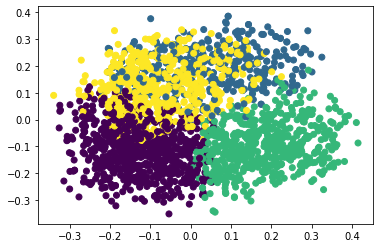

plot with true labels


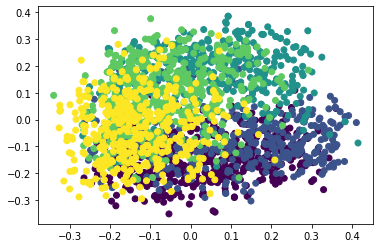

RoBERTa : Kmeans clustering on  cosine  data accuracy :  0.2961797752808989
RoBERTa : Kmeans clustering on  cosine  data NMI :  0.38381828700570414
RoBERTa : Kmeans clustering on  cosine  data ARI :  0.3198034135339752
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


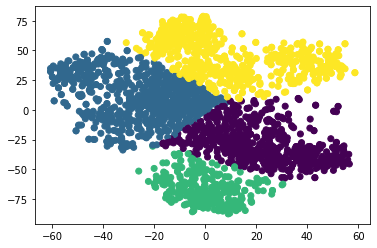

plot with true labels


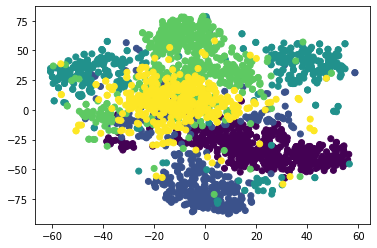

RoBERTa : Kmeans clustering on  TSNE  data accuracy :  0.4130337078651685
RoBERTa : Kmeans clustering on  TSNE  data NMI :  0.4244542946166465
RoBERTa : Kmeans clustering on  TSNE  data ARI :  0.3892002660627248
________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


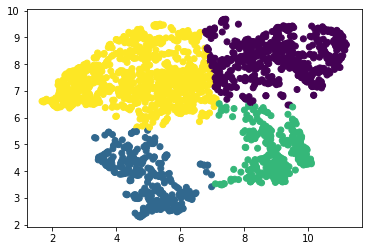

plot with true labels


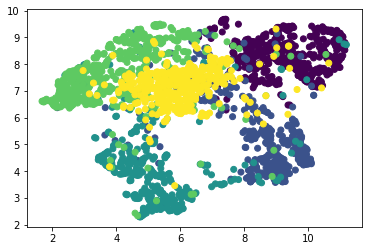

RoBERTa : Kmeans clustering on  UMAP  data accuracy :  0.4557303370786517
RoBERTa : Kmeans clustering on  UMAP  data NMI :  0.6015980503639913
RoBERTa : Kmeans clustering on  UMAP  data ARI :  0.5498334435710276
________________________________________________________________________________________________________


In [ ]:
def kmeans_runner(key,K,true_labels):
  kmeans = KMeans(n_clusters=K, random_state=0,n_init=5).fit(reduced_data[key])
  y_pred = kmeans.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('RoBERTa : Kmeans clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('RoBERTa : Kmeans clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('RoBERTa : Kmeans clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))  

  print("________________________________________________________________________________________________________")


K = 4
for a in reduced_data.keys():
  kmeans_runner(a,K,true_labels)

Commentaire K-means Clustering :

En terme d'accuracy : TSNE a donné le plus mauvais résultat et ca prouve que c'est déconseillé de faire suivre TSNE par une K-means 
  - Le problème avec t-SNE est qu'elle ne préserve pas les distances ni la densité. elle ne préserve que dans une certaine mesure les voisins les plus proches. La différence est subtile, mais affecte tout algorithme basé sur la densité ou la distance ce qui est le cas pour K-means

PCA ( linear kernel) a donné le meilleur résulat (47%) par rapport aux autres résultats




#### **Spectral clustering :**

original  Data
plot with predicted labels


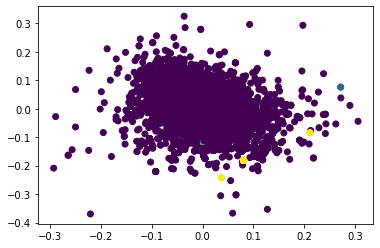

plot with true labels


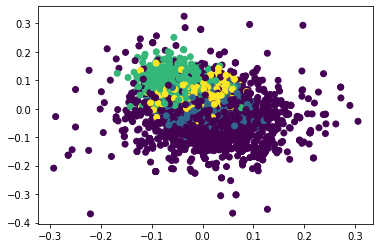

Word2vec : spectral clustering on  original  data accuracy :  0.44200140944326993
Word2vec : spectral clustering on  original  data NMI :  0.011432439464275107
Word2vec : spectral clustering on  original  data ARI :  -0.007784530943189727
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


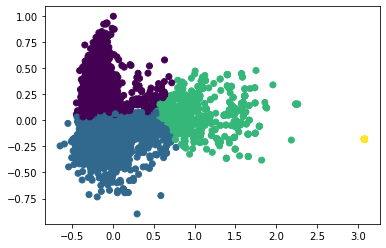

plot with true labels


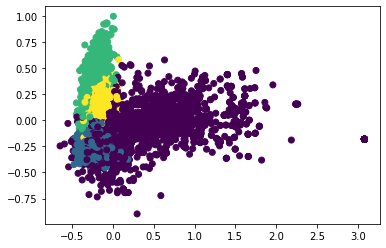

Word2vec : spectral clustering on  PCA  data accuracy :  0.23255813953488372
Word2vec : spectral clustering on  PCA  data NMI :  0.44871444007371325
Word2vec : spectral clustering on  PCA  data ARI :  0.3210521050916887
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


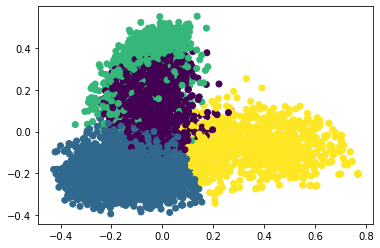

plot with true labels


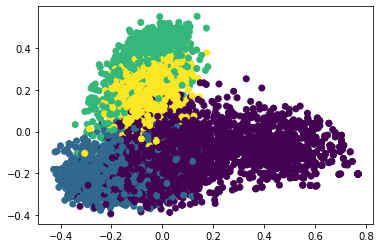

Word2vec : spectral clustering on  cosine  data accuracy :  0.3916842847075405
Word2vec : spectral clustering on  cosine  data NMI :  0.6036230644293806
Word2vec : spectral clustering on  cosine  data ARI :  0.43125705240878764
________________________________________________________________________________________________________


KeyboardInterrupt: ignored

In [ ]:
def spec_clust_runner(key,K,true_labels):

  spectral_clust = SpectralClustering(n_clusters=K,assign_labels='discretize',random_state=0).fit(reduced_data[key])
  y_pred = spectral_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('RoBERTa : spectral clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('RoBERTa : spectral clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('RoBERTa : spectral clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 4
for a in reduced_data.keys():
  spec_clust_runner(a,K,true_labels)

En comparant le Spectral clustering & k-means :

L'accuracy a augmenté pour Spectral clustering par rapport au k-means dans le cas de données originaux + pca non linéaire (cosine kernel)

En revanche on a remaqué une baisse d'accuracy dans le cas du pca linéaire ( linear kernel)

Meme en terme de visualisation : non linear pca ("cosine") a donné un affichage qui ressemble à l'affichage en utilisant les vrai labels

Sinon en terme de temps d'éxecution malgré que le spectral clustering se base sur la méthode k-means mais pas sur les coordonnées originales, mais sur un embedding qui se focalise sur la connectivité, donc au lieu de minimiser les erreurs au carré dans l'input, il minimise les erreurs au carré sur la capacité à reconstruire les voisins et c'est souvent mieux.

#### **HDBSCAN :**

In [ ]:
#!pip install hdbscan
import hdbscan

original  Data
plot with predicted labels


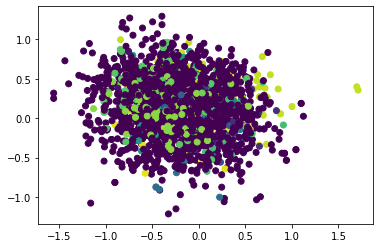

plot with true labels


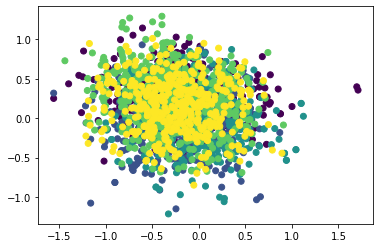

RoBERTa : hdbscan clustering on  original  data accuracy :  0.004943820224719101
RoBERTa : hdbscan clustering on  original  data NMI :  0.2909452285808928
RoBERTa : hdbscan clustering on  original  data ARI :  0.03616808801111215
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


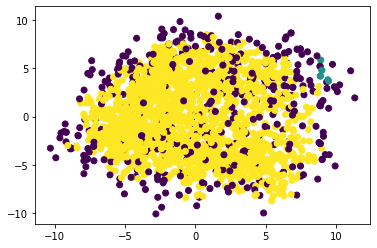

plot with true labels


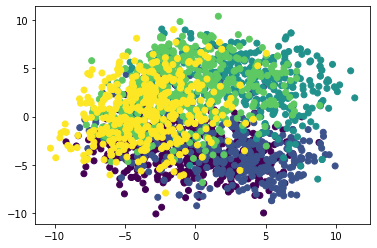

RoBERTa : hdbscan clustering on  PCA  data accuracy :  0.14202247191011236
RoBERTa : hdbscan clustering on  PCA  data NMI :  0.014752020315688438
RoBERTa : hdbscan clustering on  PCA  data ARI :  0.008541649603202238
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


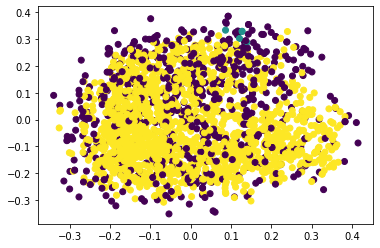

plot with true labels


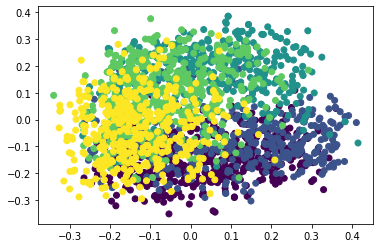

RoBERTa : hdbscan clustering on  cosine  data accuracy :  0.13887640449438202
RoBERTa : hdbscan clustering on  cosine  data NMI :  0.019071159517216198
RoBERTa : hdbscan clustering on  cosine  data ARI :  0.011053255290621693
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


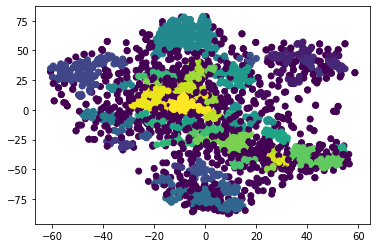

plot with true labels


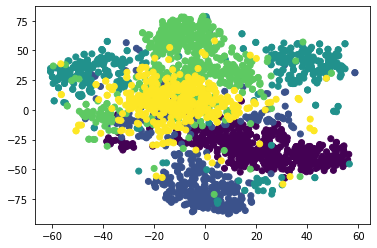

RoBERTa : hdbscan clustering on  TSNE  data accuracy :  0.0035955056179775282
RoBERTa : hdbscan clustering on  TSNE  data NMI :  0.3724039661619658
RoBERTa : hdbscan clustering on  TSNE  data ARI :  0.06660900910612871
________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


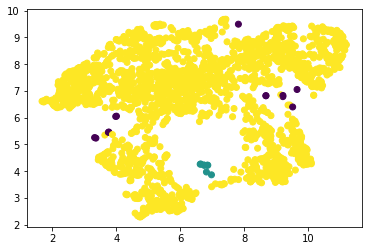

plot with true labels


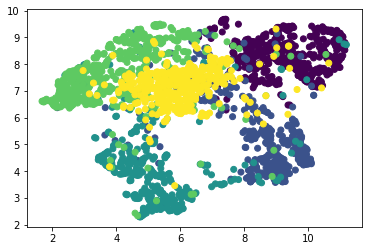

RoBERTa : hdbscan clustering on  UMAP  data accuracy :  0.17303370786516853
RoBERTa : hdbscan clustering on  UMAP  data NMI :  0.008209165923511959
RoBERTa : hdbscan clustering on  UMAP  data ARI :  0.0007016868824900002
________________________________________________________________________________________________________


In [ ]:
def hdbscan_runner(key,true_labels):
  hdbscan_clust = hdbscan.HDBSCAN(algorithm='best', alpha=1.0, metric='euclidean',cluster_selection_epsilon=0.5).fit(reduced_data[key])
  y_pred = hdbscan_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('RoBERTa : hdbscan clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('RoBERTa : hdbscan clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('RoBERTa : hdbscan clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 4
for a in reduced_data.keys():
  hdbscan_runner(a,true_labels)

En terme d'accuracy : aucun algorithme a donné des bons résultats 

Pour original data : l'algorithme n'a pas donné de bons résultat vu qu'il est pas trés bon en high dimensional clustering 

linear & non linear pca sont les algorithmes qui ont donné les meilleurs résultats par rapport aux autres algorithmes (avec un accuracy ~ 20%)

#### **CAH :**

original  Data
plot with predicted labels


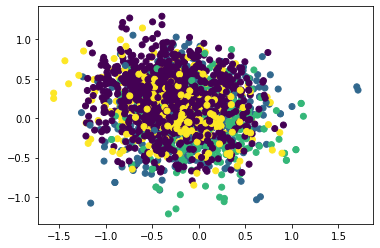

plot with true labels


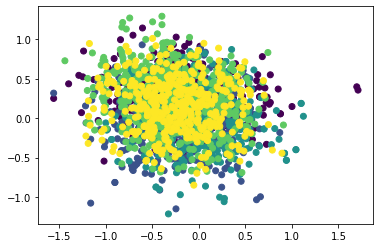

RoBERTa : cah clustering on  original  data accuracy :  0.26157303370786517
RoBERTa : cah clustering on  original  data NMI :  0.429329875838555
RoBERTa : cah clustering on  original  data ARI :  0.3573148670622253
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


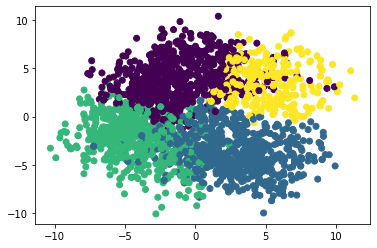

plot with true labels


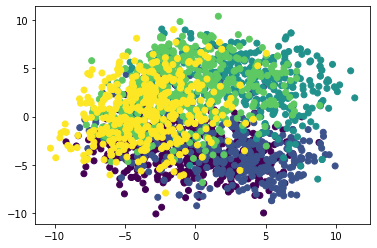

RoBERTa : cah clustering on  PCA  data accuracy :  0.169438202247191
RoBERTa : cah clustering on  PCA  data NMI :  0.22693850282848238
RoBERTa : cah clustering on  PCA  data ARI :  0.16617394095152171
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


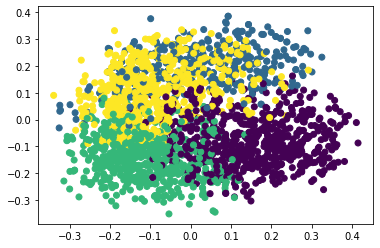

plot with true labels


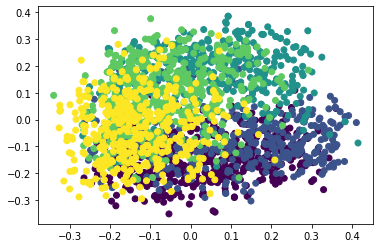

RoBERTa : cah clustering on  cosine  data accuracy :  0.30157303370786515
RoBERTa : cah clustering on  cosine  data NMI :  0.3383496017435899
RoBERTa : cah clustering on  cosine  data ARI :  0.2918720528498118
________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


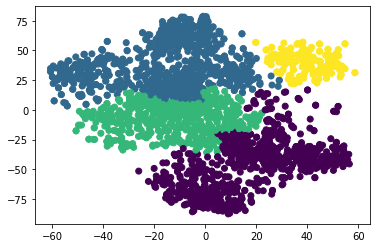

plot with true labels


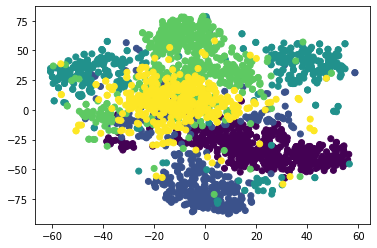

RoBERTa : cah clustering on  TSNE  data accuracy :  0.18382022471910112
RoBERTa : cah clustering on  TSNE  data NMI :  0.3810157302534146
RoBERTa : cah clustering on  TSNE  data ARI :  0.2998409997502412
________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


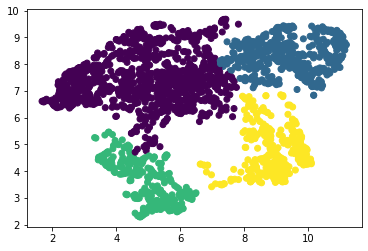

plot with true labels


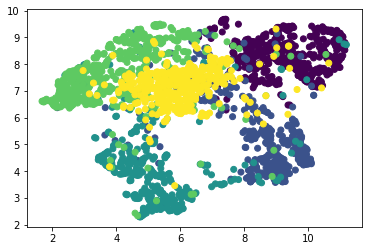

RoBERTa : cah clustering on  UMAP  data accuracy :  0.16404494382022472
RoBERTa : cah clustering on  UMAP  data NMI :  0.5715779962340346
RoBERTa : cah clustering on  UMAP  data ARI :  0.49036130376203124
________________________________________________________________________________________________________


In [ ]:
def cah_runner(key,K,true_labels):
  y_pred = AgglomerativeClustering(n_clusters = K).fit_predict(reduced_data[key])
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  labels = y_pred
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('RoBERTa : cah clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  print('RoBERTa : cah clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  print('RoBERTa : cah clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 4
for a in reduced_data.keys():
  cah_runner(a,K,true_labels)

PCA("cosine kernel") a donné le meilleur résultas en terme d'accuracy (50%)et visualisation (affichages avec predicted & true labels trés similaires) 

linear PCA + original data : ont donné une accuracy trés basse

NMI & ARI : résultat similaires pour tout les algorithmes

LA cah reste toujours non adapté aux grands volumes de données à cause du temps de calcul qui explose et cela s’explique complètement par les méthodes de calcul de l’algorithme.


##Partie 2 RoBERTa :

###DCN for BBC :

In [ ]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
embeddings_DCN_Classic4, cluster_assign_DCN_Classic4 = DCN(vectorized_docs_array, 4, 2, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data = {}
reduced_data['DCN']=embeddings_DCN_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:03<00:00, 12.99it/s]


Running k-means on the learned embeddings...
Starting DCN training...


100%|██████████| 50/50 [00:15<00:00,  3.20it/s]


###DKM for BBC :

In [ ]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
X_reduced_DKM_Classic4, cluster_assign_DKM_Classic4 = DKM(vectorized_docs_array, 4, 2, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data['DKM']=X_reduced_DKM_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:03<00:00, 12.72it/s]


Running k-means on the learned embeddings...
Starting DKM training...


100%|██████████| 20/20 [00:10<00:00,  1.84it/s]


###Plot Function BBC:

DCN  Data
plot with predicted labels


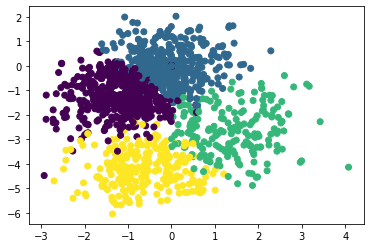

plot with true labels


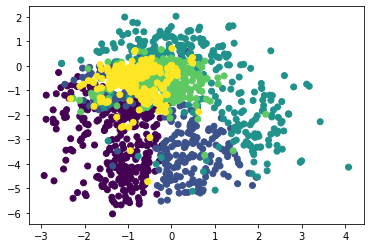

RoBERTa : clustering with  DCN  data accuracy :  0.19865168539325842
RoBERTa : clustering with  DCN  data NMI :  0.347041989809611
RoBERTa : clustering with  DCN  data ARI :  0.25052929712171385
________________________________________________________________________________________________________
DKM  Data
plot with predicted labels


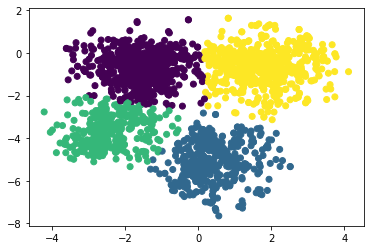

plot with true labels


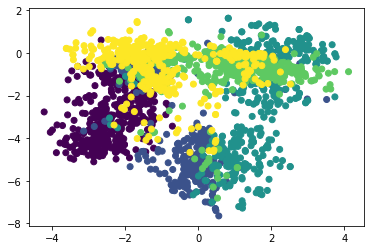

RoBERTa : clustering with  DKM  data accuracy :  0.36629213483146067
RoBERTa : clustering with  DKM  data NMI :  0.3720494428110831
RoBERTa : clustering with  DKM  data ARI :  0.2802813807464223
________________________________________________________________________________________________________


In [ ]:
def plot_result(key,true_labels,predicted_labels):
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=predicted_labels)
  plt.show()

  #-------
  print("plot with true labels")
  plt.scatter(Components[0], Components[1], c=true_labels)
  plt.show()

  #-------

  print('RoBERTa : clustering with ',key,' data accuracy : ',accuracy_score(true_labels,predicted_labels))
  print('RoBERTa : clustering with ',key,' data NMI : ',normalized_mutual_info_score(true_labels,predicted_labels))
  print('RoBERTa : clustering with ',key,' data ARI : ',adjusted_rand_score(true_labels,predicted_labels))
  print("________________________________________________________________________________________________________")


K = 4
plot_result("DCN",true_labels,cluster_assign_DCN_Classic4)
plot_result("DKM",true_labels,cluster_assign_DKM_Classic4)



DCN  a gangé en terme d'accuracy 45% vs 25% pour DKM

Par les deux méthodes ont eu les memes score NMI & ARI

#**---------------------------------------------------------------------------**

#Dataset Article 1: 

##Load Data : 

In [7]:
df = pd.read_csv('/content/nlp_dataset_Articles_1.csv',header=0,sep=";",index_col=0)
df

,text
0,Eli Manning remains the New York Giants' quart...
1,Just an extra hour of exercise a week could si...
2,AP - The Boston Red Sox are to send hobbled st...
3,BASEBALL Arizona (NL): Named Bob Gebhard assis...
4,"CFHT -- Twenty-five years ago, on September 28..."
...,...
3980,"GEORGE TOWN, Cayman Islands - A strengthened H..."
3981,"Find.com, a business search engine (www.find.c..."
3982,If you #39;ve followed Arkansas football for t...
3983,Loren Woods had 17 points and a career-high 14...


In [9]:
#punctuations
punctuations = string.punctuation
#stopwords
stop_words = list(STOP_WORDS)
def clean_text(
  string : str,
  ponctuation = '!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~',
  stop_words = stop_words)->str : 

  #URLs
  string = re.sub(r"https?://\S+|www\.\S+",'',string)
  #html 
  string = re.sub(r'<.*?>','',string)
  #Numbers
  string = re.sub(r'[0-9]+','',string) 

  #Remove punctuations
  for x in string.lower():
    if x in punctuations:
      string = string.replace(x,"")
  #To lower
  string = string.lower()
  #Remove stop words
  lemmatizer = WordNetLemmatizer()
  string = ' '.join([lemmatizer.lemmatize(word) for word in string.split() if word not in stop_words])
  #Cleaning the whitespaces
  string = re.sub(r'\s', ' ', string).strip()

  return string

In [10]:
abstract = df['text'].to_list()
abstracts_cleaned = [clean_text(x) for x in abstract]

In [11]:
len(abstracts_cleaned)

3985

## **Word2Vec :**

### **Document embedding :**

In [12]:
sentances = [list(tokenize(s, deacc=True, lower=True)) for s in abstracts_cleaned]
len(sentances)

3985

In [13]:
!wget -c "https://s3.amazonaws.com/dl4j-distribution/GoogleNews-vectors-negative300.bin.gz"
!gzip -d GoogleNews-vectors-negative300.bin.gz

--2021-12-08 12:50:35--  https://s3.amazonaws.com/dl4j-distribution/GoogleNews-vectors-negative300.bin.gz
Resolving s3.amazonaws.com (s3.amazonaws.com)... 52.217.94.94
Connecting to s3.amazonaws.com (s3.amazonaws.com)|52.217.94.94|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1647046227 (1.5G) [application/x-gzip]
Saving to: ‘GoogleNews-vectors-negative300.bin.gz’

GoogleNews-vectors- 100%[===================>]   1.53G  16.4MB/s    in 97s     

2021-12-08 12:52:13 (16.2 MB/s) - ‘GoogleNews-vectors-negative300.bin.gz’ saved [1647046227/1647046227]



In [14]:
# Load Google's pre-trained Word2Vec model.
import gensim
model = gensim.models.KeyedVectors.load_word2vec_format('./GoogleNews-vectors-negative300.bin', binary=True)

In [15]:
def vectorize(list_of_docs, model):
    """Generate vectors for list of documents using a Word Embedding

    Args:
        list_of_docs: List of documents
        model: Gensim's Word Embedding

    Returns:
        List of document vectors
    """
    features = []

    for tokens in list_of_docs:
        zero_vector = np.zeros(model.vector_size)
        vectors = []
        for token in tokens:
            if token in model.wv:
                try:
                    vectors.append(model.wv[token])
                except KeyError:
                    continue
        if vectors:
            vectors = np.asarray(vectors)
            avg_vec = vectors.mean(axis=0)
            features.append(avg_vec)
        else:
            features.append(zero_vector)
    return features
    
vectorized_docs = vectorize(sentances, model=model)
len(vectorized_docs), len(vectorized_docs[0])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:17: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).


(3985, 300)

### **Réduction de la dimension :**

In [54]:
reduced_data = {}
reduced_data['original'] = vectorized_docs

#### **PCA** :

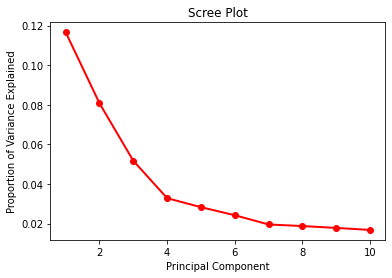

In [17]:
#NUMBER OF COMPONENTS PCA :
import numpy as np
import matplotlib
import matplotlib.pyplot as plt

pca = PCA(n_components=10)
pca_component = pca.fit_transform(vectorized_docs)

PC_values = np.arange(pca.n_components_) + 1
plt.plot(PC_values, pca.explained_variance_ratio_, 'ro-', linewidth=2)
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Proportion of Variance Explained')
plt.show()

On peut prendre le nombre de composantes principal entre 2 & 4 

pca with kernel =  linear


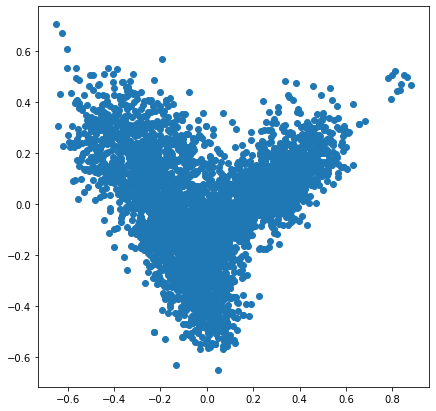

________________________________________________________________________
pca with kernel =  poly


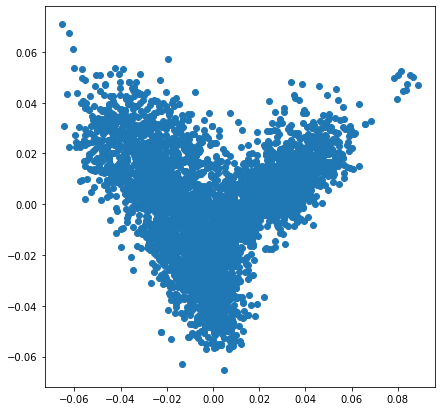

________________________________________________________________________
pca with kernel =  rbf


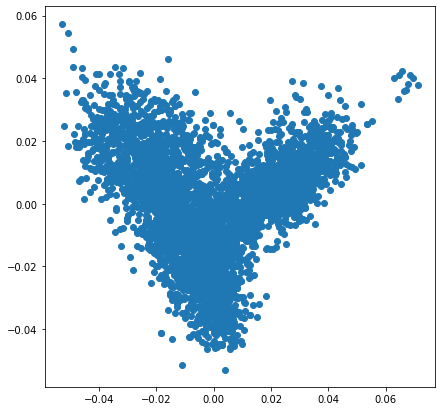

________________________________________________________________________
pca with kernel =  sigmoid


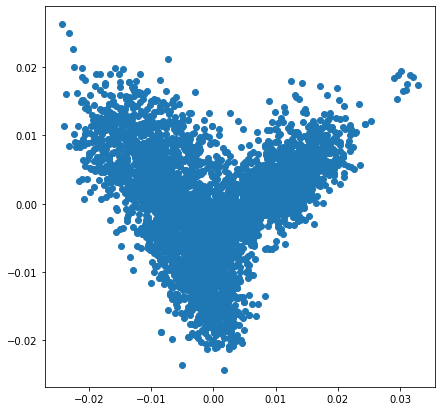

________________________________________________________________________
pca with kernel =  cosine


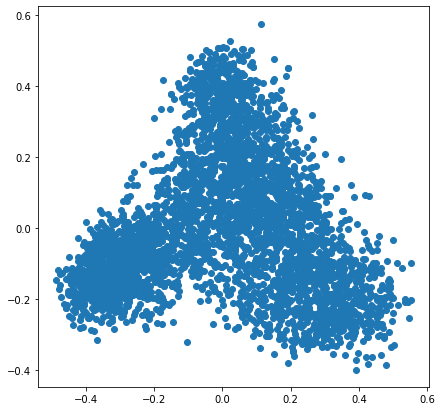

________________________________________________________________________


In [55]:
#PCA WITH DIFFERENT KERNELS :
from sklearn.decomposition import KernelPCA

list_kernel = ["linear", "poly", "rbf", "sigmoid","cosine"]
for i in list_kernel:
  transformer = KernelPCA(n_components=4, kernel=i)
  X_transformed = transformer.fit_transform(vectorized_docs)
  if i == "cosine":
    reduced_data["cosine"] = X_transformed 
  f = plt.figure(figsize=(7,7))
  PCA_componentss = pd.DataFrame(X_transformed)
  plt.scatter(PCA_componentss[0], PCA_componentss[1])
  print("pca with kernel = ",i)
  plt.show()
  print("________________________________________________________________________")

#### **T-SNE :**

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,


tsne init = 'pca'


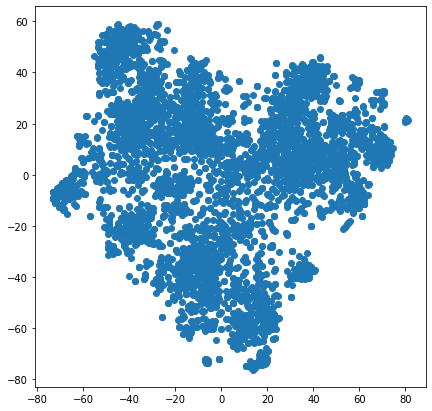

In [56]:
tsne_components = TSNE(n_components=2,init='pca').fit_transform(vectorized_docs)
reduced_data["TSNE"] = tsne_components

#------------------plot-----------------

f = plt.figure(figsize=(7,7))
print("tsne init = 'pca'")
TSNE_components = pd.DataFrame(tsne_components) #tsne with inti ='pca'
plt.scatter(TSNE_components[0], TSNE_components[1])
plt.show()

#### **UMAP :**

In [57]:
!pip install umap-learn
import umap

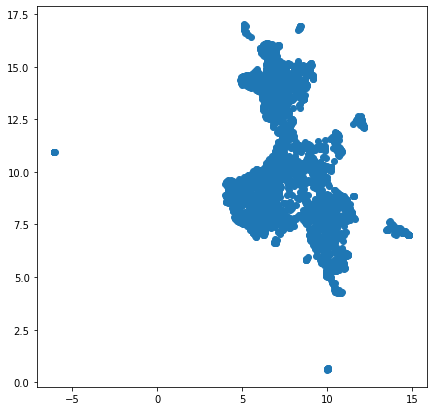

In [58]:
reducer = umap.UMAP()
umap_components = reducer.fit_transform(vectorized_docs)
reduced_data["UMAP"] = umap_components
umap_components.shape

#----------------plot---------------------
f = plt.figure(figsize=(7,7))
UMAP_components = pd.DataFrame(umap_components) 
plt.scatter(UMAP_components[0], UMAP_components[1])
plt.show()

#### **Commentaire reduction de la dimension :**
En regardant le plot de chacune des méthodes et en ignorant les couleurs (true labels) on constate que :

- PCA : 
    - on peut voir une à deux classes (au lieu de 4 classes) 
    - PCA avec kernel différent a donné presque le même résultat avec le kernel linéaire sauf pour 'cosine' qui a mieux séparé les choses 

- TSNE & UMAP : 
    - Dans chacun des deux plot on peut voir au max trois classes

    - Résultats des deux méthodes sont trés similaires vu que les deux méthodes se basent sur local clustering par contre UMAP a fait le travail legèrment mieu que T-SNE vu qu'elle est plus fidèle à la structure global de données, plus rapide et moins couteuse

### **Clustering :**

#### **K-means :**

2
3
4
5
6
7
8


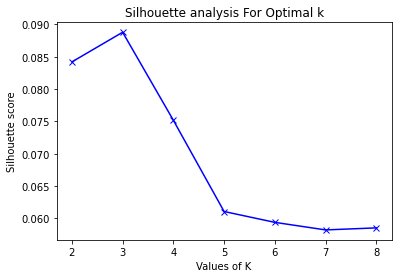

In [59]:
from sklearn.metrics import silhouette_score

range_n_clusters = [2, 3, 4, 5, 6, 7, 8]
silhouette_avg = []
for num_clusters in range_n_clusters:
 print(num_clusters)
 # initialise kmeans
 kmeans = KMeans(n_clusters=num_clusters)
 kmeans.fit(vectorized_docs)
 clusterlabels = kmeans.labels_
 
 # silhouette score
 silhouette_avg.append(silhouette_score(vectorized_docs, clusterlabels))
plt.plot(range_n_clusters,silhouette_avg,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Silhouette score') 
plt.title('Silhouette analysis For Optimal k')
plt.show()

original  Data
plot with predicted labels


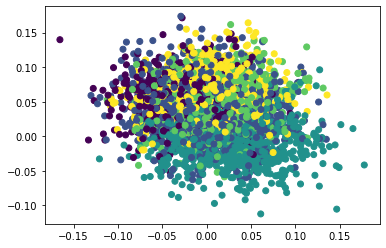

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


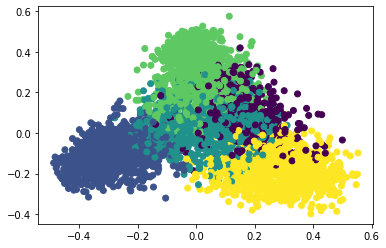

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


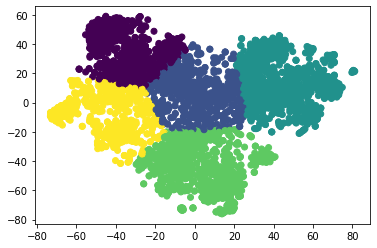

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


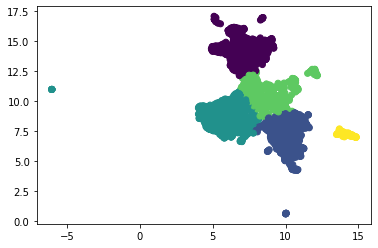

________________________________________________________________________________________________________


In [60]:
def kmeans_runner(key,K):
  kmeans = KMeans(n_clusters=K, random_state=0,n_init=5).fit(reduced_data[key])
  y_pred = kmeans.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  #-------

  #print('Word2vec : Kmeans clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  #print('Word2vec : Kmeans clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  #print('Word2vec : Kmeans clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))  

  print("________________________________________________________________________________________________________")


K = 5
for a in reduced_data.keys():
  kmeans_runner(a,K)

Commentaire K-means Clustering :

En terme d'accuracy : TSNE a donné le plus mauvais résultat et ca prouve que c'est déconseillé de faire suivre TSNE par une K-means 
  - Le problème avec t-SNE est qu'elle ne préserve pas les distances ni la densité. elle ne préserve que dans une certaine mesure les voisins les plus proches. La différence est subtile, mais affecte tout algorithme basé sur la densité ou la distance ce qui est le cas pour K-means

PCA ( linear kernel) a donné le meilleur résulat (47%) par rapport aux autres résultats




#### **Spectral clustering :**

original  Data
plot with predicted labels


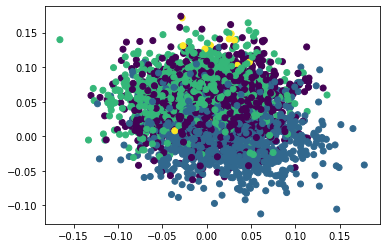

________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


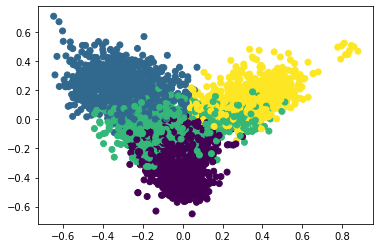

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


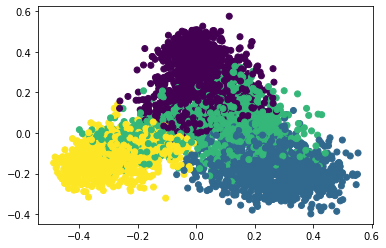

________________________________________________________________________________________________________


KeyboardInterrupt: ignored

In [27]:
def spec_clust_runner(key,K):

  spectral_clust = SpectralClustering(n_clusters=K,assign_labels='discretize',random_state=0).fit(reduced_data[key])
  y_pred = spectral_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  

  #-------

  #print('Word2vec : spectral clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  #print('Word2vec : spectral clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  #print('Word2vec : spectral clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 4
for a in reduced_data.keys():
  spec_clust_runner(a,K)

En comparant le Spectral clustering & k-means :

L'accuracy a augmenté pour Spectral clustering par rapport au k-means dans le cas de données originaux + pca non linéaire (cosine kernel)

En revanche on a remaqué une baisse d'accuracy dans le cas du pca linéaire ( linear kernel)

Meme en terme de visualisation : non linear pca ("cosine") a donné un affichage qui ressemble à l'affichage en utilisant les vrai labels

Sinon en terme de temps d'éxecution malgré que le spectral clustering se base sur la méthode k-means mais pas sur les coordonnées originales, mais sur un embedding qui se focalise sur la connectivité, donc au lieu de minimiser les erreurs au carré dans l'input, il minimise les erreurs au carré sur la capacité à reconstruire les voisins et c'est souvent mieux.

#### **HDBSCAN :**

In [29]:
!pip install hdbscan
import hdbscan

     |████████████████████████████████| 6.4 MB 3.7 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for hdbscan: filename=hdbscan-0.8.27-cp37-cp37m-linux_x86_64.whl size=2311858 sha256=bc6db971308b75f698793daf5654a195c3b0319f09aba2f8c74fb94e97a05cd7
  Stored in directory: /root/.cache/pip/wheels/73/5f/2f/9a259b84003b84847c259779206acecabb25ab56f1506ee72b
Successfully built hdbscan


original  Data
plot with predicted labels


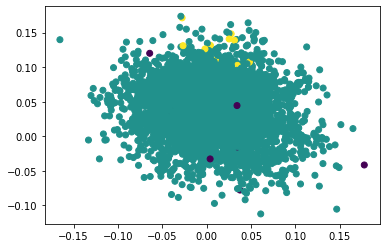

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


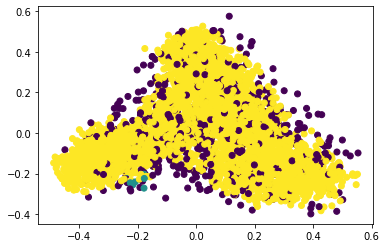

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


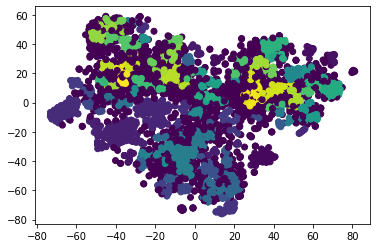

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


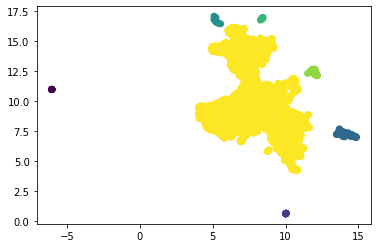

________________________________________________________________________________________________________


In [61]:
def hdbscan_runner(key):
  hdbscan_clust = hdbscan.HDBSCAN(algorithm='best', alpha=1.0, metric='euclidean',cluster_selection_epsilon=1.0).fit(reduced_data[key])
  y_pred = hdbscan_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()


  #-------

  #print('Word2vec : hdbscan clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  #print('Word2vec : hdbscan clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  #print('Word2vec : hdbscan clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 5
for a in reduced_data.keys():
  hdbscan_runner(a)

En terme d'accuracy : aucun algorithme a donné des bons résultats 

Pour original data : l'algorithme n'a pas donné de bons résultat vu qu'il est pas trés bon en high dimensional clustering 

linear & non linear pca sont les algorithmes qui ont donné les meilleurs résultats par rapport aux autres algorithmes (avec un accuracy ~ 20%)

#### **CAH :**

original  Data
plot with predicted labels


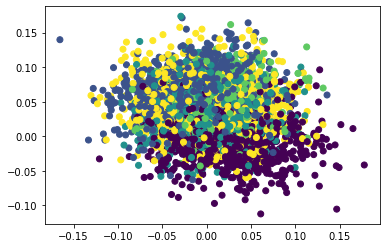

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


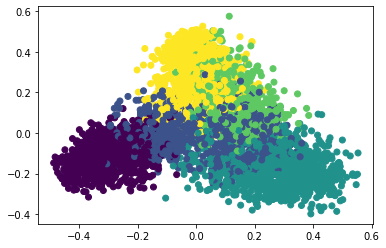

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


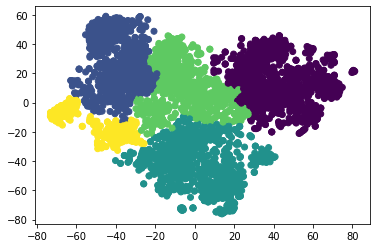

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


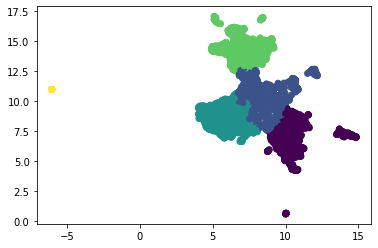

________________________________________________________________________________________________________


In [62]:
def cah_runner(key,K):
  y_pred = AgglomerativeClustering(n_clusters = K).fit_predict(reduced_data[key])
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  #-------

  #print('Word2vec : cah clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  #print('Word2vec : cah clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  #print('Word2vec : cah clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 5
for a in reduced_data.keys():
  cah_runner(a,K)

PCA("cosine kernel") a donné le meilleur résultas en terme d'accuracy (50%)et visualisation (affichages avec predicted & true labels trés similaires) 

linear PCA + original data : ont donné une accuracy trés basse

NMI & ARI : résultat similaires pour tout les algorithmes

LA cah reste toujours non adapté aux grands volumes de données à cause du temps de calcul qui explose et cela s’explique complètement par les méthodes de calcul de l’algorithme.


##Partie 2 Word2Vec :

###DCN for Article 1 :

In [67]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
embeddings_DCN_Classic4, cluster_assign_DCN_Classic4 = DCN(vectorized_docs_array, 5, 2, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data = {}
reduced_data['DCN']=embeddings_DCN_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:06<00:00,  7.99it/s]


Running k-means on the learned embeddings...
Starting DCN training...


100%|██████████| 50/50 [00:27<00:00,  1.84it/s]


###DKM for Article 1 :

In [68]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
X_reduced_DKM_Classic4, cluster_assign_DKM_Classic4 = DKM(vectorized_docs_array, 5, 2, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data['DKM']=X_reduced_DKM_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:06<00:00,  7.78it/s]


Running k-means on the learned embeddings...
Starting DKM training...


100%|██████████| 20/20 [00:17<00:00,  1.12it/s]


###Plot Function Article 1:

DCN  Data
plot with predicted labels


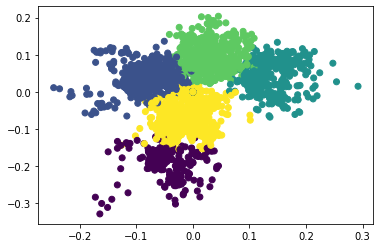

________________________________________________________________________________________________________
DKM  Data
plot with predicted labels


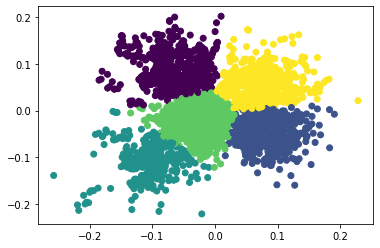

________________________________________________________________________________________________________


In [69]:
def plot_result(key,predicted_labels):
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=predicted_labels)
  plt.show()

  #-------

  #print('Word2vec : clustering with ',key,' data accuracy : ',accuracy_score(true_labels,predicted_labels))
  #print('Word2vec : clustering with ',key,' data NMI : ',normalized_mutual_info_score(true_labels,predicted_labels))
  #print('Word2vec : clustering with ',key,' data ARI : ',adjusted_rand_score(true_labels,predicted_labels))
  print("________________________________________________________________________________________________________")


K = 5
plot_result("DCN",cluster_assign_DCN_Classic4)
plot_result("DKM",cluster_assign_DKM_Classic4)



DCN  a gangé en terme d'accuracy 45% vs 25% pour DKM

Par les deux méthodes ont eu les memes score NMI & ARI

## **Glove :**

In [70]:
!wget -c "https://nlp.stanford.edu/data/glove.840B.300d.zip"
!unzip glove*.zip

--2021-12-08 13:35:30--  https://nlp.stanford.edu/data/glove.840B.300d.zip
Resolving nlp.stanford.edu (nlp.stanford.edu)... 171.64.67.140
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: http://downloads.cs.stanford.edu/nlp/data/glove.840B.300d.zip [following]
--2021-12-08 13:35:30--  http://downloads.cs.stanford.edu/nlp/data/glove.840B.300d.zip
Resolving downloads.cs.stanford.edu (downloads.cs.stanford.edu)... 171.64.64.22
Connecting to downloads.cs.stanford.edu (downloads.cs.stanford.edu)|171.64.64.22|:80... connected.
HTTP request sent, awaiting response... 206 Partial Content
Length: 2176768927 (2.0G), 2164136840 (2.0G) remaining [application/zip]
Saving to: ‘glove.840B.300d.zip’

glove.840B.300d.zip 100%[===================>]   2.03G  5.06MB/s    in 9m 52s  

2021-12-08 13:45:22 (3.49 MB/s) - ‘glove.840B.300d.zip’ saved [2176768927/2176768927]

Archive:  glove.840B.300d.zip
  

In [71]:
from gensim.test.utils import datapath, get_tmpfile
from gensim.models import KeyedVectors
from gensim.scripts.glove2word2vec import glove2word2vec

glove_file = datapath("/content/glove.840B.300d.txt")
tmp_file = get_tmpfile("test_word2vec.txt")
_ = glove2word2vec(glove_file, tmp_file)
model = KeyedVectors.load_word2vec_format(tmp_file)

In [72]:
vectorized_docs = vectorize(sentances, model=model)
len(vectorized_docs), len(vectorized_docs[0])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:17: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).


(3985, 300)

### **Réduction de la dimension :**

In [73]:
reduced_data = {}
reduced_data['original'] = vectorized_docs

#### **PCA** :

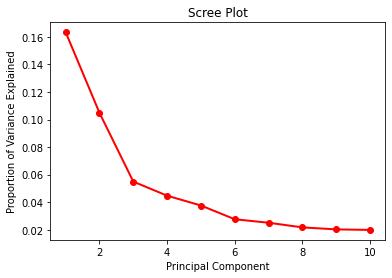

In [74]:
#NUMBER OF COMPONENTS PCA :

pca = PCA(n_components=10)
pca_component = pca.fit_transform(vectorized_docs)

PC_values = np.arange(pca.n_components_) + 1
plt.plot(PC_values, pca.explained_variance_ratio_, 'ro-', linewidth=2)
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Proportion of Variance Explained')
plt.show()

On peut prendre le nombre de composantes principal entre 3 & 4 

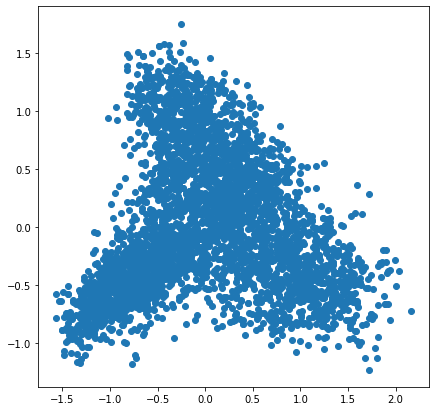

In [76]:
pca = PCA(n_components=3)
pca_components = pca.fit_transform(vectorized_docs)
reduced_data["PCA"] = pca_components

#---------------plot----------------------------------

f = plt.figure(figsize=(7,7))
PCA_components = pd.DataFrame(pca_components)
plt.scatter(PCA_components[0], PCA_components[1])
plt.show()

pca with kernel =  linear


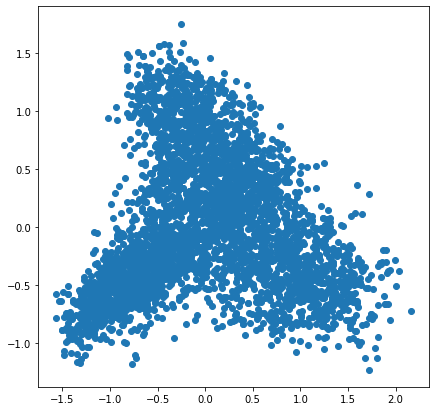

________________________________________________________________________
pca with kernel =  poly


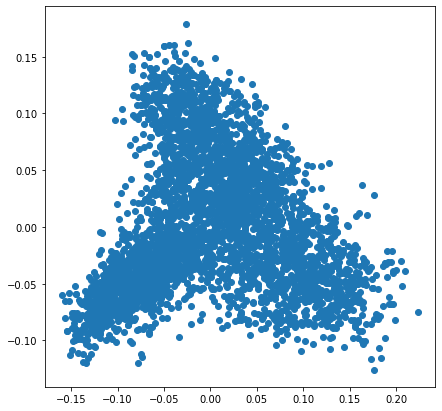

________________________________________________________________________
pca with kernel =  rbf


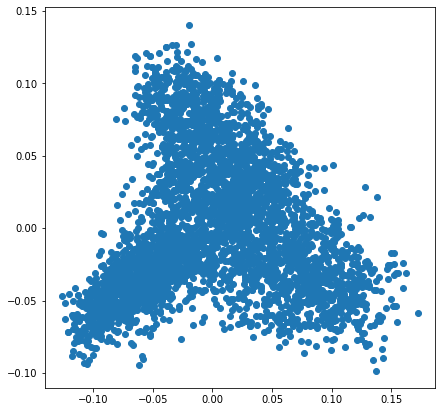

________________________________________________________________________
pca with kernel =  sigmoid


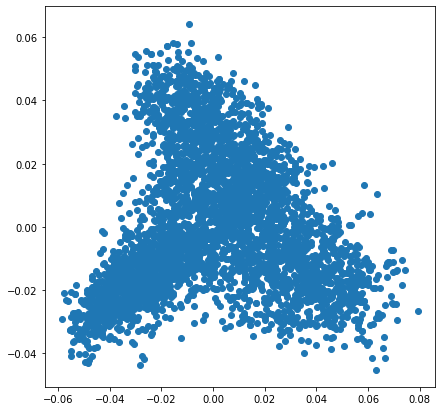

________________________________________________________________________
pca with kernel =  cosine


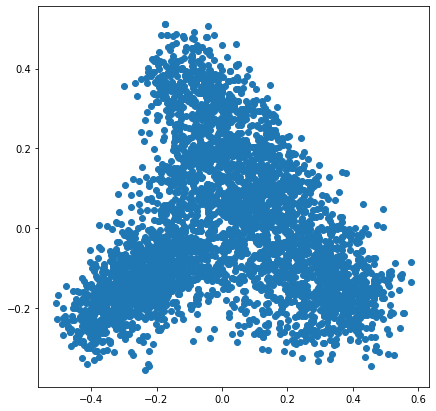

________________________________________________________________________


In [77]:
#PCA WITH DIFFERENT KERNELS :
from sklearn.decomposition import KernelPCA

list_kernel = ["linear", "poly", "rbf", "sigmoid","cosine"]
for i in list_kernel:
  transformer = KernelPCA(n_components=4, kernel=i)
  X_transformed = transformer.fit_transform(vectorized_docs)
  if i == "cosine":
    reduced_data["cosine"] = X_transformed 
  f = plt.figure(figsize=(7,7))
  PCA_componentss = pd.DataFrame(X_transformed)
  plt.scatter(PCA_componentss[0], PCA_componentss[1])
  print("pca with kernel = ",i)
  plt.show()
  print("________________________________________________________________________")

#### **T-SNE :**

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,


tsne init = 'pca'


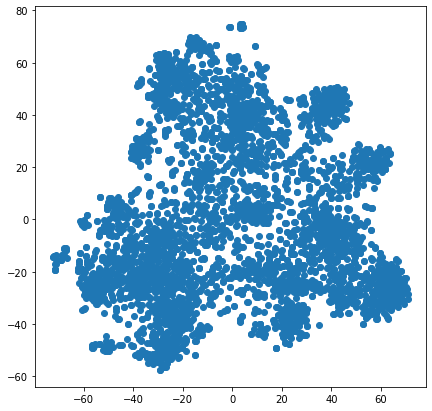

In [78]:
tsne_components = TSNE(n_components=2,init='pca').fit_transform(vectorized_docs)
reduced_data["TSNE"] = tsne_components

#------------------plot-----------------

f = plt.figure(figsize=(7,7))
print("tsne init = 'pca'")
TSNE_components = pd.DataFrame(tsne_components) #tsne with inti ='pca'
plt.scatter(TSNE_components[0], TSNE_components[1])
plt.show()

#### **UMAP :**

In [79]:
!pip install umap-learn
import umap

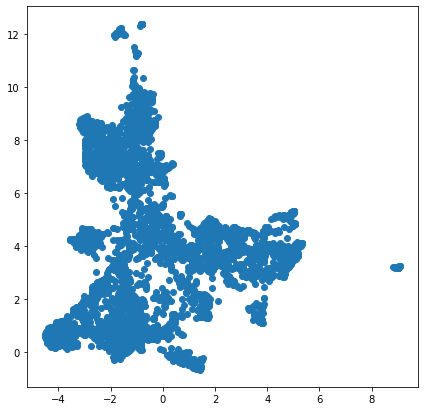

In [81]:
reducer = umap.UMAP()
umap_components = reducer.fit_transform(vectorized_docs)
reduced_data["UMAP"] = umap_components
umap_components.shape

#----------------plot---------------------
f = plt.figure(figsize=(7,7))
UMAP_components = pd.DataFrame(umap_components) 
plt.scatter(UMAP_components[0], UMAP_components[1])
plt.show()

#### En comparant les différentes résultats de la réduction de dimension :

on remarque pas une grosse différence entre word2vec et glove 

PCA en (ignorant les couleurs des true labels) on peut voir au max 2 classes

UMAP & TSNE : on peut voir 3 classe au max (la meme chose avec word2vec)


Par contre la visualisation des deux premières composantes du TSNE sur les données w2v et glove est exactement la mêmes (mais inversée en terme d'affichage)

### **Clustering :**

#### **K-means :**

2
3
4
5
6
7
8


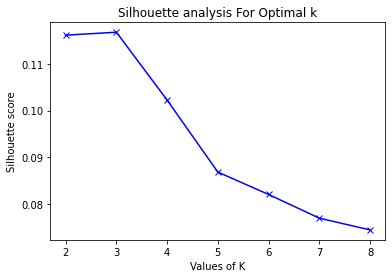

In [82]:
from sklearn.metrics import silhouette_score

range_n_clusters = [2, 3, 4, 5, 6, 7, 8]
silhouette_avg = []
for num_clusters in range_n_clusters:
 print(num_clusters)
 # initialise kmeans
 kmeans = KMeans(n_clusters=num_clusters)
 kmeans.fit(vectorized_docs)
 clusterlabels = kmeans.labels_
 
 # silhouette score
 silhouette_avg.append(silhouette_score(vectorized_docs, clusterlabels))
plt.plot(range_n_clusters,silhouette_avg,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Silhouette score') 
plt.title('Silhouette analysis For Optimal k')
plt.show()

original  Data
plot with predicted labels


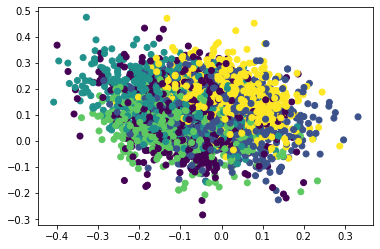

________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


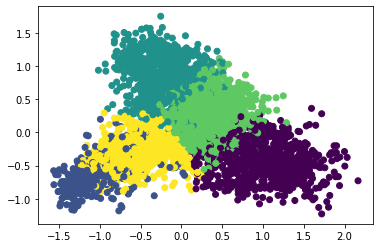

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


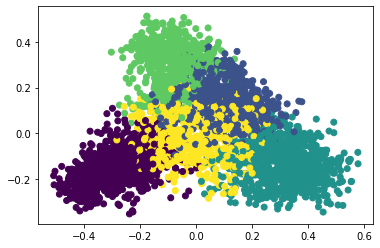

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


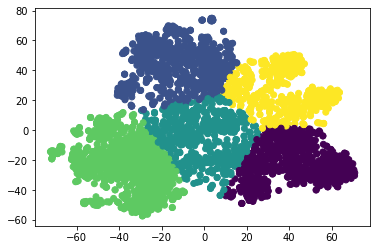

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


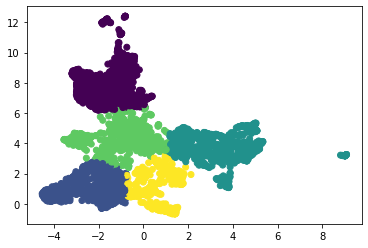

________________________________________________________________________________________________________


In [83]:
def kmeans_runner(key,K):
  kmeans = KMeans(n_clusters=K, random_state=0,n_init=5).fit(reduced_data[key])
  y_pred = kmeans.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  

  #-------

  #print('Glove : Kmeans clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  #print('Glove : Kmeans clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  #print('Glove : Kmeans clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")


K = 5
for a in reduced_data.keys():
  kmeans_runner(a,K)

PCA (cosine kernel) a donné le meilleur résultat ~70 % (ce qui justifie la non linéarité de non données en comparant avec les résultats du pca linéaire)

TSNE a donné 50 % d'accuracy 


NMI & ARI  moyenne pour la majorité des algorithmes 
On constate des valeurs de NMI & ARI hausses pour les différents algorithmes



#### **Spectral clustering :**

In [ ]:
def spec_clust_runner(key,K,true_labels):

  spectral_clust = SpectralClustering(n_clusters=K,assign_labels='discretize',random_state=0).fit(reduced_data[key])
  y_pred = spectral_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  

  print("________________________________________________________________________________________________________")



K = 5
for a in reduced_data.keys():
  spec_clust_runner(a,K)

#### **HDBSCAN :**

In [ ]:
!pip install hdbscan
import hdbscan

     |████████████████████████████████| 6.4 MB 8.7 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for hdbscan: filename=hdbscan-0.8.27-cp37-cp37m-linux_x86_64.whl size=2311907 sha256=b018aa4d598ca983497ff77598fc775578c655a25439a41ee5f406ebff60c046
  Stored in directory: /root/.cache/pip/wheels/73/5f/2f/9a259b84003b84847c259779206acecabb25ab56f1506ee72b
Successfully built hdbscan


original  Data
plot with predicted labels


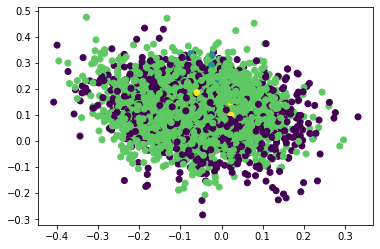

________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


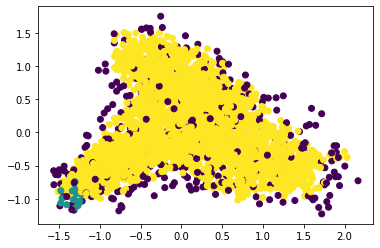

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


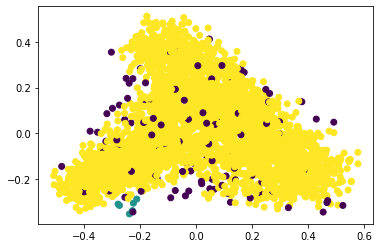

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


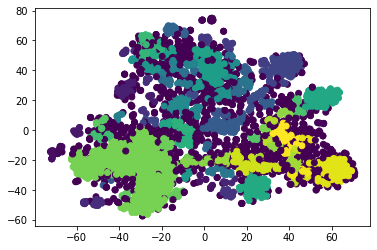

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


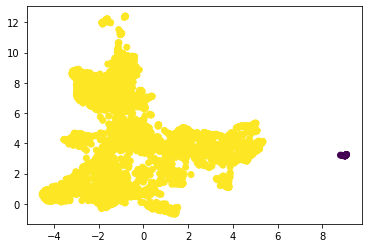

________________________________________________________________________________________________________


In [84]:
def hdbscan_runner(key):
  hdbscan_clust = hdbscan.HDBSCAN(algorithm='best', alpha=1.0, metric='euclidean',cluster_selection_epsilon=1.0).fit(reduced_data[key])
  y_pred = hdbscan_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  

  print("________________________________________________________________________________________________________")



K = 5
for a in reduced_data.keys():
  hdbscan_runner(a)

#### Commentaire 🇰

Accuracy trés basses pour la majorité des algorithmes, meilleurs résultats pca ~20%

NMI & ARI trés basses pour tous les algorithmes sauf UMAP  qui a obtenue des scores trés considérable (surtout en terme de NMI ~71%)

donc UMAP : meilleur performance avec hdbscan (vu que UMAP se focalise sur le clustering local mais il est toujours fidèle à la structure globale)

#### **CAH :**

original  Data
plot with predicted labels


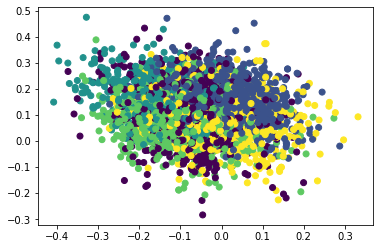

________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


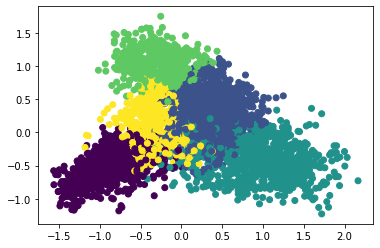

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


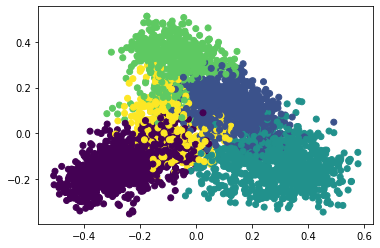

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


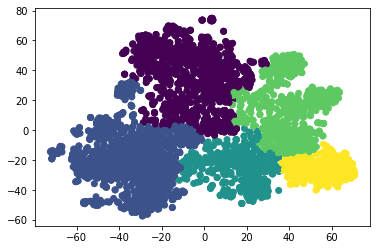

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


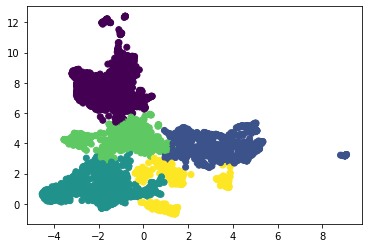

________________________________________________________________________________________________________


In [85]:
def cah_runner(key,K):
  y_pred = AgglomerativeClustering(n_clusters = K).fit_predict(reduced_data[key])
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  

  print("________________________________________________________________________________________________________")



K = 5
for a in reduced_data.keys():
  cah_runner(a,K)

#### Commentaire 🇰

Cah sur original data (glove) a donné des meilleurs résultats en comparant avec ce qui a été obtenue avec les embedding de W2V 


PCA (cosine kernel) meilleur accuracy (77%) vs 18% du PCA linéaire

nmi elevé pour la majorité des algorithmes 

##Partie 2  Glove:

###DCN for Article 1 :

In [86]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
embeddings_DCN_Classic4, cluster_assign_DCN_Classic4 = DCN(vectorized_docs_array, 5, 2, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data = {}
reduced_data['DCN']=embeddings_DCN_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:06<00:00,  7.97it/s]


Running k-means on the learned embeddings...
Starting DCN training...


100%|██████████| 50/50 [00:27<00:00,  1.81it/s]


###DKM for Article 1 :

In [87]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
X_reduced_DKM_Classic4, cluster_assign_DKM_Classic4 = DKM(vectorized_docs_array, 5, 2, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data['DKM']=X_reduced_DKM_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:06<00:00,  7.74it/s]


Running k-means on the learned embeddings...
Starting DKM training...


100%|██████████| 20/20 [00:19<00:00,  1.05it/s]


###Plot Function Article 1:

DCN  Data
plot with predicted labels


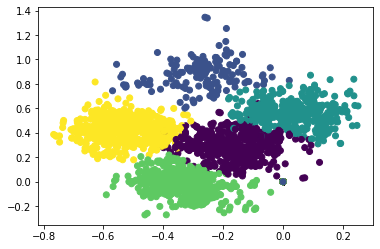

DKM  Data
plot with predicted labels


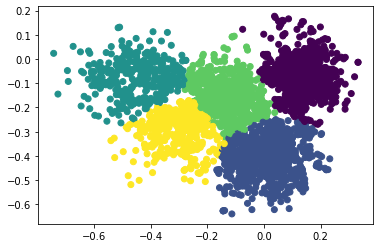

In [88]:
def plot_result(key,predicted_labels):
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=predicted_labels)
  plt.show()




K = 5
plot_result("DCN",cluster_assign_DCN_Classic4)
plot_result("DKM",cluster_assign_DKM_Classic4)



En prenant les résultats des 3 algorithmes :

DKM a obtenu des meilleurs résultats (mais loin d'être bon toujours en dessous de 50% )

#### Commentaire général : 

en terme général : nos différents algorithms ont donné des meilleurs performance (parfois différence légère) sur les embedding du Glove par rapport au embedding de W2V en terme de visualisation & evaluations

#### Comparaison w2v glove : 

Word2Vec permet de prédire les mots en fonction de leur

contexte en utilisant l'un des deux modèles : CBOW et Skip-Gram

GLOVE est basé sur les occurrences de mots dans un corpus textuel. En fait, il est basé sur deux étapes principales.

- La première est la construction d'une matrice de cooccurrence X à partir d'un corpus d'entraînement
- La deuxième étape est la factorisation de X afin d'obtenir des vecteurs

## **BERT :**

### **Document embedding :**

In [89]:
!pip install -U sentence-transformers
from sentence_transformers import SentenceTransformer
model = SentenceTransformer('bert-base-nli-mean-tokens')

     |████████████████████████████████| 78 kB 3.1 MB/s 
     |████████████████████████████████| 3.1 MB 8.9 MB/s 
     |████████████████████████████████| 3.3 MB 31.6 MB/s 
     |████████████████████████████████| 1.2 MB 36.2 MB/s 
     |████████████████████████████████| 61 kB 493 kB/s 
     |████████████████████████████████| 895 kB 37.4 MB/s 
     |████████████████████████████████| 596 kB 34.8 MB/s 
  Created wheel for sentence-transformers: filename=sentence_transformers-2.1.0-py3-none-any.whl size=121000 sha256=621467a2cff3db19d0a058076bae901cbaa962894f8f798f337253d86c1deb70
  Stored in directory: /root/.cache/pip/wheels/90/f0/bb/ed1add84da70092ea526466eadc2bfb197c4bcb8d4fa5f7bad
Successfully built sentence-transformers
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


Downloading:   0%|          | 0.00/391 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/3.95k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/2.00 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/625 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/122 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/229 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/438M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/112 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/466k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/399 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/232k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/190 [00:00<?, ?B/s]

In [90]:
vectorized_docs = model.encode(abstract)

### **Réduction de la dimension :**

In [91]:
reduced_data = {}
reduced_data['original'] = vectorized_docs

#### **PCA** :

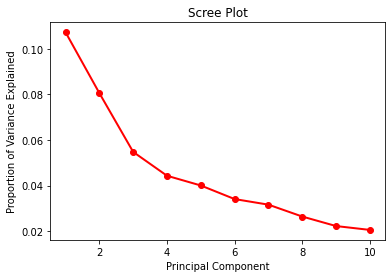

In [92]:
#NUMBER OF COMPONENTS PCA :
pca = PCA(n_components=10)
pca_component = pca.fit_transform(vectorized_docs)

PC_values = np.arange(pca.n_components_) + 1
plt.plot(PC_values, pca.explained_variance_ratio_, 'ro-', linewidth=2)
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Proportion of Variance Explained')
plt.show()

On peut prendre le nombre de composantes principal = 4

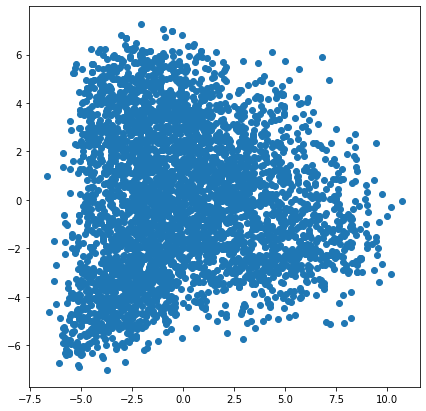

In [94]:
pca = PCA(n_components=4)
pca_components = pca.fit_transform(vectorized_docs)
reduced_data["PCA"] = pca_components

#---------------plot----------------------------------

f = plt.figure(figsize=(7,7))
PCA_components = pd.DataFrame(pca_components)
plt.scatter(PCA_components[0], PCA_components[1])
plt.show()

pca with kernel =  linear


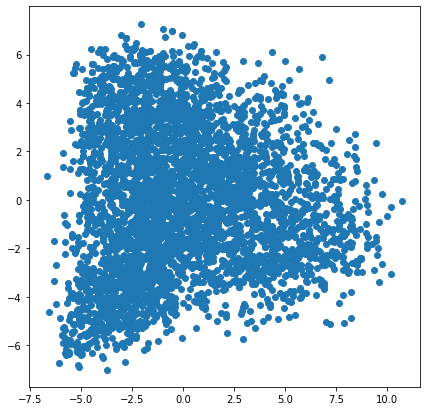

________________________________________________________________________
pca with kernel =  poly


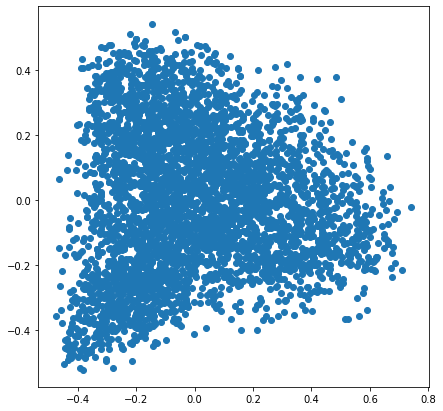

________________________________________________________________________
pca with kernel =  rbf


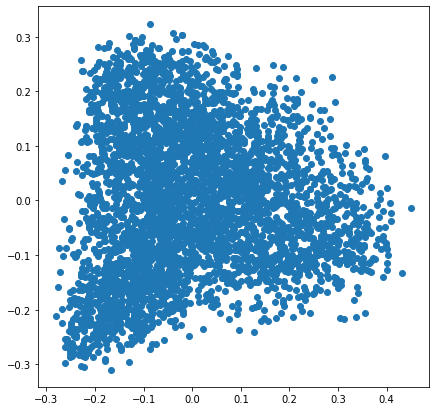

________________________________________________________________________
pca with kernel =  sigmoid


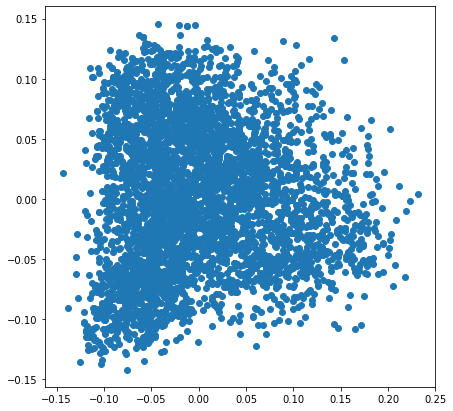

________________________________________________________________________
pca with kernel =  cosine


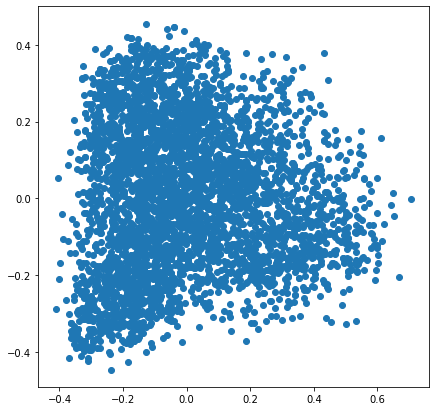

________________________________________________________________________


In [95]:
#PCA WITH DIFFERENT KERNELS :
from sklearn.decomposition import KernelPCA

list_kernel = ["linear", "poly", "rbf", "sigmoid","cosine"]
for i in list_kernel:
  transformer = KernelPCA(n_components=4, kernel=i)
  X_transformed = transformer.fit_transform(vectorized_docs)
  if i == "cosine":
    reduced_data["cosine"] = X_transformed 
  f = plt.figure(figsize=(7,7))
  PCA_componentss = pd.DataFrame(X_transformed)
  plt.scatter(PCA_componentss[0], PCA_componentss[1])
  print("pca with kernel = ",i)
  plt.show()
  print("________________________________________________________________________")

#### **T-SNE :**

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,


tsne init = 'pca'


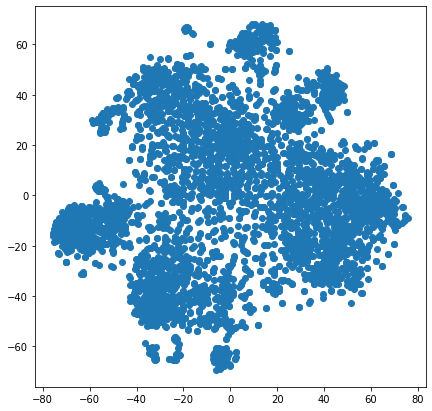

In [96]:
tsne_components = TSNE(n_components=2,init='pca').fit_transform(vectorized_docs)
reduced_data["TSNE"] = tsne_components

#------------------plot-----------------

f = plt.figure(figsize=(7,7))
print("tsne init = 'pca'")
TSNE_components = pd.DataFrame(tsne_components) #tsne with inti ='pca'
plt.scatter(TSNE_components[0], TSNE_components[1])
plt.show()

#### **UMAP :**

In [ ]:
!pip install umap-learn
import umap

     |████████████████████████████████| 86 kB 3.1 MB/s 
     |████████████████████████████████| 1.1 MB 31.7 MB/s 
  Created wheel for umap-learn: filename=umap_learn-0.5.2-py3-none-any.whl size=82709 sha256=2d6885a1a45adc3cea1327f91125f142705007390b04573b08ea174786f3b7b2
  Stored in directory: /root/.cache/pip/wheels/84/1b/c6/aaf68a748122632967cef4dffef68224eb16798b6793257d82
  Created wheel for pynndescent: filename=pynndescent-0.5.5-py3-none-any.whl size=52603 sha256=cc87db5cf00a97f42afd214dfab45f08deb73ac804e66262074bcdf7ab256685
  Stored in directory: /root/.cache/pip/wheels/af/e9/33/04db1436df0757c42fda8ea6796d7a8586e23c85fac355f476
Successfully built umap-learn pynndescent


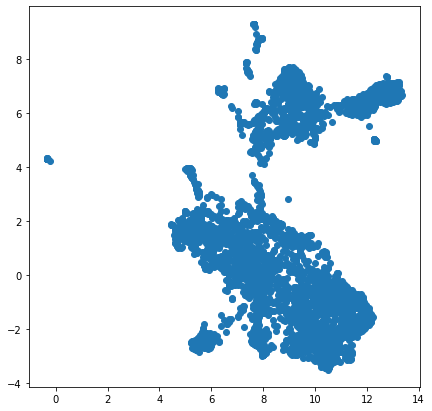

In [97]:
reducer = umap.UMAP()
umap_components = reducer.fit_transform(vectorized_docs)
reduced_data["UMAP"] = umap_components
umap_components.shape

#----------------plot---------------------
f = plt.figure(figsize=(7,7))
UMAP_components = pd.DataFrame(umap_components) 
plt.scatter(UMAP_components[0], UMAP_components[1])
plt.show()

#### **Commentaire reduction de la dimension :**
En regardant le plot de chacune des méthodes et en ignorant les couleurs (true labels) on constate que :

- PCA : 
    - on peut voir une à deux classes (au lieu de 4 classes) 
    - PCA avec kernel différent a donné presque le même résultat avec le kernel linéaire sauf pour 'cosine' qui a mieux séparé les choses 

- TSNE & UMAP : 
    - Dans chacun des deux plot on peut voir au max trois classes

    - Résultats des deux méthodes sont trés similaires vu que les deux méthodes se basent sur local clustering par contre UMAP a fait le travail legèrment mieu que T-SNE vu qu'elle est plus fidèle à la structure global de données, plus rapide et moins couteuse

### **Clustering :**

#### **K-means :**

original  Data
plot with predicted labels


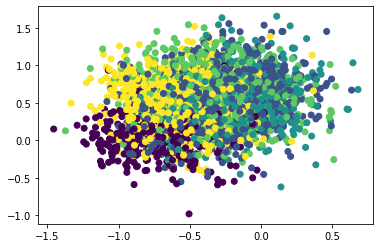

________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


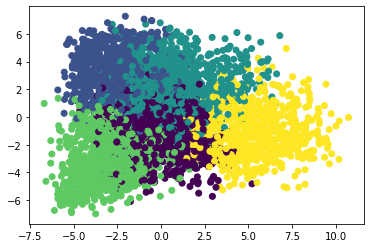

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


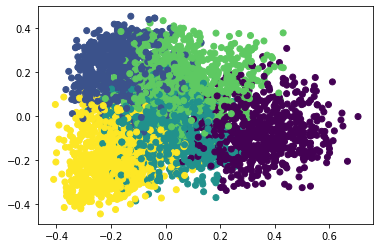

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


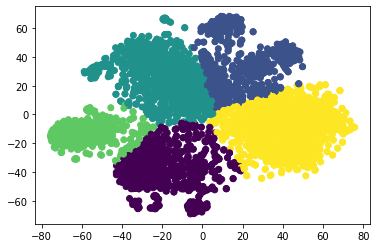

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


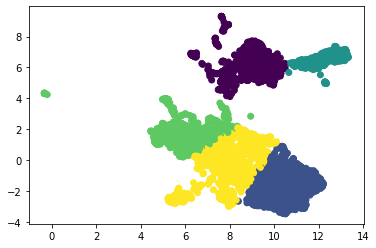

________________________________________________________________________________________________________


In [98]:
def kmeans_runner(key,K):
  kmeans = KMeans(n_clusters=K, random_state=0,n_init=5).fit(reduced_data[key])
  y_pred = kmeans.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  print("________________________________________________________________________________________________________")


K = 5
for a in reduced_data.keys():
  kmeans_runner(a,K)

Commentaire K-means Clustering :

En terme d'accuracy : TSNE a donné le plus mauvais résultat et ca prouve que c'est déconseillé de faire suivre TSNE par une K-means 
  - Le problème avec t-SNE est qu'elle ne préserve pas les distances ni la densité. elle ne préserve que dans une certaine mesure les voisins les plus proches. La différence est subtile, mais affecte tout algorithme basé sur la densité ou la distance ce qui est le cas pour K-means

PCA ( linear kernel) a donné le meilleur résulat (47%) par rapport aux autres résultats




#### **Spectral clustering :**

original  Data
plot with predicted labels


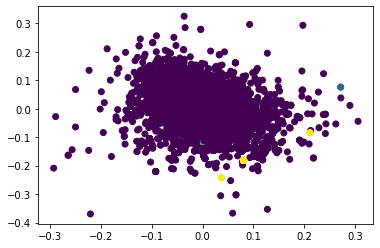

plot with true labels


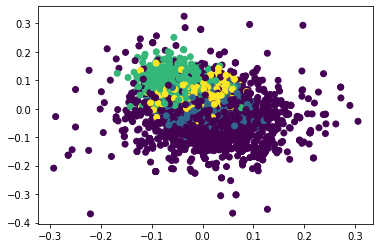

Word2vec : spectral clustering on  original  data accuracy :  0.44200140944326993
Word2vec : spectral clustering on  original  data NMI :  0.011432439464275107
Word2vec : spectral clustering on  original  data ARI :  -0.007784530943189727
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


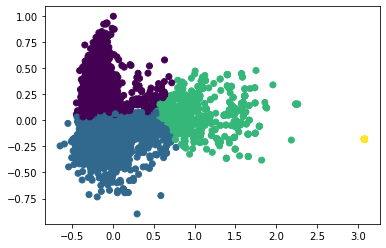

plot with true labels


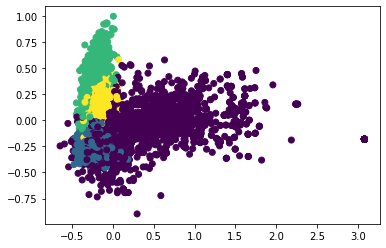

Word2vec : spectral clustering on  PCA  data accuracy :  0.23255813953488372
Word2vec : spectral clustering on  PCA  data NMI :  0.44871444007371325
Word2vec : spectral clustering on  PCA  data ARI :  0.3210521050916887
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


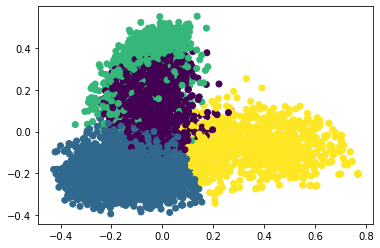

plot with true labels


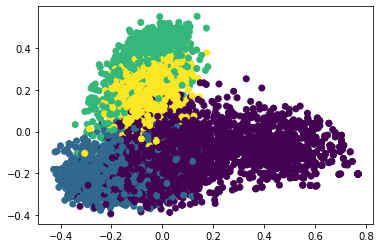

Word2vec : spectral clustering on  cosine  data accuracy :  0.3916842847075405
Word2vec : spectral clustering on  cosine  data NMI :  0.6036230644293806
Word2vec : spectral clustering on  cosine  data ARI :  0.43125705240878764
________________________________________________________________________________________________________


KeyboardInterrupt: ignored

In [ ]:
def spec_clust_runner(key,K):

  spectral_clust = SpectralClustering(n_clusters=K,assign_labels='discretize',random_state=0).fit(reduced_data[key])
  y_pred = spectral_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()


  print("________________________________________________________________________________________________________")



K = 5
for a in reduced_data.keys():
  spec_clust_runner(a,K)

En comparant le Spectral clustering & k-means :

L'accuracy a augmenté pour Spectral clustering par rapport au k-means dans le cas de données originaux + pca non linéaire (cosine kernel)

En revanche on a remaqué une baisse d'accuracy dans le cas du pca linéaire ( linear kernel)

Meme en terme de visualisation : non linear pca ("cosine") a donné un affichage qui ressemble à l'affichage en utilisant les vrai labels

Sinon en terme de temps d'éxecution malgré que le spectral clustering se base sur la méthode k-means mais pas sur les coordonnées originales, mais sur un embedding qui se focalise sur la connectivité, donc au lieu de minimiser les erreurs au carré dans l'input, il minimise les erreurs au carré sur la capacité à reconstruire les voisins et c'est souvent mieux.

#### **HDBSCAN :**

In [ ]:
#!pip install hdbscan
import hdbscan

original  Data
plot with predicted labels


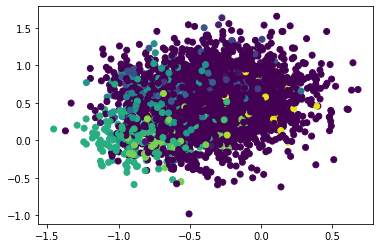

________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


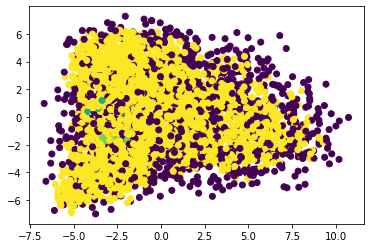

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


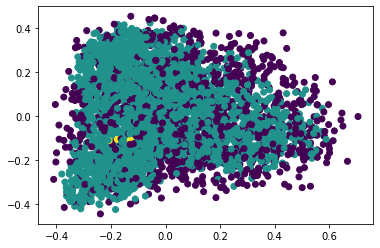

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


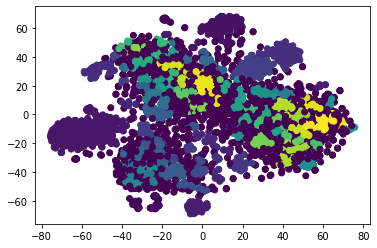

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


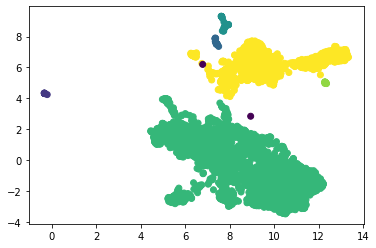

________________________________________________________________________________________________________


In [99]:
def hdbscan_runner(key):
  hdbscan_clust = hdbscan.HDBSCAN(algorithm='best', alpha=1.0, metric='euclidean',cluster_selection_epsilon=0.5).fit(reduced_data[key])
  y_pred = hdbscan_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  

  print("________________________________________________________________________________________________________")



K = 5
for a in reduced_data.keys():
  hdbscan_runner(a)

En terme d'accuracy : aucun algorithme a donné des bons résultats 

Pour original data : l'algorithme n'a pas donné de bons résultat vu qu'il est pas trés bon en high dimensional clustering 

linear & non linear pca sont les algorithmes qui ont donné les meilleurs résultats par rapport aux autres algorithmes (avec un accuracy ~ 20%)

#### **CAH :**

original  Data
plot with predicted labels


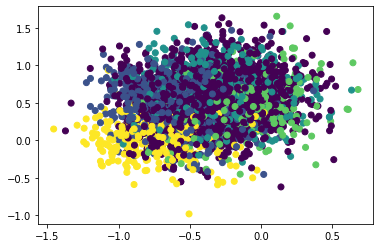

________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


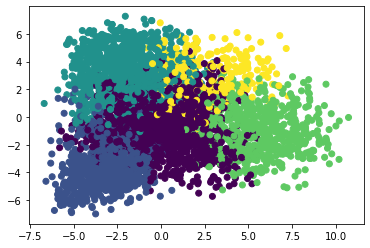

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


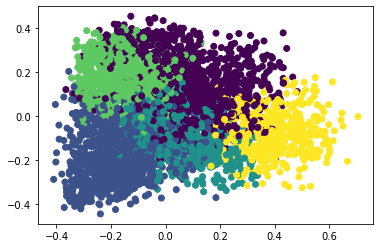

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


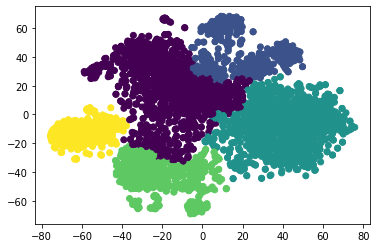

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


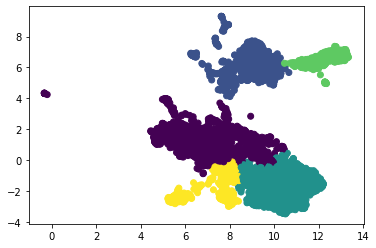

________________________________________________________________________________________________________


In [100]:
def cah_runner(key,K):
  y_pred = AgglomerativeClustering(n_clusters = K).fit_predict(reduced_data[key])
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  

  print("________________________________________________________________________________________________________")



K = 5
for a in reduced_data.keys():
  cah_runner(a,K)

PCA("cosine kernel") a donné le meilleur résultas en terme d'accuracy (50%)et visualisation (affichages avec predicted & true labels trés similaires) 

linear PCA + original data : ont donné une accuracy trés basse

NMI & ARI : résultat similaires pour tout les algorithmes

LA cah reste toujours non adapté aux grands volumes de données à cause du temps de calcul qui explose et cela s’explique complètement par les méthodes de calcul de l’algorithme.


##Partie 2 BERT :

###DCN for Article 1 :

In [101]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
embeddings_DCN_Classic4, cluster_assign_DCN_Classic4 = DCN(vectorized_docs_array, 5, 2, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data = {}
reduced_data['DCN']=embeddings_DCN_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:06<00:00,  7.27it/s]


Running k-means on the learned embeddings...
Starting DCN training...


100%|██████████| 50/50 [00:28<00:00,  1.74it/s]


###DKM for Article 1 :

In [102]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
X_reduced_DKM_Classic4, cluster_assign_DKM_Classic4 = DKM(vectorized_docs_array, 5, 2, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data['DKM']=X_reduced_DKM_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:06<00:00,  7.17it/s]


Running k-means on the learned embeddings...
Starting DKM training...


100%|██████████| 20/20 [00:20<00:00,  1.01s/it]


###Plot Function Article 1:

DCN  Data
plot with predicted labels


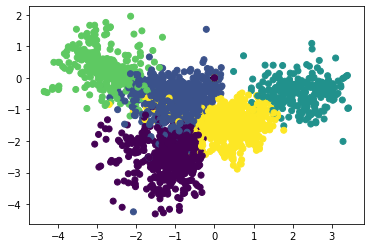

DKM  Data
plot with predicted labels


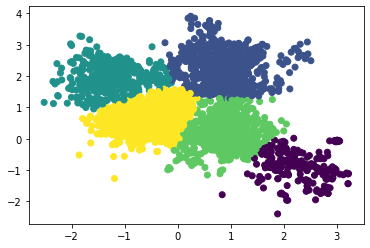

In [103]:
def plot_result(key,predicted_labels):
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=predicted_labels)
  plt.show()



K = 5
plot_result("DCN",cluster_assign_DCN_Classic4)
plot_result("DKM",cluster_assign_DKM_Classic4)



DCN  a gangé en terme d'accuracy 45% vs 25% pour DKM

Par les deux méthodes ont eu les memes score NMI & ARI

## **RoBERTa :**

### **Document embedding :**

In [104]:
model = SentenceTransformer('sentence-transformers/roberta-base-nli-stsb-mean-tokens')

Downloading:   0%|          | 0.00/748 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/4.00k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/2.00 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/688 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/122 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/456k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/229 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/499M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/52.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/52.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/239 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/334 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/798k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/190 [00:00<?, ?B/s]

In [105]:
vectorized_docs = model.encode(abstract)

### **Réduction de la dimension :**

In [106]:
reduced_data = {}
reduced_data['original'] = vectorized_docs

#### **PCA** :

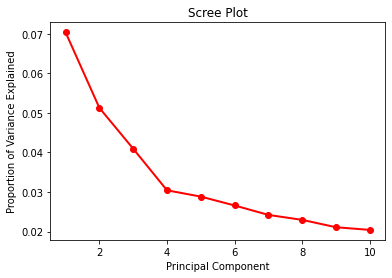

In [107]:
#NUMBER OF COMPONENTS PCA :
pca = PCA(n_components=10)
pca_component = pca.fit_transform(vectorized_docs)

PC_values = np.arange(pca.n_components_) + 1
plt.plot(PC_values, pca.explained_variance_ratio_, 'ro-', linewidth=2)
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Proportion of Variance Explained')
plt.show()

On peut prendre le nombre de composantes principal = 5

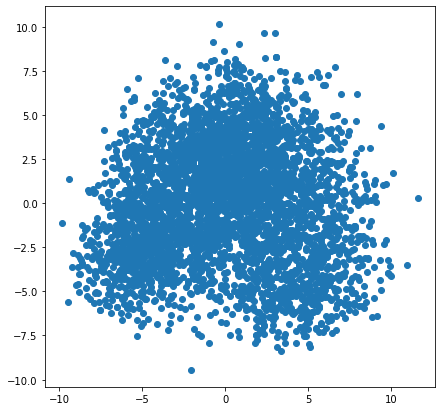

In [108]:
pca = PCA(n_components=4)
pca_components = pca.fit_transform(vectorized_docs)
reduced_data["PCA"] = pca_components

#---------------plot----------------------------------

f = plt.figure(figsize=(7,7))
PCA_components = pd.DataFrame(pca_components)
plt.scatter(PCA_components[0], PCA_components[1])
plt.show()

pca with kernel =  linear


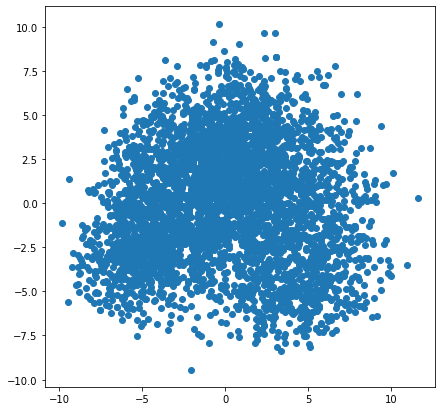

________________________________________________________________________
pca with kernel =  poly


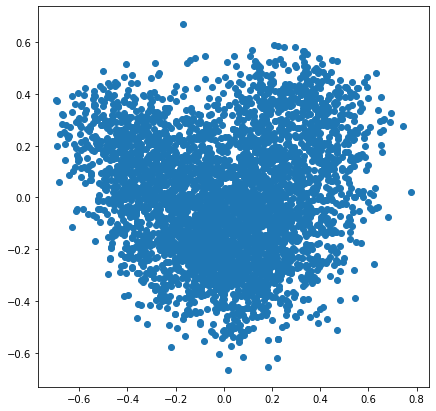

________________________________________________________________________
pca with kernel =  rbf


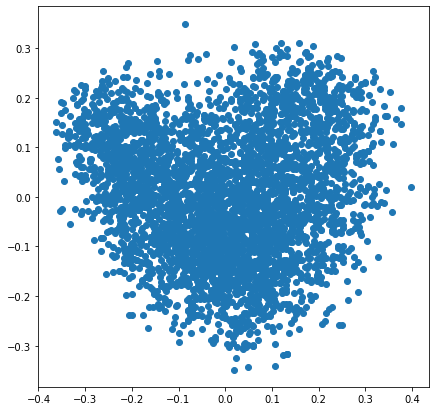

________________________________________________________________________
pca with kernel =  sigmoid


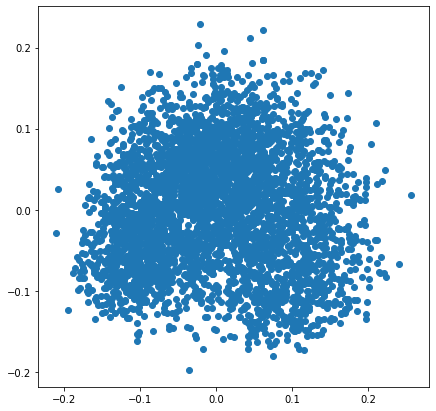

________________________________________________________________________
pca with kernel =  cosine


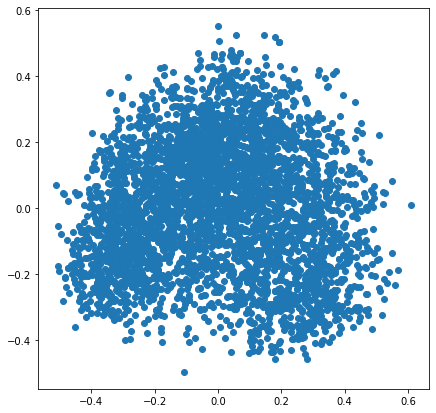

________________________________________________________________________


In [109]:
#PCA WITH DIFFERENT KERNELS :
from sklearn.decomposition import KernelPCA

list_kernel = ["linear", "poly", "rbf", "sigmoid","cosine"]
for i in list_kernel:
  transformer = KernelPCA(n_components=4, kernel=i)
  X_transformed = transformer.fit_transform(vectorized_docs)
  if i == "rbf":
    reduced_data["cosine"] = X_transformed 
  f = plt.figure(figsize=(7,7))
  PCA_componentss = pd.DataFrame(X_transformed)
  plt.scatter(PCA_componentss[0], PCA_componentss[1])
  print("pca with kernel = ",i)
  plt.show()
  print("________________________________________________________________________")

#### **T-SNE :**

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,


tsne init = 'pca'


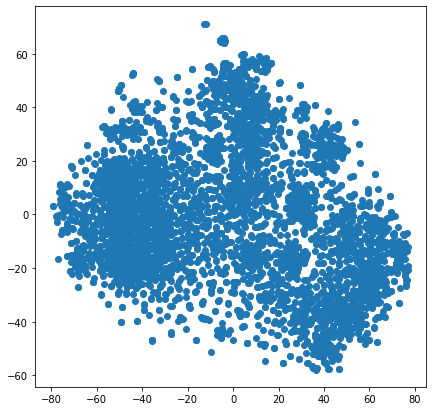

In [110]:
tsne_components = TSNE(n_components=2,init='pca').fit_transform(vectorized_docs)
reduced_data["TSNE"] = tsne_components

#------------------plot-----------------

f = plt.figure(figsize=(7,7))
print("tsne init = 'pca'")
TSNE_components = pd.DataFrame(tsne_components) #tsne with inti ='pca'
plt.scatter(TSNE_components[0], TSNE_components[1])
plt.show()

#### **UMAP :**

In [ ]:
!pip install umap-learn
import umap

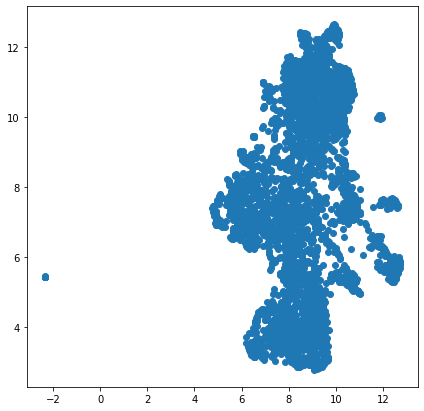

In [111]:
reducer = umap.UMAP()
umap_components = reducer.fit_transform(vectorized_docs)
reduced_data["UMAP"] = umap_components
umap_components.shape

#----------------plot---------------------
f = plt.figure(figsize=(7,7))
UMAP_components = pd.DataFrame(umap_components) 
plt.scatter(UMAP_components[0], UMAP_components[1])
plt.show()

#### **Commentaire reduction de la dimension :**
En regardant le plot de chacune des méthodes et en ignorant les couleurs (true labels) on constate que :

- PCA : 
    - on peut voir une à deux classes (au lieu de 4 classes) 
    - PCA avec kernel différent a donné presque le même résultat avec le kernel linéaire sauf pour 'cosine' qui a mieux séparé les choses 

- TSNE & UMAP : 
    - Dans chacun des deux plot on peut voir au max trois classes

    - Résultats des deux méthodes sont trés similaires vu que les deux méthodes se basent sur local clustering par contre UMAP a fait le travail legèrment mieu que T-SNE vu qu'elle est plus fidèle à la structure global de données, plus rapide et moins couteuse

### **Clustering :**

#### **K-means :**

2
3
4
5
6
7
8


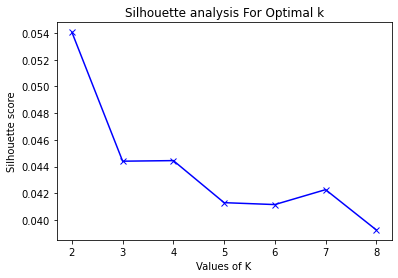

In [112]:
from sklearn.metrics import silhouette_score

range_n_clusters = [2, 3, 4, 5, 6, 7, 8]
silhouette_avg = []
for num_clusters in range_n_clusters:
 print(num_clusters)
 # initialise kmeans
 kmeans = KMeans(n_clusters=num_clusters)
 kmeans.fit(vectorized_docs)
 clusterlabels = kmeans.labels_
 
 # silhouette score
 silhouette_avg.append(silhouette_score(vectorized_docs, clusterlabels))
plt.plot(range_n_clusters,silhouette_avg,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Silhouette score') 
plt.title('Silhouette analysis For Optimal k')
plt.show()

original  Data
plot with predicted labels


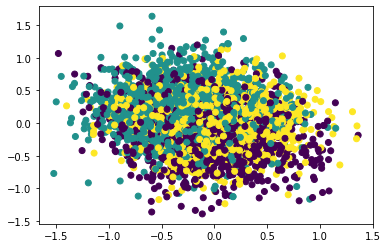

________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


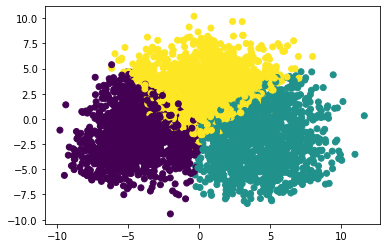

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


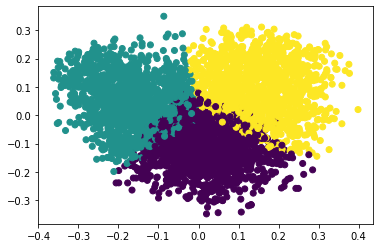

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


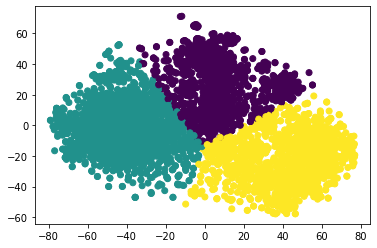

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


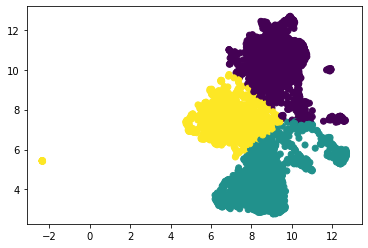

________________________________________________________________________________________________________


In [114]:
def kmeans_runner(key,K):
  kmeans = KMeans(n_clusters=K, random_state=0,n_init=5).fit(reduced_data[key])
  y_pred = kmeans.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  print("________________________________________________________________________________________________________")


K = 3
for a in reduced_data.keys():
  kmeans_runner(a,K)

Commentaire K-means Clustering :

En terme d'accuracy : TSNE a donné le plus mauvais résultat et ca prouve que c'est déconseillé de faire suivre TSNE par une K-means 
  - Le problème avec t-SNE est qu'elle ne préserve pas les distances ni la densité. elle ne préserve que dans une certaine mesure les voisins les plus proches. La différence est subtile, mais affecte tout algorithme basé sur la densité ou la distance ce qui est le cas pour K-means

PCA ( linear kernel) a donné le meilleur résulat (47%) par rapport aux autres résultats




#### **Spectral clustering :**

In [115]:
def spec_clust_runner(key,K):

  spectral_clust = SpectralClustering(n_clusters=K,assign_labels='discretize',random_state=0).fit(reduced_data[key])
  y_pred = spectral_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  

  print("________________________________________________________________________________________________________")



K = 3
for a in reduced_data.keys():
  spec_clust_runner(a,K)

KeyboardInterrupt: ignored

En comparant le Spectral clustering & k-means :

L'accuracy a augmenté pour Spectral clustering par rapport au k-means dans le cas de données originaux + pca non linéaire (cosine kernel)

En revanche on a remaqué une baisse d'accuracy dans le cas du pca linéaire ( linear kernel)

Meme en terme de visualisation : non linear pca ("cosine") a donné un affichage qui ressemble à l'affichage en utilisant les vrai labels

Sinon en terme de temps d'éxecution malgré que le spectral clustering se base sur la méthode k-means mais pas sur les coordonnées originales, mais sur un embedding qui se focalise sur la connectivité, donc au lieu de minimiser les erreurs au carré dans l'input, il minimise les erreurs au carré sur la capacité à reconstruire les voisins et c'est souvent mieux.

#### **HDBSCAN :**

In [ ]:
#!pip install hdbscan
import hdbscan

original  Data
plot with predicted labels


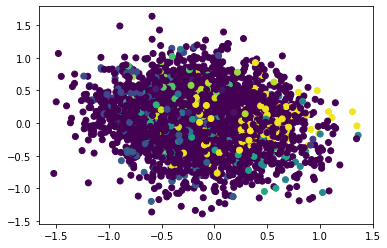

________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


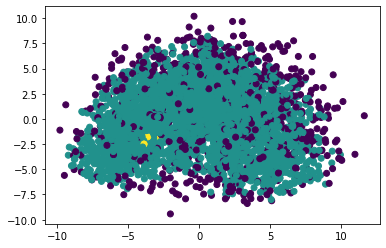

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


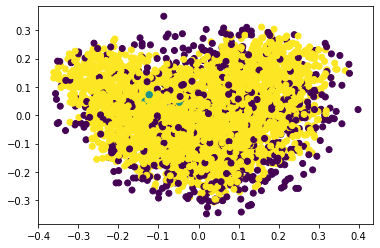

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


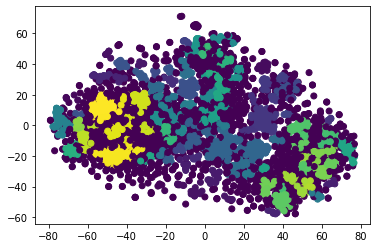

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


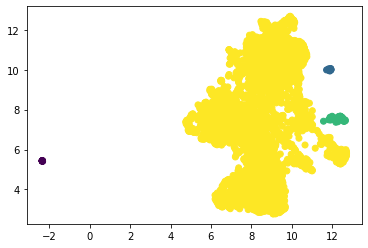

________________________________________________________________________________________________________


In [116]:
def hdbscan_runner(key):
  hdbscan_clust = hdbscan.HDBSCAN(algorithm='best', alpha=1.0, metric='euclidean',cluster_selection_epsilon=0.5).fit(reduced_data[key])
  y_pred = hdbscan_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  

  print("________________________________________________________________________________________________________")



K = 3
for a in reduced_data.keys():
  hdbscan_runner(a)

En terme d'accuracy : aucun algorithme a donné des bons résultats 

Pour original data : l'algorithme n'a pas donné de bons résultat vu qu'il est pas trés bon en high dimensional clustering 

linear & non linear pca sont les algorithmes qui ont donné les meilleurs résultats par rapport aux autres algorithmes (avec un accuracy ~ 20%)

#### **CAH :**

original  Data
plot with predicted labels


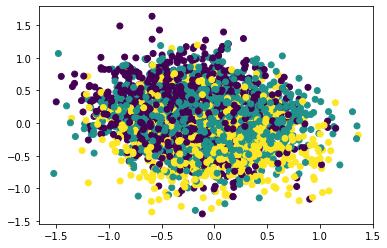

________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


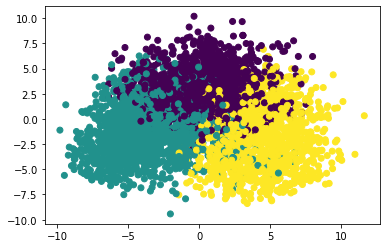

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


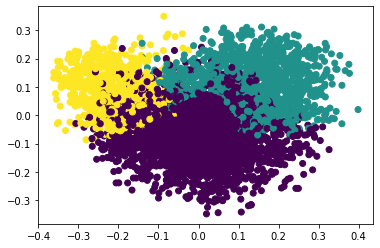

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


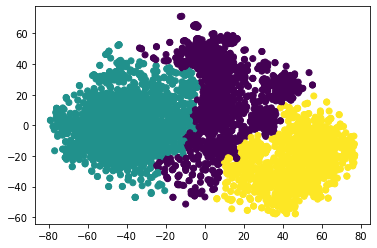

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


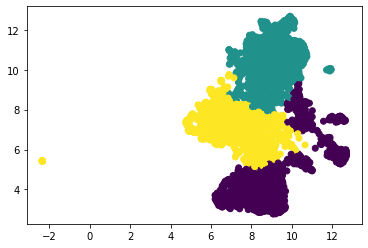

________________________________________________________________________________________________________


In [117]:
def cah_runner(key,K):
  y_pred = AgglomerativeClustering(n_clusters = K).fit_predict(reduced_data[key])
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  

  print("________________________________________________________________________________________________________")



K = 3
for a in reduced_data.keys():
  cah_runner(a,K)

PCA("cosine kernel") a donné le meilleur résultas en terme d'accuracy (50%)et visualisation (affichages avec predicted & true labels trés similaires) 

linear PCA + original data : ont donné une accuracy trés basse

NMI & ARI : résultat similaires pour tout les algorithmes

LA cah reste toujours non adapté aux grands volumes de données à cause du temps de calcul qui explose et cela s’explique complètement par les méthodes de calcul de l’algorithme.


##Partie 2 RoBERTa :

###DCN for Article 1 :

In [118]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
embeddings_DCN_Classic4, cluster_assign_DCN_Classic4 = DCN(vectorized_docs_array, 3, 2, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data = {}
reduced_data['DCN']=embeddings_DCN_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:06<00:00,  7.25it/s]


Running k-means on the learned embeddings...
Starting DCN training...


100%|██████████| 50/50 [00:29<00:00,  1.69it/s]


###DKM for Article 1 :

In [119]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
X_reduced_DKM_Classic4, cluster_assign_DKM_Classic4 = DKM(vectorized_docs_array, 3, 2, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data['DKM']=X_reduced_DKM_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:07<00:00,  7.07it/s]


Running k-means on the learned embeddings...
Starting DKM training...


100%|██████████| 20/20 [00:17<00:00,  1.12it/s]


###Plot Function Article 1 :

DCN  Data
plot with predicted labels


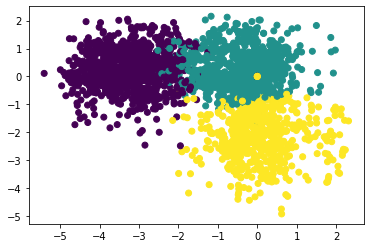

________________________________________________________________________________________________________
DKM  Data
plot with predicted labels


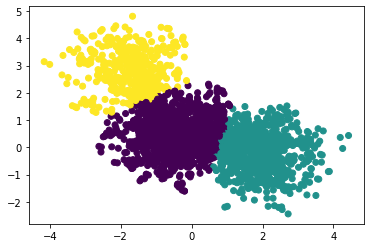

________________________________________________________________________________________________________


In [120]:
def plot_result(key,predicted_labels):
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=predicted_labels)
  plt.show()

  print("________________________________________________________________________________________________________")


K = 3
plot_result("DCN",cluster_assign_DCN_Classic4)
plot_result("DKM",cluster_assign_DKM_Classic4)



DCN  a gangé en terme d'accuracy 45% vs 25% pour DKM

Par les deux méthodes ont eu les memes score NMI & ARI

#Dataset Article 2 : 

##Load Data : 

In [127]:
df = pd.read_csv('/content/nlp_dataset_Articles_2.csv',header=0,sep="\t",index_col=0)
df

,text
0,The Nimitz-class supercarriers are a class of...
1,It's Everybody's War was a short dramatic pro...
2,Armour of God (Chinese: 龍兄虎弟) is a 1986 Hong ...
3,Moon is a 2009 British science fiction drama ...
4,Walter W. Terry (April 1850 – February 20 190...
...,...
5084,Elio de Angelis (26 March 1958 Rome – 15 May ...
5085,The Hound That Thought He Was a Raccoon is a ...
5086,Wenona School is an independent non-denominat...
5087,Wilbur Wright und seine Flugmaschine (Wilbur ...


In [128]:
#punctuations
punctuations = string.punctuation
#stopwords
stop_words = list(STOP_WORDS)
def clean_text(
  string : str,
  ponctuation = '!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~',
  stop_words = stop_words)->str : 

  #URLs
  string = re.sub(r"https?://\S+|www\.\S+",'',string)
  #html 
  string = re.sub(r'<.*?>','',string)
  #Numbers
  string = re.sub(r'[0-9]+','',string) 

  #Remove punctuations
  for x in string.lower():
    if x in punctuations:
      string = string.replace(x,"")
  #To lower
  string = string.lower()
  #Remove stop words
  lemmatizer = WordNetLemmatizer()
  string = ' '.join([lemmatizer.lemmatize(word) for word in string.split() if word not in stop_words])
  #Cleaning the whitespaces
  string = re.sub(r'\s', ' ', string).strip()

  return string

In [129]:
abstract = df['text'].to_list()
abstracts_cleaned = [clean_text(x) for x in abstract]

In [130]:
len(abstracts_cleaned)

5089

## **Word2Vec :**

### **Document embedding :**

In [131]:
sentances = [list(tokenize(s, deacc=True, lower=True)) for s in abstracts_cleaned]
len(sentances)

5089

In [132]:
!wget -c "https://s3.amazonaws.com/dl4j-distribution/GoogleNews-vectors-negative300.bin.gz"
!gzip -d GoogleNews-vectors-negative300.bin.gz

--2021-12-08 14:37:07--  https://s3.amazonaws.com/dl4j-distribution/GoogleNews-vectors-negative300.bin.gz
Resolving s3.amazonaws.com (s3.amazonaws.com)... 52.216.154.62
Connecting to s3.amazonaws.com (s3.amazonaws.com)|52.216.154.62|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1647046227 (1.5G) [application/x-gzip]
Saving to: ‘GoogleNews-vectors-negative300.bin.gz’

vectors-negative300   5%[>                   ]  89.33M  15.2MB/s    eta 2m 9s  ^C
gzip: GoogleNews-vectors-negative300.bin already exists; do you wish to overwrite (y or n)? n
	not overwritten


In [133]:
# Load Google's pre-trained Word2Vec model.
import gensim
model = gensim.models.KeyedVectors.load_word2vec_format('./GoogleNews-vectors-negative300.bin', binary=True)

In [134]:
def vectorize(list_of_docs, model):
    """Generate vectors for list of documents using a Word Embedding

    Args:
        list_of_docs: List of documents
        model: Gensim's Word Embedding

    Returns:
        List of document vectors
    """
    features = []

    for tokens in list_of_docs:
        zero_vector = np.zeros(model.vector_size)
        vectors = []
        for token in tokens:
            if token in model.wv:
                try:
                    vectors.append(model.wv[token])
                except KeyError:
                    continue
        if vectors:
            vectors = np.asarray(vectors)
            avg_vec = vectors.mean(axis=0)
            features.append(avg_vec)
        else:
            features.append(zero_vector)
    return features
    
vectorized_docs = vectorize(sentances, model=model)
len(vectorized_docs), len(vectorized_docs[0])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:17: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).


(5089, 300)

### **Réduction de la dimension :**

In [135]:
reduced_data = {}
reduced_data['original'] = vectorized_docs

#### **PCA** :

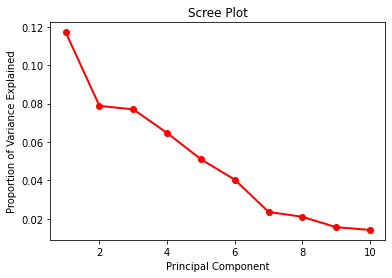

In [136]:
#NUMBER OF COMPONENTS PCA :
import numpy as np
import matplotlib
import matplotlib.pyplot as plt

pca = PCA(n_components=10)
pca_component = pca.fit_transform(vectorized_docs)

PC_values = np.arange(pca.n_components_) + 1
plt.plot(PC_values, pca.explained_variance_ratio_, 'ro-', linewidth=2)
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Proportion of Variance Explained')
plt.show()

On peut prendre le nombre de composantes principal entre 2 & 4 

pca with kernel =  linear


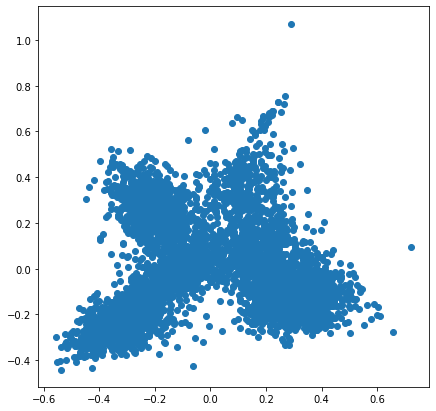

________________________________________________________________________
pca with kernel =  poly


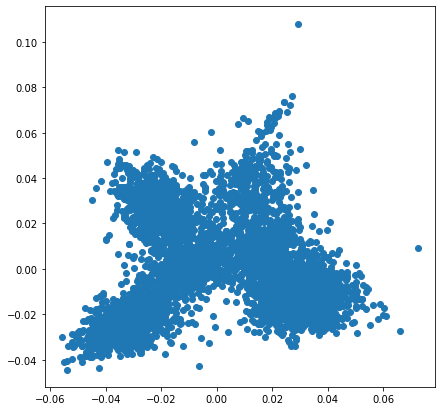

________________________________________________________________________
pca with kernel =  rbf


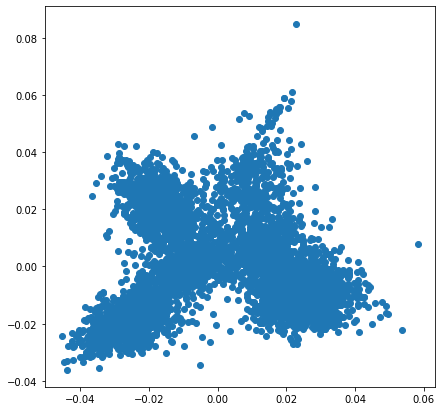

________________________________________________________________________
pca with kernel =  sigmoid


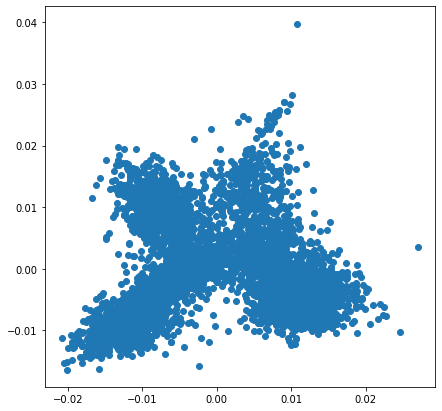

________________________________________________________________________
pca with kernel =  cosine


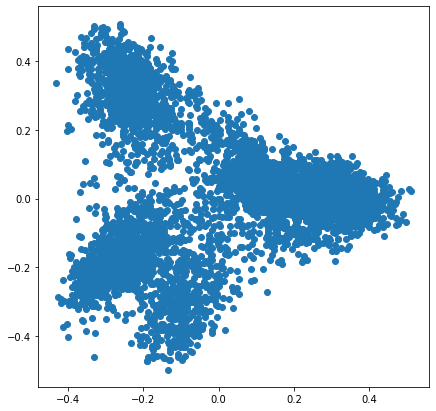

________________________________________________________________________


In [139]:
#PCA WITH DIFFERENT KERNELS :
from sklearn.decomposition import KernelPCA

list_kernel = ["linear", "poly", "rbf", "sigmoid","cosine"]
for i in list_kernel:
  transformer = KernelPCA(n_components=2, kernel=i)
  X_transformed = transformer.fit_transform(vectorized_docs)
  if i == "cosine":
    reduced_data["cosine"] = X_transformed 
  f = plt.figure(figsize=(7,7))
  PCA_componentss = pd.DataFrame(X_transformed)
  plt.scatter(PCA_componentss[0], PCA_componentss[1])
  print("pca with kernel = ",i)
  plt.show()
  print("________________________________________________________________________")

#### **T-SNE :**

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,


tsne init = 'pca'


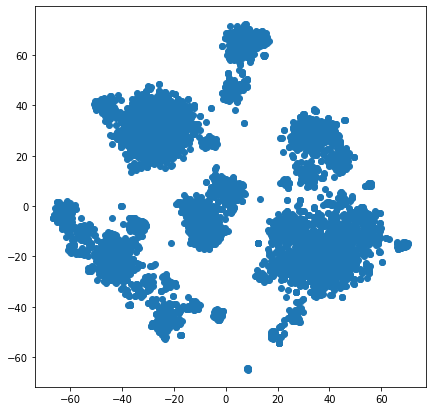

In [140]:
tsne_components = TSNE(n_components=2,init='pca').fit_transform(vectorized_docs)
reduced_data["TSNE"] = tsne_components

#------------------plot-----------------

f = plt.figure(figsize=(7,7))
print("tsne init = 'pca'")
TSNE_components = pd.DataFrame(tsne_components) #tsne with inti ='pca'
plt.scatter(TSNE_components[0], TSNE_components[1])
plt.show()

#### **UMAP :**

In [ ]:
!pip install umap-learn
import umap

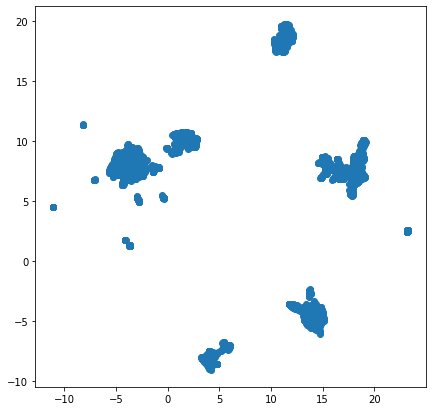

In [141]:
reducer = umap.UMAP()
umap_components = reducer.fit_transform(vectorized_docs)
reduced_data["UMAP"] = umap_components
umap_components.shape

#----------------plot---------------------
f = plt.figure(figsize=(7,7))
UMAP_components = pd.DataFrame(umap_components) 
plt.scatter(UMAP_components[0], UMAP_components[1])
plt.show()

#### **Commentaire reduction de la dimension :**
En regardant le plot de chacune des méthodes et en ignorant les couleurs (true labels) on constate que :

- PCA : 
    - on peut voir une à deux classes (au lieu de 4 classes) 
    - PCA avec kernel différent a donné presque le même résultat avec le kernel linéaire sauf pour 'cosine' qui a mieux séparé les choses 

- TSNE & UMAP : 
    - Dans chacun des deux plot on peut voir au max trois classes

    - Résultats des deux méthodes sont trés similaires vu que les deux méthodes se basent sur local clustering par contre UMAP a fait le travail legèrment mieu que T-SNE vu qu'elle est plus fidèle à la structure global de données, plus rapide et moins couteuse

### **Clustering :**

#### **K-means :**

2
3
4
5
6
7
8


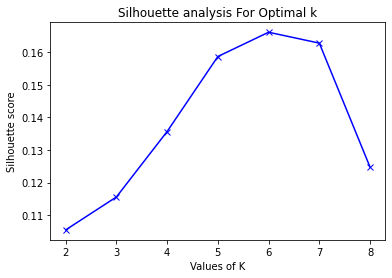

In [142]:
from sklearn.metrics import silhouette_score

range_n_clusters = [2, 3, 4, 5, 6, 7, 8]
silhouette_avg = []
for num_clusters in range_n_clusters:
 print(num_clusters)
 # initialise kmeans
 kmeans = KMeans(n_clusters=num_clusters)
 kmeans.fit(vectorized_docs)
 clusterlabels = kmeans.labels_
 
 # silhouette score
 silhouette_avg.append(silhouette_score(vectorized_docs, clusterlabels))
plt.plot(range_n_clusters,silhouette_avg,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Silhouette score') 
plt.title('Silhouette analysis For Optimal k')
plt.show()

original  Data
plot with predicted labels


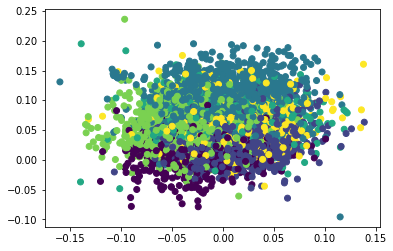

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


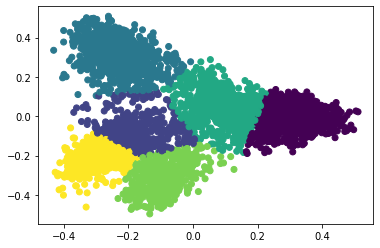

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


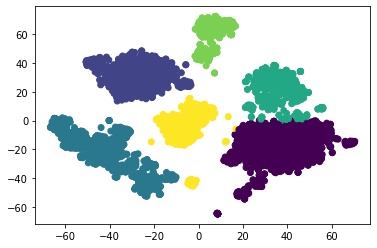

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


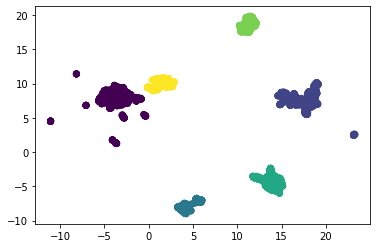

________________________________________________________________________________________________________


In [143]:
def kmeans_runner(key,K):
  kmeans = KMeans(n_clusters=K, random_state=0,n_init=5).fit(reduced_data[key])
  y_pred = kmeans.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  #-------

  #print('Word2vec : Kmeans clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  #print('Word2vec : Kmeans clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  #print('Word2vec : Kmeans clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))  

  print("________________________________________________________________________________________________________")


K = 6
for a in reduced_data.keys():
  kmeans_runner(a,K)

Commentaire K-means Clustering :

En terme d'accuracy : TSNE a donné le plus mauvais résultat et ca prouve que c'est déconseillé de faire suivre TSNE par une K-means 
  - Le problème avec t-SNE est qu'elle ne préserve pas les distances ni la densité. elle ne préserve que dans une certaine mesure les voisins les plus proches. La différence est subtile, mais affecte tout algorithme basé sur la densité ou la distance ce qui est le cas pour K-means

PCA ( linear kernel) a donné le meilleur résulat (47%) par rapport aux autres résultats




#### **Spectral clustering :**

original  Data
plot with predicted labels


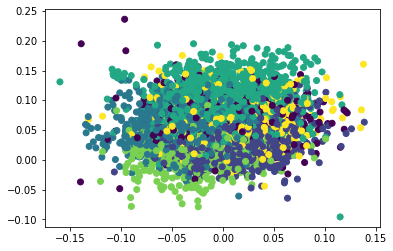

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


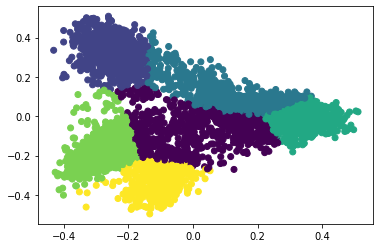

________________________________________________________________________________________________________


KeyboardInterrupt: ignored

In [144]:
def spec_clust_runner(key,K):

  spectral_clust = SpectralClustering(n_clusters=K,assign_labels='discretize',random_state=0).fit(reduced_data[key])
  y_pred = spectral_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  

  #-------

  #print('Word2vec : spectral clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  #print('Word2vec : spectral clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  #print('Word2vec : spectral clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 6
for a in reduced_data.keys():
  spec_clust_runner(a,K)

En comparant le Spectral clustering & k-means :

L'accuracy a augmenté pour Spectral clustering par rapport au k-means dans le cas de données originaux + pca non linéaire (cosine kernel)

En revanche on a remaqué une baisse d'accuracy dans le cas du pca linéaire ( linear kernel)

Meme en terme de visualisation : non linear pca ("cosine") a donné un affichage qui ressemble à l'affichage en utilisant les vrai labels

Sinon en terme de temps d'éxecution malgré que le spectral clustering se base sur la méthode k-means mais pas sur les coordonnées originales, mais sur un embedding qui se focalise sur la connectivité, donc au lieu de minimiser les erreurs au carré dans l'input, il minimise les erreurs au carré sur la capacité à reconstruire les voisins et c'est souvent mieux.

#### **HDBSCAN :**

In [ ]:
!pip install hdbscan
import hdbscan

     |████████████████████████████████| 6.4 MB 3.7 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for hdbscan: filename=hdbscan-0.8.27-cp37-cp37m-linux_x86_64.whl size=2311858 sha256=bc6db971308b75f698793daf5654a195c3b0319f09aba2f8c74fb94e97a05cd7
  Stored in directory: /root/.cache/pip/wheels/73/5f/2f/9a259b84003b84847c259779206acecabb25ab56f1506ee72b
Successfully built hdbscan


original  Data
plot with predicted labels


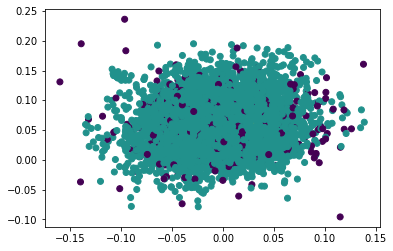

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


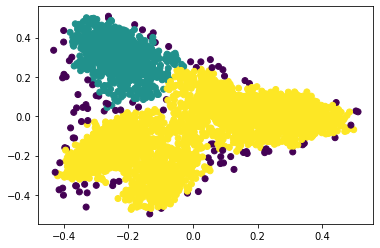

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


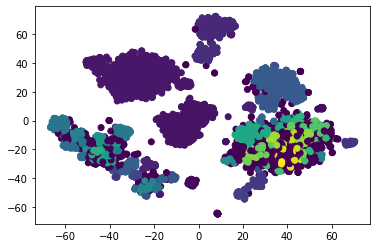

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


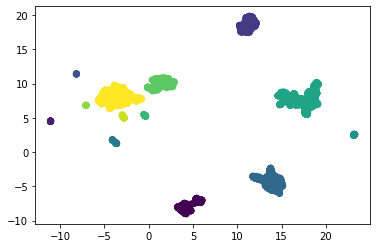

________________________________________________________________________________________________________


In [146]:
def hdbscan_runner(key):
  hdbscan_clust = hdbscan.HDBSCAN(algorithm='best', alpha=1.0, metric='euclidean',cluster_selection_epsilon=1.0).fit(reduced_data[key])
  y_pred = hdbscan_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()


  #-------

  #print('Word2vec : hdbscan clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  #print('Word2vec : hdbscan clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  #print('Word2vec : hdbscan clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 6
for a in reduced_data.keys():
  hdbscan_runner(a)

En terme d'accuracy : aucun algorithme a donné des bons résultats 

Pour original data : l'algorithme n'a pas donné de bons résultat vu qu'il est pas trés bon en high dimensional clustering 

linear & non linear pca sont les algorithmes qui ont donné les meilleurs résultats par rapport aux autres algorithmes (avec un accuracy ~ 20%)

#### **CAH :**

original  Data
plot with predicted labels


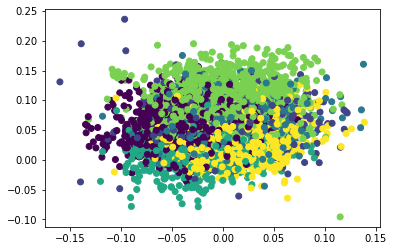

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


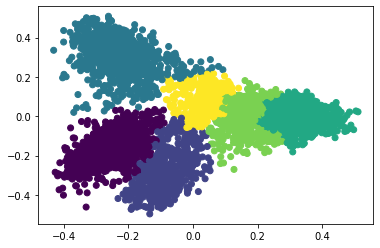

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


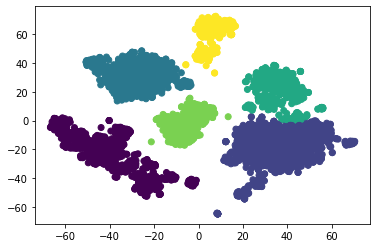

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


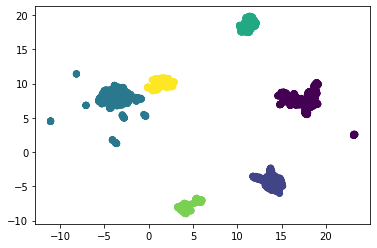

________________________________________________________________________________________________________


In [147]:
def cah_runner(key,K):
  y_pred = AgglomerativeClustering(n_clusters = K).fit_predict(reduced_data[key])
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  #-------

  #print('Word2vec : cah clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  #print('Word2vec : cah clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  #print('Word2vec : cah clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")



K = 6
for a in reduced_data.keys():
  cah_runner(a,K)

PCA("cosine kernel") a donné le meilleur résultas en terme d'accuracy (50%)et visualisation (affichages avec predicted & true labels trés similaires) 

linear PCA + original data : ont donné une accuracy trés basse

NMI & ARI : résultat similaires pour tout les algorithmes

LA cah reste toujours non adapté aux grands volumes de données à cause du temps de calcul qui explose et cela s’explique complètement par les méthodes de calcul de l’algorithme.


##Partie 2 Word2Vec :

###DCN for Article 2  :

In [148]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
embeddings_DCN_Classic4, cluster_assign_DCN_Classic4 = DCN(vectorized_docs_array, 6, 2, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data = {}
reduced_data['DCN']=embeddings_DCN_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:07<00:00,  6.40it/s]


Running k-means on the learned embeddings...
Starting DCN training...


100%|██████████| 50/50 [00:32<00:00,  1.54it/s]


###DKM for Article 2  :

In [149]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
X_reduced_DKM_Classic4, cluster_assign_DKM_Classic4 = DKM(vectorized_docs_array, 6, 2, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data['DKM']=X_reduced_DKM_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:08<00:00,  6.10it/s]


Running k-means on the learned embeddings...
Starting DKM training...


100%|██████████| 20/20 [00:26<00:00,  1.31s/it]


###Plot Function Article 2 :

DCN  Data
plot with predicted labels


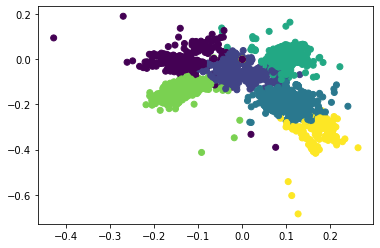

________________________________________________________________________________________________________
DKM  Data
plot with predicted labels


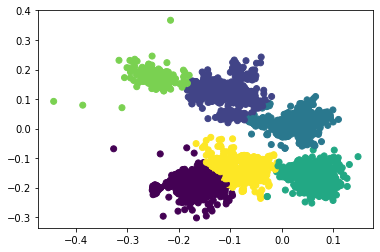

________________________________________________________________________________________________________


In [150]:
def plot_result(key,predicted_labels):
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=predicted_labels)
  plt.show()

  #-------

  #print('Word2vec : clustering with ',key,' data accuracy : ',accuracy_score(true_labels,predicted_labels))
  #print('Word2vec : clustering with ',key,' data NMI : ',normalized_mutual_info_score(true_labels,predicted_labels))
  #print('Word2vec : clustering with ',key,' data ARI : ',adjusted_rand_score(true_labels,predicted_labels))
  print("________________________________________________________________________________________________________")


K = 6
plot_result("DCN",cluster_assign_DCN_Classic4)
plot_result("DKM",cluster_assign_DKM_Classic4)



DCN  a gangé en terme d'accuracy 45% vs 25% pour DKM

Par les deux méthodes ont eu les memes score NMI & ARI

## **Glove :**

In [ ]:
!wget -c "https://nlp.stanford.edu/data/glove.840B.300d.zip"
!unzip glove*.zip

--2021-12-08 13:35:30--  https://nlp.stanford.edu/data/glove.840B.300d.zip
Resolving nlp.stanford.edu (nlp.stanford.edu)... 171.64.67.140
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: http://downloads.cs.stanford.edu/nlp/data/glove.840B.300d.zip [following]
--2021-12-08 13:35:30--  http://downloads.cs.stanford.edu/nlp/data/glove.840B.300d.zip
Resolving downloads.cs.stanford.edu (downloads.cs.stanford.edu)... 171.64.64.22
Connecting to downloads.cs.stanford.edu (downloads.cs.stanford.edu)|171.64.64.22|:80... connected.
HTTP request sent, awaiting response... 206 Partial Content
Length: 2176768927 (2.0G), 2164136840 (2.0G) remaining [application/zip]
Saving to: ‘glove.840B.300d.zip’

glove.840B.300d.zip 100%[===================>]   2.03G  5.06MB/s    in 9m 52s  

2021-12-08 13:45:22 (3.49 MB/s) - ‘glove.840B.300d.zip’ saved [2176768927/2176768927]

Archive:  glove.840B.300d.zip
  

In [151]:
from gensim.test.utils import datapath, get_tmpfile
from gensim.models import KeyedVectors
from gensim.scripts.glove2word2vec import glove2word2vec

glove_file = datapath("/content/glove.840B.300d.txt")
tmp_file = get_tmpfile("test_word2vec.txt")
_ = glove2word2vec(glove_file, tmp_file)
model = KeyedVectors.load_word2vec_format(tmp_file)

In [152]:
vectorized_docs = vectorize(sentances, model=model)
len(vectorized_docs), len(vectorized_docs[0])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:17: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).


(5089, 300)

### **Réduction de la dimension :**

In [153]:
reduced_data = {}
reduced_data['original'] = vectorized_docs

#### **PCA** :

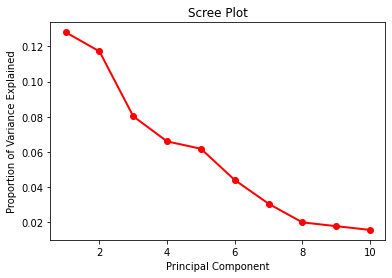

In [154]:
#NUMBER OF COMPONENTS PCA :

pca = PCA(n_components=10)
pca_component = pca.fit_transform(vectorized_docs)

PC_values = np.arange(pca.n_components_) + 1
plt.plot(PC_values, pca.explained_variance_ratio_, 'ro-', linewidth=2)
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Proportion of Variance Explained')
plt.show()

On peut prendre le nombre de composantes principal entre 3 & 4 

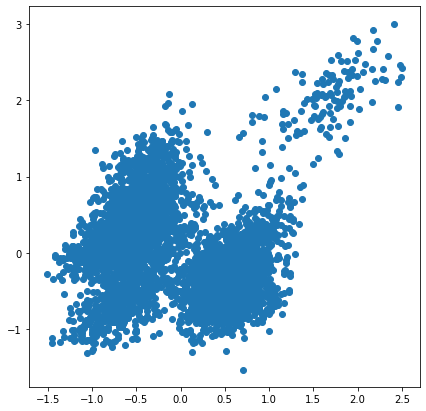

In [158]:
pca = PCA(n_components=3)
pca_components = pca.fit_transform(vectorized_docs)
reduced_data["PCA"] = pca_components

#---------------plot----------------------------------

f = plt.figure(figsize=(7,7))
PCA_components = pd.DataFrame(pca_components)
plt.scatter(PCA_components[0], PCA_components[1])
plt.show()

pca with kernel =  linear


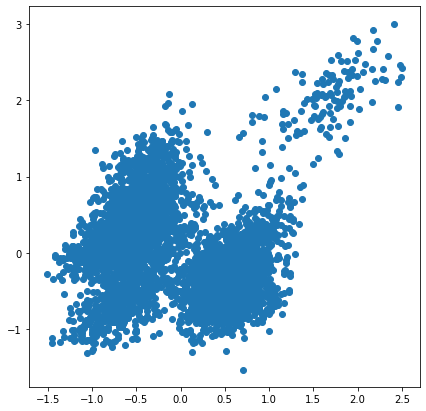

________________________________________________________________________
pca with kernel =  poly


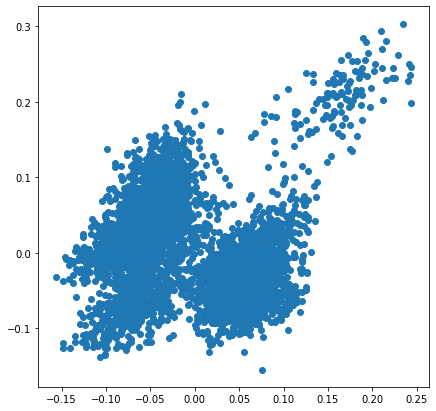

________________________________________________________________________
pca with kernel =  rbf


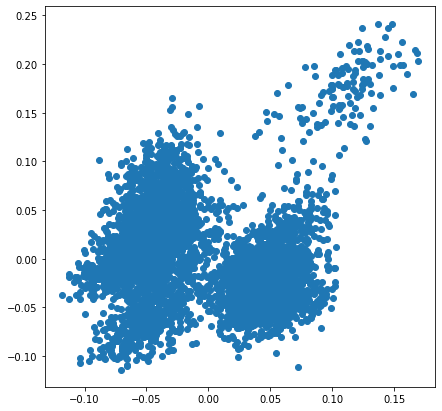

________________________________________________________________________
pca with kernel =  sigmoid


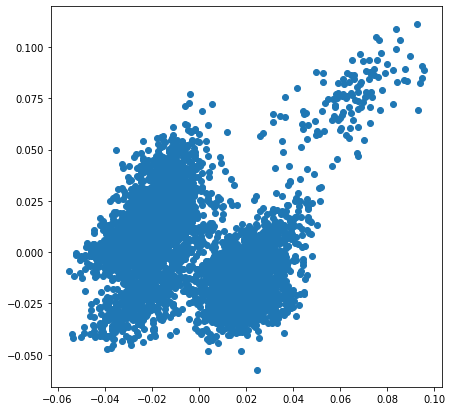

________________________________________________________________________
pca with kernel =  cosine


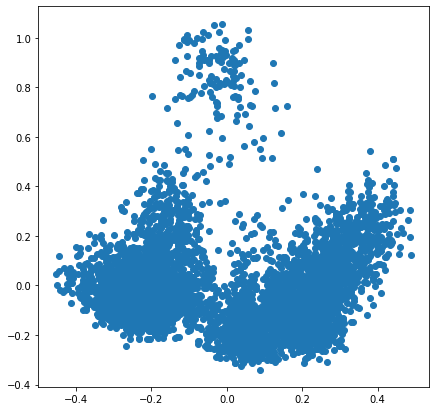

________________________________________________________________________


In [159]:
#PCA WITH DIFFERENT KERNELS :
from sklearn.decomposition import KernelPCA

list_kernel = ["linear", "poly", "rbf", "sigmoid","cosine"]
for i in list_kernel:
  transformer = KernelPCA(n_components=4, kernel=i)
  X_transformed = transformer.fit_transform(vectorized_docs)
  if i == "cosine":
    reduced_data["cosine"] = X_transformed 
  f = plt.figure(figsize=(7,7))
  PCA_componentss = pd.DataFrame(X_transformed)
  plt.scatter(PCA_componentss[0], PCA_componentss[1])
  print("pca with kernel = ",i)
  plt.show()
  print("________________________________________________________________________")

#### **T-SNE :**

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,


tsne init = 'pca'


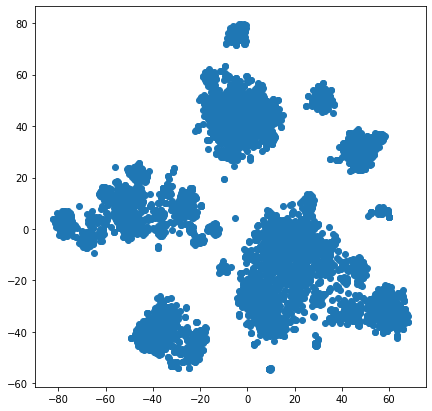

In [160]:
tsne_components = TSNE(n_components=2,init='pca').fit_transform(vectorized_docs)
reduced_data["TSNE"] = tsne_components

#------------------plot-----------------

f = plt.figure(figsize=(7,7))
print("tsne init = 'pca'")
TSNE_components = pd.DataFrame(tsne_components) #tsne with inti ='pca'
plt.scatter(TSNE_components[0], TSNE_components[1])
plt.show()

#### **UMAP :**

In [ ]:
!pip install umap-learn
import umap

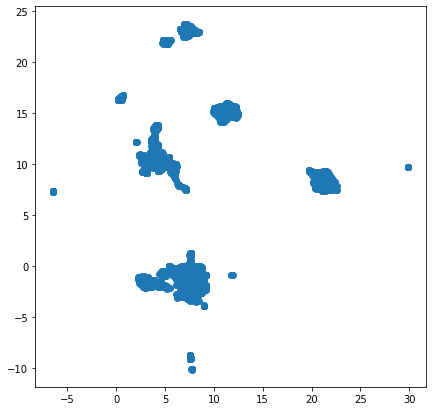

In [161]:
reducer = umap.UMAP()
umap_components = reducer.fit_transform(vectorized_docs)
reduced_data["UMAP"] = umap_components
umap_components.shape

#----------------plot---------------------
f = plt.figure(figsize=(7,7))
UMAP_components = pd.DataFrame(umap_components) 
plt.scatter(UMAP_components[0], UMAP_components[1])
plt.show()

#### En comparant les différentes résultats de la réduction de dimension :

on remarque pas une grosse différence entre word2vec et glove 

PCA en (ignorant les couleurs des true labels) on peut voir au max 2 classes

UMAP & TSNE : on peut voir 3 classe au max (la meme chose avec word2vec)


Par contre la visualisation des deux premières composantes du TSNE sur les données w2v et glove est exactement la mêmes (mais inversée en terme d'affichage)

### **Clustering :**

#### **K-means :**

2
3
4
5
6
7
8


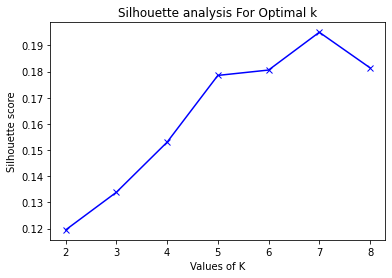

In [162]:
from sklearn.metrics import silhouette_score

range_n_clusters = [2, 3, 4, 5, 6, 7, 8]
silhouette_avg = []
for num_clusters in range_n_clusters:
 print(num_clusters)
 # initialise kmeans
 kmeans = KMeans(n_clusters=num_clusters)
 kmeans.fit(vectorized_docs)
 clusterlabels = kmeans.labels_
 
 # silhouette score
 silhouette_avg.append(silhouette_score(vectorized_docs, clusterlabels))
plt.plot(range_n_clusters,silhouette_avg,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Silhouette score') 
plt.title('Silhouette analysis For Optimal k')
plt.show()

original  Data
plot with predicted labels


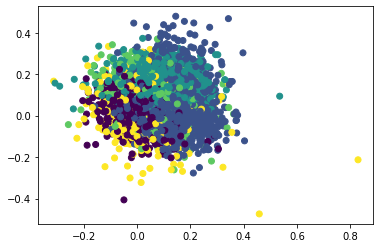

________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


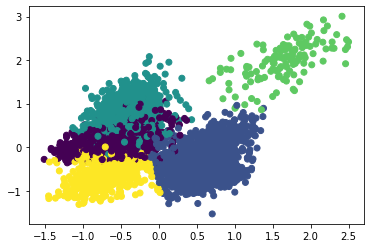

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


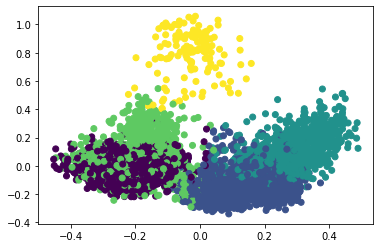

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


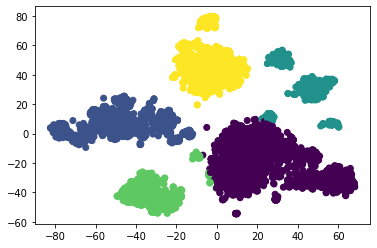

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


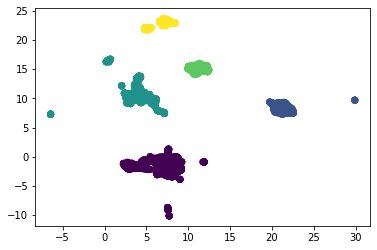

________________________________________________________________________________________________________


In [163]:
def kmeans_runner(key,K):
  kmeans = KMeans(n_clusters=K, random_state=0,n_init=5).fit(reduced_data[key])
  y_pred = kmeans.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  

  #-------

  #print('Glove : Kmeans clustering on ',key,' data accuracy : ',accuracy_score(true_labels,y_pred))
  #print('Glove : Kmeans clustering on ',key,' data NMI : ',normalized_mutual_info_score(true_labels,y_pred))
  #print('Glove : Kmeans clustering on ',key,' data ARI : ',adjusted_rand_score(true_labels,y_pred))
  

  print("________________________________________________________________________________________________________")


K = 5
for a in reduced_data.keys():
  kmeans_runner(a,K)

PCA (cosine kernel) a donné le meilleur résultat ~70 % (ce qui justifie la non linéarité de non données en comparant avec les résultats du pca linéaire)

TSNE a donné 50 % d'accuracy 


NMI & ARI  moyenne pour la majorité des algorithmes 
On constate des valeurs de NMI & ARI hausses pour les différents algorithmes



#### **Spectral clustering :**

In [ ]:
def spec_clust_runner(key,K):

  spectral_clust = SpectralClustering(n_clusters=K,assign_labels='discretize',random_state=0).fit(reduced_data[key])
  y_pred = spectral_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  

  print("________________________________________________________________________________________________________")



K = 5
for a in reduced_data.keys():
  spec_clust_runner(a,K)

#### **HDBSCAN :**

In [ ]:
!pip install hdbscan
import hdbscan

     |████████████████████████████████| 6.4 MB 8.7 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for hdbscan: filename=hdbscan-0.8.27-cp37-cp37m-linux_x86_64.whl size=2311907 sha256=b018aa4d598ca983497ff77598fc775578c655a25439a41ee5f406ebff60c046
  Stored in directory: /root/.cache/pip/wheels/73/5f/2f/9a259b84003b84847c259779206acecabb25ab56f1506ee72b
Successfully built hdbscan


original  Data
plot with predicted labels


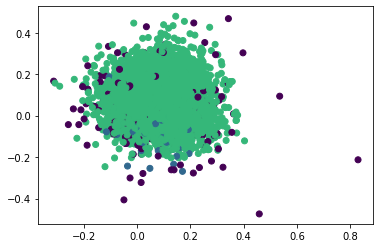

________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


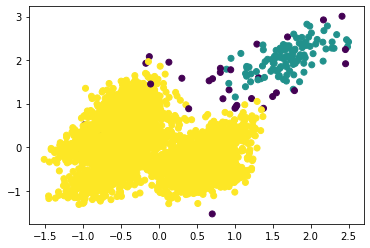

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


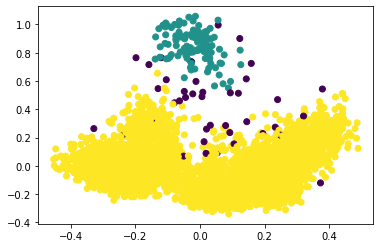

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


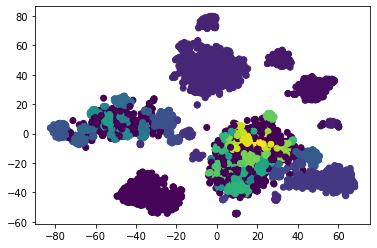

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


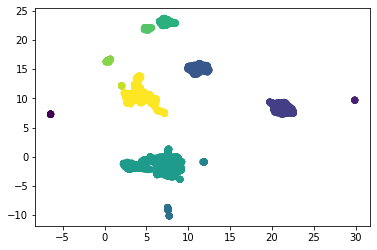

________________________________________________________________________________________________________


In [164]:
def hdbscan_runner(key):
  hdbscan_clust = hdbscan.HDBSCAN(algorithm='best', alpha=1.0, metric='euclidean',cluster_selection_epsilon=1.0).fit(reduced_data[key])
  y_pred = hdbscan_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  

  print("________________________________________________________________________________________________________")



K = 5
for a in reduced_data.keys():
  hdbscan_runner(a)

#### Commentaire 🇰

Accuracy trés basses pour la majorité des algorithmes, meilleurs résultats pca ~20%

NMI & ARI trés basses pour tous les algorithmes sauf UMAP  qui a obtenue des scores trés considérable (surtout en terme de NMI ~71%)

donc UMAP : meilleur performance avec hdbscan (vu que UMAP se focalise sur le clustering local mais il est toujours fidèle à la structure globale)

#### **CAH :**

original  Data
plot with predicted labels


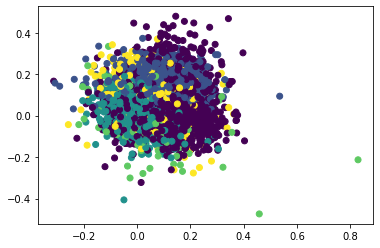

________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


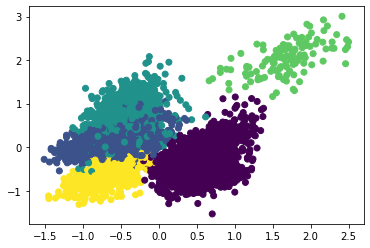

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


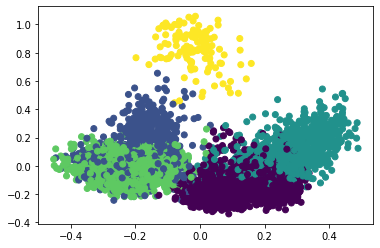

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


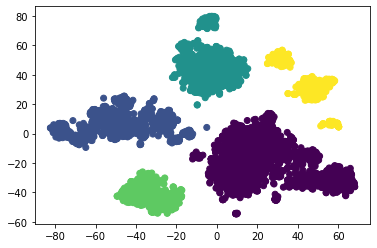

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


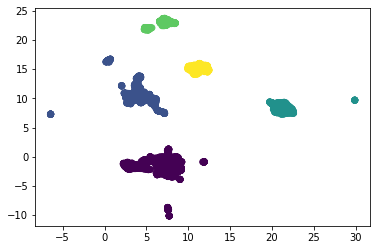

________________________________________________________________________________________________________


In [165]:
def cah_runner(key,K):
  y_pred = AgglomerativeClustering(n_clusters = K).fit_predict(reduced_data[key])
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  

  print("________________________________________________________________________________________________________")



K = 5
for a in reduced_data.keys():
  cah_runner(a,K)

#### Commentaire 🇰

Cah sur original data (glove) a donné des meilleurs résultats en comparant avec ce qui a été obtenue avec les embedding de W2V 


PCA (cosine kernel) meilleur accuracy (77%) vs 18% du PCA linéaire

nmi elevé pour la majorité des algorithmes 

##Partie 2  Glove:

###DCN for Article 2 :

In [166]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
embeddings_DCN_Classic4, cluster_assign_DCN_Classic4 = DCN(vectorized_docs_array, 5, 2, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data = {}
reduced_data['DCN']=embeddings_DCN_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:07<00:00,  6.32it/s]


Running k-means on the learned embeddings...
Starting DCN training...


100%|██████████| 50/50 [00:34<00:00,  1.45it/s]


###DKM for Article 2 :

In [167]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
X_reduced_DKM_Classic4, cluster_assign_DKM_Classic4 = DKM(vectorized_docs_array, 5, 2, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data['DKM']=X_reduced_DKM_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:08<00:00,  5.97it/s]


Running k-means on the learned embeddings...
Starting DKM training...


100%|██████████| 20/20 [00:24<00:00,  1.23s/it]


###Plot Function Article 2:

DCN  Data
plot with predicted labels


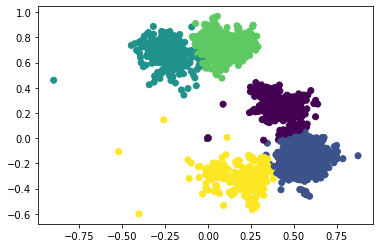

DKM  Data
plot with predicted labels


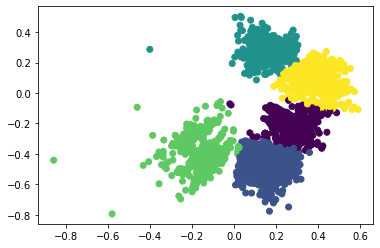

In [168]:
def plot_result(key,predicted_labels):
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=predicted_labels)
  plt.show()




K = 5
plot_result("DCN",cluster_assign_DCN_Classic4)
plot_result("DKM",cluster_assign_DKM_Classic4)



En prenant les résultats des 3 algorithmes :

DKM a obtenu des meilleurs résultats (mais loin d'être bon toujours en dessous de 50% )

#### Commentaire général : 

en terme général : nos différents algorithms ont donné des meilleurs performance (parfois différence légère) sur les embedding du Glove par rapport au embedding de W2V en terme de visualisation & evaluations

#### Comparaison w2v glove : 

Word2Vec permet de prédire les mots en fonction de leur

contexte en utilisant l'un des deux modèles : CBOW et Skip-Gram

GLOVE est basé sur les occurrences de mots dans un corpus textuel. En fait, il est basé sur deux étapes principales.

- La première est la construction d'une matrice de cooccurrence X à partir d'un corpus d'entraînement
- La deuxième étape est la factorisation de X afin d'obtenir des vecteurs

## **BERT :**

### **Document embedding :**

In [169]:
!pip install -U sentence-transformers
from sentence_transformers import SentenceTransformer
model = SentenceTransformer('bert-base-nli-mean-tokens')

In [170]:
vectorized_docs = model.encode(abstract)

### **Réduction de la dimension :**

In [171]:
reduced_data = {}
reduced_data['original'] = vectorized_docs

#### **PCA** :

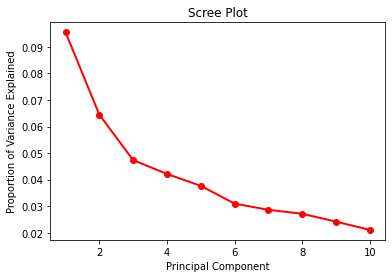

In [172]:
#NUMBER OF COMPONENTS PCA :
pca = PCA(n_components=10)
pca_component = pca.fit_transform(vectorized_docs)

PC_values = np.arange(pca.n_components_) + 1
plt.plot(PC_values, pca.explained_variance_ratio_, 'ro-', linewidth=2)
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Proportion of Variance Explained')
plt.show()

On peut prendre le nombre de composantes principal = 4

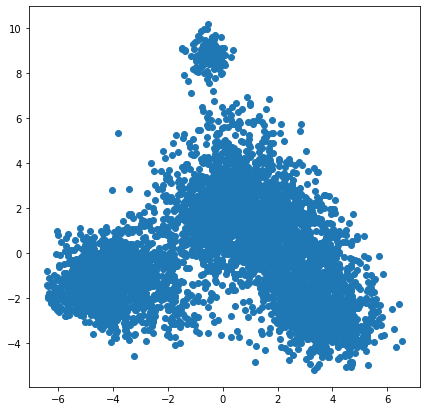

In [173]:
pca = PCA(n_components=3)
pca_components = pca.fit_transform(vectorized_docs)
reduced_data["PCA"] = pca_components

#---------------plot----------------------------------

f = plt.figure(figsize=(7,7))
PCA_components = pd.DataFrame(pca_components)
plt.scatter(PCA_components[0], PCA_components[1])
plt.show()

pca with kernel =  linear


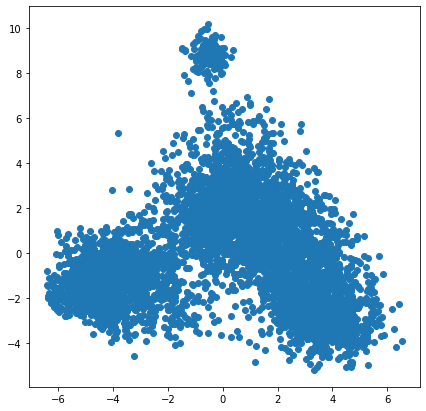

________________________________________________________________________
pca with kernel =  poly


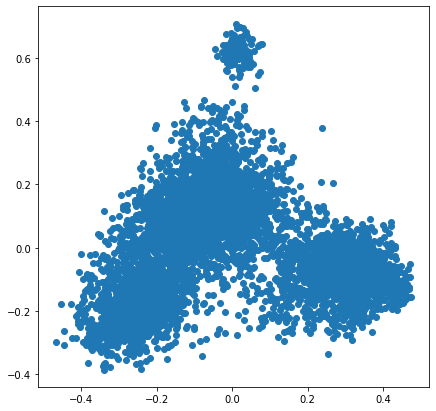

________________________________________________________________________
pca with kernel =  rbf


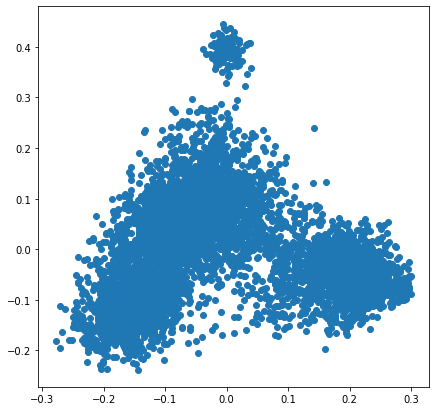

________________________________________________________________________
pca with kernel =  sigmoid


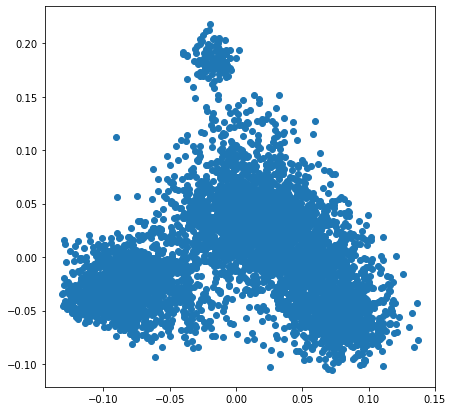

________________________________________________________________________
pca with kernel =  cosine


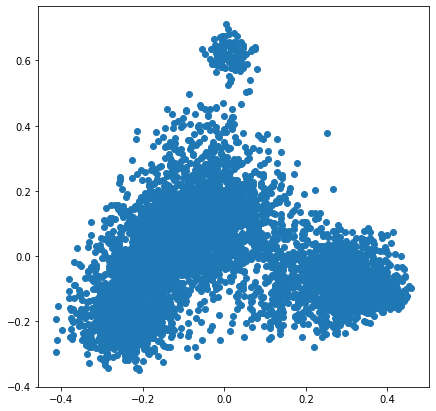

________________________________________________________________________


In [174]:
#PCA WITH DIFFERENT KERNELS :
from sklearn.decomposition import KernelPCA

list_kernel = ["linear", "poly", "rbf", "sigmoid","cosine"]
for i in list_kernel:
  transformer = KernelPCA(n_components=4, kernel=i)
  X_transformed = transformer.fit_transform(vectorized_docs)
  if i == "cosine":
    reduced_data["cosine"] = X_transformed 
  f = plt.figure(figsize=(7,7))
  PCA_componentss = pd.DataFrame(X_transformed)
  plt.scatter(PCA_componentss[0], PCA_componentss[1])
  print("pca with kernel = ",i)
  plt.show()
  print("________________________________________________________________________")

#### **T-SNE :**

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,


tsne init = 'pca'


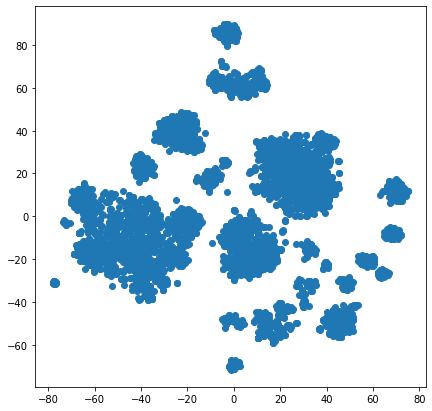

In [176]:
tsne_components = TSNE(n_components=2,init='pca').fit_transform(vectorized_docs)
reduced_data["TSNE"] = tsne_components

#------------------plot-----------------

f = plt.figure(figsize=(7,7))
print("tsne init = 'pca'")
TSNE_components = pd.DataFrame(tsne_components) #tsne with inti ='pca'
plt.scatter(TSNE_components[0], TSNE_components[1])
plt.show()

#### **UMAP :**

In [ ]:
!pip install umap-learn
import umap

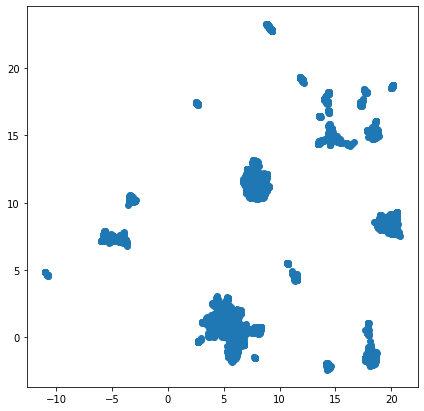

In [177]:
reducer = umap.UMAP()
umap_components = reducer.fit_transform(vectorized_docs)
reduced_data["UMAP"] = umap_components
umap_components.shape

#----------------plot---------------------
f = plt.figure(figsize=(7,7))
UMAP_components = pd.DataFrame(umap_components) 
plt.scatter(UMAP_components[0], UMAP_components[1])
plt.show()

#### **Commentaire reduction de la dimension :**
En regardant le plot de chacune des méthodes et en ignorant les couleurs (true labels) on constate que :

- PCA : 
    - on peut voir une à deux classes (au lieu de 4 classes) 
    - PCA avec kernel différent a donné presque le même résultat avec le kernel linéaire sauf pour 'cosine' qui a mieux séparé les choses 

- TSNE & UMAP : 
    - Dans chacun des deux plot on peut voir au max trois classes

    - Résultats des deux méthodes sont trés similaires vu que les deux méthodes se basent sur local clustering par contre UMAP a fait le travail legèrment mieu que T-SNE vu qu'elle est plus fidèle à la structure global de données, plus rapide et moins couteuse

### **Clustering :**

#### **K-means :**

2
3
4
5
6
7
8


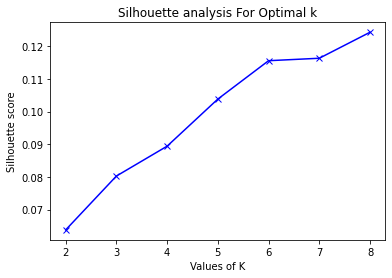

In [179]:
from sklearn.metrics import silhouette_score

range_n_clusters = [2, 3, 4, 5, 6, 7, 8]
silhouette_avg = []
for num_clusters in range_n_clusters:
 print(num_clusters)
 # initialise kmeans
 kmeans = KMeans(n_clusters=num_clusters)
 kmeans.fit(vectorized_docs)
 clusterlabels = kmeans.labels_
 
 # silhouette score
 silhouette_avg.append(silhouette_score(vectorized_docs, clusterlabels))
plt.plot(range_n_clusters,silhouette_avg,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Silhouette score') 
plt.title('Silhouette analysis For Optimal k')
plt.show()

original  Data
plot with predicted labels


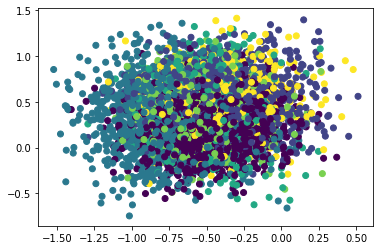

________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


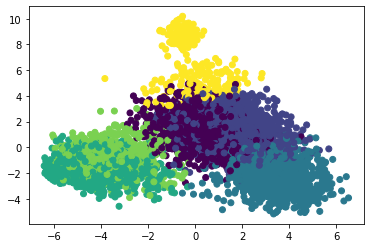

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


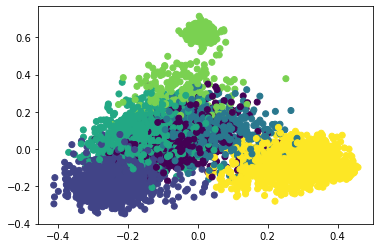

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


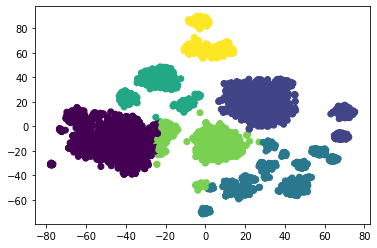

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


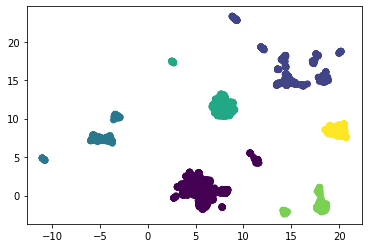

________________________________________________________________________________________________________


In [180]:
def kmeans_runner(key,K):
  kmeans = KMeans(n_clusters=K, random_state=0,n_init=5).fit(reduced_data[key])
  y_pred = kmeans.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  print("________________________________________________________________________________________________________")


K = 6
for a in reduced_data.keys():
  kmeans_runner(a,K)

Commentaire K-means Clustering :

En terme d'accuracy : TSNE a donné le plus mauvais résultat et ca prouve que c'est déconseillé de faire suivre TSNE par une K-means 
  - Le problème avec t-SNE est qu'elle ne préserve pas les distances ni la densité. elle ne préserve que dans une certaine mesure les voisins les plus proches. La différence est subtile, mais affecte tout algorithme basé sur la densité ou la distance ce qui est le cas pour K-means

PCA ( linear kernel) a donné le meilleur résulat (47%) par rapport aux autres résultats




#### **Spectral clustering :**

original  Data
plot with predicted labels


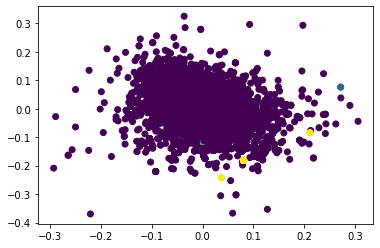

plot with true labels


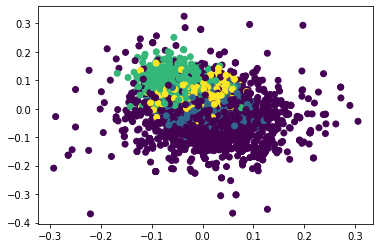

Word2vec : spectral clustering on  original  data accuracy :  0.44200140944326993
Word2vec : spectral clustering on  original  data NMI :  0.011432439464275107
Word2vec : spectral clustering on  original  data ARI :  -0.007784530943189727
________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


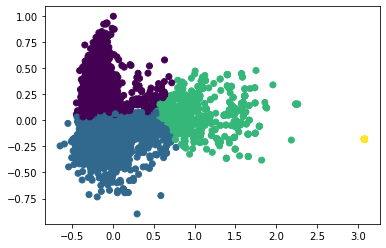

plot with true labels


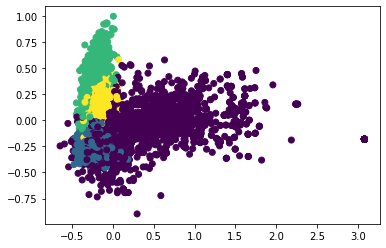

Word2vec : spectral clustering on  PCA  data accuracy :  0.23255813953488372
Word2vec : spectral clustering on  PCA  data NMI :  0.44871444007371325
Word2vec : spectral clustering on  PCA  data ARI :  0.3210521050916887
________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


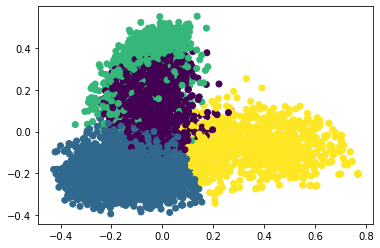

plot with true labels


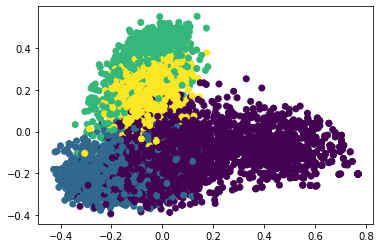

Word2vec : spectral clustering on  cosine  data accuracy :  0.3916842847075405
Word2vec : spectral clustering on  cosine  data NMI :  0.6036230644293806
Word2vec : spectral clustering on  cosine  data ARI :  0.43125705240878764
________________________________________________________________________________________________________


KeyboardInterrupt: ignored

In [ ]:
def spec_clust_runner(key,K):

  spectral_clust = SpectralClustering(n_clusters=K,assign_labels='discretize',random_state=0).fit(reduced_data[key])
  y_pred = spectral_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()


  print("________________________________________________________________________________________________________")



K = 6
for a in reduced_data.keys():
  spec_clust_runner(a,K)

En comparant le Spectral clustering & k-means :

L'accuracy a augmenté pour Spectral clustering par rapport au k-means dans le cas de données originaux + pca non linéaire (cosine kernel)

En revanche on a remaqué une baisse d'accuracy dans le cas du pca linéaire ( linear kernel)

Meme en terme de visualisation : non linear pca ("cosine") a donné un affichage qui ressemble à l'affichage en utilisant les vrai labels

Sinon en terme de temps d'éxecution malgré que le spectral clustering se base sur la méthode k-means mais pas sur les coordonnées originales, mais sur un embedding qui se focalise sur la connectivité, donc au lieu de minimiser les erreurs au carré dans l'input, il minimise les erreurs au carré sur la capacité à reconstruire les voisins et c'est souvent mieux.

#### **HDBSCAN :**

In [ ]:
#!pip install hdbscan
import hdbscan

original  Data
plot with predicted labels


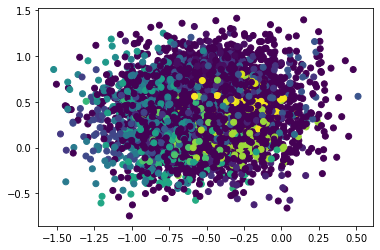

________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


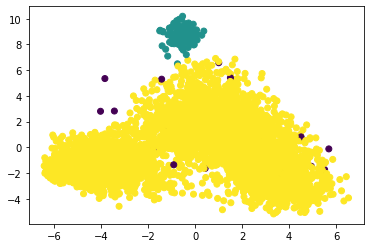

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


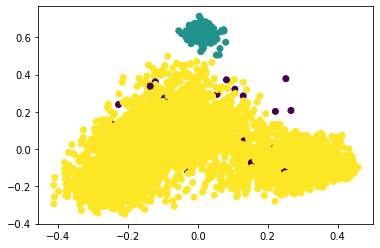

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


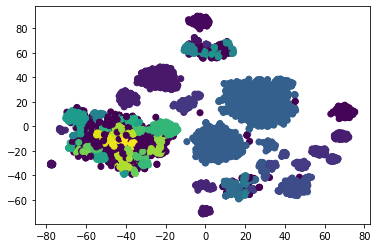

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


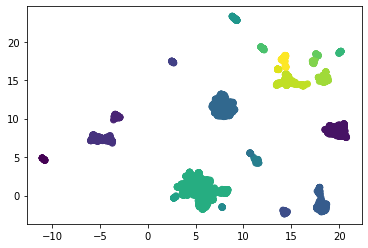

________________________________________________________________________________________________________


In [181]:
def hdbscan_runner(key):
  hdbscan_clust = hdbscan.HDBSCAN(algorithm='best', alpha=1.0, metric='euclidean',cluster_selection_epsilon=0.5).fit(reduced_data[key])
  y_pred = hdbscan_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  

  print("________________________________________________________________________________________________________")



K = 6
for a in reduced_data.keys():
  hdbscan_runner(a)

En terme d'accuracy : aucun algorithme a donné des bons résultats 

Pour original data : l'algorithme n'a pas donné de bons résultat vu qu'il est pas trés bon en high dimensional clustering 

linear & non linear pca sont les algorithmes qui ont donné les meilleurs résultats par rapport aux autres algorithmes (avec un accuracy ~ 20%)

#### **CAH :**

original  Data
plot with predicted labels


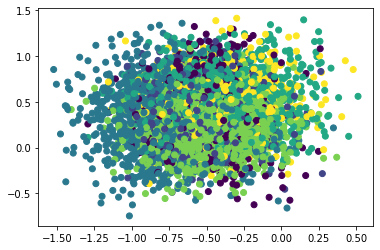

________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


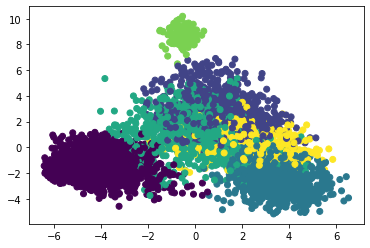

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


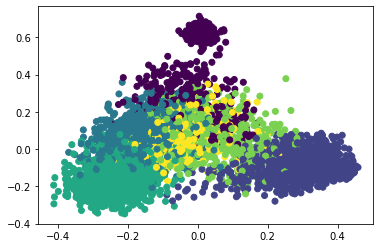

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


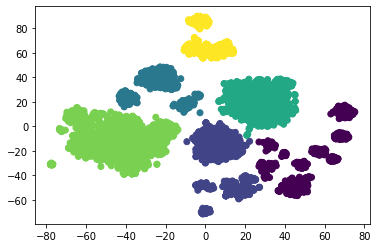

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


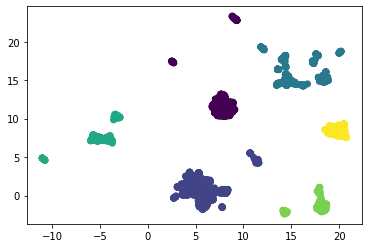

________________________________________________________________________________________________________


In [182]:
def cah_runner(key,K):
  y_pred = AgglomerativeClustering(n_clusters = K).fit_predict(reduced_data[key])
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  #-------
  

  print("________________________________________________________________________________________________________")



K = 6
for a in reduced_data.keys():
  cah_runner(a,K)

PCA("cosine kernel") a donné le meilleur résultas en terme d'accuracy (50%)et visualisation (affichages avec predicted & true labels trés similaires) 

linear PCA + original data : ont donné une accuracy trés basse

NMI & ARI : résultat similaires pour tout les algorithmes

LA cah reste toujours non adapté aux grands volumes de données à cause du temps de calcul qui explose et cela s’explique complètement par les méthodes de calcul de l’algorithme.


##Partie 2 BERT :

###DCN for Article 2 :

In [183]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
embeddings_DCN_Classic4, cluster_assign_DCN_Classic4 = DCN(vectorized_docs_array, 6, 2, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data = {}
reduced_data['DCN']=embeddings_DCN_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:08<00:00,  5.86it/s]


Running k-means on the learned embeddings...
Starting DCN training...


100%|██████████| 50/50 [00:34<00:00,  1.44it/s]


###DKM for Article 2  :

In [184]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
X_reduced_DKM_Classic4, cluster_assign_DKM_Classic4 = DKM(vectorized_docs_array, 6, 2, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data['DKM']=X_reduced_DKM_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:08<00:00,  5.71it/s]


Running k-means on the learned embeddings...
Starting DKM training...


100%|██████████| 20/20 [00:26<00:00,  1.31s/it]


###Plot Function Article 2 :

DCN  Data
plot with predicted labels


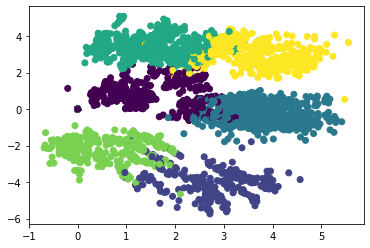

DKM  Data
plot with predicted labels


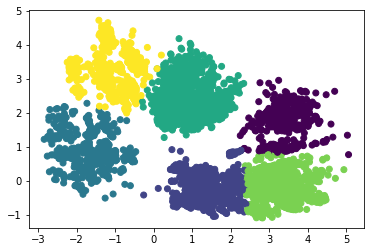

In [185]:
def plot_result(key,predicted_labels):
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=predicted_labels)
  plt.show()



K = 6
plot_result("DCN",cluster_assign_DCN_Classic4)
plot_result("DKM",cluster_assign_DKM_Classic4)



DCN  a gangé en terme d'accuracy 45% vs 25% pour DKM

Par les deux méthodes ont eu les memes score NMI & ARI

## **RoBERTa :**

### **Document embedding :**

In [186]:
model = SentenceTransformer('sentence-transformers/roberta-base-nli-stsb-mean-tokens')

In [187]:
vectorized_docs = model.encode(abstract)

### **Réduction de la dimension :**

In [188]:
reduced_data = {}
reduced_data['original'] = vectorized_docs

#### **PCA** :

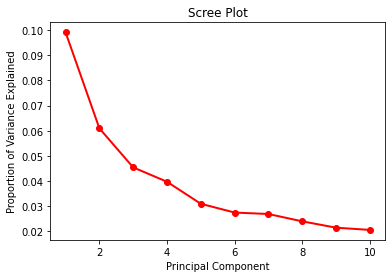

In [189]:
#NUMBER OF COMPONENTS PCA :
pca = PCA(n_components=10)
pca_component = pca.fit_transform(vectorized_docs)

PC_values = np.arange(pca.n_components_) + 1
plt.plot(PC_values, pca.explained_variance_ratio_, 'ro-', linewidth=2)
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Proportion of Variance Explained')
plt.show()

On peut prendre le nombre de composantes principal = 5

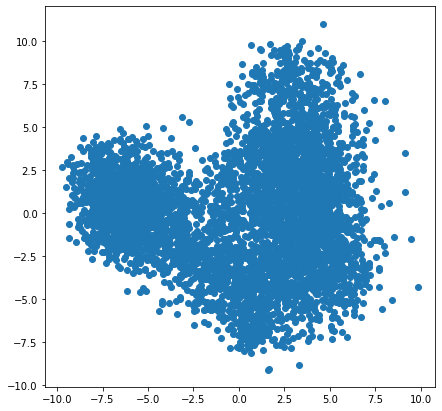

In [190]:
pca = PCA(n_components=5)
pca_components = pca.fit_transform(vectorized_docs)
reduced_data["PCA"] = pca_components

#---------------plot----------------------------------

f = plt.figure(figsize=(7,7))
PCA_components = pd.DataFrame(pca_components)
plt.scatter(PCA_components[0], PCA_components[1])
plt.show()

pca with kernel =  linear


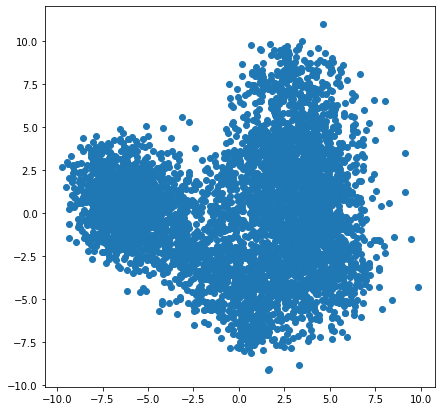

________________________________________________________________________
pca with kernel =  poly


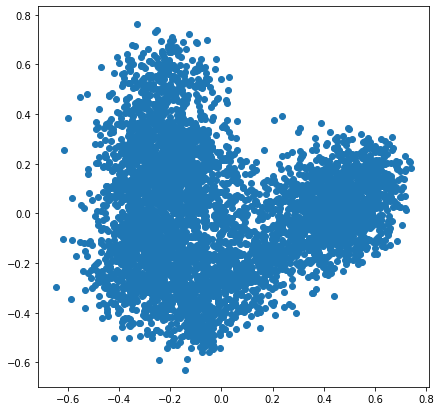

________________________________________________________________________
pca with kernel =  rbf


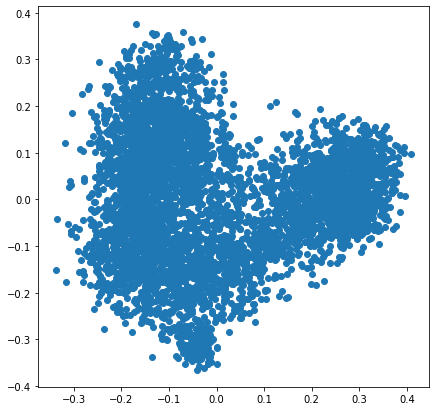

________________________________________________________________________
pca with kernel =  sigmoid


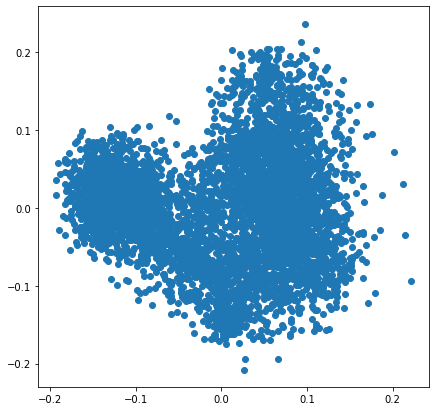

________________________________________________________________________
pca with kernel =  cosine


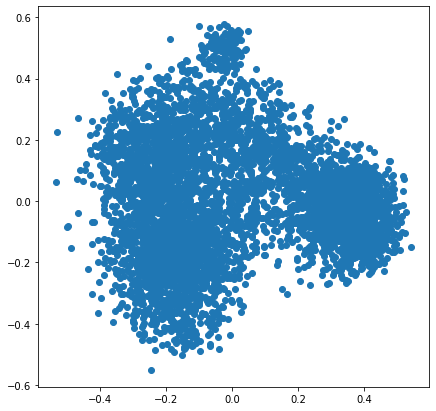

________________________________________________________________________


In [192]:
#PCA WITH DIFFERENT KERNELS :
from sklearn.decomposition import KernelPCA

list_kernel = ["linear", "poly", "rbf", "sigmoid","cosine"]
for i in list_kernel:
  transformer = KernelPCA(n_components=5, kernel=i)
  X_transformed = transformer.fit_transform(vectorized_docs)
  if i == "rbf":
    reduced_data["cosine"] = X_transformed 
  f = plt.figure(figsize=(7,7))
  PCA_componentss = pd.DataFrame(X_transformed)
  plt.scatter(PCA_componentss[0], PCA_componentss[1])
  print("pca with kernel = ",i)
  plt.show()
  print("________________________________________________________________________")

#### **T-SNE :**

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,


tsne init = 'pca'


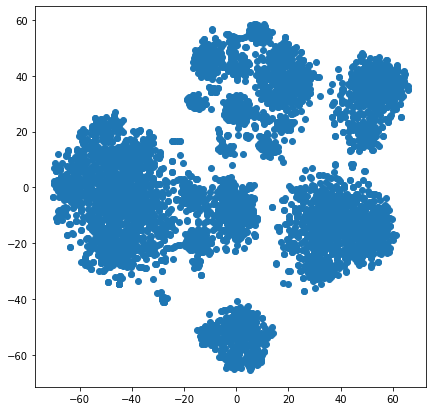

In [194]:
tsne_components = TSNE(n_components=2,init='pca').fit_transform(vectorized_docs)
reduced_data["TSNE"] = tsne_components

#------------------plot-----------------

f = plt.figure(figsize=(7,7))
print("tsne init = 'pca'")
TSNE_components = pd.DataFrame(tsne_components) #tsne with inti ='pca'
plt.scatter(TSNE_components[0], TSNE_components[1])
plt.show()

#### **UMAP :**

In [ ]:
!pip install umap-learn
import umap

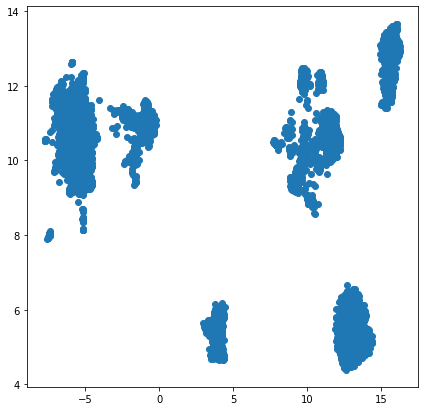

In [195]:
reducer = umap.UMAP()
umap_components = reducer.fit_transform(vectorized_docs)
reduced_data["UMAP"] = umap_components
umap_components.shape

#----------------plot---------------------
f = plt.figure(figsize=(7,7))
UMAP_components = pd.DataFrame(umap_components) 
plt.scatter(UMAP_components[0], UMAP_components[1])
plt.show()

#### **Commentaire reduction de la dimension :**
En regardant le plot de chacune des méthodes et en ignorant les couleurs (true labels) on constate que :

- PCA : 
    - on peut voir une à deux classes (au lieu de 4 classes) 
    - PCA avec kernel différent a donné presque le même résultat avec le kernel linéaire sauf pour 'cosine' qui a mieux séparé les choses 

- TSNE & UMAP : 
    - Dans chacun des deux plot on peut voir au max trois classes

    - Résultats des deux méthodes sont trés similaires vu que les deux méthodes se basent sur local clustering par contre UMAP a fait le travail legèrment mieu que T-SNE vu qu'elle est plus fidèle à la structure global de données, plus rapide et moins couteuse

### **Clustering :**

#### **K-means :**

2
3
4
5
6
7
8


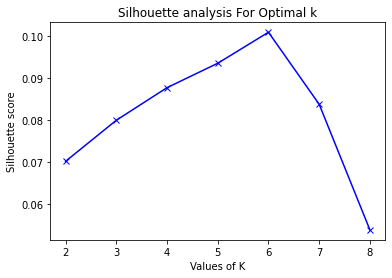

In [196]:
from sklearn.metrics import silhouette_score

range_n_clusters = [2, 3, 4, 5, 6, 7, 8]
silhouette_avg = []
for num_clusters in range_n_clusters:
 print(num_clusters)
 # initialise kmeans
 kmeans = KMeans(n_clusters=num_clusters)
 kmeans.fit(vectorized_docs)
 clusterlabels = kmeans.labels_
 
 # silhouette score
 silhouette_avg.append(silhouette_score(vectorized_docs, clusterlabels))
plt.plot(range_n_clusters,silhouette_avg,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Silhouette score') 
plt.title('Silhouette analysis For Optimal k')
plt.show()

original  Data
plot with predicted labels


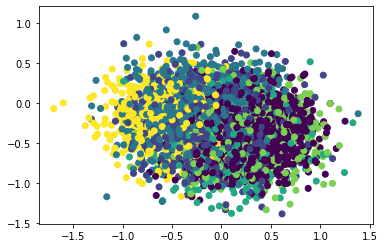

________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


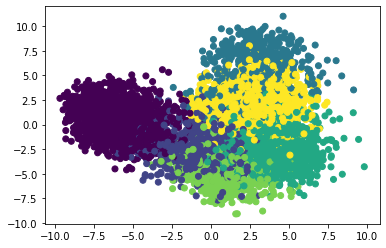

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


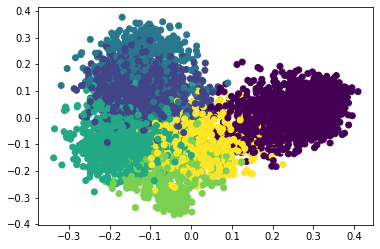

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


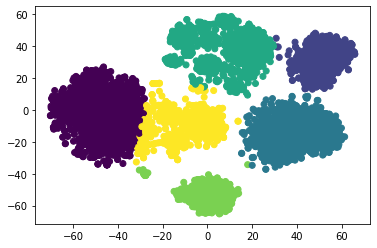

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


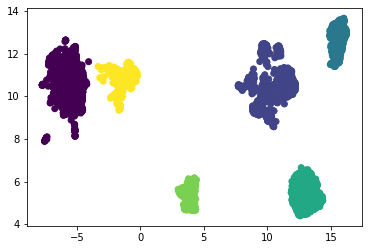

________________________________________________________________________________________________________


In [197]:
def kmeans_runner(key,K):
  kmeans = KMeans(n_clusters=K, random_state=0,n_init=5).fit(reduced_data[key])
  y_pred = kmeans.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  print("________________________________________________________________________________________________________")


K = 6
for a in reduced_data.keys():
  kmeans_runner(a,K)

Commentaire K-means Clustering :

En terme d'accuracy : TSNE a donné le plus mauvais résultat et ca prouve que c'est déconseillé de faire suivre TSNE par une K-means 
  - Le problème avec t-SNE est qu'elle ne préserve pas les distances ni la densité. elle ne préserve que dans une certaine mesure les voisins les plus proches. La différence est subtile, mais affecte tout algorithme basé sur la densité ou la distance ce qui est le cas pour K-means

PCA ( linear kernel) a donné le meilleur résulat (47%) par rapport aux autres résultats




#### **Spectral clustering :**

In [198]:
def spec_clust_runner(key,K):

  spectral_clust = SpectralClustering(n_clusters=K,assign_labels='discretize',random_state=0).fit(reduced_data[key])
  y_pred = spectral_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()
  

  print("________________________________________________________________________________________________________")



K = 6
for a in reduced_data.keys():
  spec_clust_runner(a,K)

KeyboardInterrupt: ignored

En comparant le Spectral clustering & k-means :

L'accuracy a augmenté pour Spectral clustering par rapport au k-means dans le cas de données originaux + pca non linéaire (cosine kernel)

En revanche on a remaqué une baisse d'accuracy dans le cas du pca linéaire ( linear kernel)

Meme en terme de visualisation : non linear pca ("cosine") a donné un affichage qui ressemble à l'affichage en utilisant les vrai labels

Sinon en terme de temps d'éxecution malgré que le spectral clustering se base sur la méthode k-means mais pas sur les coordonnées originales, mais sur un embedding qui se focalise sur la connectivité, donc au lieu de minimiser les erreurs au carré dans l'input, il minimise les erreurs au carré sur la capacité à reconstruire les voisins et c'est souvent mieux.

#### **HDBSCAN :**

In [ ]:
#!pip install hdbscan
import hdbscan

original  Data
plot with predicted labels


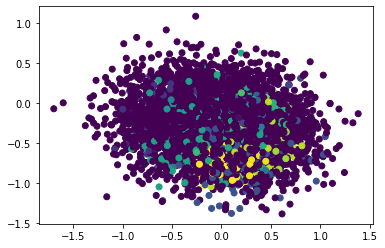

________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


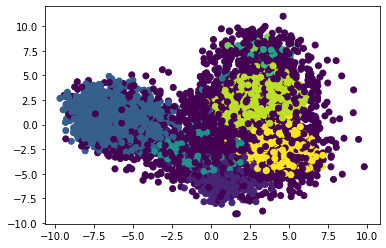

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


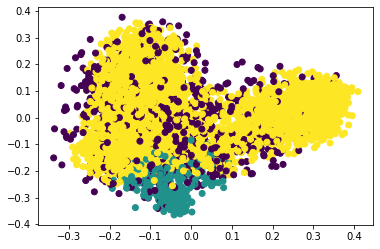

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


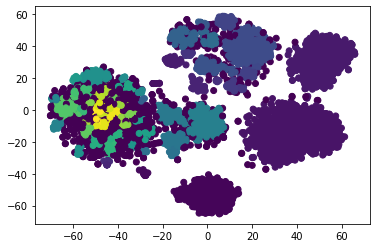

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


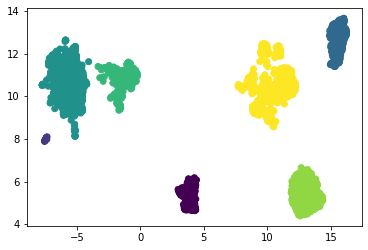

________________________________________________________________________________________________________


In [199]:
def hdbscan_runner(key):
  hdbscan_clust = hdbscan.HDBSCAN(algorithm='best', alpha=1.0, metric='euclidean',cluster_selection_epsilon=0.5).fit(reduced_data[key])
  y_pred = hdbscan_clust.labels_
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  

  print("________________________________________________________________________________________________________")



K = 6
for a in reduced_data.keys():
  hdbscan_runner(a)

En terme d'accuracy : aucun algorithme a donné des bons résultats 

Pour original data : l'algorithme n'a pas donné de bons résultat vu qu'il est pas trés bon en high dimensional clustering 

linear & non linear pca sont les algorithmes qui ont donné les meilleurs résultats par rapport aux autres algorithmes (avec un accuracy ~ 20%)

#### **CAH :**

original  Data
plot with predicted labels


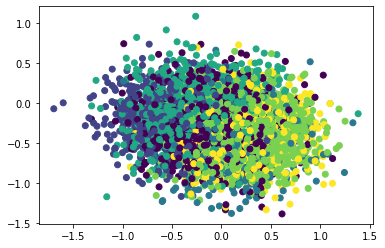

________________________________________________________________________________________________________
PCA  Data
plot with predicted labels


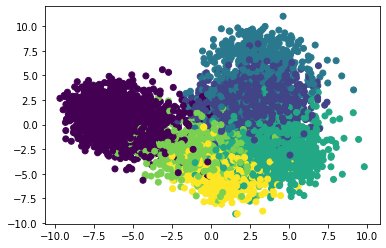

________________________________________________________________________________________________________
cosine  Data
plot with predicted labels


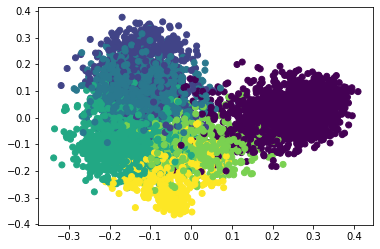

________________________________________________________________________________________________________
TSNE  Data
plot with predicted labels


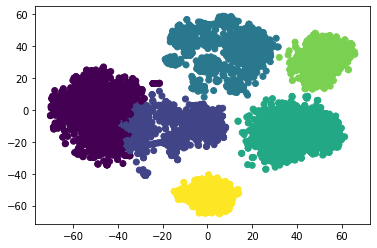

________________________________________________________________________________________________________
UMAP  Data
plot with predicted labels


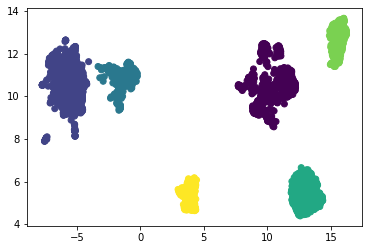

________________________________________________________________________________________________________


In [200]:
def cah_runner(key,K):
  y_pred = AgglomerativeClustering(n_clusters = K).fit_predict(reduced_data[key])
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  labels = y_pred
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=labels)
  plt.show()

  

  print("________________________________________________________________________________________________________")



K = 6
for a in reduced_data.keys():
  cah_runner(a,K)
  

PCA("cosine kernel") a donné le meilleur résultas en terme d'accuracy (50%)et visualisation (affichages avec predicted & true labels trés similaires) 

linear PCA + original data : ont donné une accuracy trés basse

NMI & ARI : résultat similaires pour tout les algorithmes

LA cah reste toujours non adapté aux grands volumes de données à cause du temps de calcul qui explose et cela s’explique complètement par les méthodes de calcul de l’algorithme.


##Partie 2 RoBERTa :

###DCN for Article 2  :

In [201]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
embeddings_DCN_Classic4, cluster_assign_DCN_Classic4 = DCN(vectorized_docs_array, 6, 2, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data = {}
reduced_data['DCN']=embeddings_DCN_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:08<00:00,  5.84it/s]


Running k-means on the learned embeddings...
Starting DCN training...


100%|██████████| 50/50 [00:35<00:00,  1.42it/s]


###DKM for Article 2  :

In [202]:
tf.reset_default_graph()
vectorized_docs_array = np.array(vectorized_docs)
X_reduced_DKM_Classic4, cluster_assign_DKM_Classic4 = DKM(vectorized_docs_array, 6, 2, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)
reduced_data['DKM']=X_reduced_DKM_Classic4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs)


Starting autoencoder pretraining...


100%|██████████| 50/50 [00:08<00:00,  5.74it/s]


Running k-means on the learned embeddings...
Starting DKM training...


100%|██████████| 20/20 [00:26<00:00,  1.32s/it]


###Plot Function Article 2 :

DCN  Data
plot with predicted labels


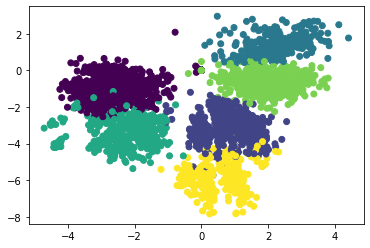

________________________________________________________________________________________________________
DKM  Data
plot with predicted labels


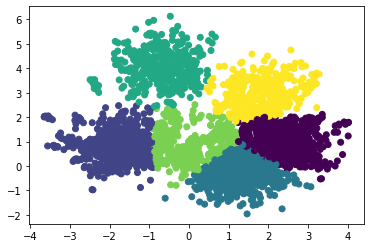

________________________________________________________________________________________________________


In [205]:
def plot_result(key,predicted_labels):
  print(key," Data")
  #------------ plot---------------------------
  Components = pd.DataFrame(reduced_data[key])
  print("plot with predicted labels")
  plt.scatter(Components[0], Components[1], c=predicted_labels)
  plt.show()

  print("________________________________________________________________________________________________________")


K = 6
plot_result("DCN",cluster_assign_DCN_Classic4)
plot_result("DKM",cluster_assign_DKM_Classic4)



In [214]:
from sklearn.metrics import silhouette_score
score = silhouette_score(reduced_data["DKM"], cluster_assign_DKM_Classic4, metric='euclidean')
print("score de DKM : ",score )
score = silhouette_score(reduced_data["DCN"], cluster_assign_DCN_Classic4, metric='euclidean')
print("score de DCN : ",score )



score de DKM :  0.47199985
score de DCN :  0.08961061311142404


DCN  a gangé en terme d'accuracy 45% vs 25% pour DKM

Par les deux méthodes ont eu les memes score NMI & ARI